#    R Data cleansing -BGP-31052022

In [2]:
#library(dplyr)
#library(ggplot2)
#if(!require(ggExtra)) {install.packages("ggExtra");require(ggExtra)}
#if(!require(naniar)) {install.packages("naniar");require(naniar)}
#if(!require(mvoutlier)) {install.packages("mvoutlier");require(mvoutlier)}
#if(!require(MissMech)) {install.packages("MissMech");require(MissMech)}
#if(!require(mice)) {install.packages("mice");require(mice)}
#if(!require(MatchIt)) {install.packages("MatchIt");require(MatchIt)}
#library(dplyr)
#library(dbplyr)
#library(tidyverse)
#library(DBI)
#library(odbc)
#library(gridExtra)


## D. Sourse data uploading and data relevatn data frames cration


In [3]:
conn <- DBI::dbConnect(
  odbc::odbc(),
  Driver = "SQL Server",
  Server = "SHEM\\SQLEXPRESS",
  Database = "A_BDG"
)

### D.1. Source data frame creation

In [4]:
DF_BGP <- dbGetQuery(conn, "SELECT * FROM Sh.BGP_FF_OC")
head(DF_BGP)

,BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,NA,NA,US/Mountain,147.25,129.13,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.82697
2,Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,NA,NA,US/Mountain,225.00,202.00,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.60993
3,Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,NA,NA,US/Mountain,30.62,34.63,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.52453
4,Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,NA,NA,US/Mountain,178.50,180.00,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.52966
5,Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,NA,NA,US/Mountain,95.50,103.25,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.17005
6,Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,NA,NA,US/Mountain,145.62,139.12,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.38614


In [5]:
DF_BGP

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,NA,NA,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,NA,NA,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,NA,NA,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,NA,NA,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,NA,NA,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,NA,NA,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,NA,NA,US/Mountain,NA,NA,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,NA
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,NA,NA,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,NA,NA,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


### D.1.2 Creating data frame with factorised char variables for futer use in functions that don't work with them


In [6]:
DF_BGP_chFc <-DF_BGP
for (v in names(DF_BGP)) {
    if(typeof(DF_BGP_chFc[[v]])=='character') {
        DF_BGP_chFc[[v]] <- factor(DF_BGP_chFc[[v]])
    }
}


In [7]:
DF_BGP_chFc

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,NA,NA,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,NA,NA,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,NA,NA,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,NA,NA,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,NA,NA,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,NA,NA,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,NA,NA,US/Mountain,NA,NA,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,NA
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,NA,NA,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,NA,NA,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


### D.1.3 Creating data frame with only numeric variables for futer use in functions that work with omly numeric
##### (like DBSCAN)


In [7]:
notFnames<-names(Filter(is.numeric, DF_BGP_chFc))

In [8]:
DF_BGP_nFc <- DF_BGP_chFc[,colnames(DF_BGP_chFc) %in% notFnames] 

In [9]:
DF_BGP_nFc

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2053.2,NA,NA,147.2500,129.1300,171.0000,109.1300,96.8699,53.25,42.63,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
19859.1,NA,NA,225.0000,202.0000,330.7500,219.5000,220.5001,88.25,91.00,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3696.4,NA,NA,30.6200,34.6300,37.3800,36.5000,24.8800,18.50,17.37,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
15047.4,NA,NA,178.5000,180.0000,222.0000,324.0000,382.4999,42.50,40.50,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
11254.8,NA,NA,95.5000,103.2500,160.0000,103.0000,104.7500,37.00,35.75,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
8802.7,NA,NA,145.6200,139.1200,150.7500,184.1300,125.1302,71.50,51.87,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
2538.0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,NA
10551.9,NA,NA,203.0000,217.0000,388.7500,208.0000,190.0001,61.75,59.50,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
17358.0,NA,NA,227.2500,234.2500,355.5000,236.7500,217.2502,65.75,74.75,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


### יצירת מערך מידע נומרי עם איפוס של מידע חסר
#### לשימוש בפונקציות שאינן מתמודדות עם מידע חסר

In [10]:
DF_BGP_chFc_Xna <- DF_BGP_chFc
for (v in names(DF_BGP_chFc))
    {
        DF_BGP_chFc_Xna[[v]] <- ifelse(is.na(DF_BGP_chFc[[v]])==TRUE, 0, DF_BGP_chFc[[v]])
    }

In [12]:
DF_BGP_chFc_Xna

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,2,55,2053.2,0,0,3,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
2,1,2,55,19859.1,0,0,3,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3,1,2,55,3696.4,0,0,3,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
4,1,2,55,15047.4,0,0,3,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
5,1,1,1,11254.8,0,0,3,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
6,1,1,1,8802.7,0,0,3,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
7,1,1,1,2538.0,0,0,3,0.0000,0.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,0.000000
8,1,1,1,10551.9,0,0,3,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
9,1,1,58,17358.0,0,0,3,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [11]:
DF_BGP_nFc_Xna <-DF_BGP_nFc ## Same - only numeric without NA s
for (v in names(DF_BGP_nFc))
    {
        DF_BGP_nFc_Xna[[v]] <- ifelse(is.na(DF_BGP_nFc[[v]])==TRUE, 0, DF_BGP_nFc[[v]])
    }

In [14]:
DF_BGP_nFc_Xna

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2053.2,0,0,147.2500,129.1300,171.0000,109.1300,96.8699,53.25,42.63,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
19859.1,0,0,225.0000,202.0000,330.7500,219.5000,220.5001,88.25,91.00,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3696.4,0,0,30.6200,34.6300,37.3800,36.5000,24.8800,18.50,17.37,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
15047.4,0,0,178.5000,180.0000,222.0000,324.0000,382.4999,42.50,40.50,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
11254.8,0,0,95.5000,103.2500,160.0000,103.0000,104.7500,37.00,35.75,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
8802.7,0,0,145.6200,139.1200,150.7500,184.1300,125.1302,71.50,51.87,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
2538.0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.00,0.00,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,0.000000
10551.9,0,0,203.0000,217.0000,388.7500,208.0000,190.0001,61.75,59.50,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
17358.0,0,0,227.2500,234.2500,355.5000,236.7500,217.2502,65.75,74.75,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


## סוף הטיפול / נרמול הנתונים
#### #################################################

# E. Outliers tritment


## E.1. Univariate Outliers


##### Dr, Karpaty Tomas  outlierMatrix  and  missingMatrix generation functions

In [12]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- names(data)
    outdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[v] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}


missingMatrix <- function(data) {
    vn <- names(data)
    missdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        mv <- ifelse(is.na(data[[v]]),1,0)
        missdata[v] <- mv
    }
    missdata$row1 <- NULL
    return(missdata)
}

minmax <- function(x) {
    return(((x-min(x,na.rm=T))/(max(x,na.rm=T)-min(x,na.rm=T))))
}

getMissingness <- function (data, getRows = FALSE) {
    require(dplyr)
    l <- nrow(data)
    vn <- names(data)
    nadf <- data
    cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(na.count > 
        0)
    totmiss <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::tally()
    idx <- NULL
    msg <- (paste("This dataset has ", as.character(totmiss), 
        " (", as.character(round(totmiss/nrow(data) * 100, 1)), 
        "%)", " complete rows. Original data has ", nrow(data), 
        " rows.", sep = ""))
    if (getRows == TRUE & totmiss != 0) {
        nadf$rn <- seq_len(nrow(data))
        idx <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::select(rn)
    }
    print(list(head(cnt, n = 10), msg))
    return(list(missingness = cnt, message = msg, rows = idx$rn))
}

### E.1.1. Using inter quartial rate to check for outliers in the variables

In [15]:
outlierMatrix(DF_BGP,threshold=1.5) # on the original FF

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0,0,0,0,0,0,0,0,0,NA
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
outlierMatrix(DF_BGP_chFc,threshold=1.5) # Same - just checking

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0,0,0,0,0,0,0,0,0,NA
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [18]:
outlierMatrix(DF_BGP_nFc,threshold=1.5) # Same - just checking

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0,0,0,0,0,0,0,0,0,NA
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [19]:
outlierMatrix(DF_BGP_nFc_Xna,threshold=1.5) # Same - just checking

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [17]:
write.csv(outlierMatrix(DF_BGP,threshold=1.5), file="DF_BGP_chFc_outliersMtrx_2-18052022.csv")

In [38]:
write.csv(outlierMatrix(DF_BGP,threshold=1.5), file="DF_BGP_nFc_Xna_outliersMtrx_3-18052022.csv")

### E.1.2  OutLier Matrix Heat Map

In [79]:
# try to work with the origina FF
heatmap(as.matrix(outlierMatrix(DF_BGP[,names(DF_BGP)],threshold=1.2)),na.rm = T,cexRow = 1.5,cexCol=2,margins=c(0,0),labRow = (names(DF_BGP)))

ERROR: Error in hclustfun(distfun(if (symm) x else t(x))): NA/NaN/Inf in foreign function call (arg 10)


In [80]:
# try to work with DF_BGP_chFc  (charckteres as factors)
heatmap(as.matrix(outlierMatrix(DF_BGP_chFc[,names(DF_BGP_chFc)],threshold=1.2)),na.rm = T,cexRow = 1.5,cexCol=2,margins=c(0,0),labRow = (names(DF_BGP_chFc)))

ERROR: Error in hclustfun(distfun(if (symm) x else t(x))): NA/NaN/Inf in foreign function call (arg 10)


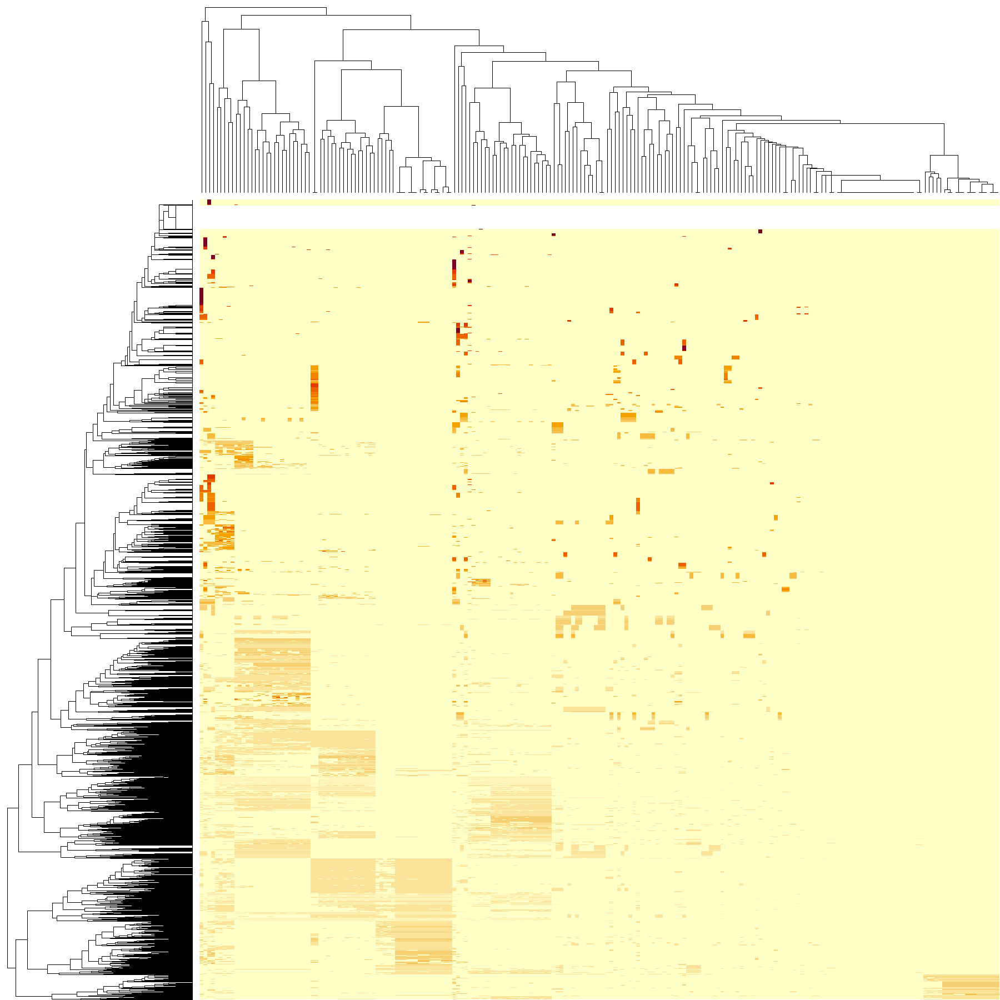

In [81]:
# try to work with DF_BGP_chFc_Xna  (charckteres as factors without Na s)
heatmap(as.matrix(outlierMatrix(DF_BGP_chFc_Xna[,names(DF_BGP_chFc_Xna)],threshold=1.2)),na.rm = T,cexRow = 1.5,cexCol=2,margins=c(0,0),labRow = (names(DF_BGP_chFc_Xna)))

In [41]:
# try to work with DF_BGP_nFc  (no Fctors - numeric only)
heatmap(as.matrix(outlierMatrix(DF_BGP_nFc[,names(DF_BGP_nFc)],threshold=1.2)),na.rm = T,cexRow = 1.5,cexCol=2,margins=c(0,0),labRow = (names(DF_BGP_nFc)))

ERROR: Error in hclustfun(distfun(if (symm) x else t(x))): NA/NaN/Inf in foreign function call (arg 10)


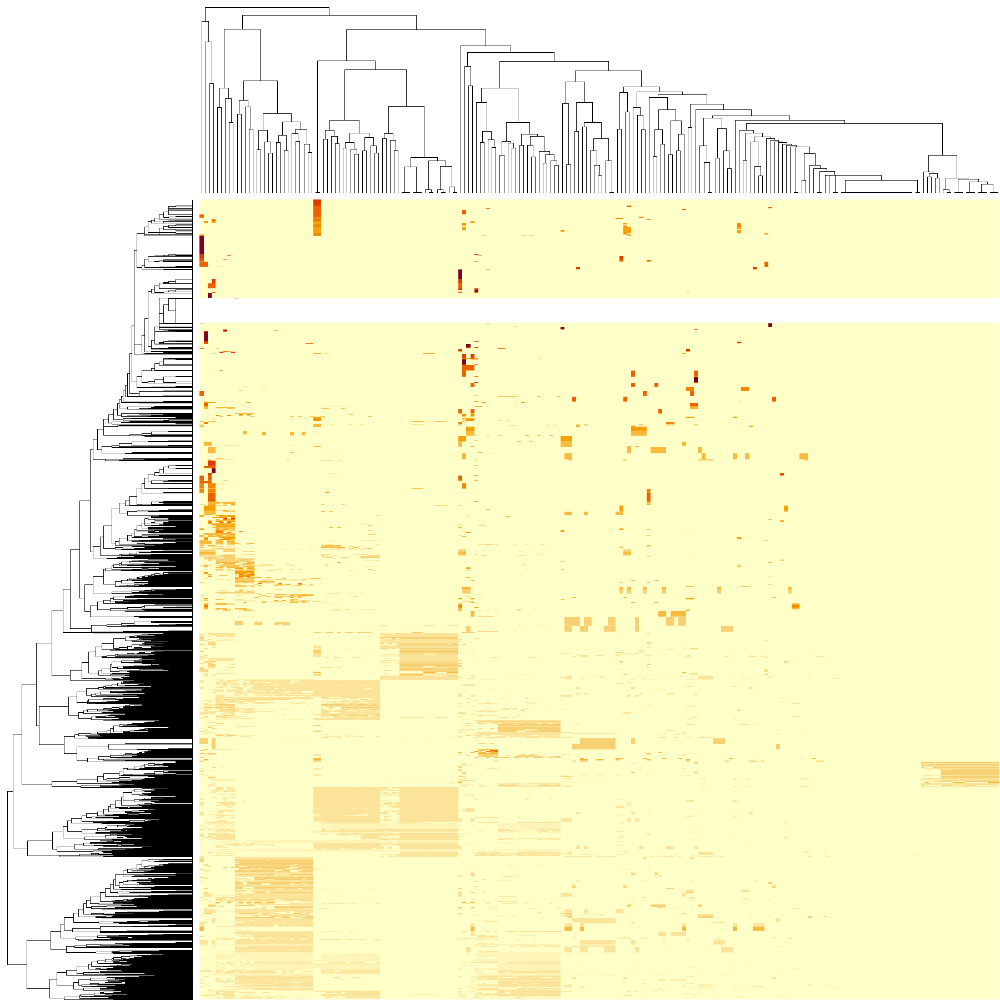

In [82]:
# try to work with DF_BGP_nFc_Xna  (no factors and without Na s)
heatmap(as.matrix(outlierMatrix(DF_BGP_nFc_Xna[,names(DF_BGP_nFc_Xna)],threshold=1.2)),na.rm = T,cexRow = 1.5,cexCol=2,margins=c(0,0),labRow = (names(DF_BGP_nFc_Xna)))

### E.1.3 Box Plot visualization of univariant outliers

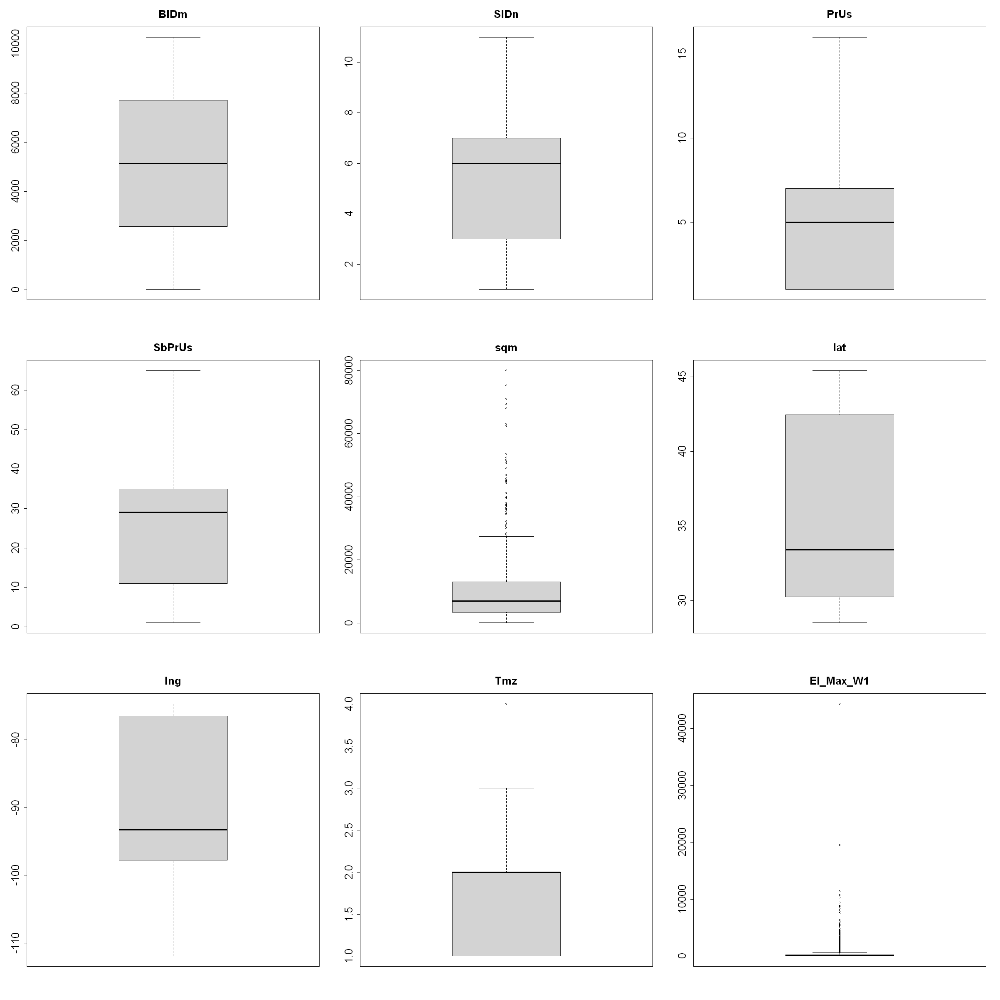

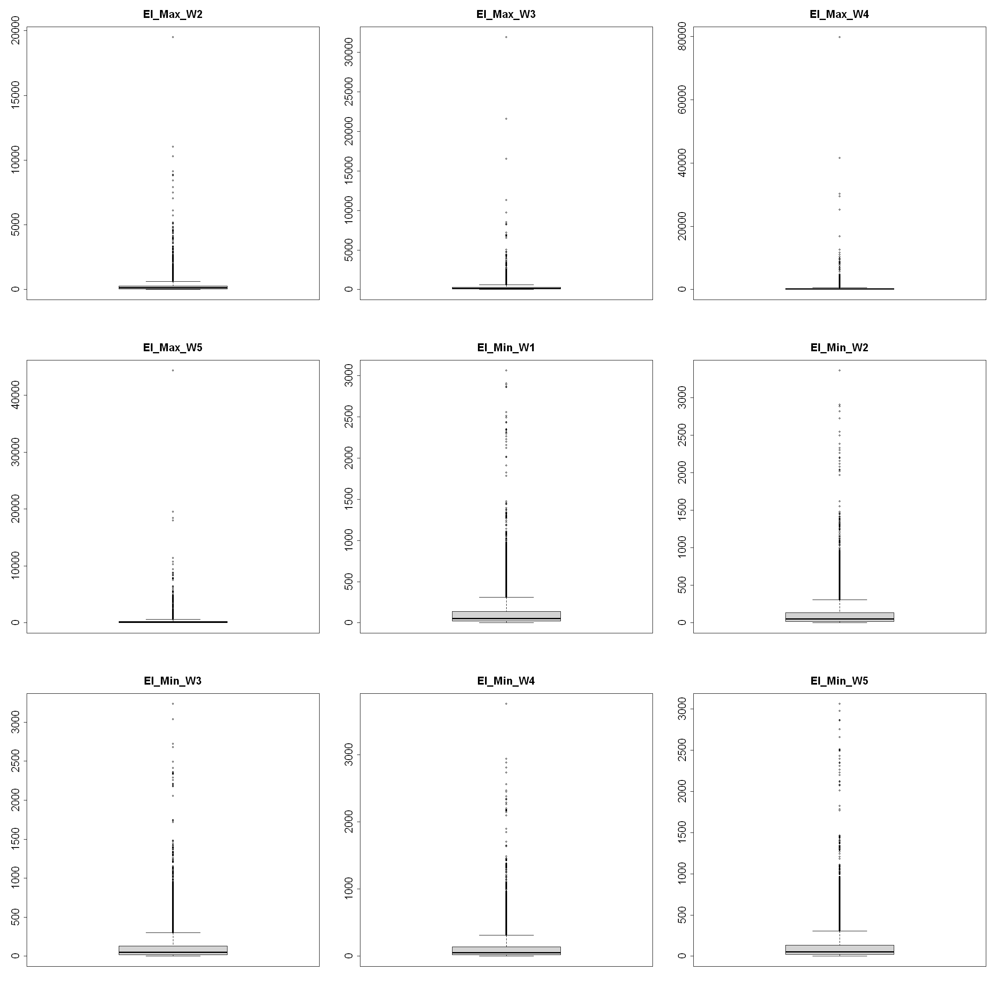

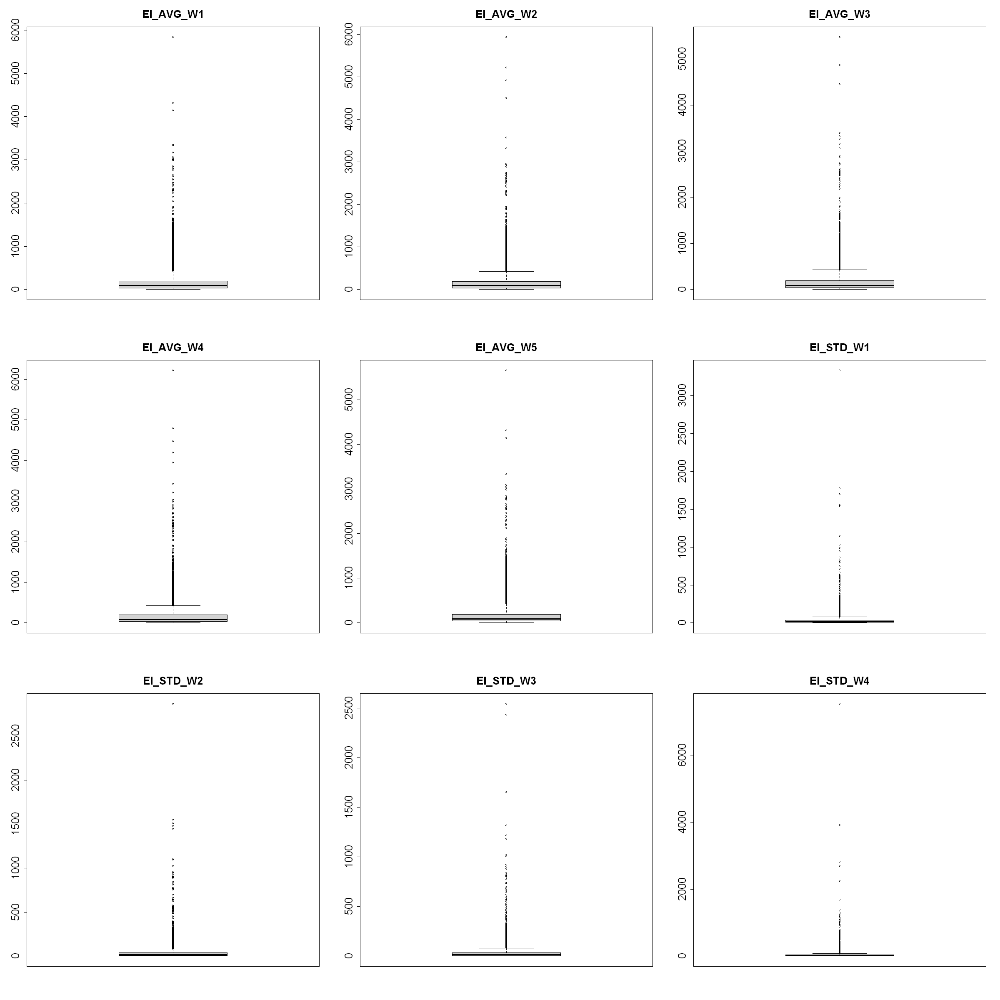

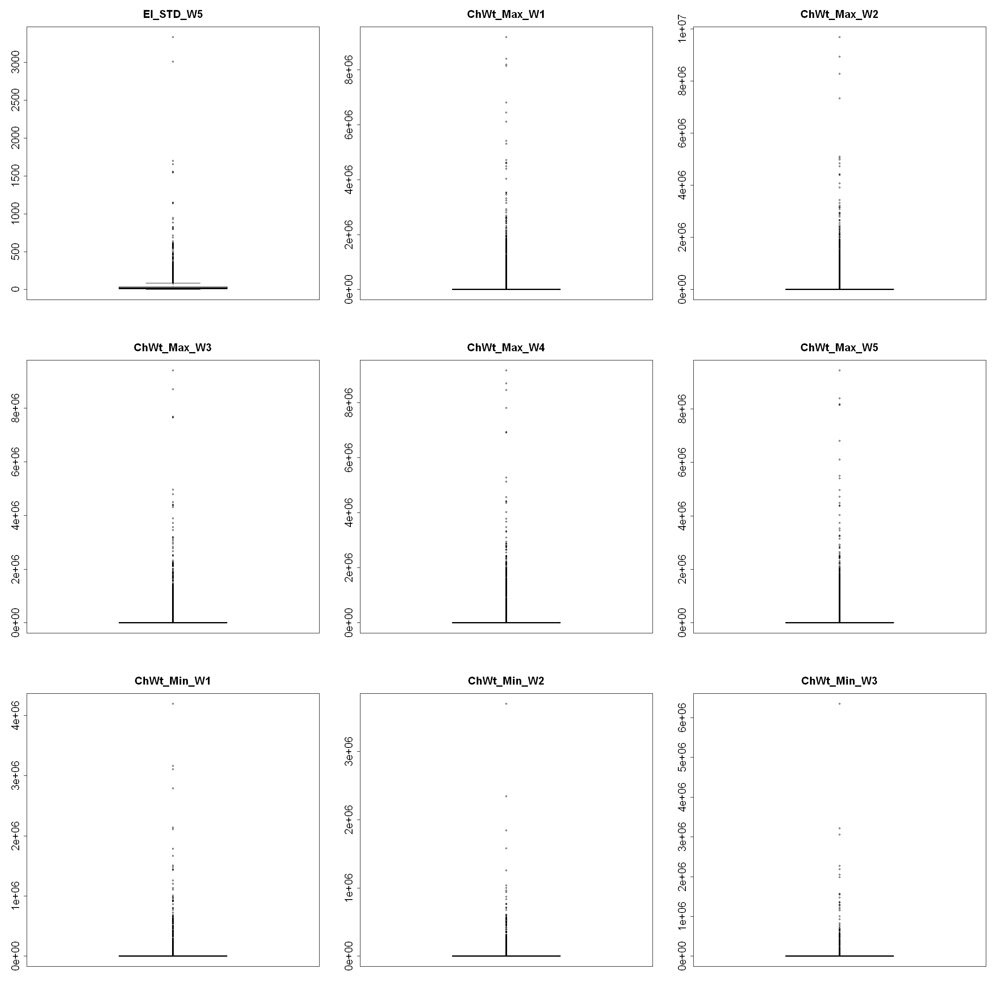

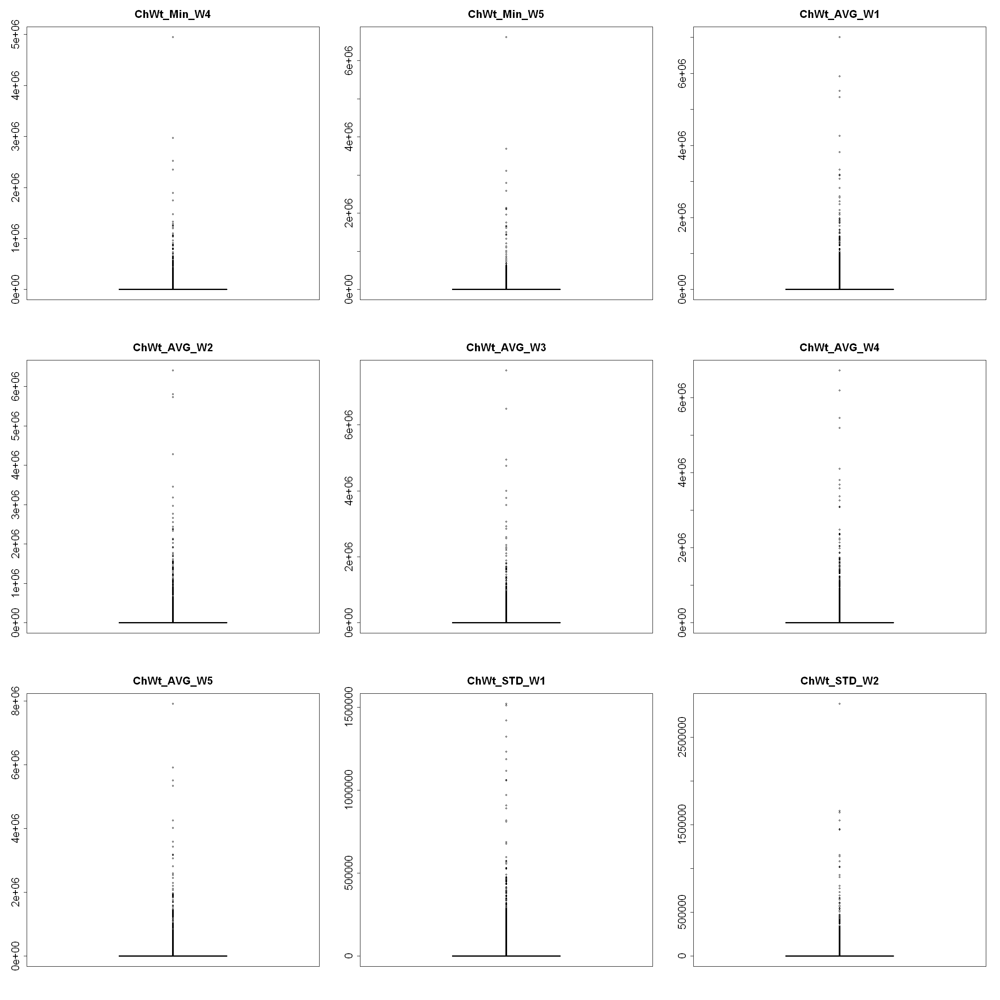

...

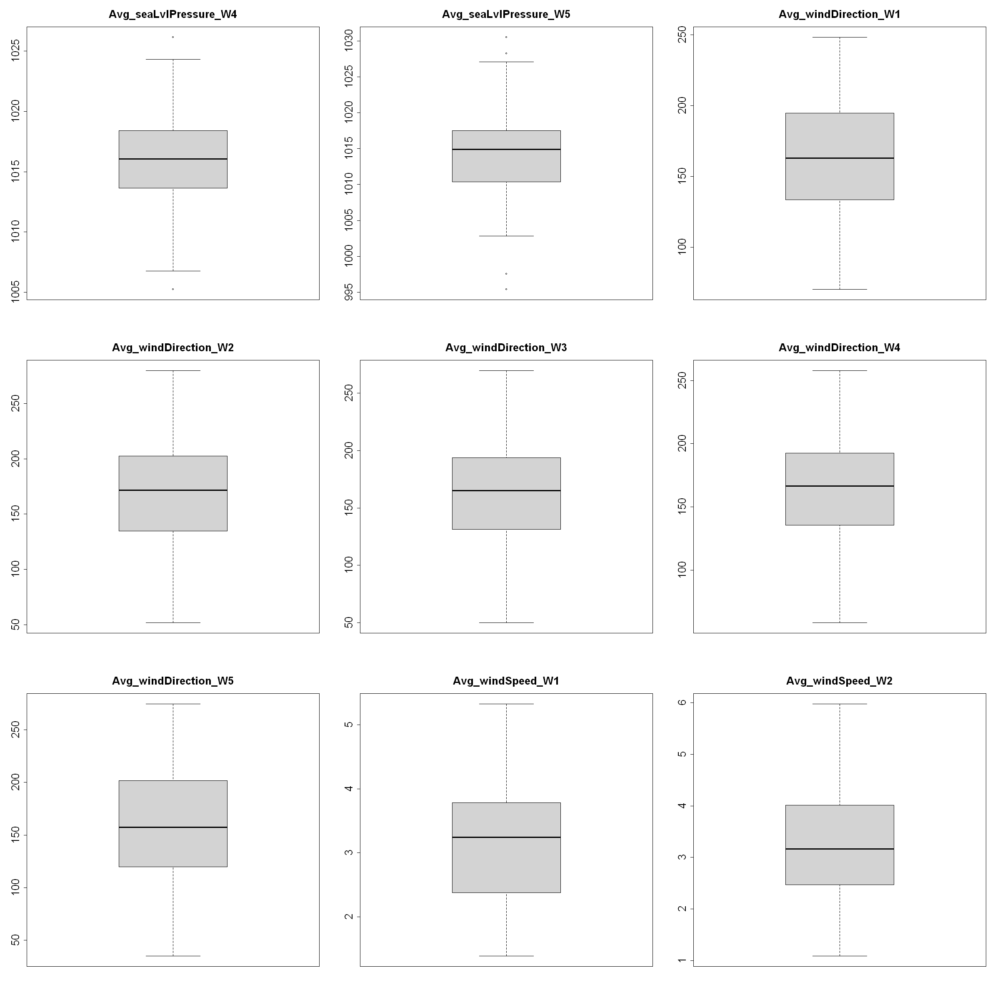

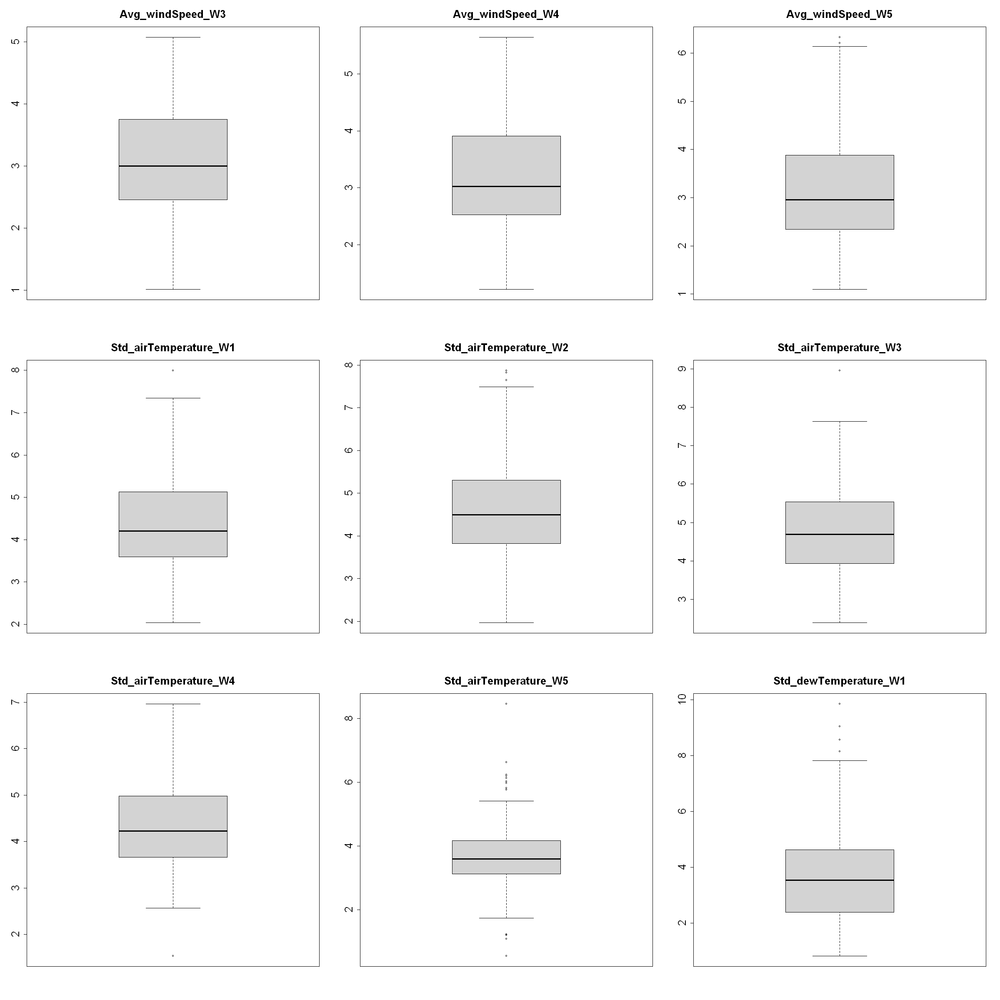

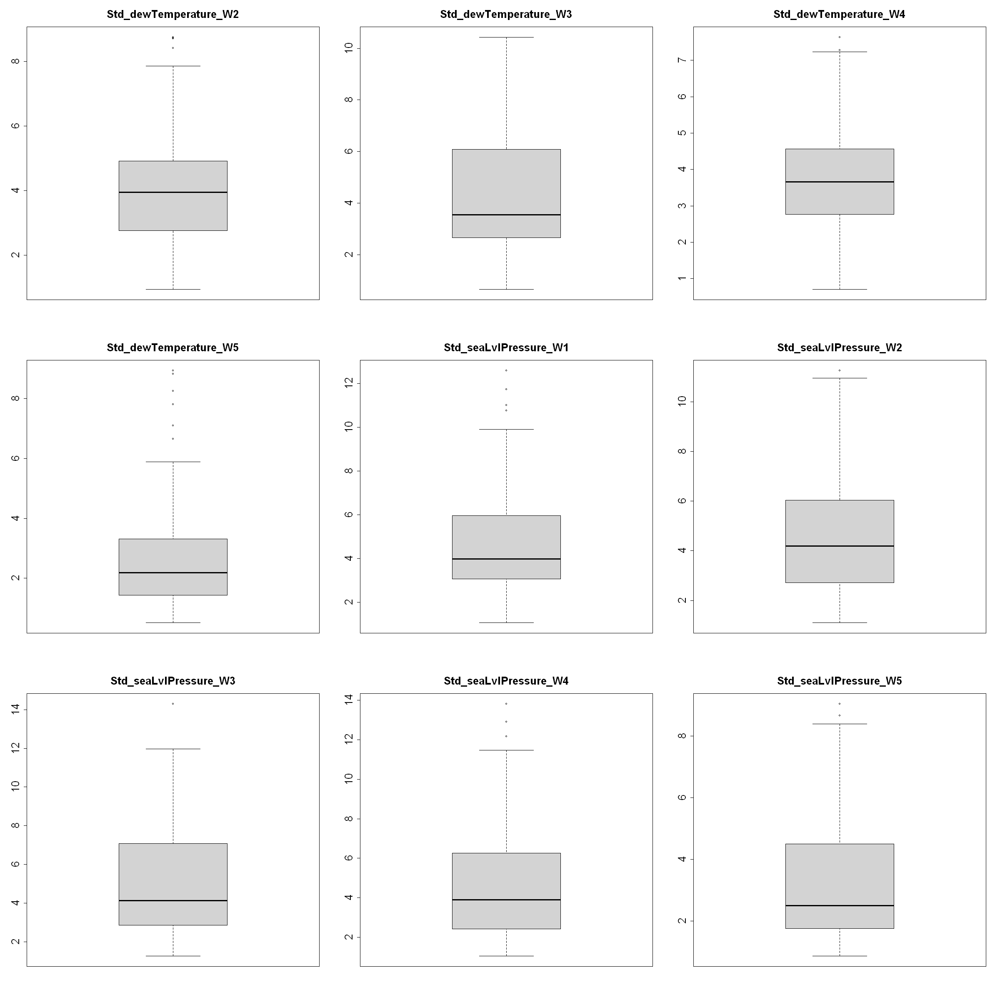

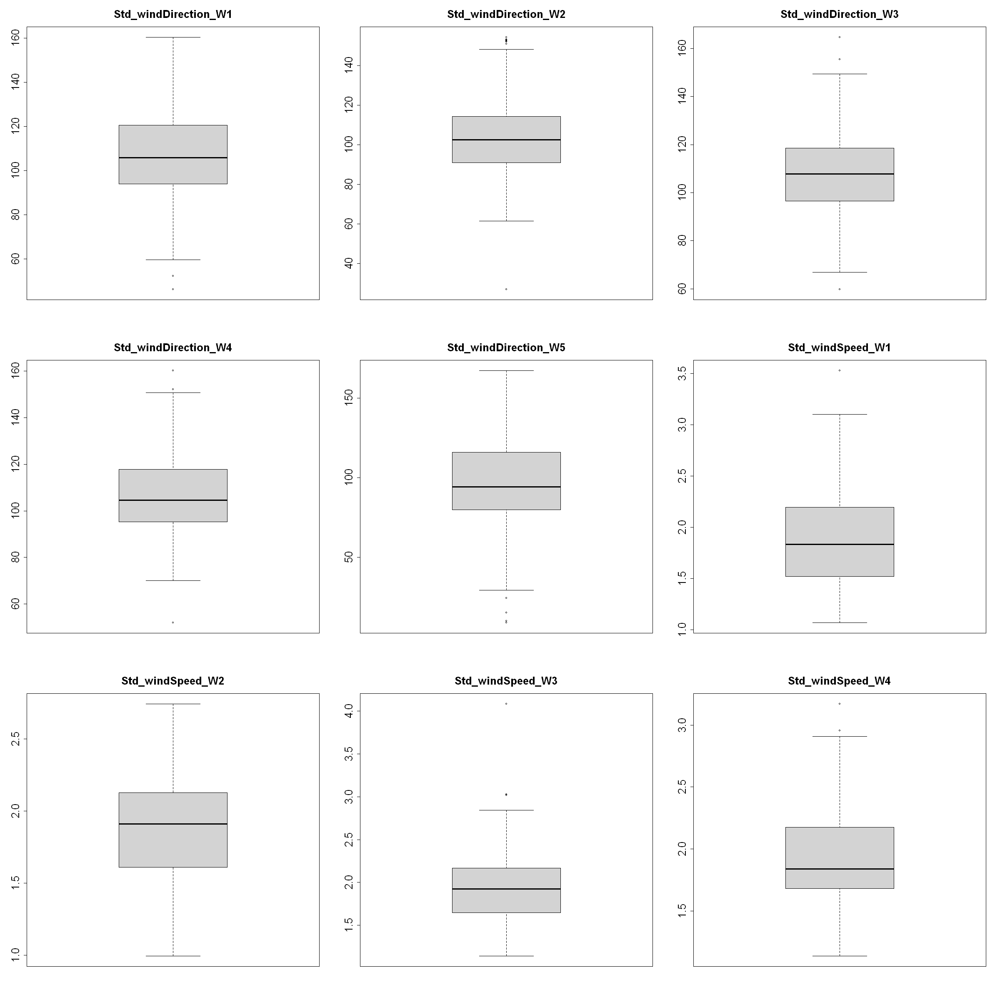

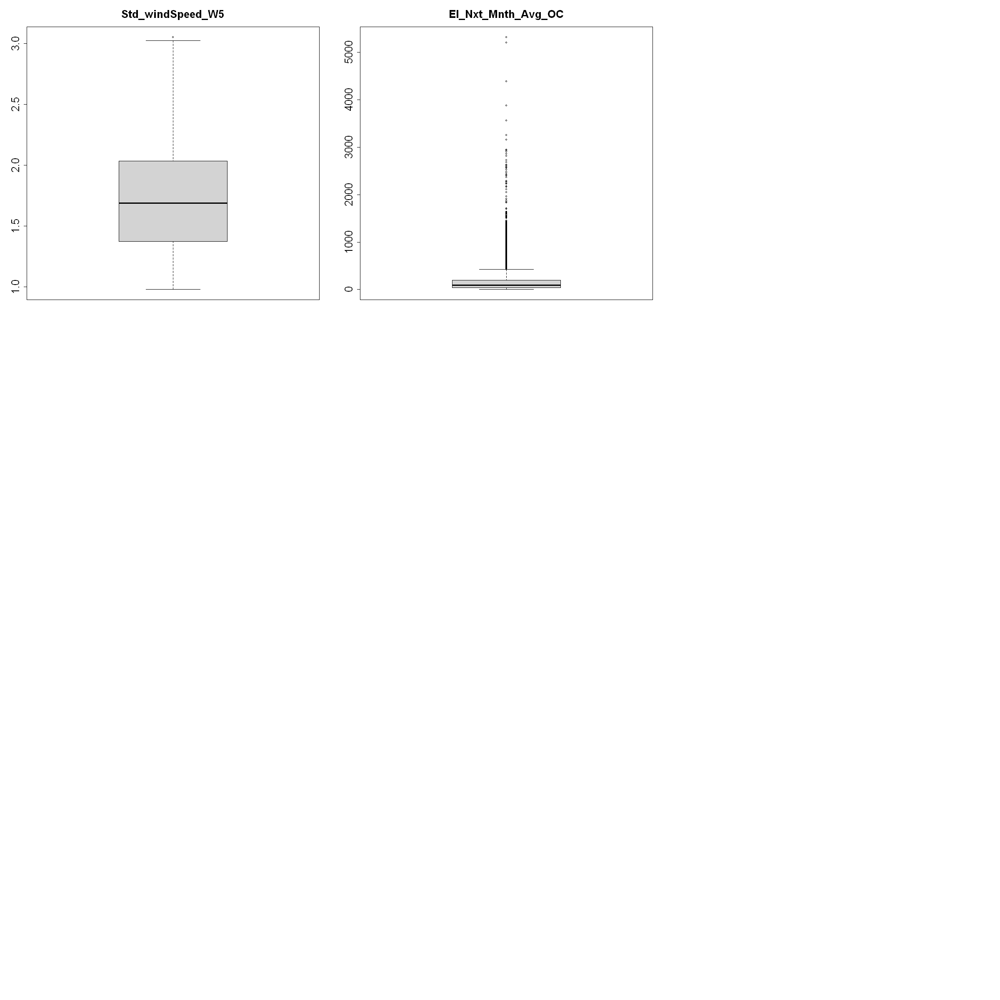

In [95]:
# Using the DF_BGP_chFc for factorized characters  (dose not work with characthers...)
options(repr.plot.width = 20, repr.plot.height = 20)
par(mfrow=c(3,3))
for(v in 1:209) {
    boxplot(DF_BGP_chFc[[v]],main=names(DF_BGP_chFc[v]),cex.axis = 2,cex.main=2)
}
par(mfrow=c(1,1))


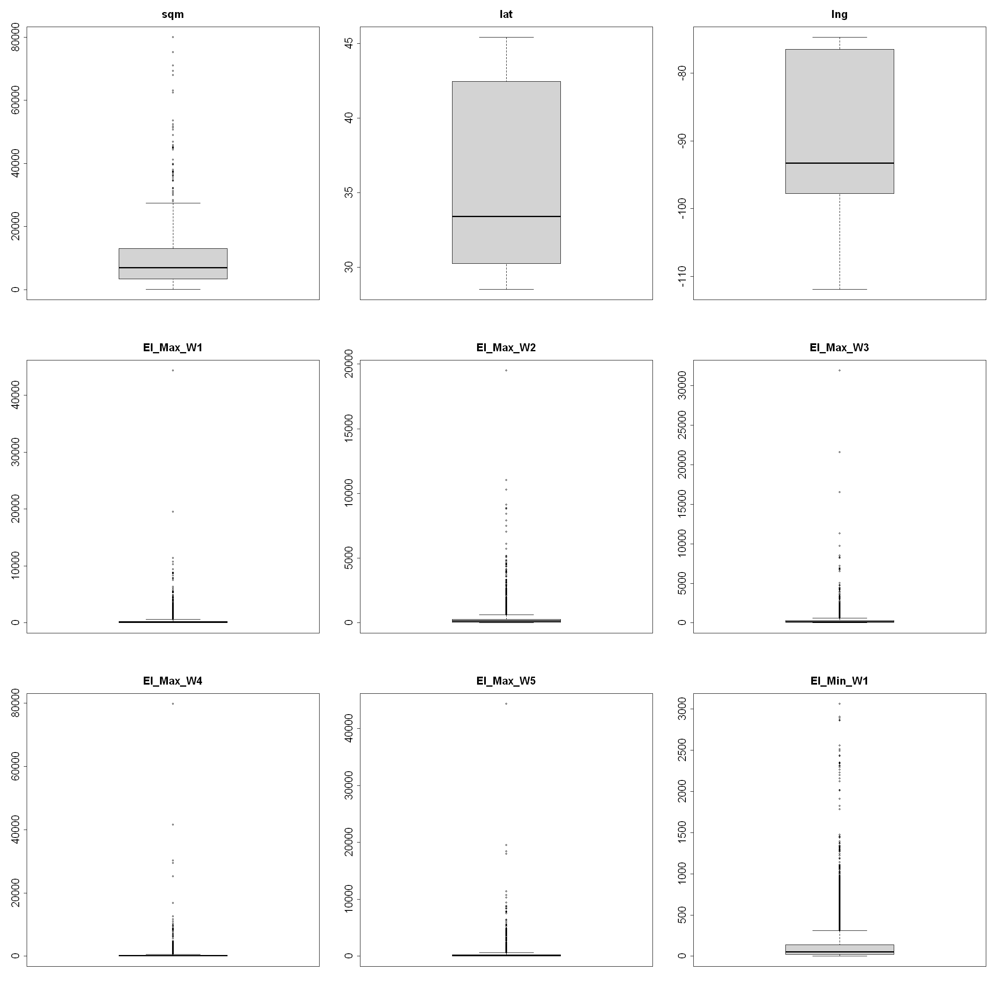

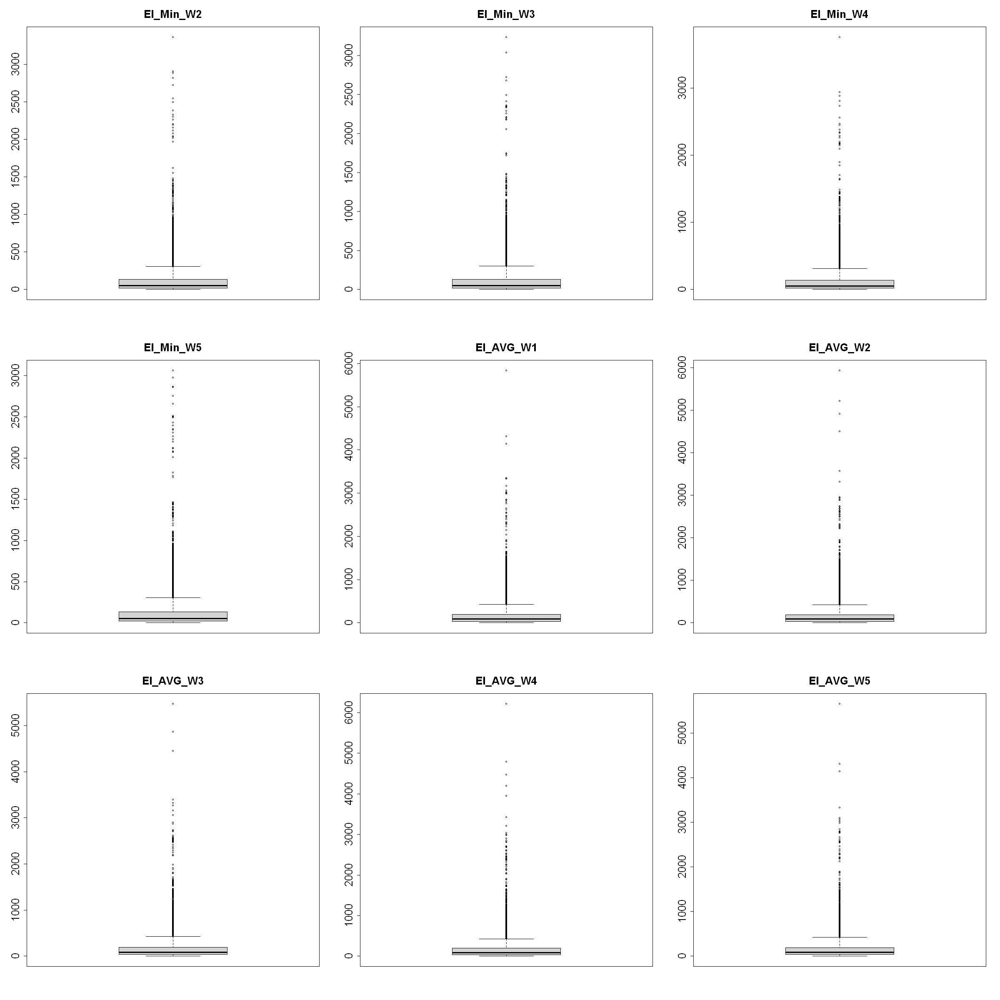

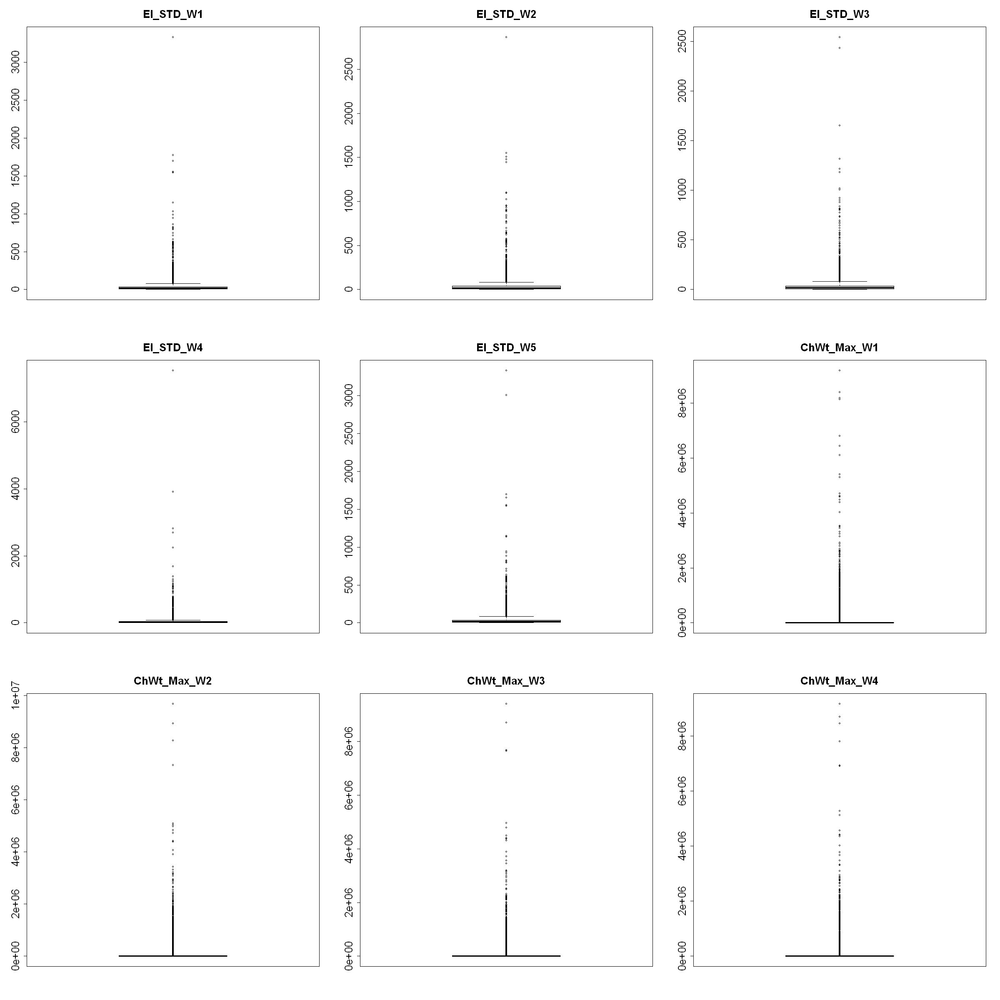

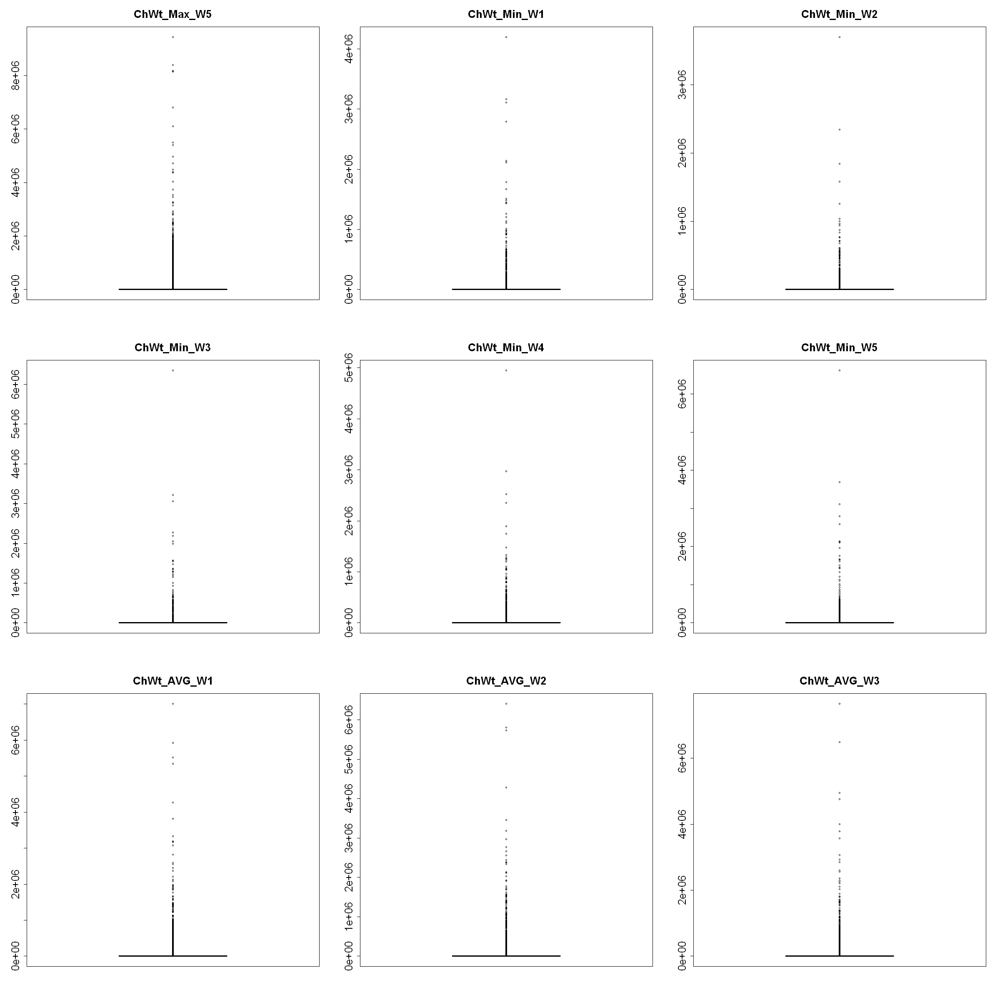

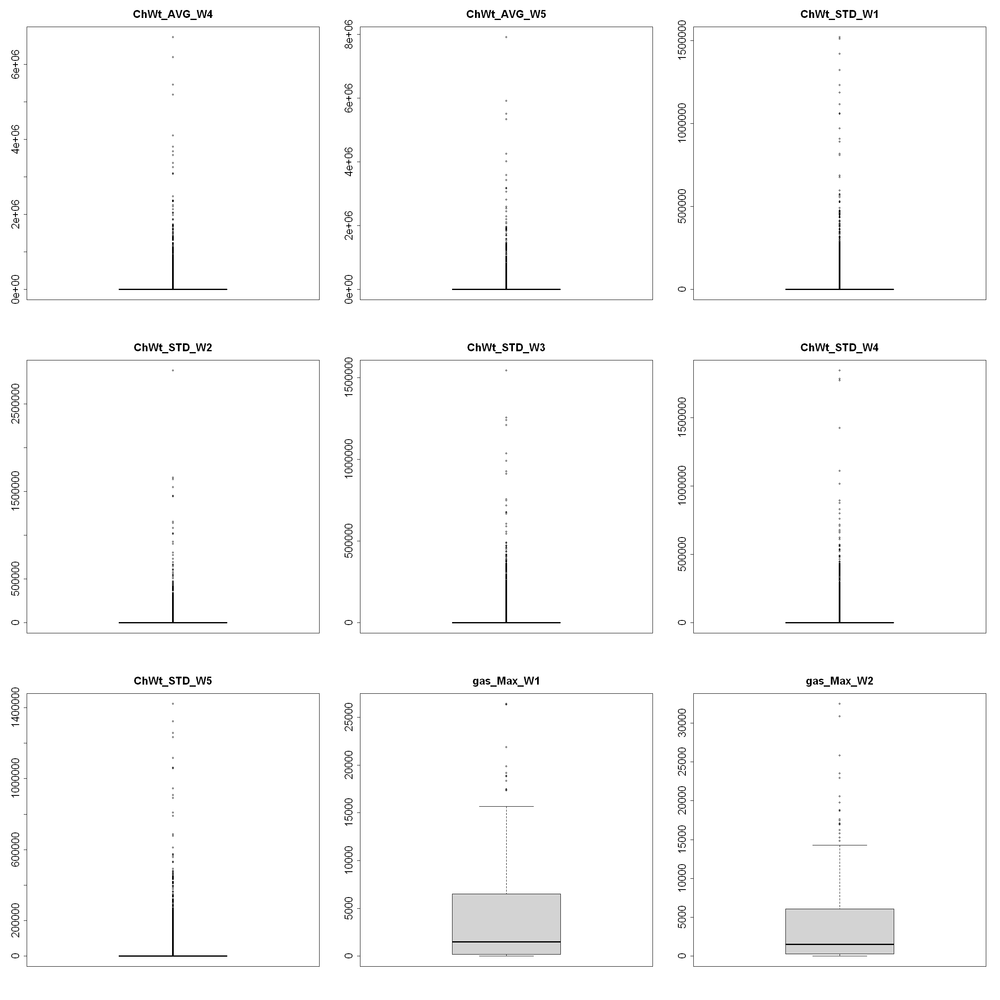

...

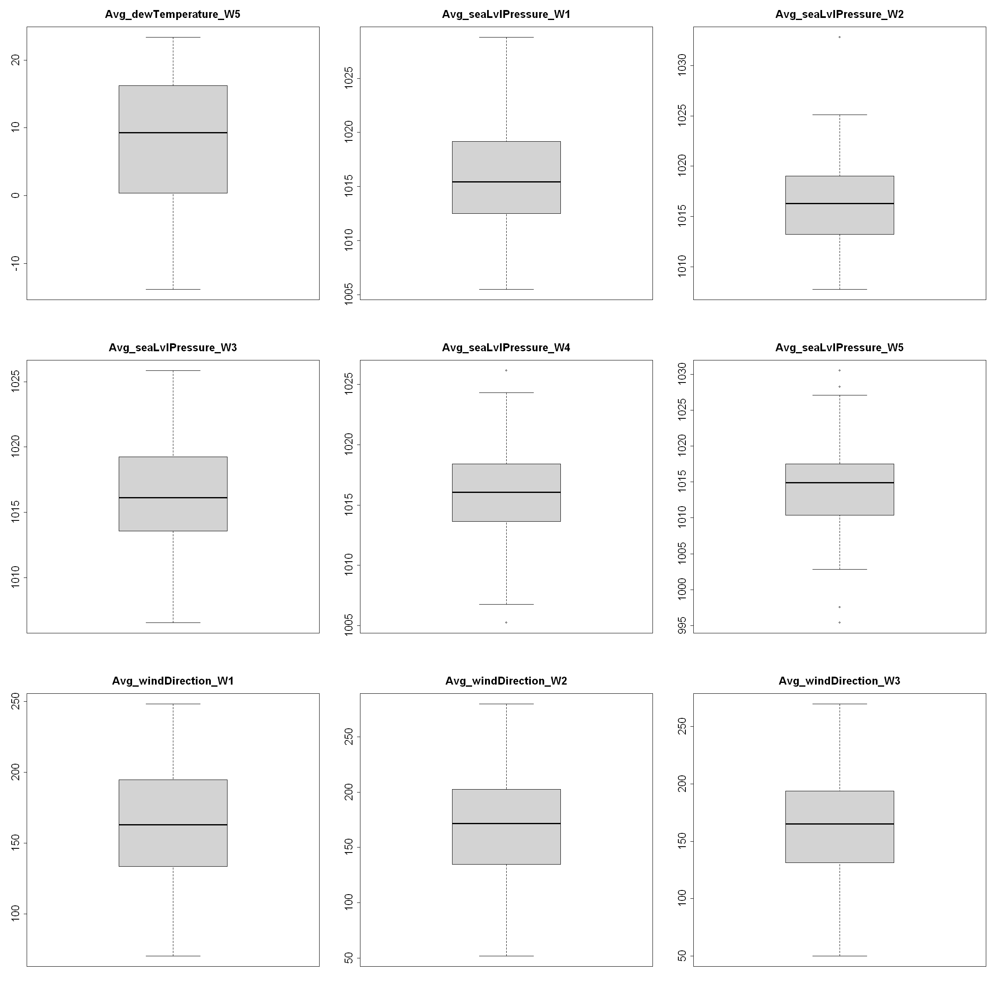

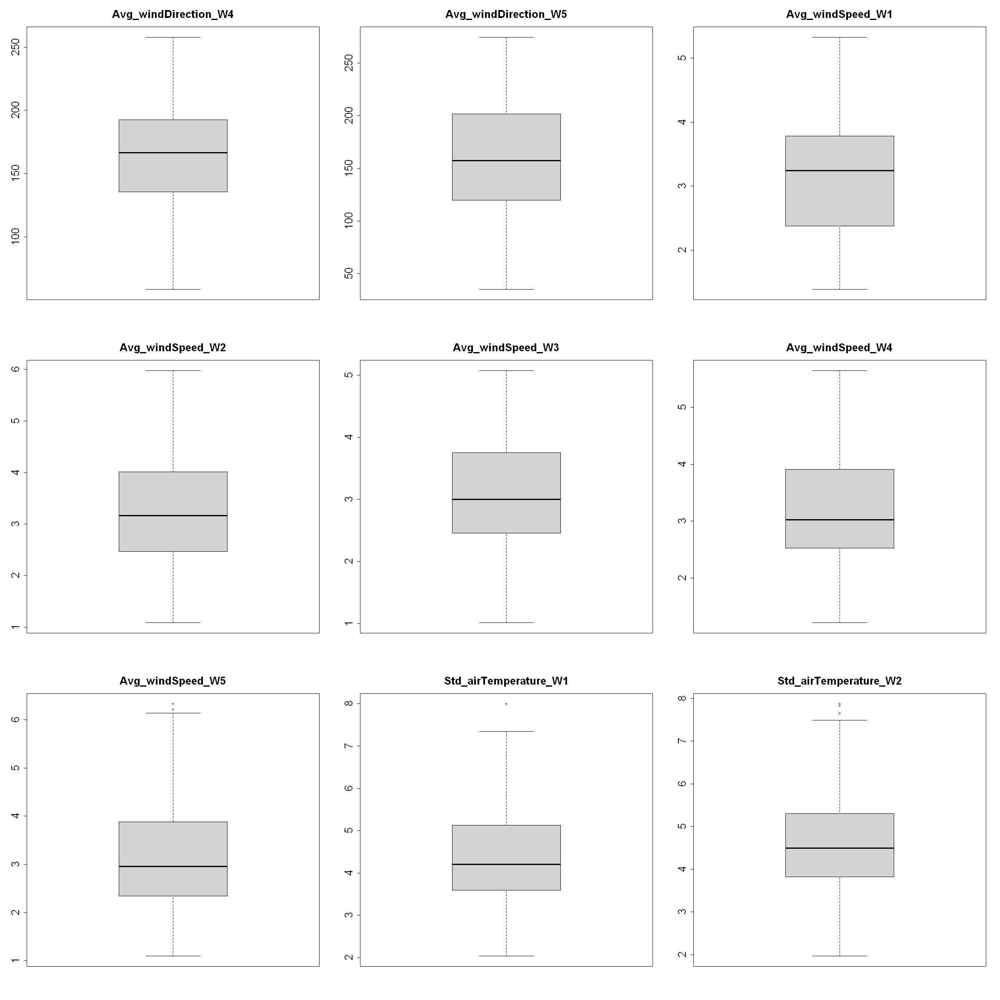

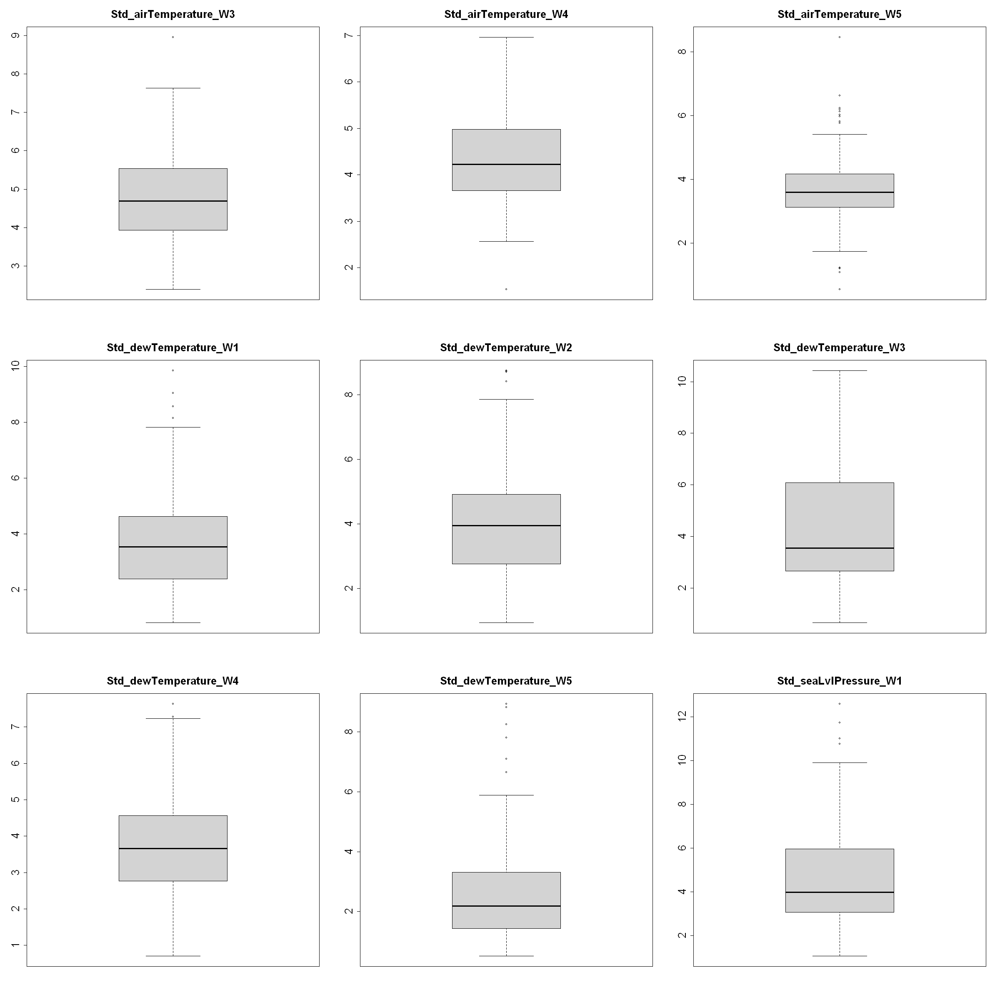

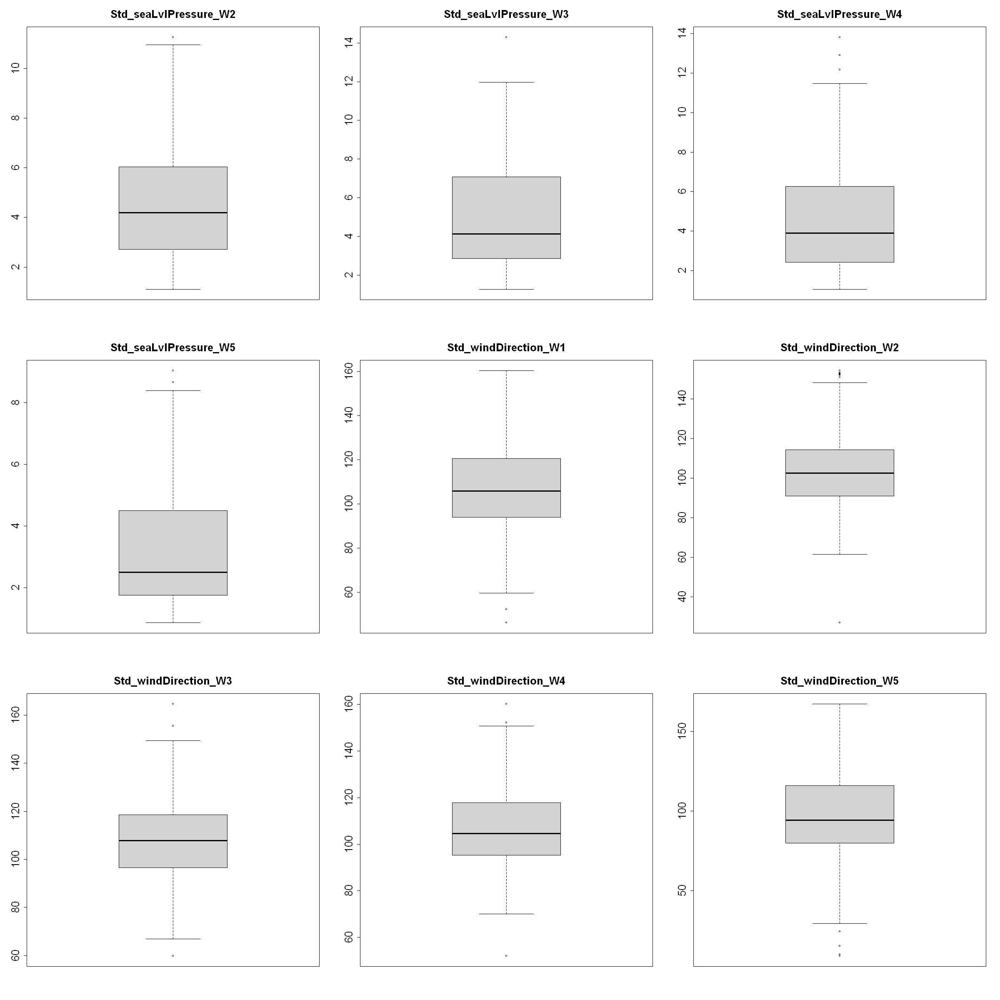

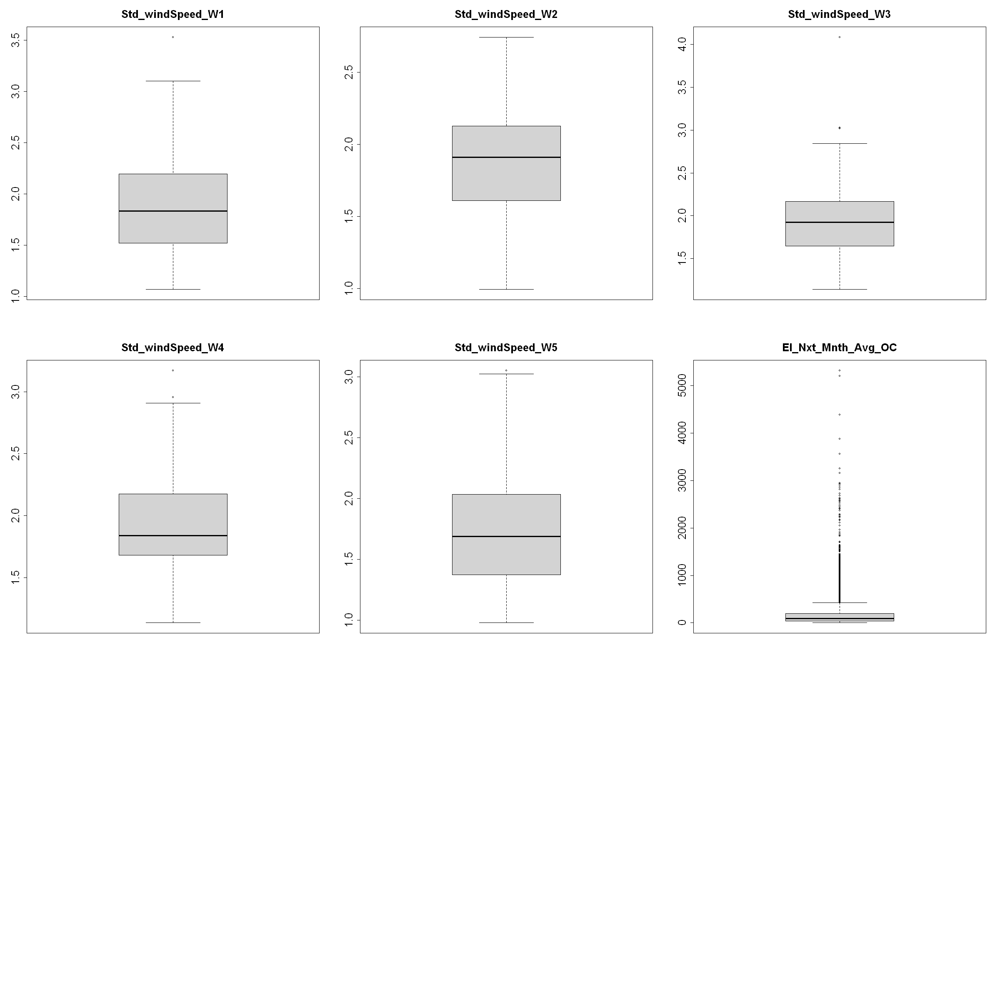

In [92]:
# With DF_BGP_nFc (only numeric - no factors) - olmoste the same
options(repr.plot.width = 20, repr.plot.height = 20)
par(mfrow=c(3,3))
for(v in 1:204) {
    boxplot(DF_BGP_nFc[[v]],main=names(DF_BGP_nFc[v]),cex.axis = 2,cex.main=2)
}
par(mfrow=c(1,1))


### E.1.4 Scater plot outliers against index - BIDm

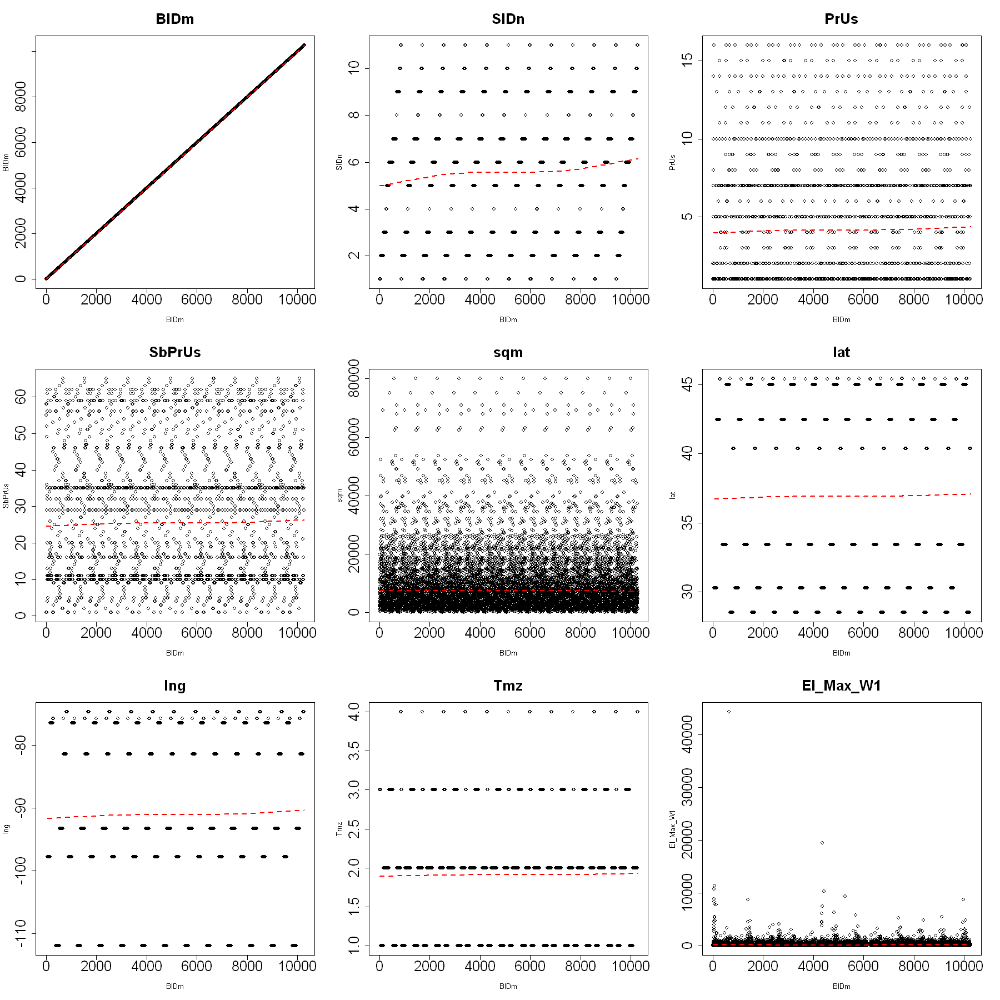

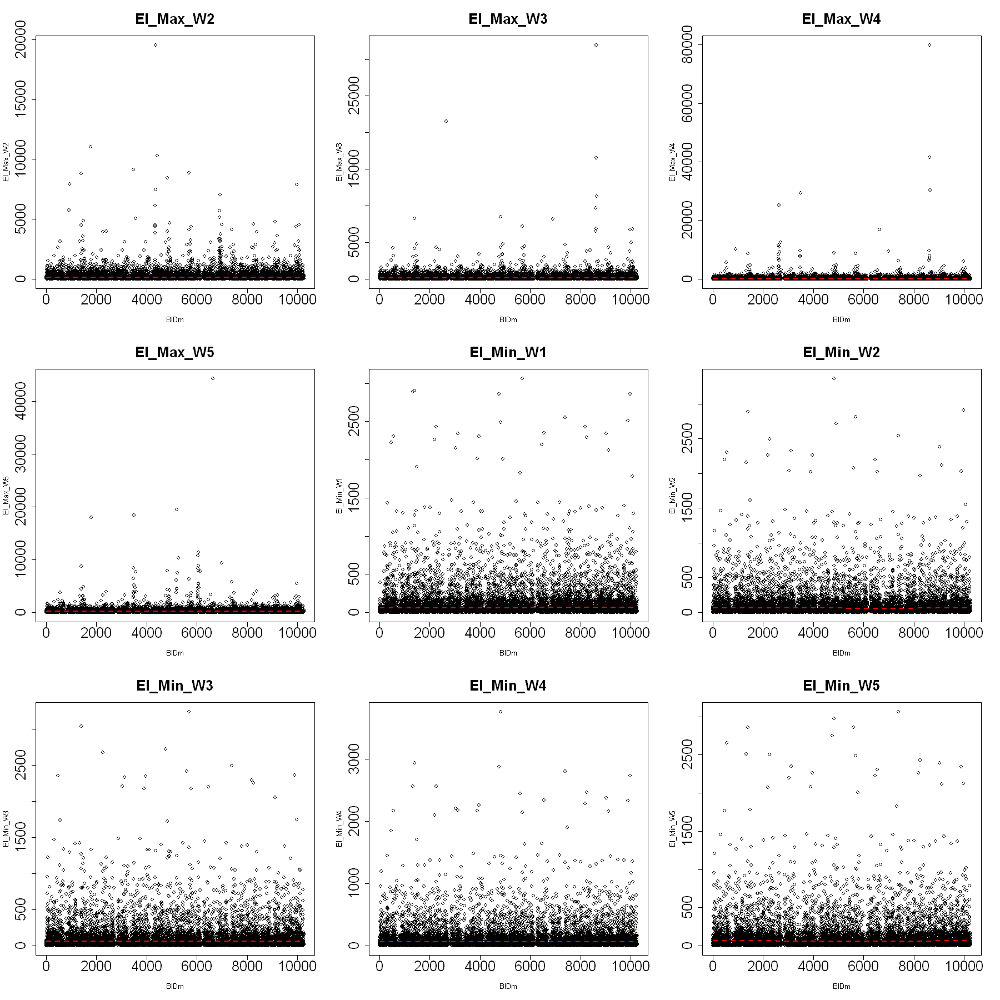

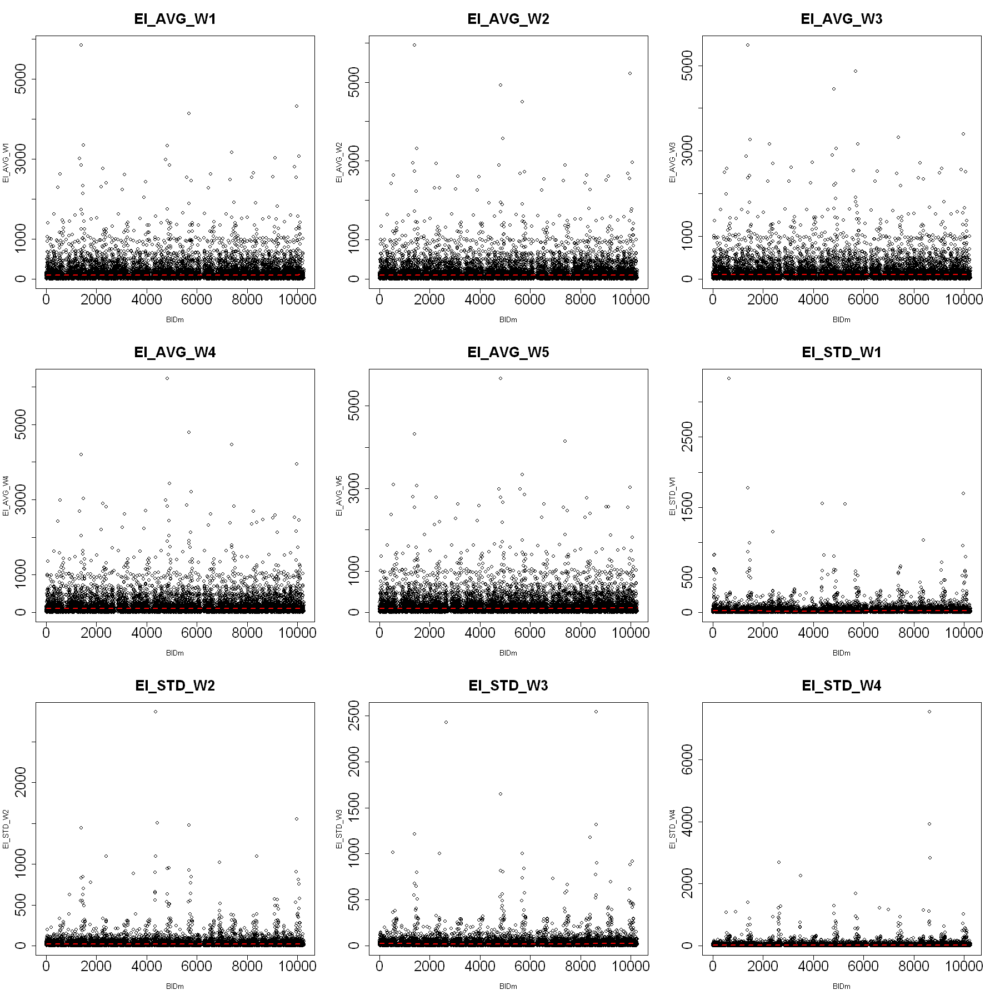

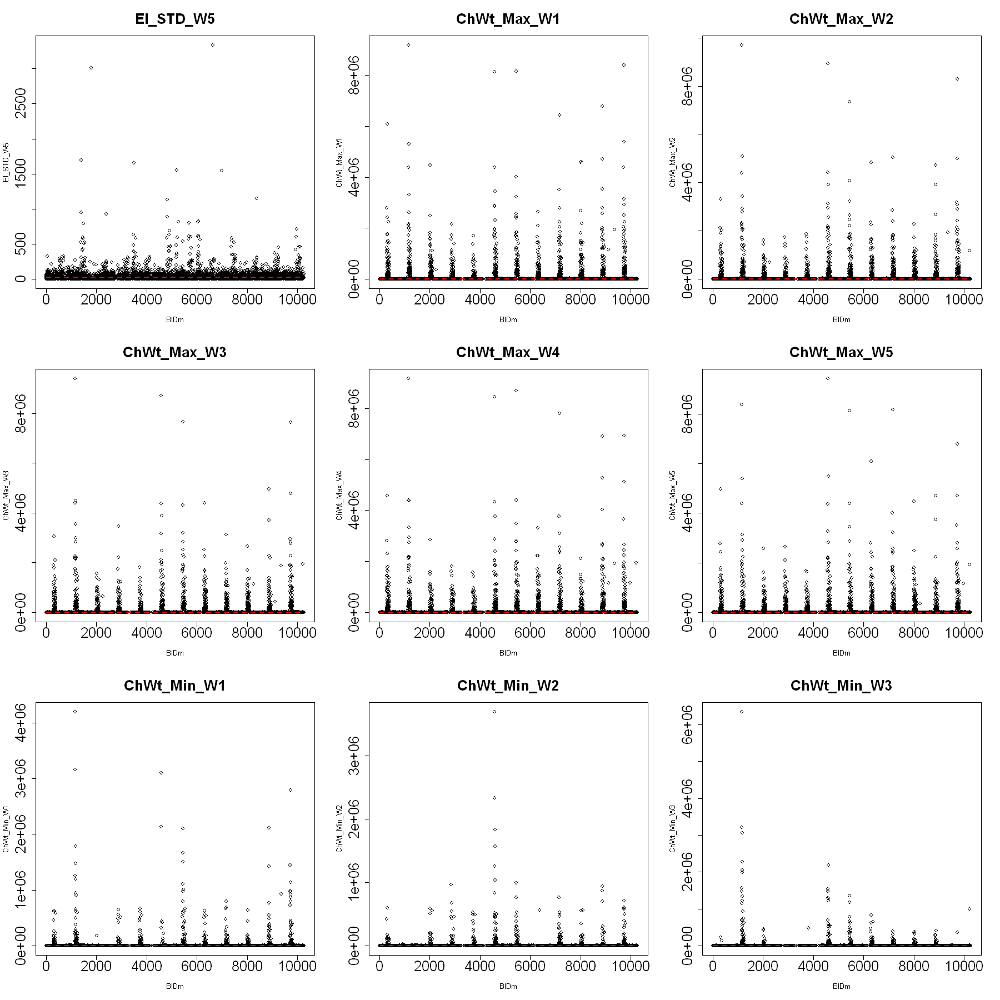

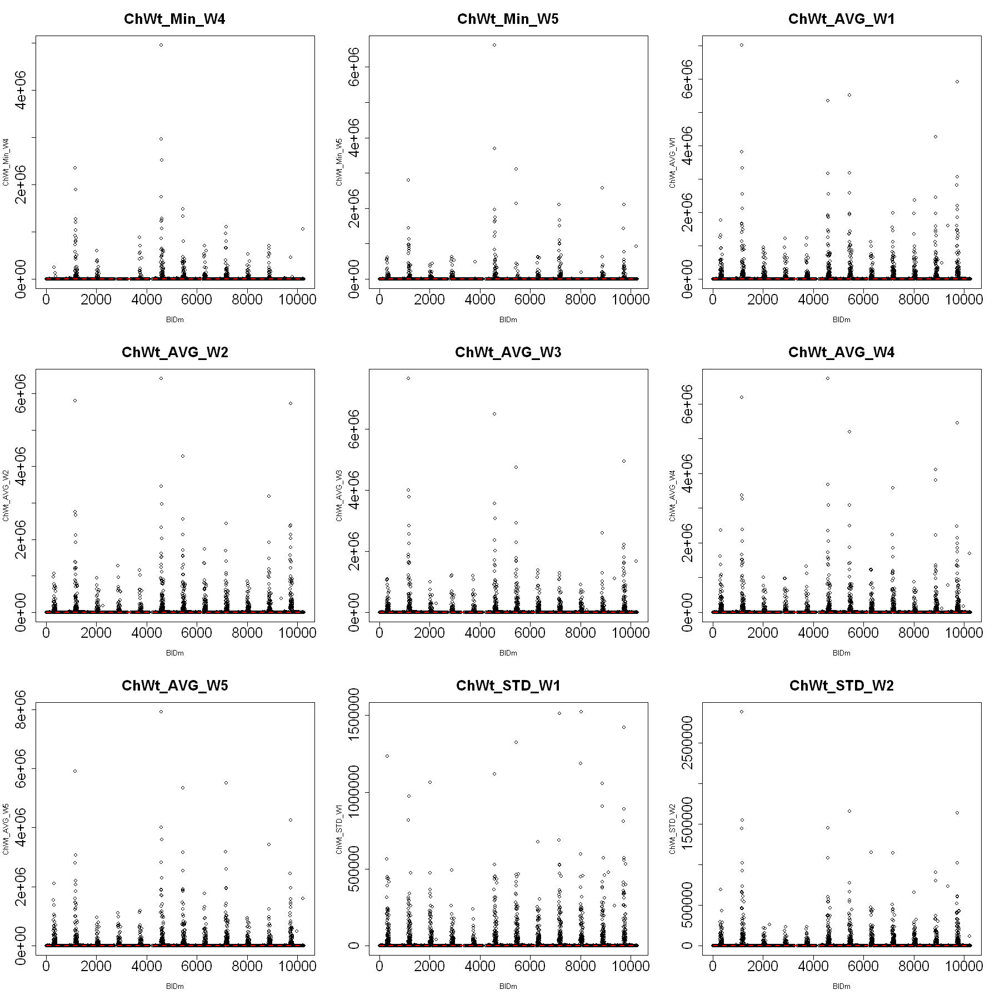

...

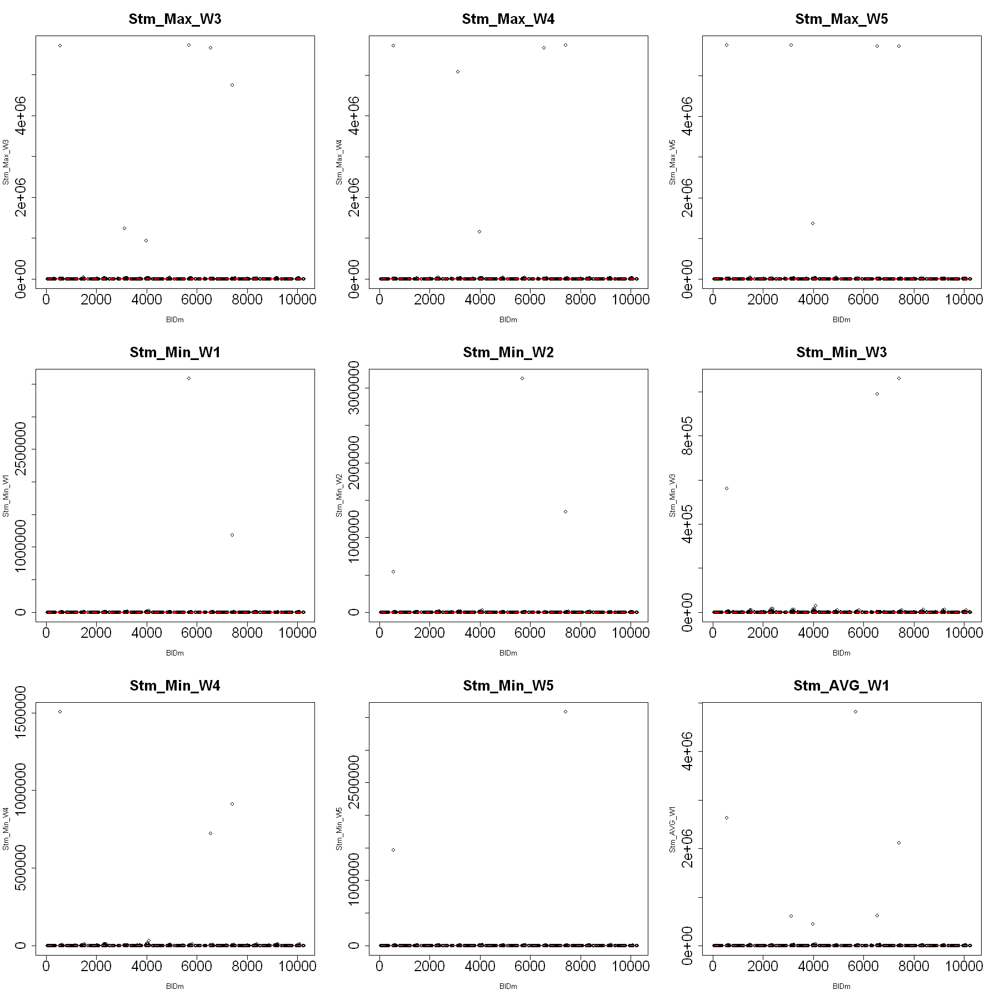

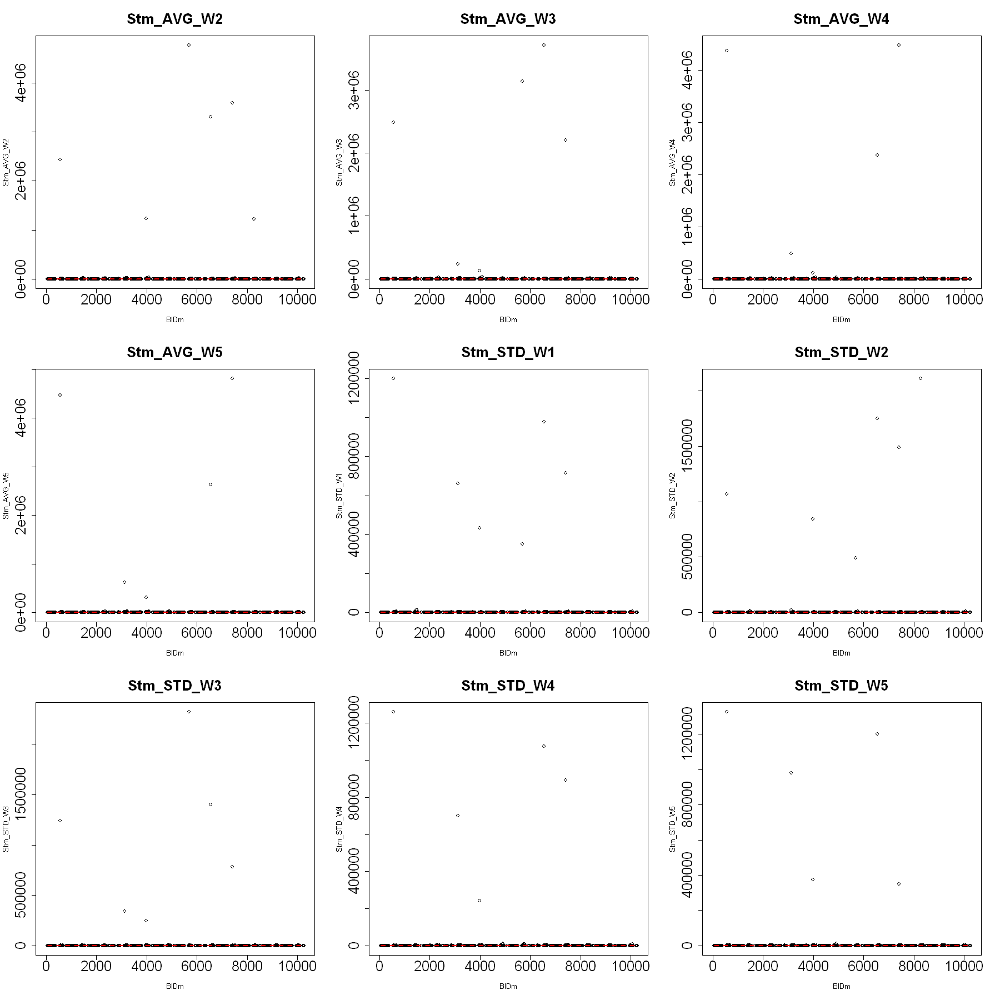

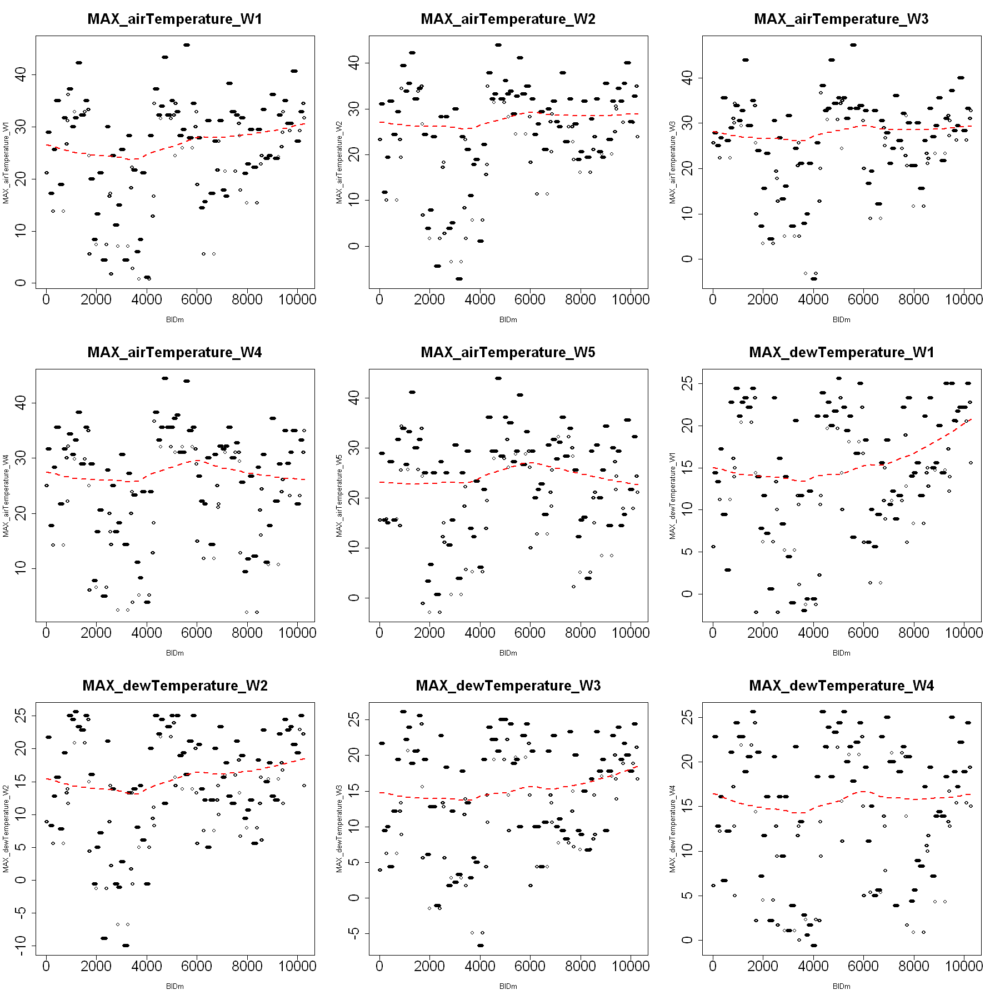

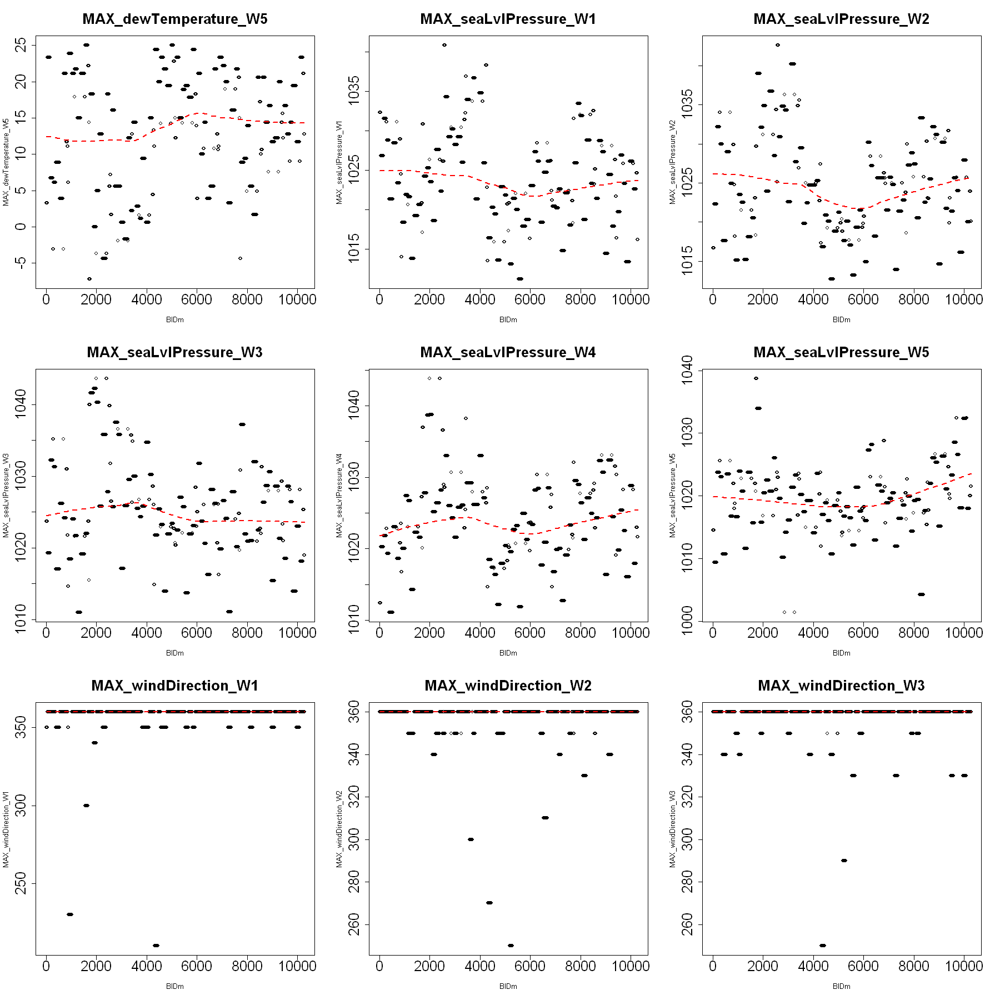

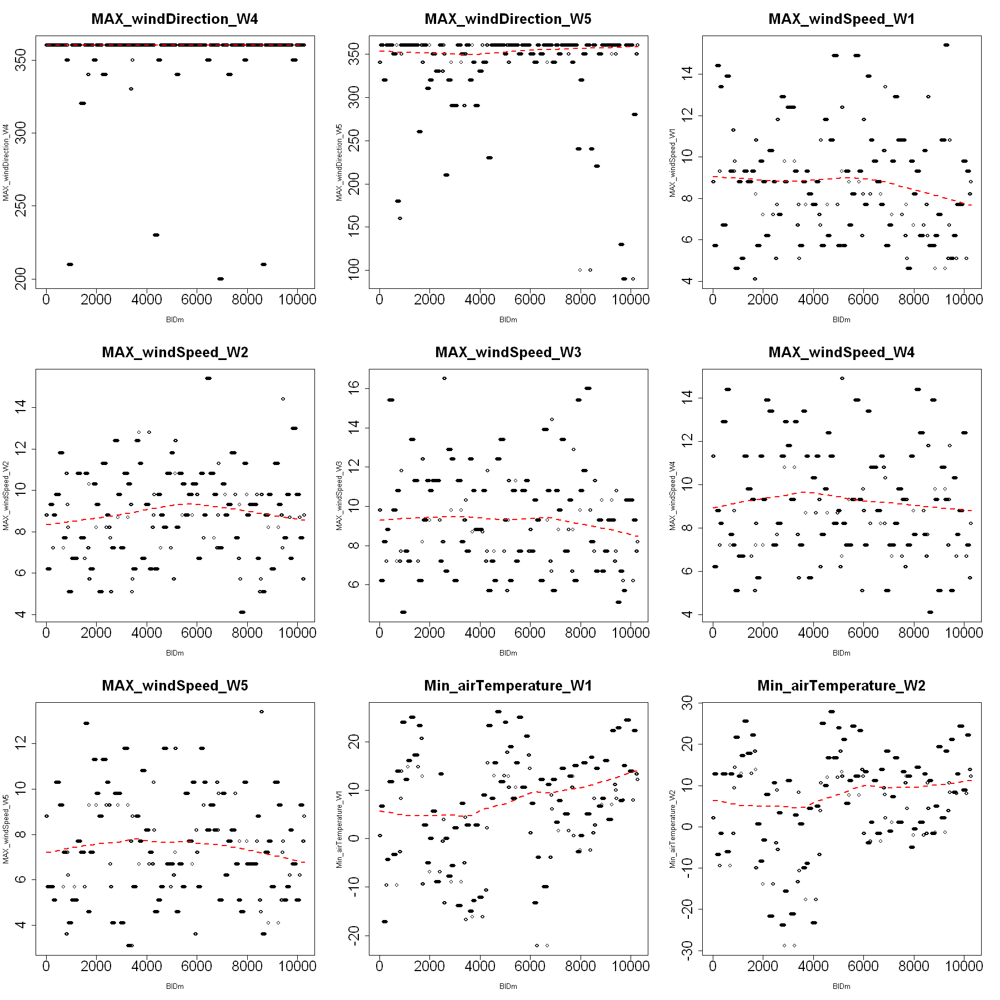

ERROR: Error in simpleLoess(y, x, w, span, degree = degree, parametric = FALSE, : NA/NaN/Inf in foreign function call (arg 1)


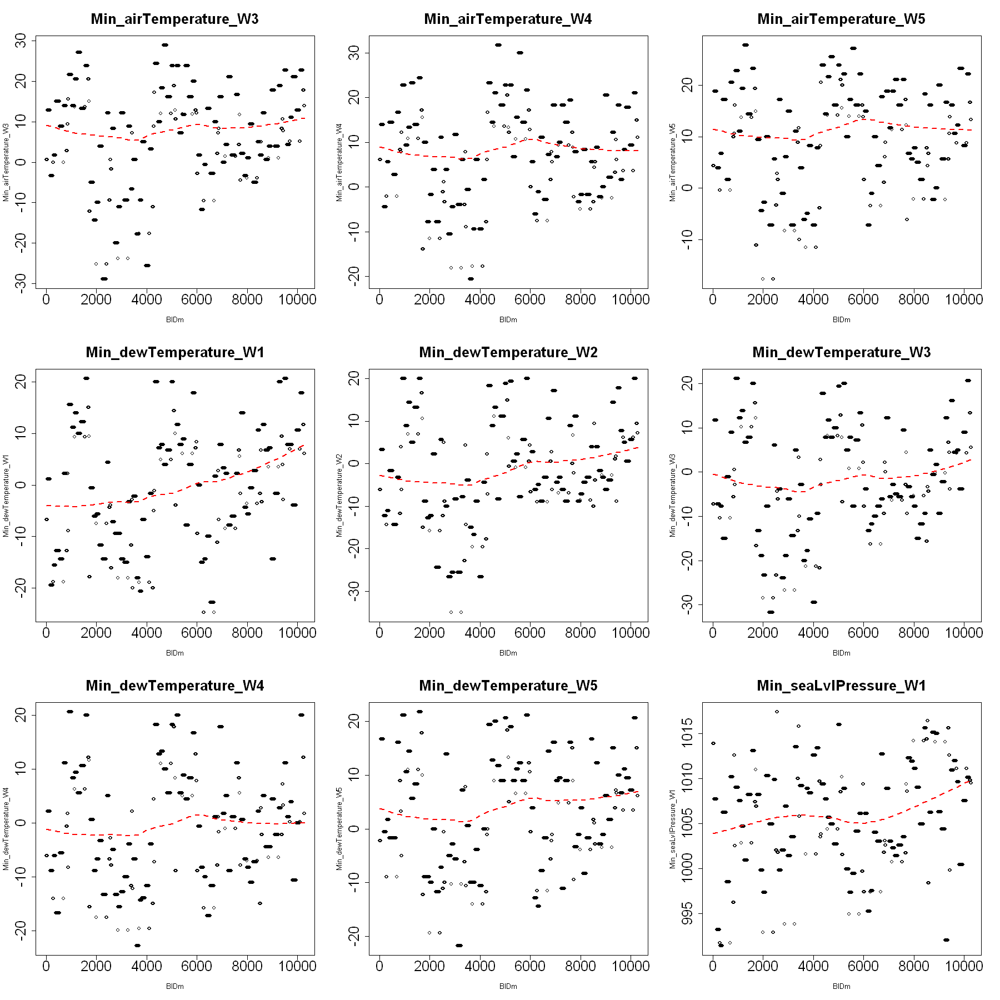

In [96]:
options(repr.plot.width = 15, repr.plot.height = 15)
par(mfrow=c(3,3))
for(v in names(DF_BGP_chFc)[1:209])
    {
        #print(v)
        #print(names(ShBo_Fc[v]))
        scatter.smooth(DF_BGP_chFc[[v]] ~ DF_BGP_chFc$BIDm, main=v, xlab="BIDm",ylab=v,,cex.axis = 2,cex.main=2, family="symmetric",
                  lpars =list(col = "red", lwd = 2, lty = 2))
    }
par(mfrow=c(1,1))


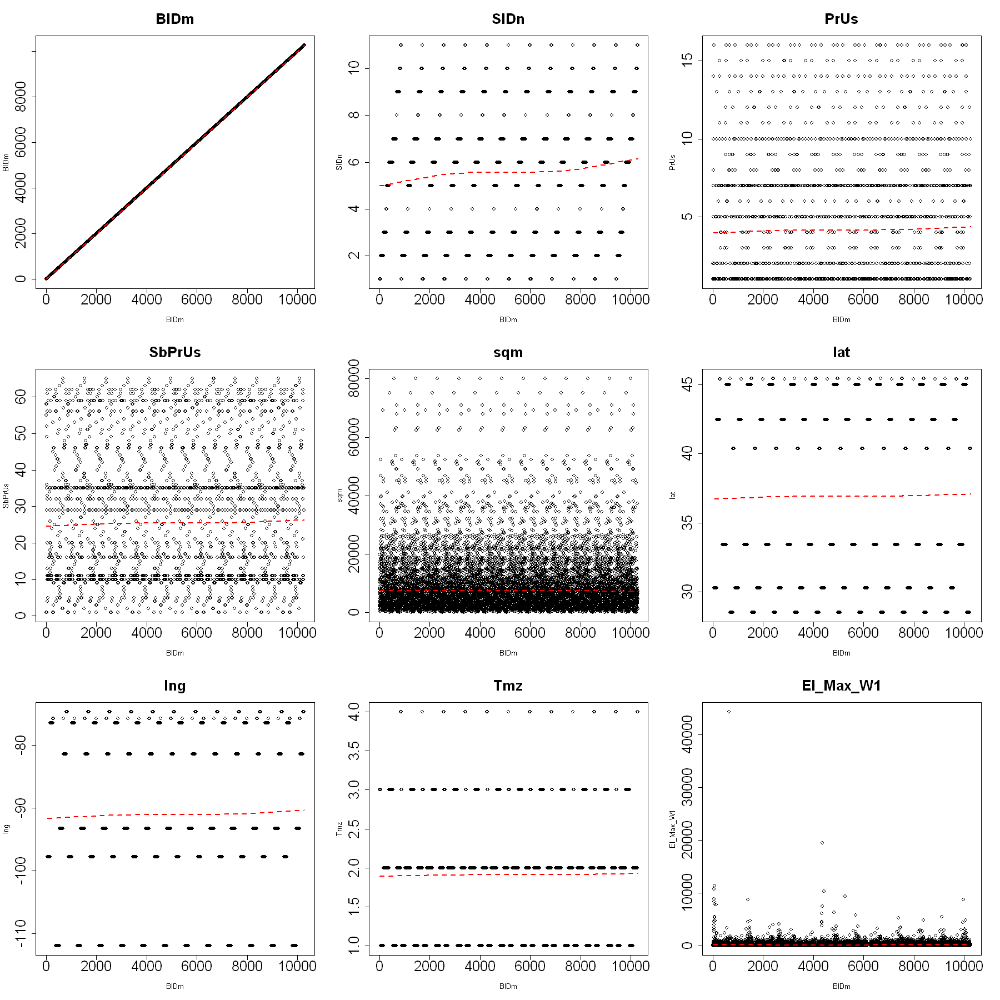

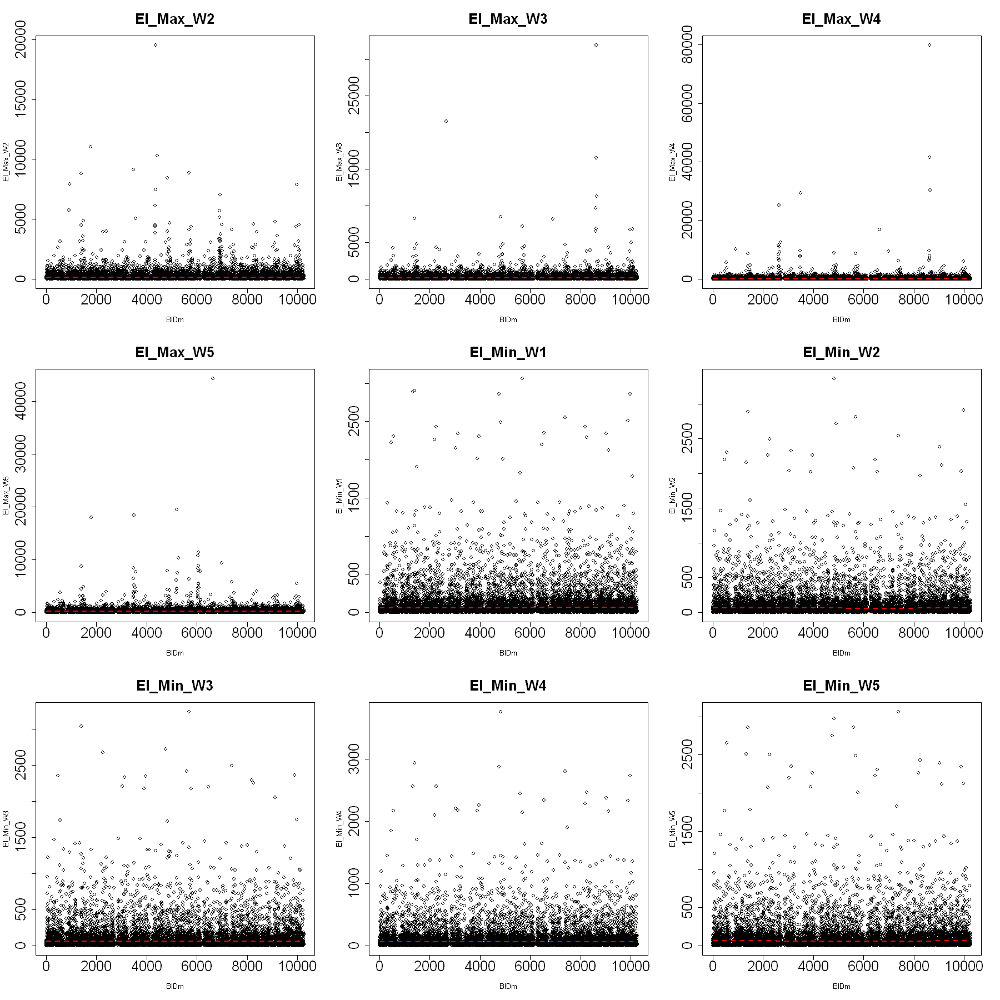

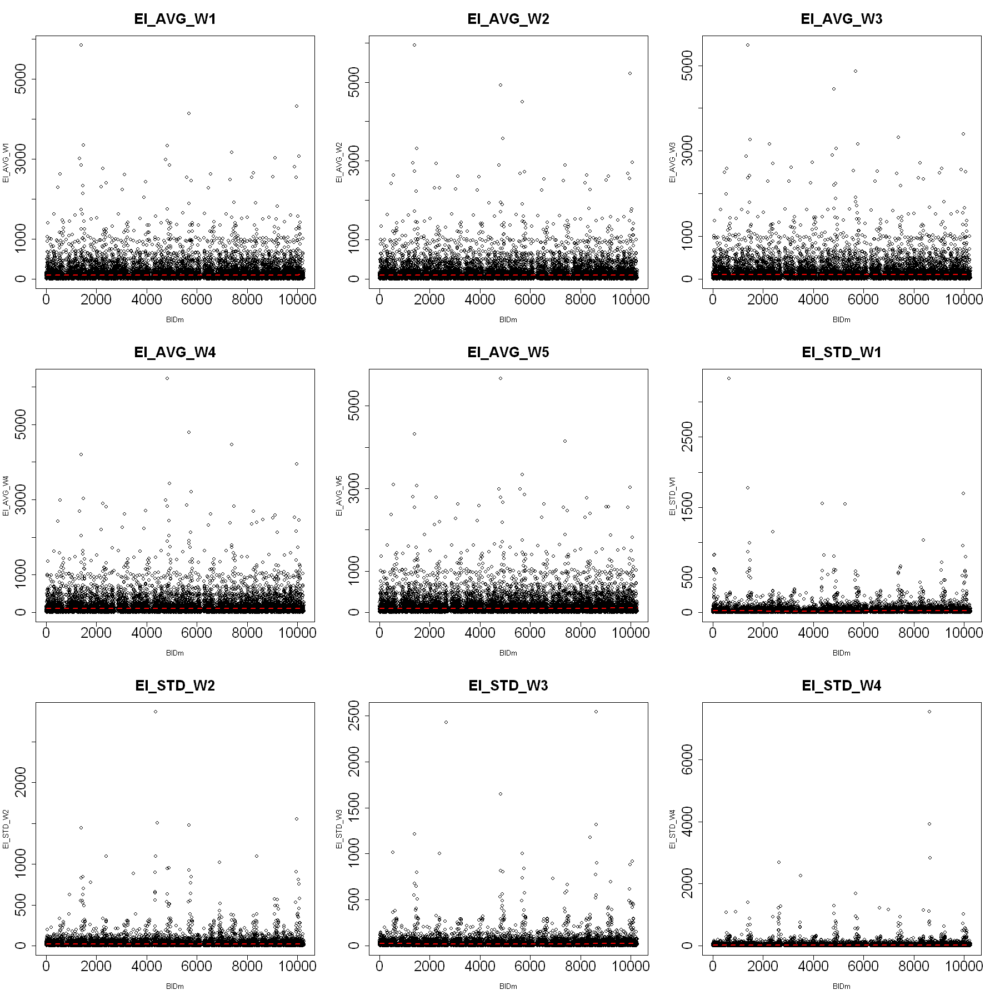

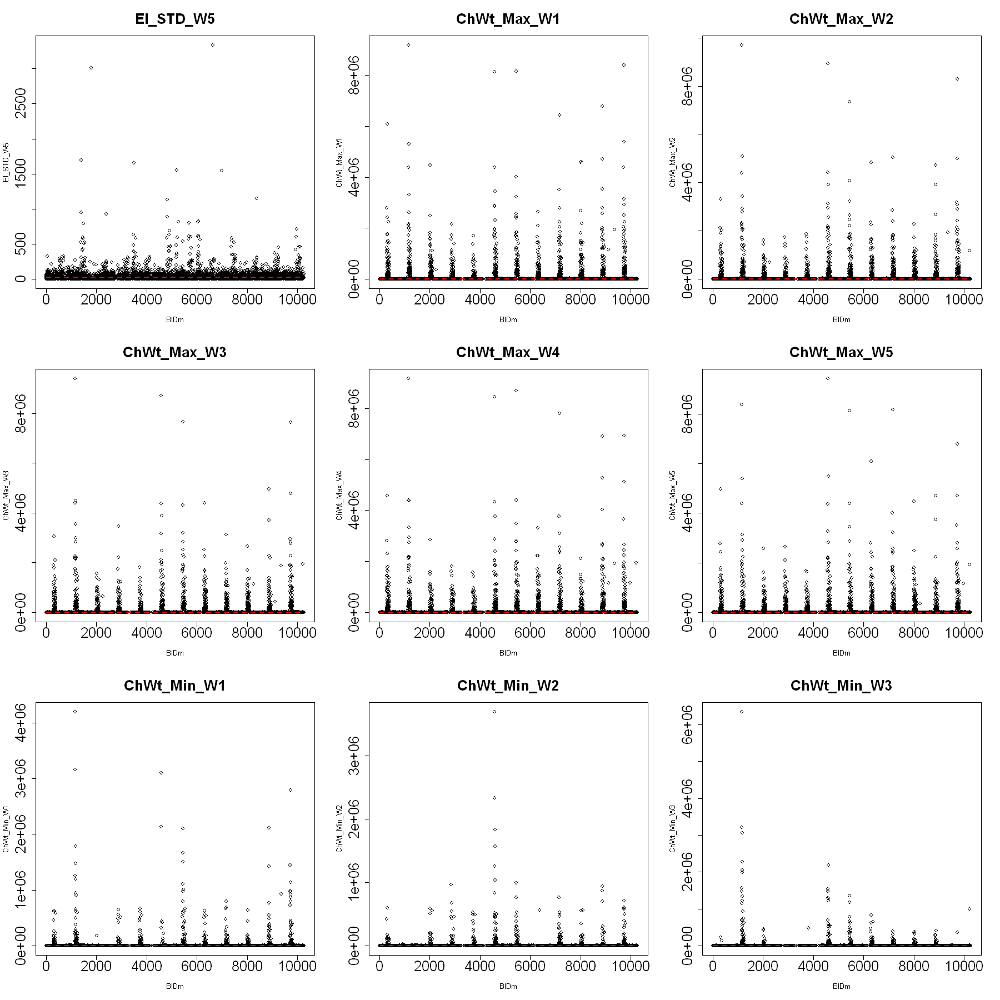

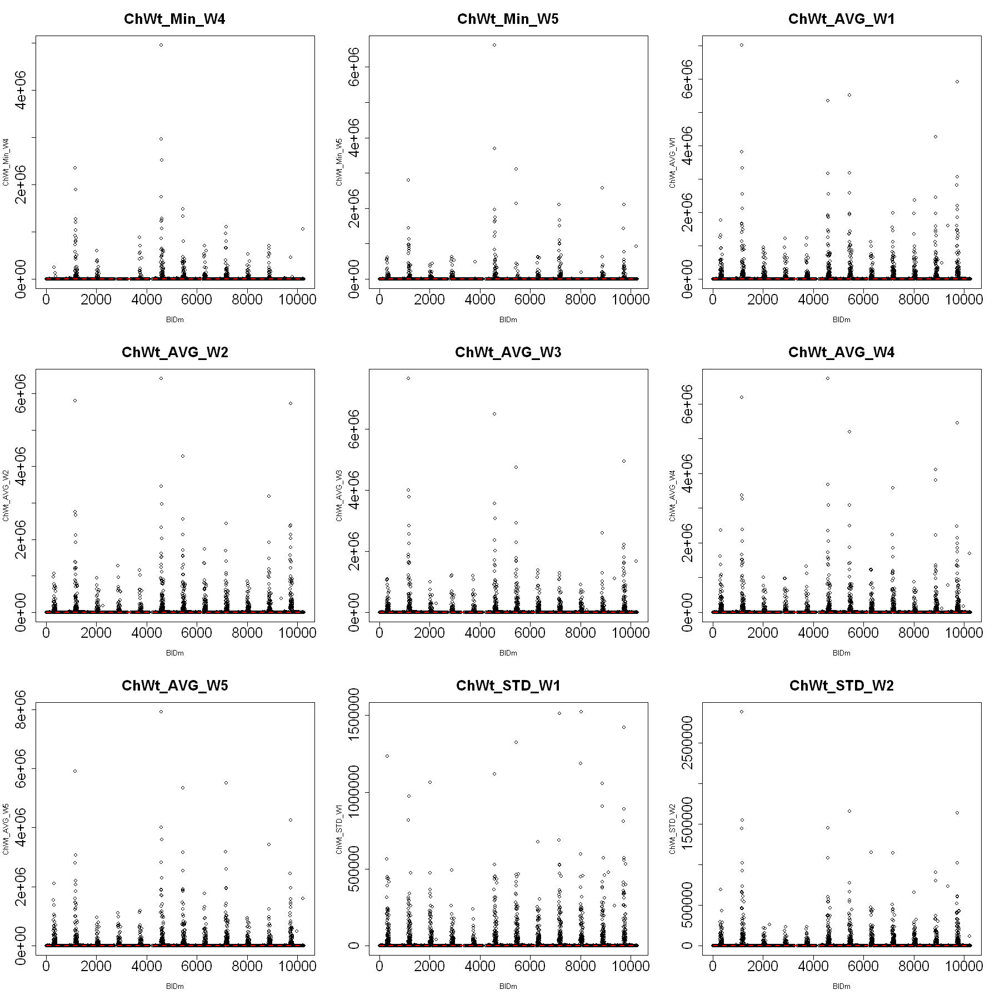

...

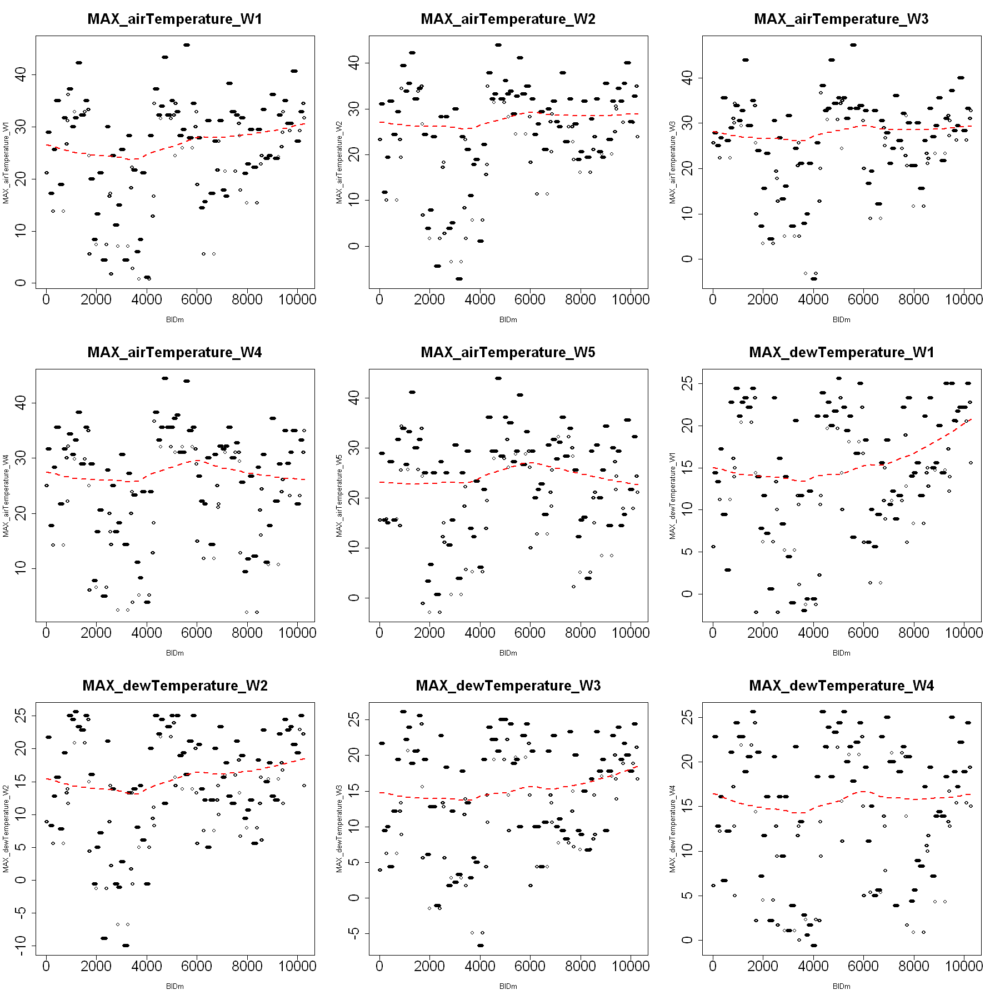

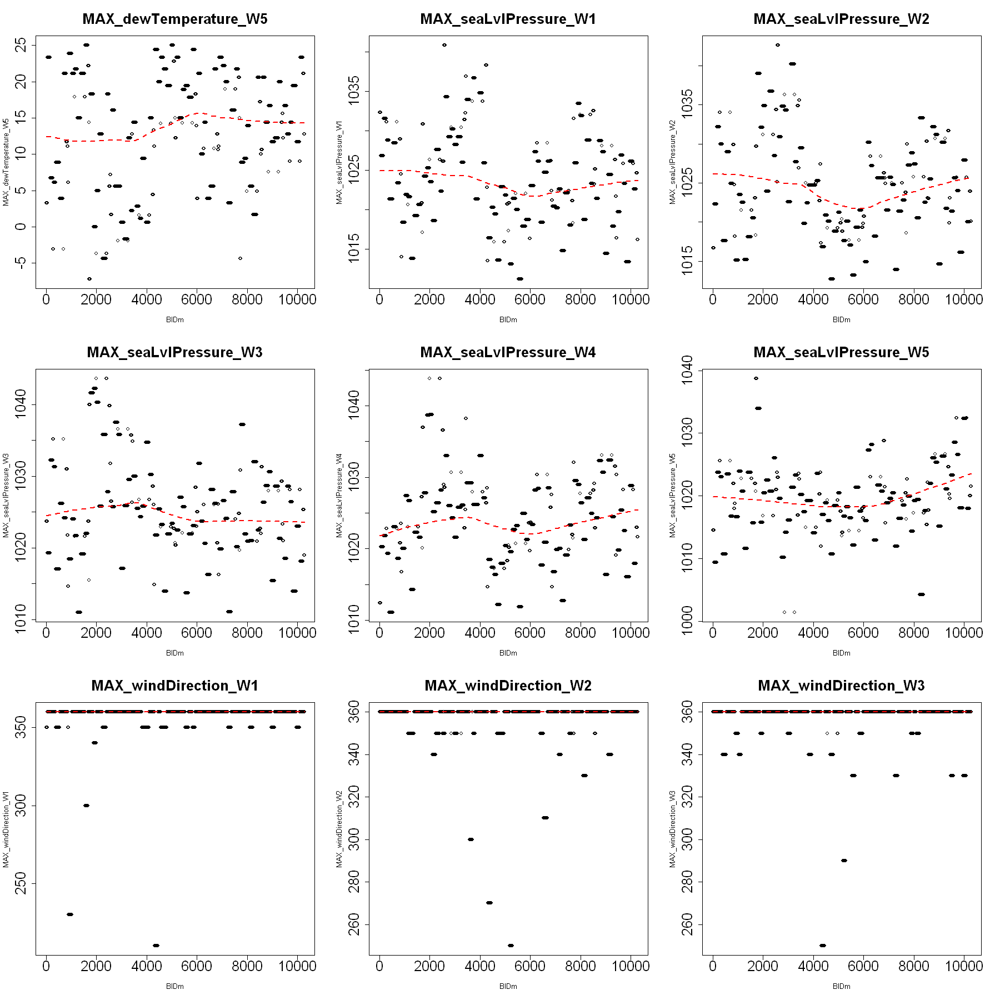

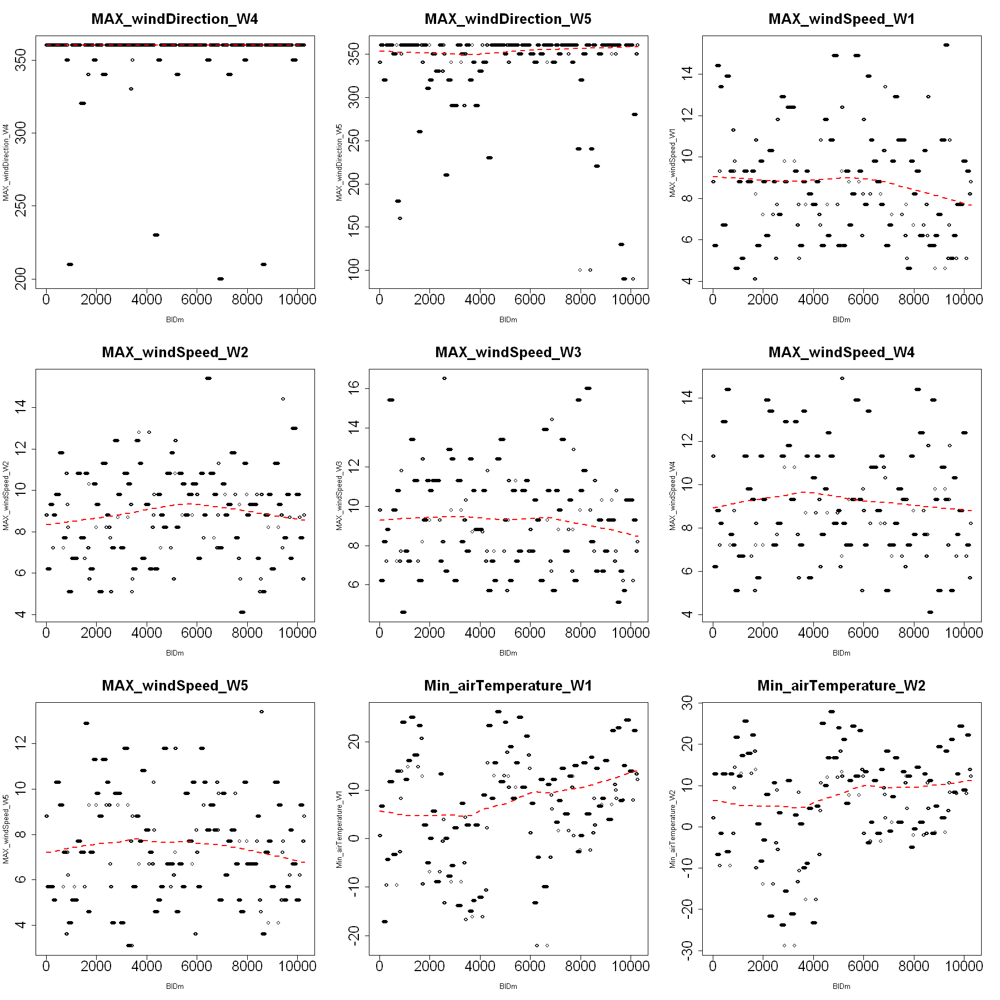

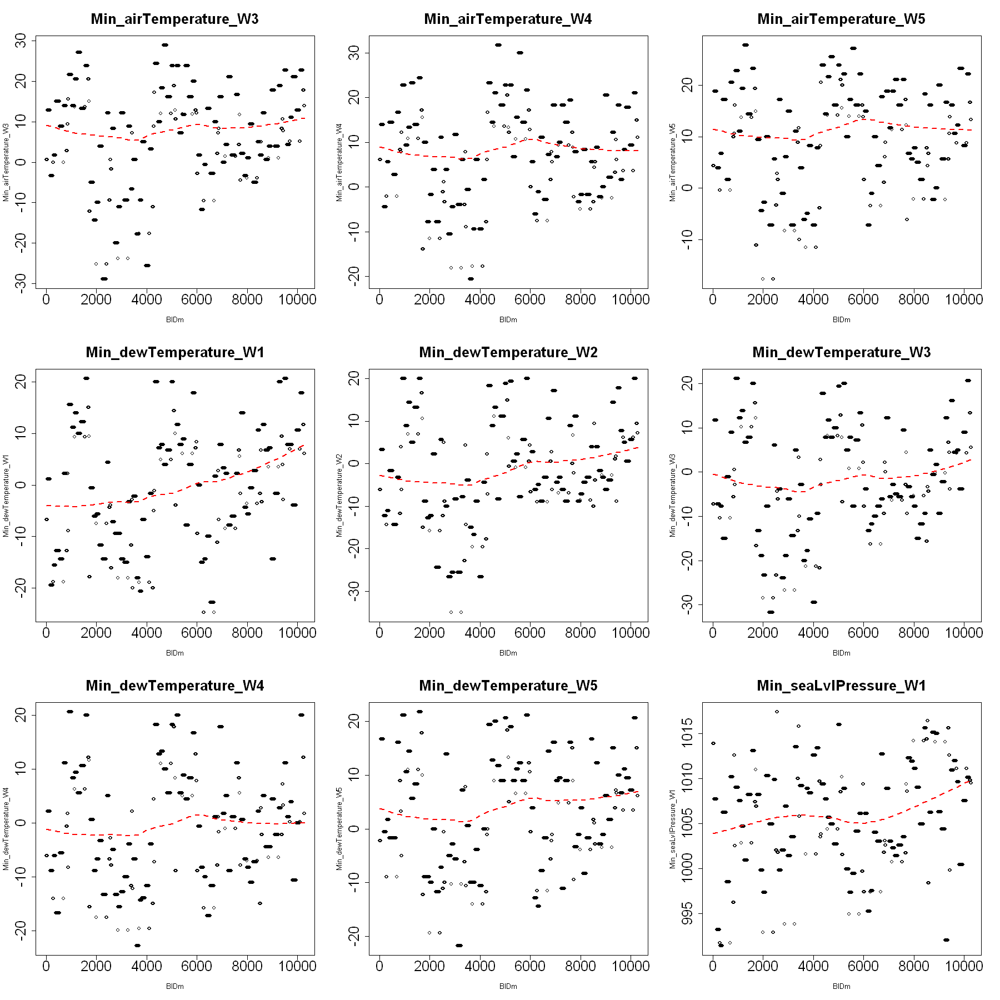

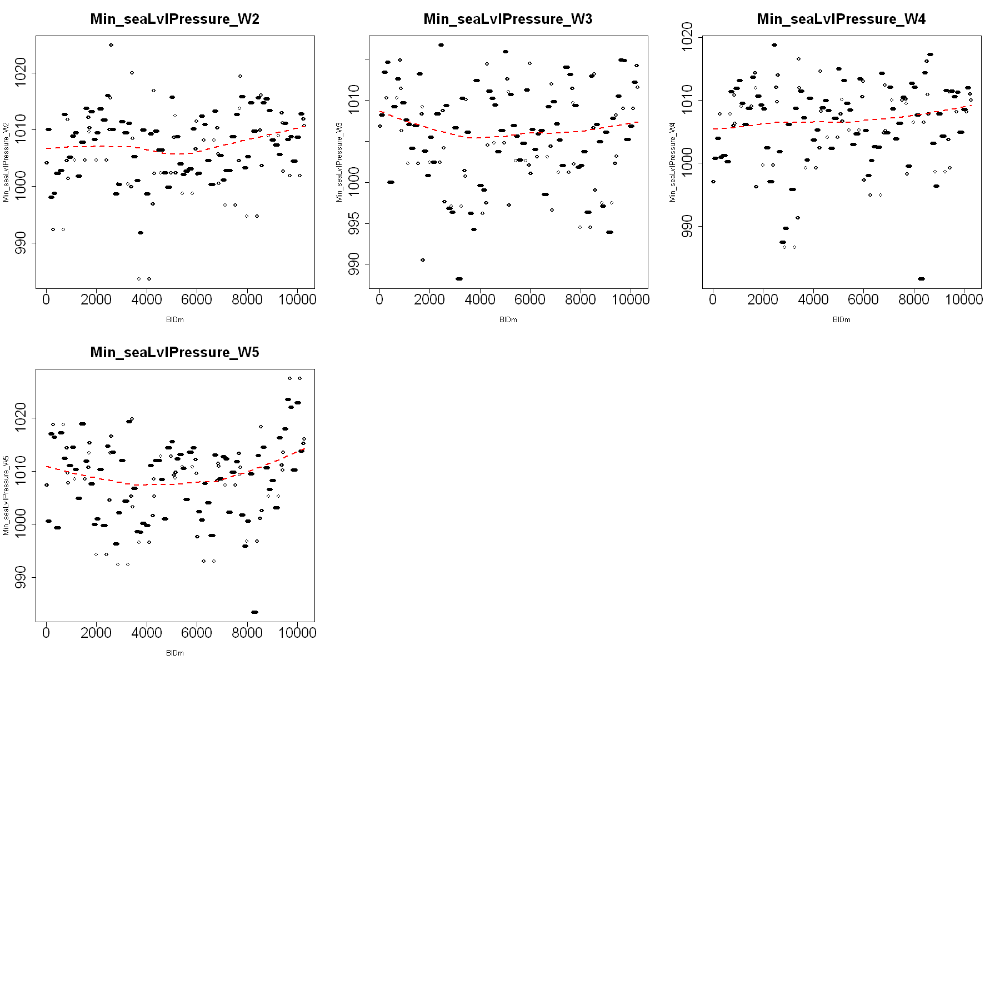

In [107]:
options(repr.plot.width = 15, repr.plot.height = 15)
par(mfrow=c(3,3))
for(v in names(DF_BGP_chFc)[1:148])
    {
        #print(v)
        #print(names(ShBo_Fc[v]))
        scatter.smooth(DF_BGP_chFc[[v]] ~ DF_BGP_chFc$BIDm, main=v, xlab="BIDm",ylab=v,,cex.axis = 2,cex.main=2, family="symmetric",
                  lpars =list(col = "red", lwd = 2, lty = 2))
    }
par(mfrow=c(1,1))


### 149-157 errorr (Min wind speed W1 -W4) ?

In [7]:
summary(DF_BGP_chFc[,c(149:157)])

 Min_windDirection_W1 Min_windDirection_W2 Min_windDirection_W3
 Min.   : 0.0000      Min.   : 0.0000      Min.   : 0.0000     
 1st Qu.: 0.0000      1st Qu.: 0.0000      1st Qu.: 0.0000     
 Median : 0.0000      Median : 0.0000      Median : 0.0000     
 Mean   : 0.2453      Mean   : 0.5432      Mean   : 0.4001     
 3rd Qu.: 0.0000      3rd Qu.: 0.0000      3rd Qu.: 0.0000     
 Max.   :30.0000      Max.   :60.0000      Max.   :20.0000     
 Min_windDirection_W4 Min_windDirection_W5 Min_windSpeed_W1   
 Min.   : 0.0000      Min.   :  0.00       Min.   :0.0000000  
 1st Qu.: 0.0000      1st Qu.:  0.00       1st Qu.:0.0000000  
 Median : 0.0000      Median :  0.00       Median :0.0000000  
 Mean   : 0.4459      Mean   :  8.09       Mean   :0.0008762  
 3rd Qu.: 0.0000      3rd Qu.:  0.00       3rd Qu.:0.0000000  
 Max.   :50.0000      Max.   :150.00       Max.   :0.5000000  
 Min_windSpeed_W2   Min_windSpeed_W3  Min_windSpeed_W4 
 Min.   :0.000000   Min.   :0.00000   Min.   :0.00000  

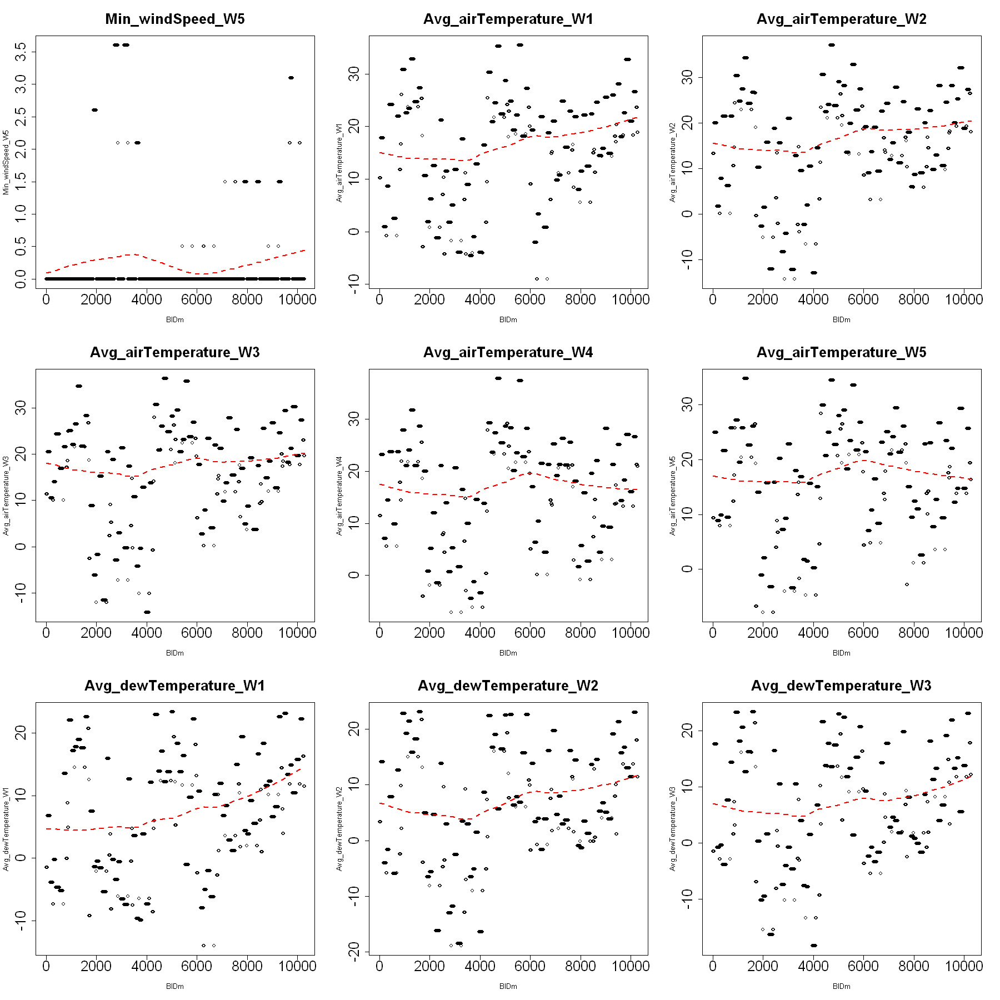

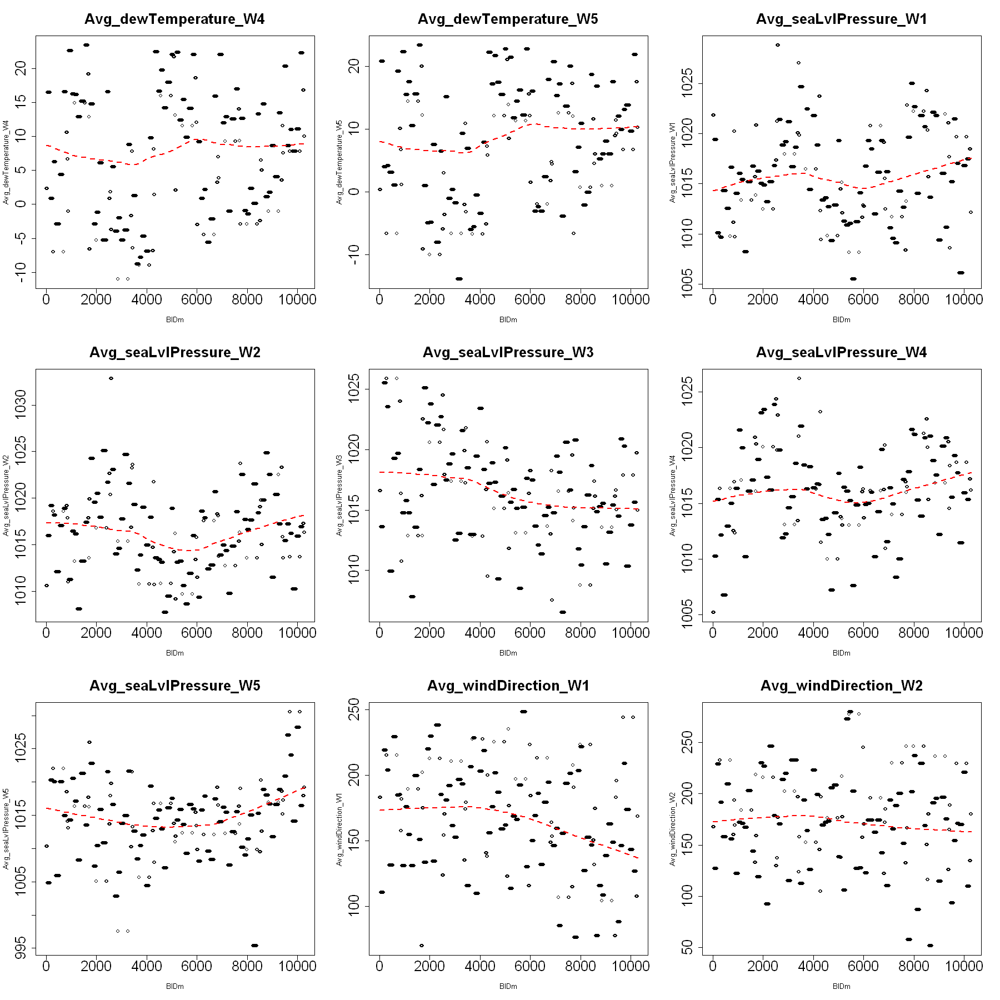

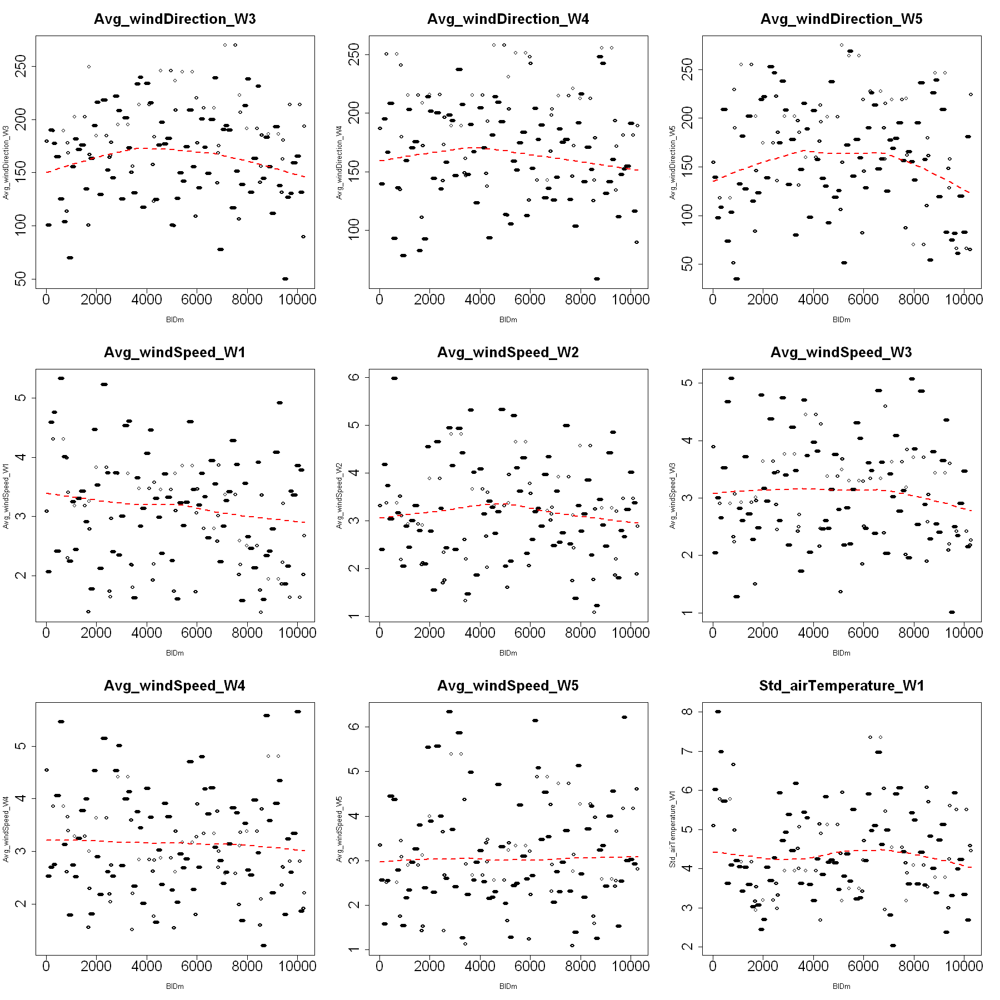

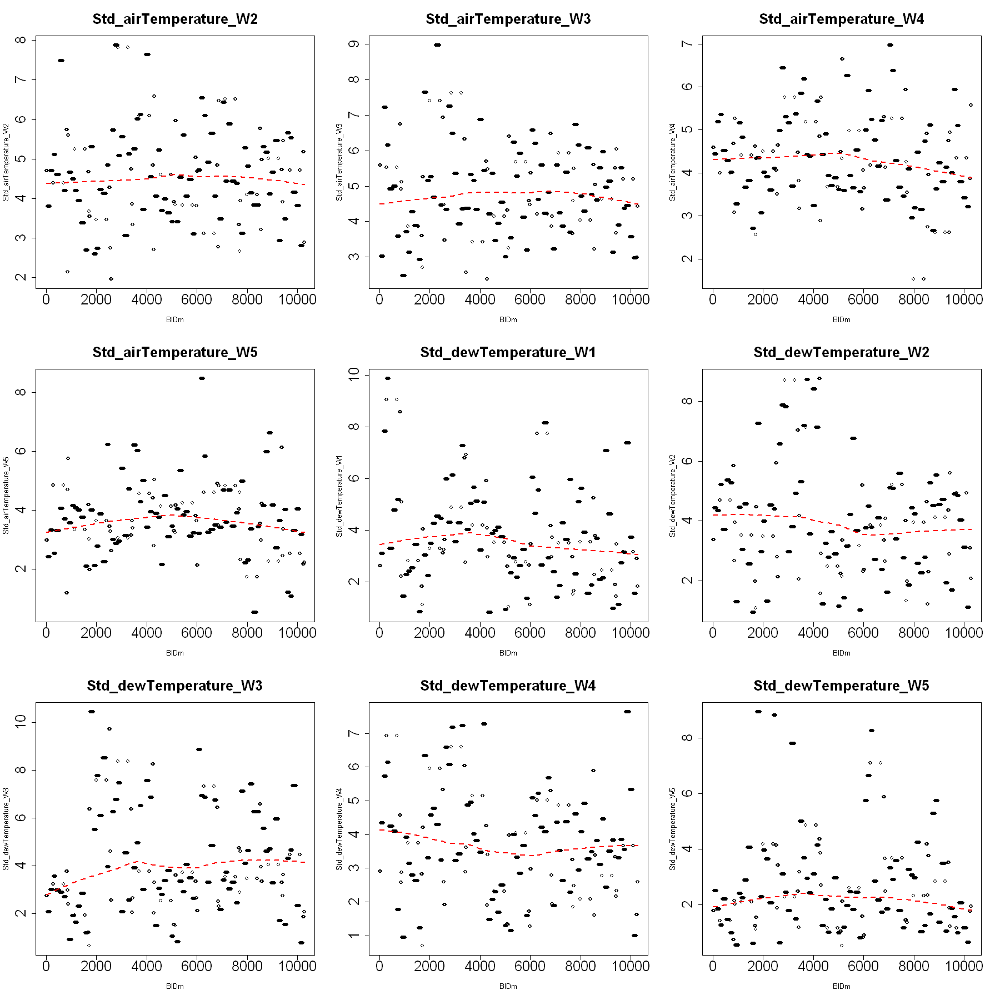

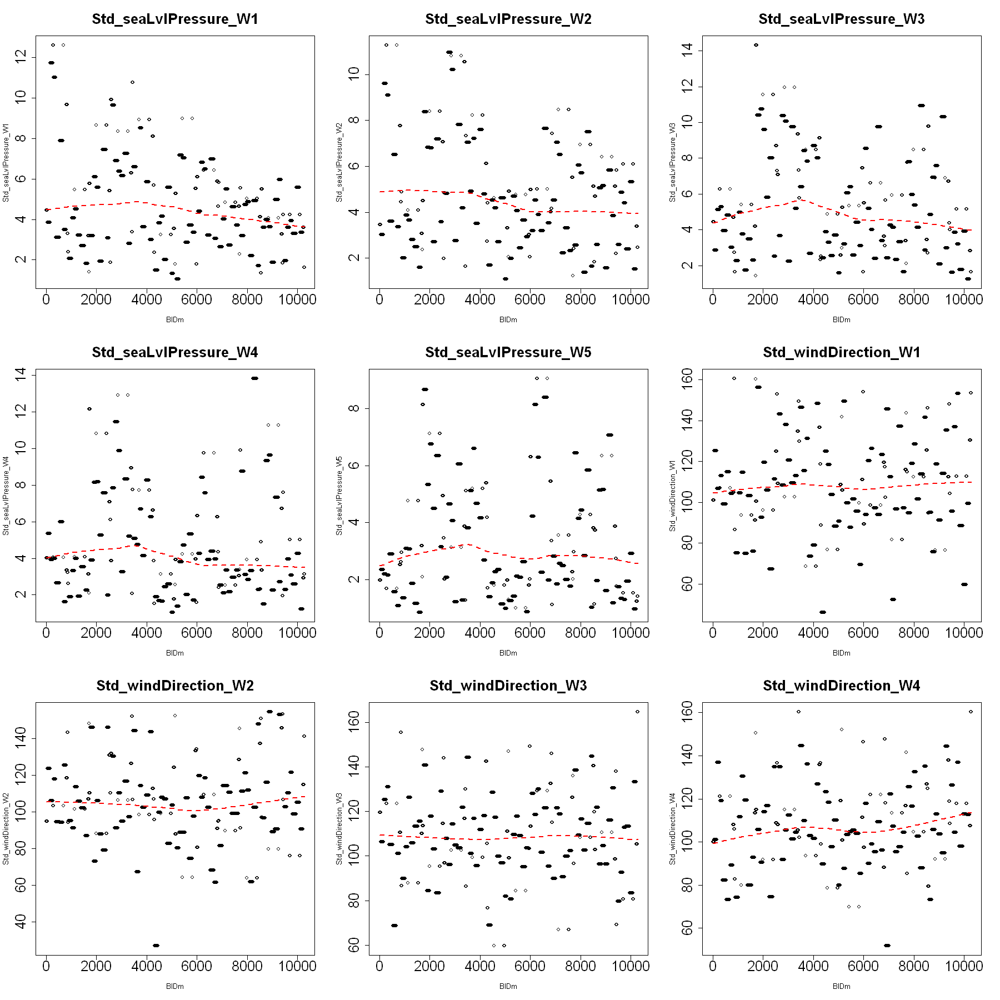

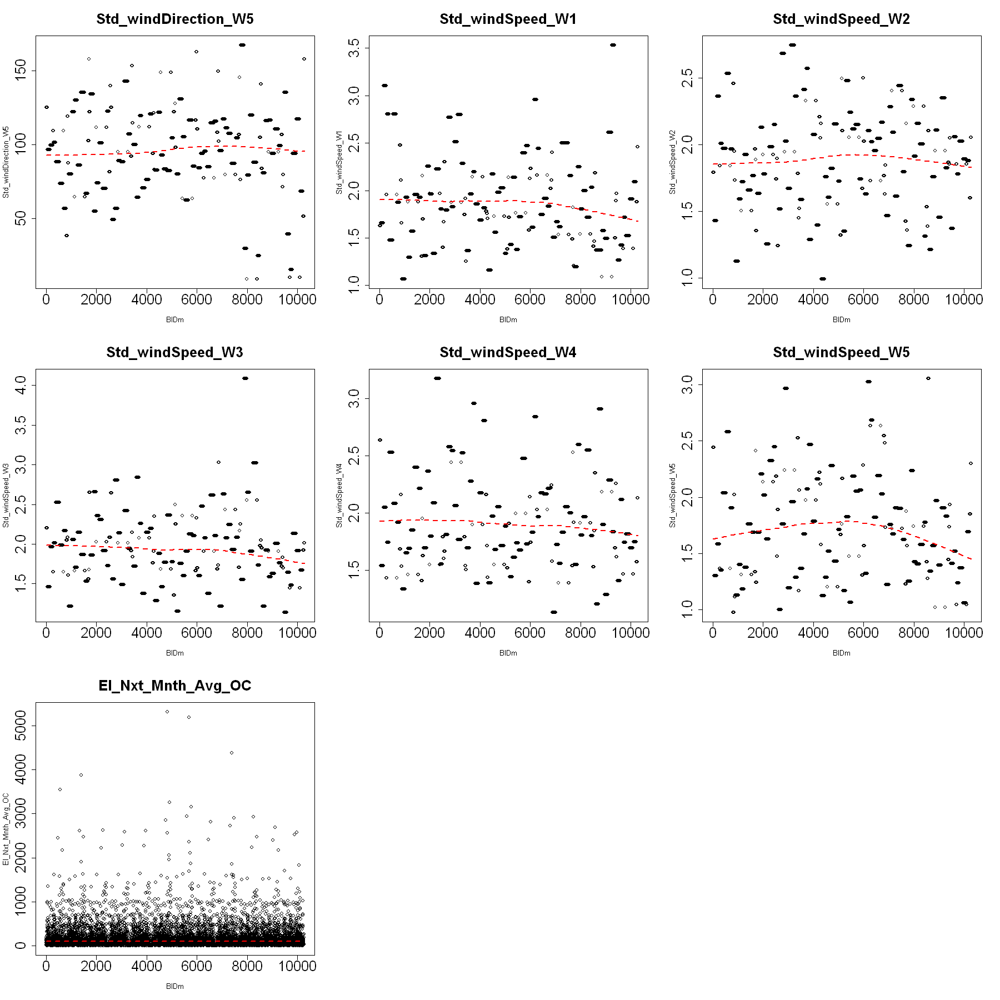

In [117]:
options(repr.plot.width = 15, repr.plot.height = 15)
par(mfrow=c(3,3))
for(v in names(DF_BGP_chFc)[158:209])
    {
        #print(v)
        #print(names(ShBo_Fc[v]))
        scatter.smooth(DF_BGP_chFc[[v]] ~ DF_BGP_chFc$BIDm, main=v, xlab="BIDm",ylab=v,,cex.axis = 2,cex.main=2, family="symmetric",
                  lpars =list(col = "red", lwd = 2, lty = 2))
    }
par(mfrow=c(1,1))


## #################
### Up to here - univariant outliers tritmen
## #################

## E.2. Multivariate Outliers - pairs

### Detecting multivariate outliers using DBSCAN

 

In [20]:
?dbscan

In [19]:
## dbscan
library(dbscan)
# normalize the numbers

In [20]:
DF_BGP_nFc.norm <- sapply(DF_BGP_nFc[,2:ncol(DF_BGP_nFc)], minmax)

In [21]:
DF_BGP_nFc.norm

lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,El_Min_W3,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
NA,NA,0.0033211313,0.0066172996,0.0053563518,0.0013678249,0.0021848182,0.0173896958,0.0126753599,1.054303e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0106864856
NA,NA,0.0050747671,0.0103521197,0.0103608974,0.0027514455,0.0049732728,0.0288201439,0.0270583633,2.263512e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0204297281
NA,NA,0.0006905649,0.0017738730,0.0011703901,0.0004573206,0.0005611003,0.0060408938,0.0051642029,3.475652e-03,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0038559856
NA,NA,0.0040259689,0.0092245495,0.0069540472,0.0040614785,0.0086271460,0.0138789154,0.0120419963,1.189655e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0360315212
NA,NA,0.0021539204,0.0052908670,0.0050117509,0.0012909780,0.0023625523,0.0120827021,0.0106295658,1.042869e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0105628817
NA,NA,0.0032843670,0.0071293190,0.0047219728,0.0023080400,0.0028222236,0.0233498581,0.0154229091,1.490953e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0132377149
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,NA
NA,NA,0.0045785615,0.0111209176,0.0121778843,0.0026072792,0.0042853513,0.0201656618,0.0176917186,1.807702e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0248598532
NA,NA,0.0051255154,0.0120050351,0.0111362496,0.0029676950,0.0048999719,0.0214719987,0.0222263640,2.433476e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0225500799
NA,NA,0.0008852105,0.0017692602,0.0009990169,0.0004118142,0.0006307924,0.0011911180,0.0005403513,2.370830e-04,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0013677565


In [123]:
write.csv(DF_BGP_nFc.norm, file="90-DF_BGP_nFcNorm-MultV-OL-25052022.csv")

### E.2.1 preparing the dataframe 
##### (used the Clean Flat File data frame as it dbscan won't work with no compleat rows in the dataframe)

In [33]:
notFnames<-names(Filter(is.numeric, DF_BGP_CFF))

In [35]:
DF_BGP_CFF_nFc <- DF_BGP_CFF[,colnames(DF_BGP_CFF) %in% notFnames] 

In [36]:
DF_BGP_CFF_nFc

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2053.2,45.4215,-75.6972,147.2500,129.1300,171.0000,109.1300,96.8699,53.2500,42.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
19859.1,45.4215,-75.6972,225.0000,202.0000,330.7500,219.5000,220.5001,88.2500,91.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3696.4,45.3876,-75.6960,30.6200,34.6300,37.3800,36.5000,24.8800,18.5000,17.3700,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
15047.4,45.4215,-75.6972,178.5000,180.0000,222.0000,324.0000,382.4999,42.5000,40.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
11254.8,45.3876,-75.6960,95.5000,103.2500,160.0000,103.0000,104.7500,37.0000,35.7500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
8802.7,45.4215,-75.6972,145.6200,139.1200,150.7500,184.1300,125.1302,71.5000,51.8700,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
2538.0,40.3500,-74.7000,65.3548,3.9608,9.6019,30.0058,12.8025,65.3548,3.9608,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
10551.9,45.4215,-75.6972,203.0000,217.0000,388.7500,208.0000,190.0001,61.7500,59.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
17358.0,45.4215,-75.6972,227.2500,234.2500,355.5000,236.7500,217.2502,65.7500,74.7500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [39]:
BGP_CFF_nFc.norm <- sapply(DF_BGP_CFF_nFc[,2:ncol(DF_BGP_CFF_nFc)], minmax)

In [40]:
BGP_CFF_nFc.norm

lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,El_Min_W3,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
1.0000000,0.9732138,0.0033211313,0.0066172996,0.0053563518,0.0013678249,0.0021848182,0.0173896958,0.0126753599,1.054303e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0106864856
1.0000000,0.9732138,0.0050747671,0.0103521197,0.0103608974,0.0027514455,0.0049732728,0.0288201439,0.0270583633,2.263512e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0204297281
0.9979945,0.9732460,0.0006905649,0.0017738730,0.0011703901,0.0004573206,0.0005611003,0.0060408938,0.0051642029,3.475652e-03,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0038559856
1.0000000,0.9732138,0.0040259689,0.0092245495,0.0069540472,0.0040614785,0.0086271460,0.0138789154,0.0120419963,1.189655e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0360315212
0.9979945,0.9732460,0.0021539204,0.0052908670,0.0050117509,0.0012909780,0.0023625523,0.0120827021,0.0106295658,1.042869e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0105628817
1.0000000,0.9732138,0.0032843670,0.0071293190,0.0047219728,0.0023080400,0.0028222236,0.0233498581,0.0154229091,1.490953e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0132377149
0.6999789,1.0000000,0.0014740014,0.0002019786,0.0003001756,0.0003759080,0.0002886947,0.0213429326,0.0011769263,2.966350e-03,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0055098945
1.0000000,0.9732138,0.0045785615,0.0111209176,0.0121778843,0.0026072792,0.0042853513,0.0201656618,0.0176917186,1.807702e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0248598533
1.0000000,0.9732138,0.0051255154,0.0120050351,0.0111362496,0.0029676950,0.0048999719,0.0214719987,0.0222263640,2.433476e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0225500799
0.9979945,0.9732460,0.0008852105,0.0017692602,0.0009990169,0.0004118142,0.0006307924,0.0011911180,0.0005403513,2.370830e-04,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0013677565


In [42]:
mm <- getMissingness(DF_BGP_CFF_nFc, getRows = TRUE)

[[1]]
[1] var      na.count rate    
<0 rows> (or 0-length row.names)

[[2]]
[1] "This dataset has 10272 (100%) complete rows. Original data has 10272 rows."



In [43]:
head(mm$rows)

[1] 1 2 3 4 5 6

In [44]:
mm

var,na.count,rate
<chr>,<dbl>,<dbl>


In [109]:
BGP_CFF_nFc.norm[mm$rows,]

lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,El_Min_W3,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
1.0000000,0.9732138,0.0033211313,0.0066172996,0.0053563518,0.0013678249,0.0021848182,0.0173896958,0.0126753599,1.054303e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0106864856
1.0000000,0.9732138,0.0050747671,0.0103521197,0.0103608974,0.0027514455,0.0049732728,0.0288201439,0.0270583633,2.263512e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0204297281
0.9979945,0.9732460,0.0006905649,0.0017738730,0.0011703901,0.0004573206,0.0005611003,0.0060408938,0.0051642029,3.475652e-03,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0038559856
1.0000000,0.9732138,0.0040259689,0.0092245495,0.0069540472,0.0040614785,0.0086271460,0.0138789154,0.0120419963,1.189655e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0360315212
0.9979945,0.9732460,0.0021539204,0.0052908670,0.0050117509,0.0012909780,0.0023625523,0.0120827021,0.0106295658,1.042869e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0105628817
1.0000000,0.9732138,0.0032843670,0.0071293190,0.0047219728,0.0023080400,0.0028222236,0.0233498581,0.0154229091,1.490953e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0132377149
0.6999789,1.0000000,0.0014740014,0.0002019786,0.0003001756,0.0003759080,0.0002886947,0.0213429326,0.0011769263,2.966350e-03,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0055098945
1.0000000,0.9732138,0.0045785615,0.0111209176,0.0121778843,0.0026072792,0.0042853513,0.0201656618,0.0176917186,1.807702e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0248598533
1.0000000,0.9732138,0.0051255154,0.0120050351,0.0111362496,0.0029676950,0.0048999719,0.0214719987,0.0222263640,2.433476e-02,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0225500799
0.9979945,0.9732460,0.0008852105,0.0017692602,0.0009990169,0.0004118142,0.0006307924,0.0011911180,0.0005403513,2.370830e-04,...,0.5315019,0.5693524,0.4440481,0.7334797,0.2269892,0.4570694,0.3610394,0.7360369,0.7054021,0.0013677565


### E.2.2 Creating the cluster matrix - mod

In [119]:
mod<- dbscan(BGP_CFF_nFc.norm[mm$rows,],eps=2.05, minPts =6)

In [120]:
mod

DBSCAN clustering for 10272 objects.
Parameters: eps = 2.05, minPts = 6
The clustering contains 7 cluster(s) and 1 noise points.

   0    1    2    3    4    5    6    7 
   1 9942   18  152   18   18  105   18 

Available fields: cluster, eps, minPts

### E.2.3 Ploting the pairs 10 at a time - not to over load the system and get reasonable view

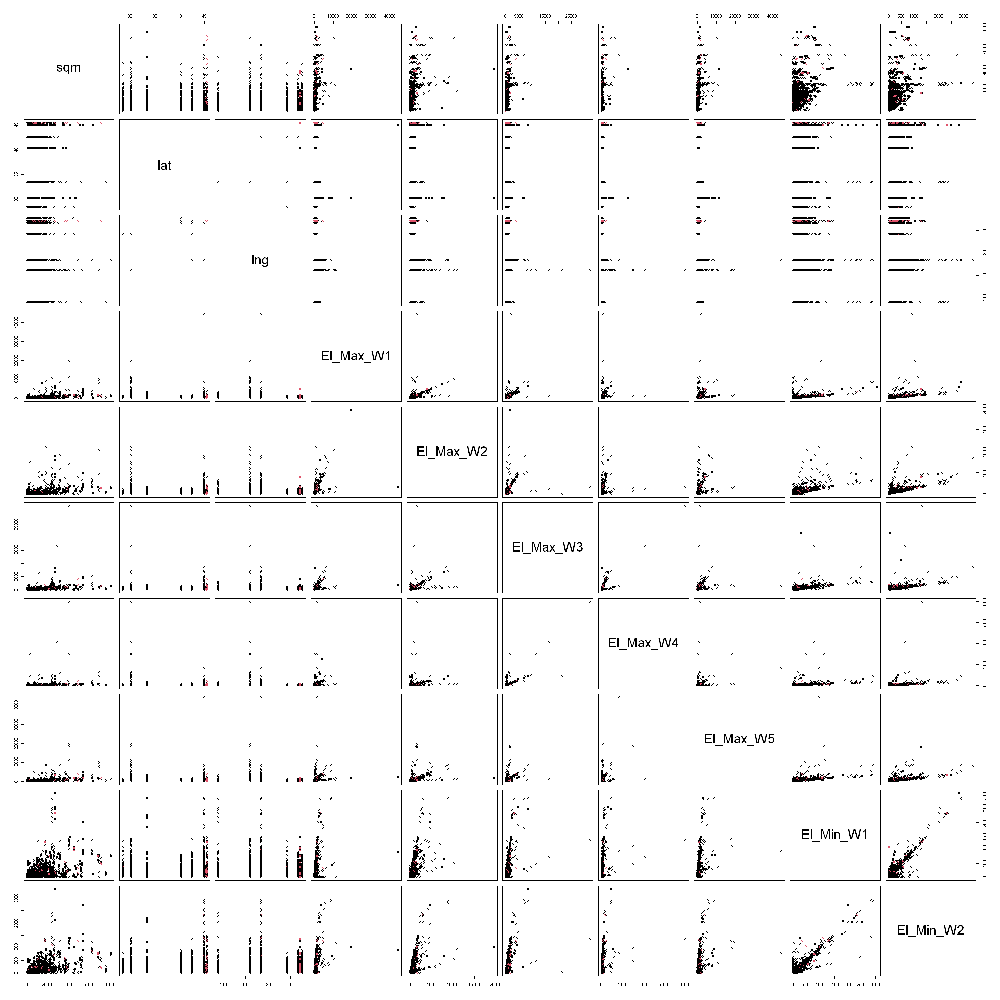

In [123]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,1:10], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


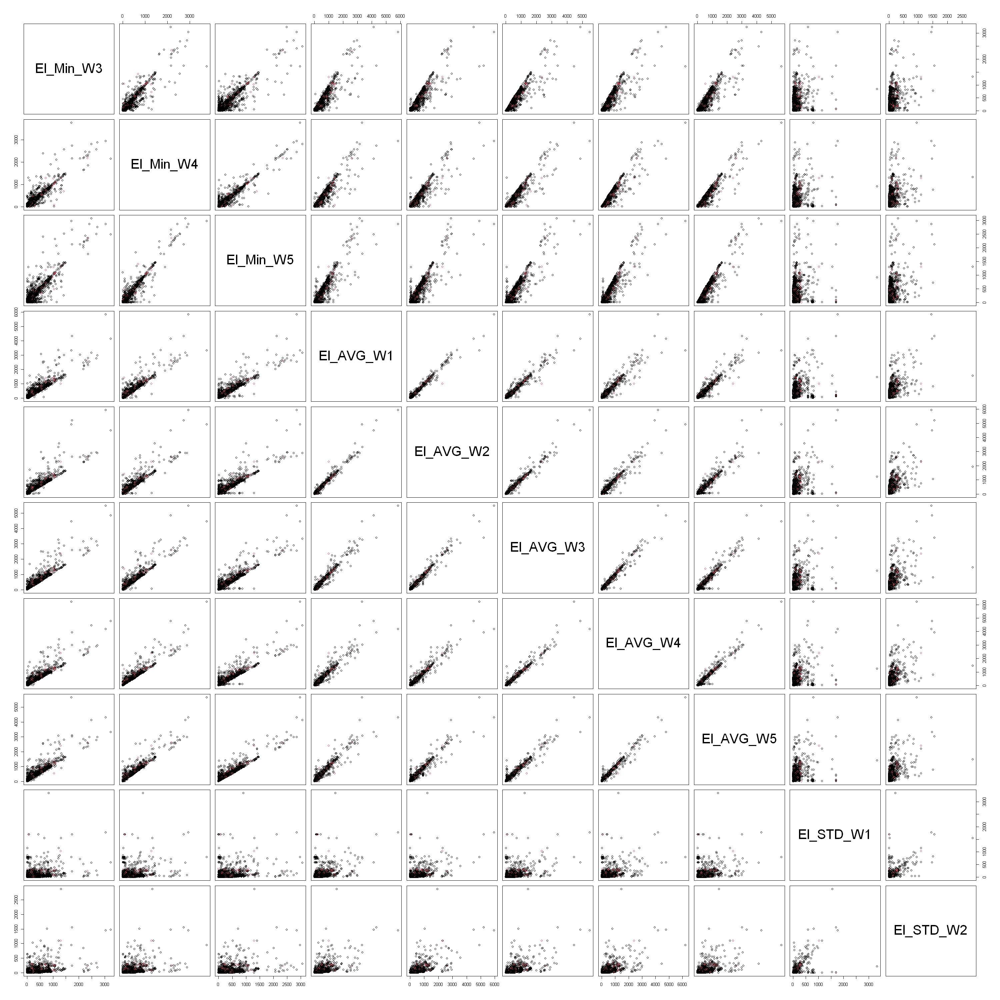

In [124]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,11:20], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


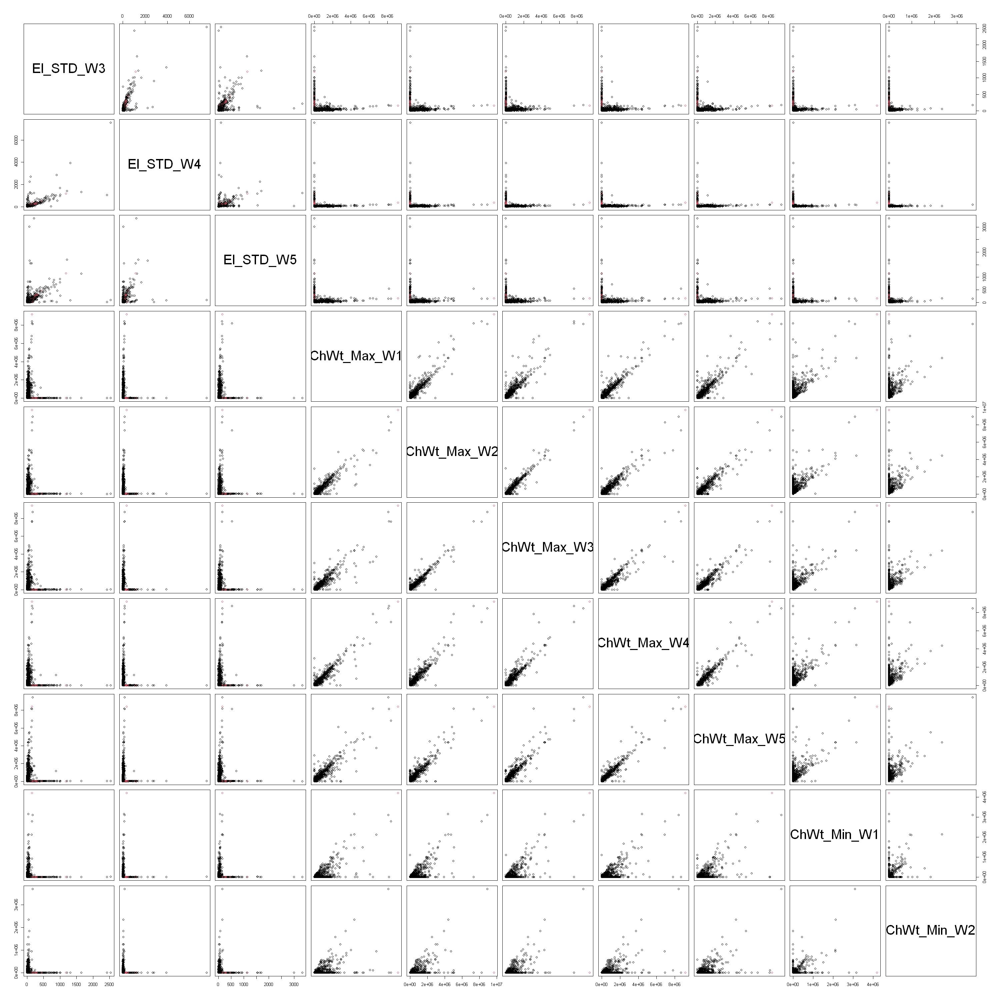

In [125]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,21:30], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


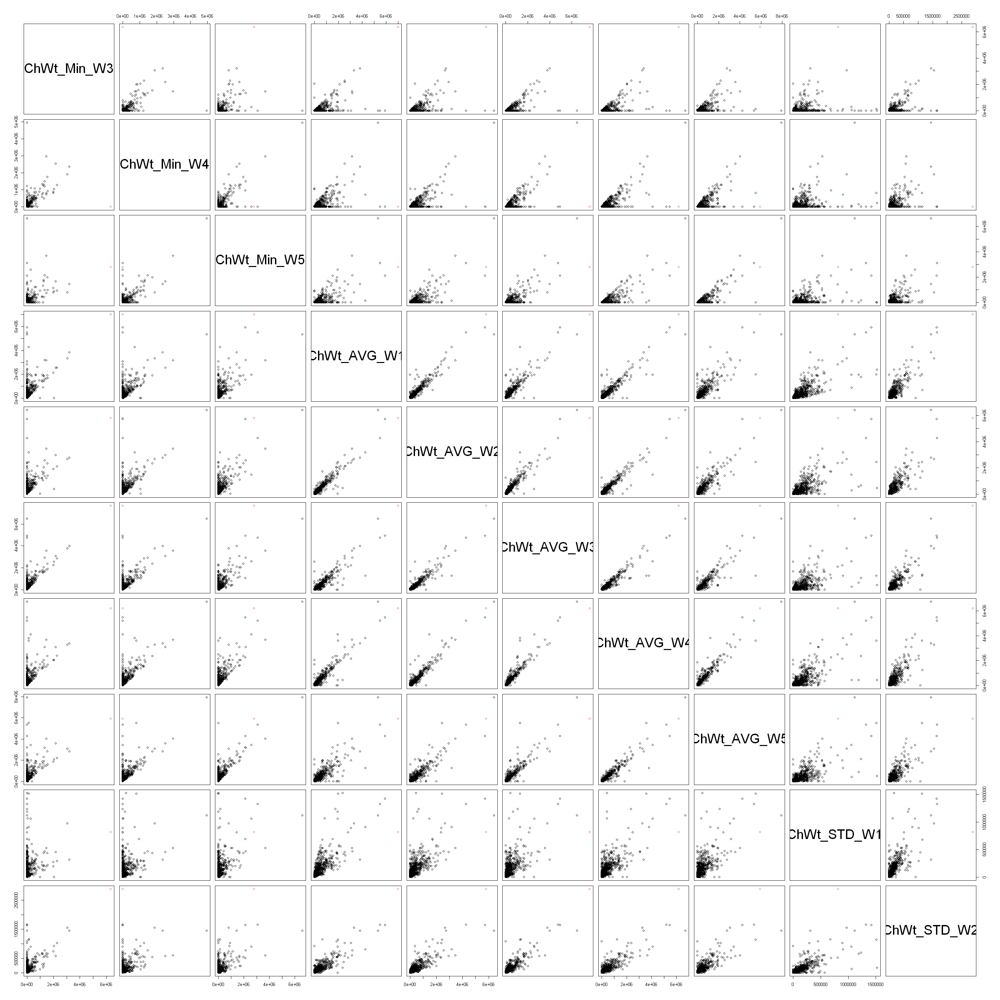

In [126]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,31:40], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


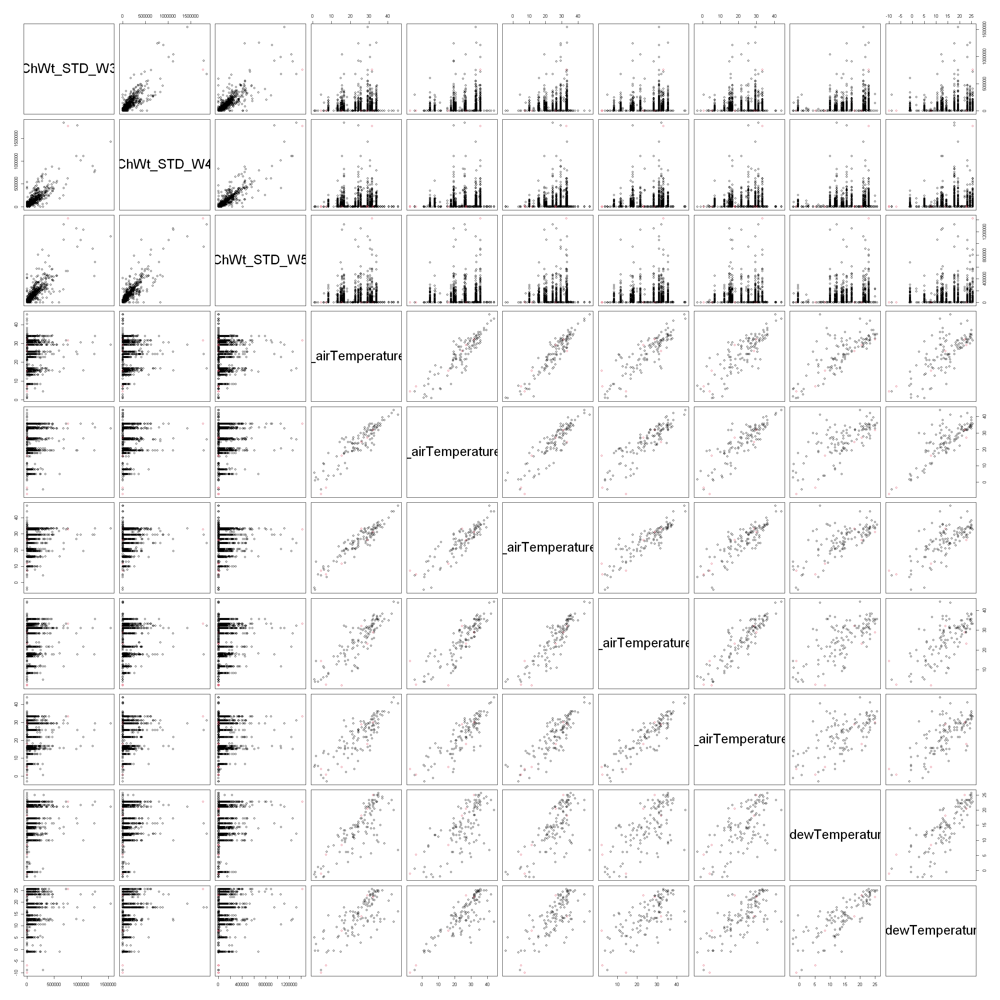

In [127]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,41:50], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


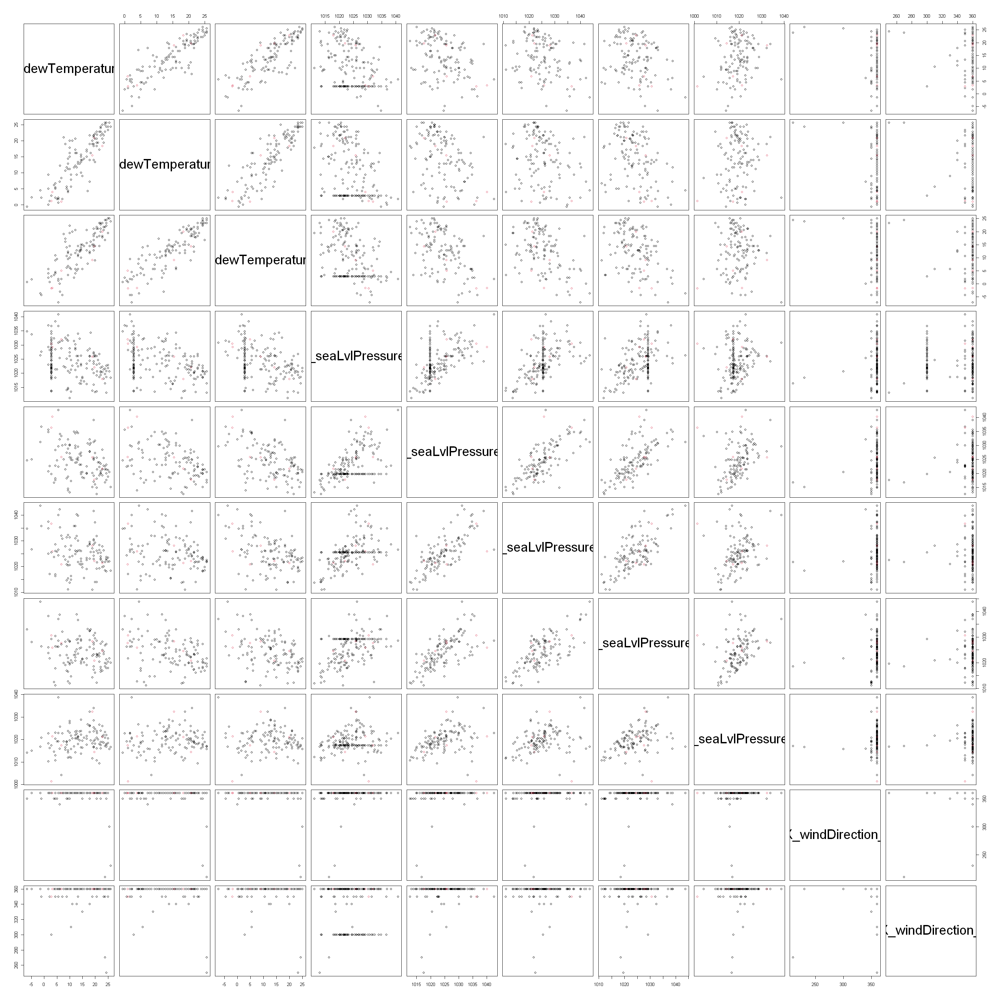

In [128]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,51:60], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


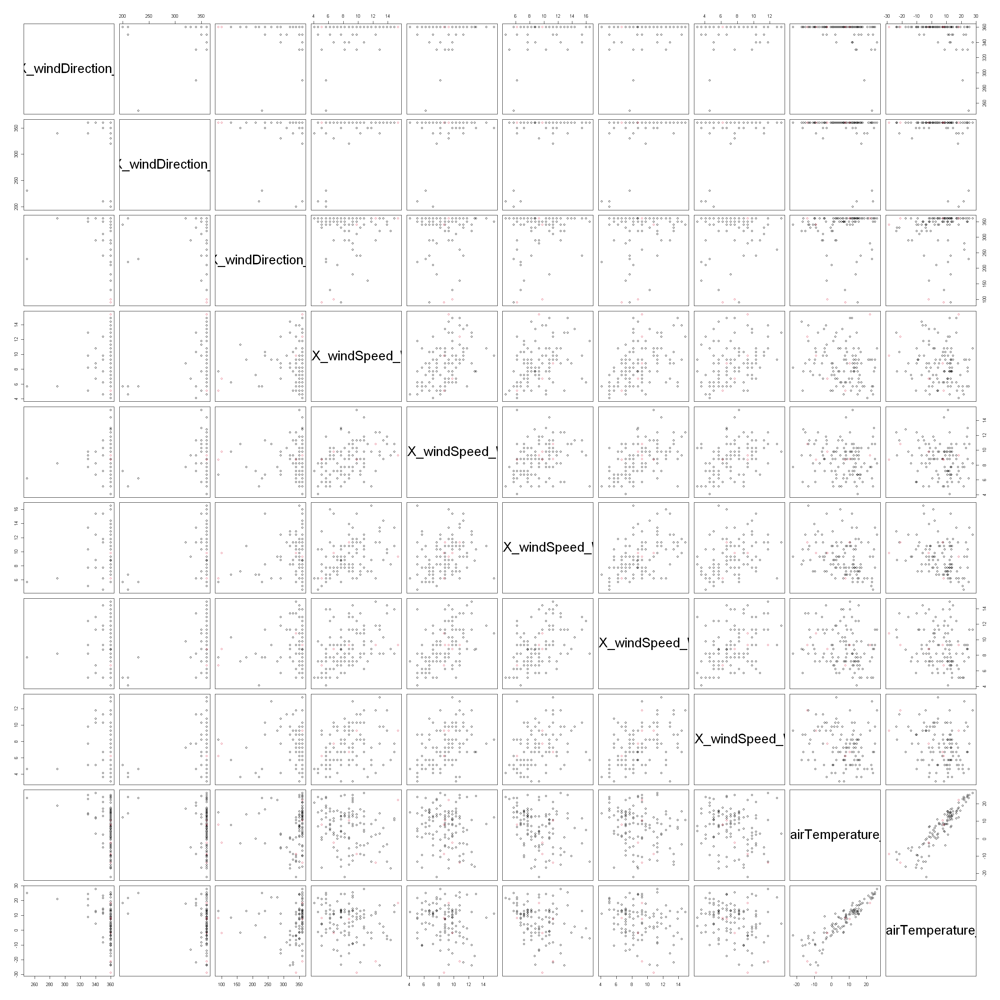

In [129]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,61:70], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


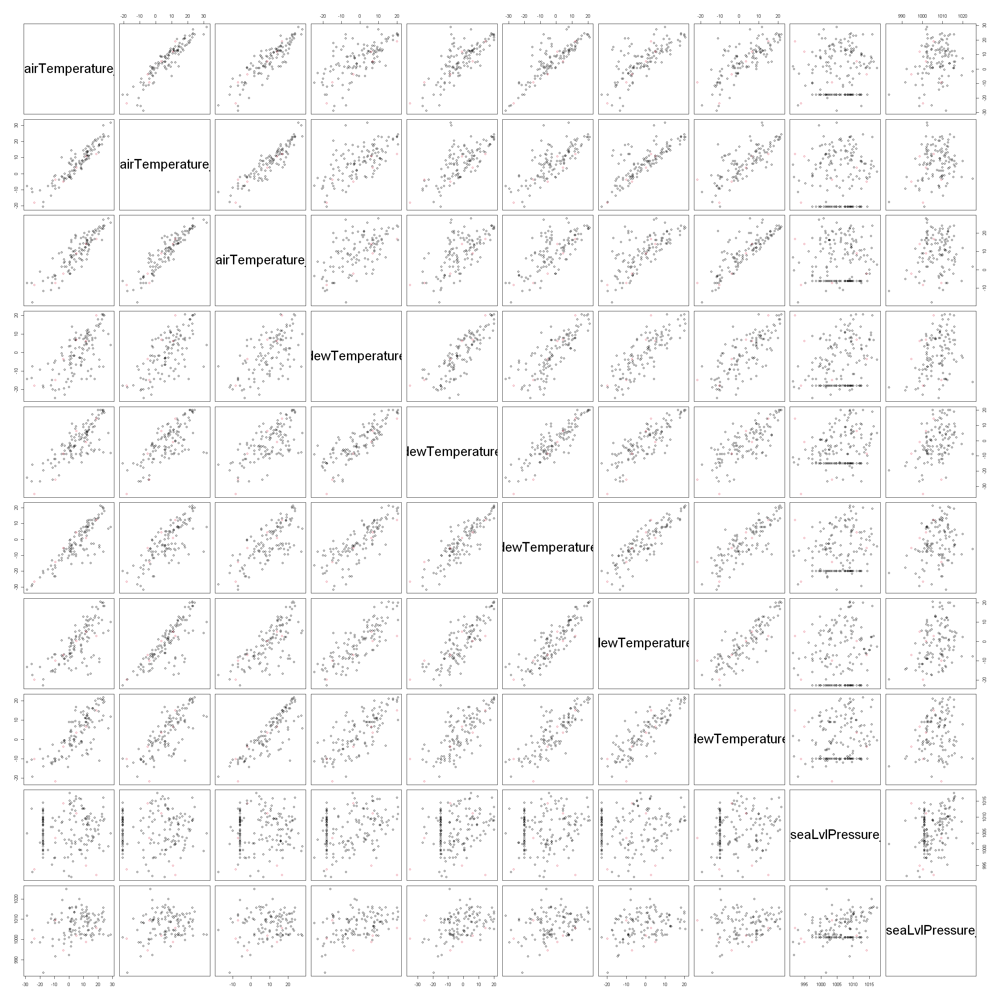

In [130]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,71:80], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


In [ ]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,91:100], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


In [ ]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,101:110], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


In [ ]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,111:120], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


In [ ]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,121:130], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


In [ ]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,131:144], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


### E.2.4  Relevant outlier pairs with the outcome
#### E.2.4.1 Outliers pairs outcome / sqm & El weekly

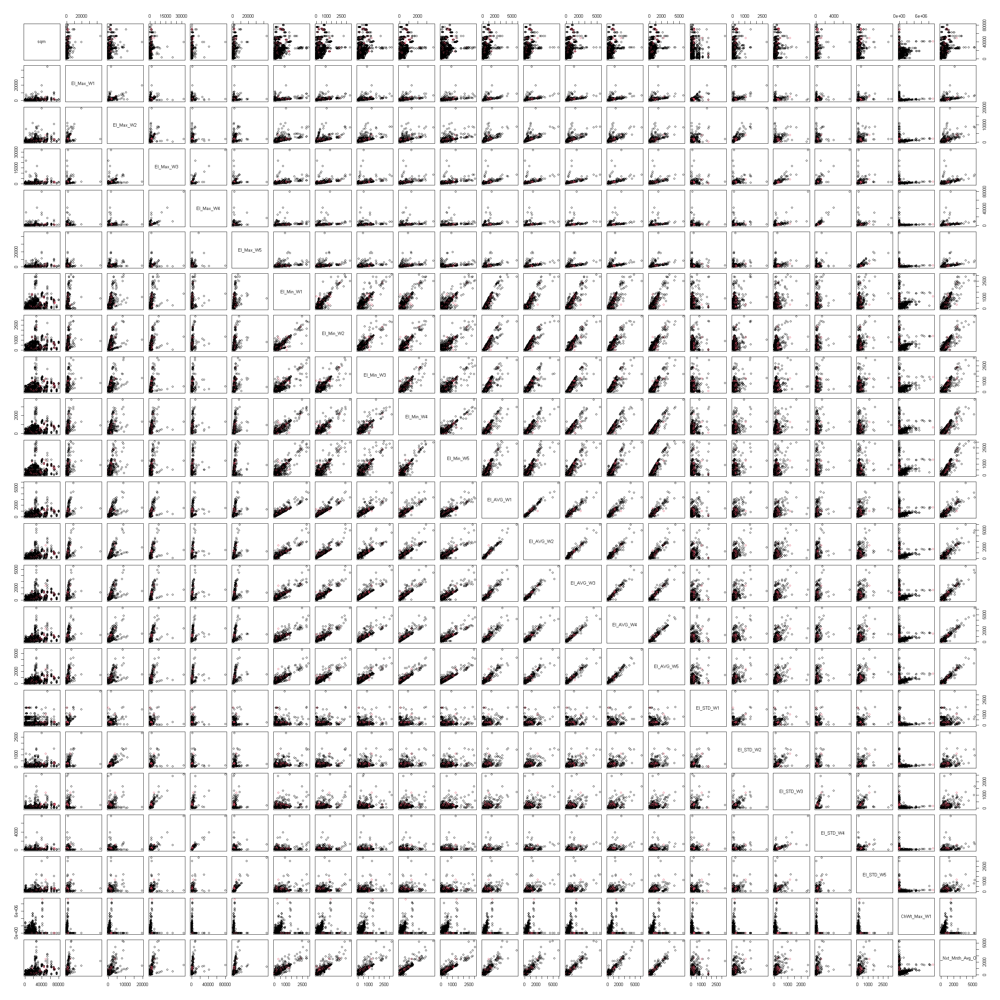

In [135]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,c(1,4:24,144)], col=ifelse(mod$cluster==1,1,2),cex.labels = 1)


#### E.2.4.2 Outliers pairs outcome / Cheald Water weekly

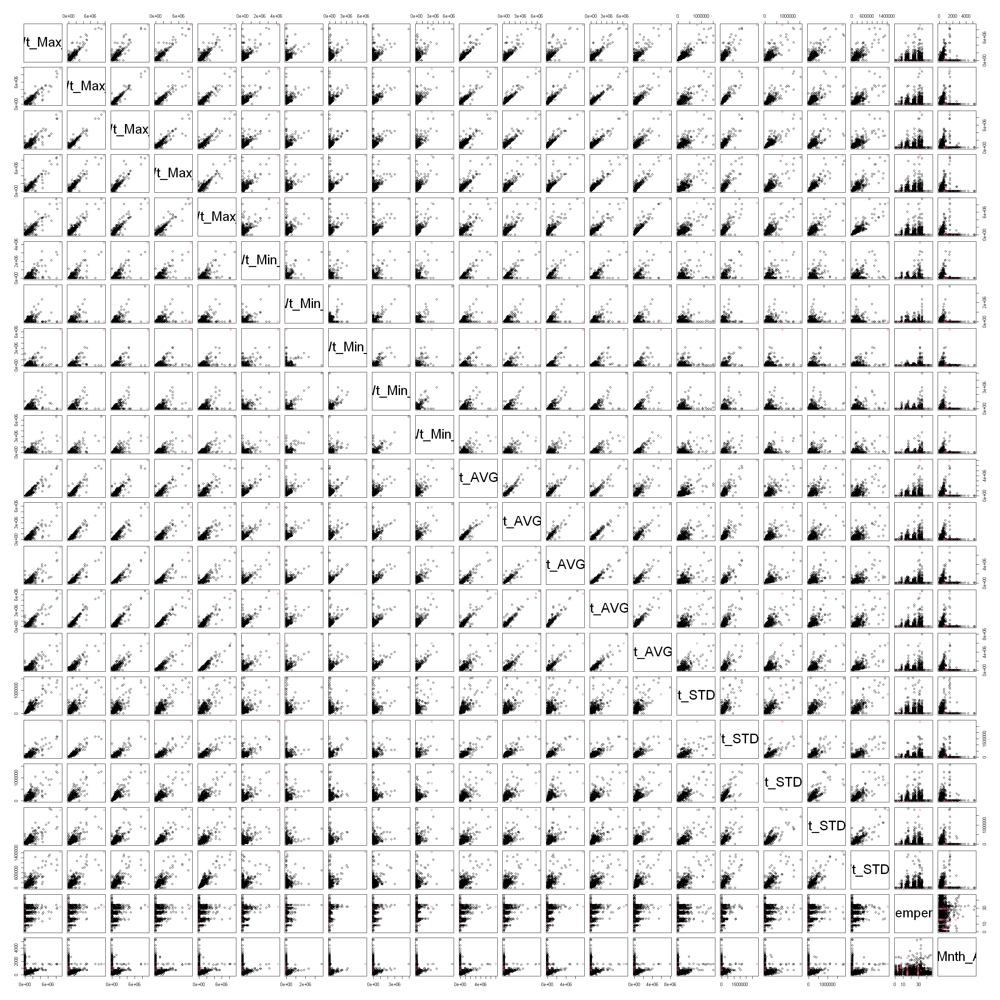

In [133]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,c(24:44,144)], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


#### E.2.4.3 Outliers pairs outcome / Some weather parameters

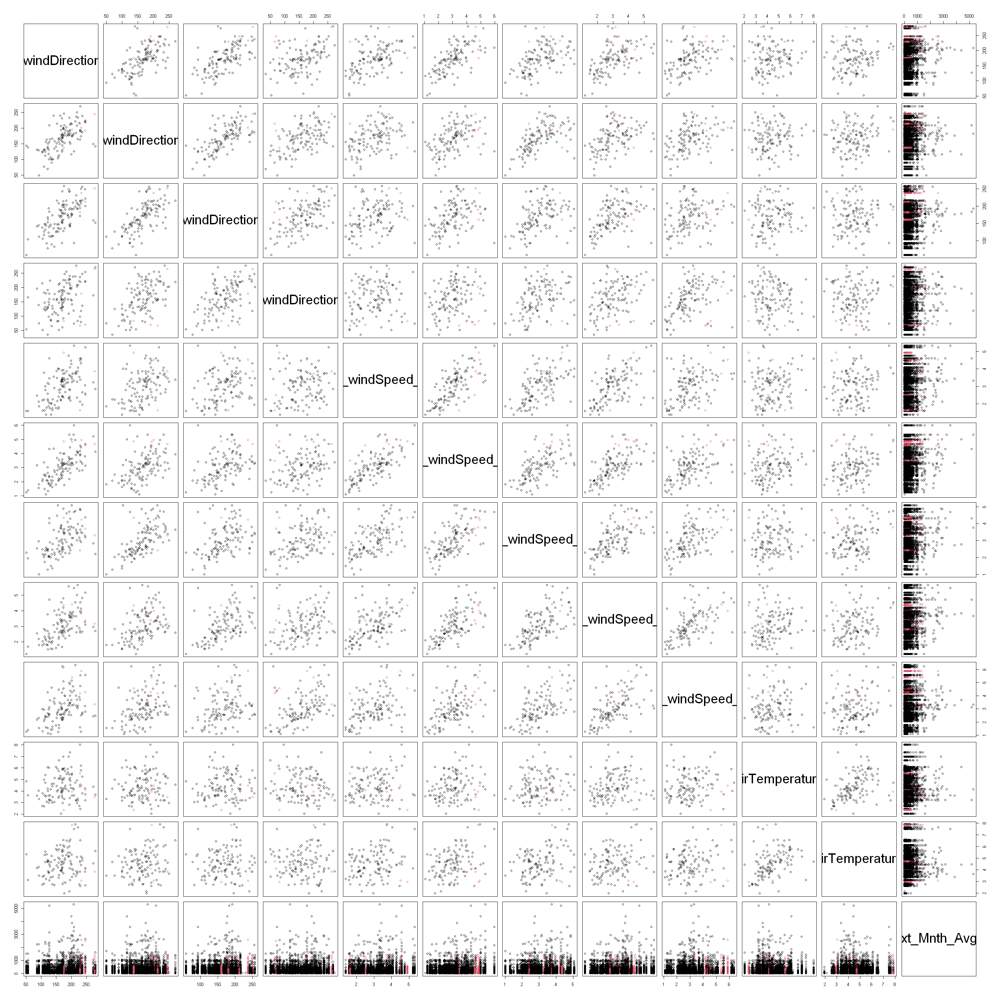

In [134]:
options(repr.plot.width = 25, repr.plot.height = 25)
pairs(DF_BGP_CFF_nFc[,c(110:120,144)], col=ifelse(mod$cluster==1,1,2),cex.labels = 3)


####   #########################################
####  ############################################


## Out Leirs Matrix 
### ניתוח אנליטי של ערכים חריגים בעזרת מטריצת ערכים חריגים 

In [22]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- names(data)
    outdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[v] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}

In [23]:
outmat <- outlierMatrix(DF_BGP_chFc)
#outmat

In [26]:
outmat

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0,0,0,0,0,0,0,0,0,NA
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [21]:
write.csv(outmat, file="outmat_DF_BGP_chFc_25052022.csv")

### שימוש במבחן  קולמוגורוב סמירנוף לבדיקת מובהקות הערכים החריגים על דוגמה של משתנה אחד

In [137]:
## מתשתשים בקולמוגורוב סמירנוב כי יודעים שהמשתנה מטרה לא מתפלג נורמלית ולכן לא ניתן להשתמש ישירות ב טי טסט ... 
El_AVG_W5_out <- DF_BGP_chFc$El_AVG_W5  # המשתנה עם ערכים חריגים
El_AVG_W5_non <- DF_BGP_chFc$El_AVG_W5[which(outmat$El_AVG_W5==0)] #     המשתנה בלי הערכים החריגים בעזרת האווט מטריקס מורידים כל מה ש 1 משאירים כל מה שאפס

In [138]:
#length (rt_lc_out)   ## בדיקות בגלל בעיות בהפעלת המבחן
#length (rt_lc_non)   ## בדיקות בגלל בעיות בהפעלת המבחן
ks <- ks.test(El_AVG_W5_out, El_AVG_W5_non) # מבחן קולמוגורוב סמירנוב בודק האם יש !!! הבדל משמעותי בתהפלגות  !!!  של המשתנה אם ובלי הערכים החריגים
ks

Warning message in ks.test(El_AVG_W5_out, El_AVG_W5_non):
"p-value will be approximate in the presence of ties"



	Two-sample Kolmogorov-Smirnov test

data:  El_AVG_W5_out and El_AVG_W5_non
D = 0.10543, p-value < 2.2e-16
alternative hypothesis: two-sided


In [1506]:
#df[complete.cases(df),]

In [1508]:
#ShBo[complete.cases(ShBo),]

#### שימוש במבחן קולמוגורב סמירנוף לכל המשתנים


### מול משתנה ממוצע צריכת חשמל של החודש הבא
#### El_Nxt_Mnth_Avg_OC

In [24]:
outmat <- outlierMatrix(DF_BGP_chFc)

In [28]:
outmat

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,NA,NA,NA,NA,NA,NA,NA,...,0,0,0,0,0,0,0,0,0,NA
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,NA,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [25]:
outmat_n <- outlierMatrix(DF_BGP_nFc)

In [26]:
outmat_nXn <- outlierMatrix(DF_BGP_nFc_Xna)

In [27]:
outmat_ch <- outlierMatrix(DF_BGP_chFc)

In [28]:
outmat_chXn <- outlierMatrix(DF_BGP_chFc_Xna)

In [33]:
res0 <- NULL

for (n in names(DF_BGP_chFc))  
    {   
        out <- DF_BGP_chFc[[n]]
        non <- DF_BGP_chFc[[n]][which(outmat[[n]]==0)]
        El_Nxt_out <- DF_BGP_chFc$El_Nxt_Mnth_Avg_OC
        El_Nxt_non <- DF_BGP_chFc$El_Nxt_Mnth_Avg_OC[which(outmat[[n]]==0)]
        if (length(unique(out))>1 & length(unique(non))>1)
            {
                ks <- suppressWarnings(ks.test( El_Nxt_out ,   El_Nxt_non ))
                res0<-ks[[2]]
                
            }
    }
ks
res0


	Two-sample Kolmogorov-Smirnov test

data:  El_Nxt_out and El_Nxt_non
D = 0.10657, p-value < 2.2e-16
alternative hypothesis: two-sided


[1] 0

### כל המשתנים מול כל המשתנים

In [33]:
res4_0 <- NULL
for (m in names(DF_BGP_nFc_Xna))   #  not working with NA so used Xna data frame
  {
    
    for (n in (names(DF_BGP_nFc_Xna)))
        {   if (n!=m)
            {
               #print(paste(m," : ",n))
                out <- DF_BGP_nFc_Xna[[n]]
                non <- DF_BGP_nFc_Xna[[n]][which(outmat[[n]]==0)]
                X_out <- DF_BGP_nFc_Xna[[m]]
                X_non <- DF_BGP_nFc_Xna[[m]][which(outmat[[n]]==0)]
                if (length(unique(out))>1 & length(unique(non))>1)
                    {
                        outnum <- length(out) - length(non)
                        ks <- suppressWarnings(ks.test(X_out, X_non))
                        res4_0 <- rbind(res4_0, cbind(
                                                        var1=m, # 2 vars
                                                        var2=n, 
                                                        OL_n=outnum,
                                                        'p-value.KS'=ks[[2]],
                                                        dis_chg = ifelse(ks[[2]]<0.05,"+","-")
                                                      )
                                        )
                    }
            }
        }
   }
res4_0

var1,var2,OL_n,p-value.KS,dis_chg
sqm,lat,1908,0.0160918372305495,+
sqm,lng,1908,0.0160918372305495,+
sqm,El_Max_W1,2006,2.79609668751846e-12,+
sqm,El_Max_W2,2104,2.49200660107363e-12,+
sqm,El_Max_W3,2104,3.06024094953727e-11,+
sqm,El_Max_W4,2101,2.25315321955577e-11,+
sqm,El_Max_W5,1999,5.45874456747697e-12,+
sqm,El_Min_W1,2112,8.32667268468867e-15,+
sqm,El_Min_W2,2198,3.77475828372553e-14,+
sqm,El_Min_W3,2213,1.40554234917545e-13,+


In [35]:

res4_01 <- NULL
for (m in names(DF_BGP_nFc_Xna))   #   not working with NA so used Xna data frame
  {
    
    for (n in (names(DF_BGP_nFc_Xna)))
        {   if (n!=m)
            {
               #print(paste(m," : ",n))
                out <- DF_BGP_nFc_Xna[[n]]
                non <- DF_BGP_nFc_Xna[[n]][which(outmat[[n]]==0)]
                X_out <- DF_BGP_nFc_Xna[[m]]
                X_non <- DF_BGP_nFc_Xna[[m]][which(outmat[[n]]==0)]
                if (length(unique(out))>1 & length(unique(non))>1)
                    {
                        outnum <- length(out) - length(non)
                        ks <- suppressWarnings(ks.test(X_out, X_non))
                        res4_01 <- rbind(res4_01, cbind(
                                                        var1=m, # one var
                                                        OL_n=outnum,
                                                        'p-value.KS'=ks[[2]],
                                                        dis_chg = ifelse(ks[[2]]<0.05,"+","-")
                                                      )
                                        )
                    }
            }
        }
   }
res4_01

var1,OL_n,p-value.KS,dis_chg
sqm,1908,0.0160918372305495,+
sqm,1908,0.0160918372305495,+
sqm,2006,2.79609668751846e-12,+
sqm,2104,2.49200660107363e-12,+
sqm,2104,3.06024094953727e-11,+
sqm,2101,2.25315321955577e-11,+
sqm,1999,5.45874456747697e-12,+
sqm,2112,8.32667268468867e-15,+
sqm,2198,3.77475828372553e-14,+
sqm,2213,1.40554234917545e-13,+


In [150]:
write.csv(res4_0, file="res4_02v_KS_outL_dis_change_25052022.csv")

In [35]:
#res4_0<-read.csv("res4_02v_KS_outL_dis_change_25052022.csv")

In [151]:
write.csv(res4_01, file="res4_01v_KS_outL_dis_change_25052022.csv")

In [36]:
#res4_01<-read.csv("res4_01v_KS_outL_dis_change_25052022.csv")

#### same for DF_BGP_chFc_Xna  - with factorized features

In [31]:

res4_0c <- NULL
for (m in names(DF_BGP_chFc_Xna))   #  not working with NA so used Xna data frame
  {
    
    for (n in (names(DF_BGP_chFc_Xna)))
        {   if (n!=m)
            {
               #print(paste(m," : ",n))
                out <- DF_BGP_chFc_Xna[[n]]
                non <- DF_BGP_chFc_Xna[[n]][which(outmat[[n]]==0)]
                X_out <- DF_BGP_chFc_Xna[[m]]
                X_non <- DF_BGP_chFc_Xna[[m]][which(outmat[[n]]==0)]
                if (length(unique(out))>1 & length(unique(non))>1)
                    {
                        outnum <- length(out) - length(non)
                        ks <- suppressWarnings(ks.test(X_out, X_non))
                        res4_0c <- rbind(res4_0c, cbind(
                                                        var1=m, # 2 vars
                                                        var2=n, 
                                                        OL_n=outnum,
                                                        'p-value.KS'=ks[[2]],
                                                        dis_chg = ifelse(ks[[2]]<0.05,"+","-")
                                                      )
                                        )
                    }
            }
        }
   }
res4_0c

var1,var2,OL_n,p-value.KS,dis_chg
BIDm,sqm,636,1,-
BIDm,lat,1908,0.916693025835462,-
BIDm,lng,1908,0.916693025835462,-
BIDm,El_Max_W1,2006,0.111939567735471,-
BIDm,El_Max_W2,2104,0.127510574192353,-
BIDm,El_Max_W3,2104,0.0752652752508056,-
BIDm,El_Max_W4,2101,0.0219053590593394,+
BIDm,El_Max_W5,1999,0.048935293191117,+
BIDm,El_Min_W1,2112,0.178824046808341,-
BIDm,El_Min_W2,2198,0.396614461592587,-


In [33]:

res4_01c <- NULL
for (m in names(DF_BGP_chFc_Xna))   #   not working with NA so used Xna data frame
  {
    
    for (n in (names(DF_BGP_chFc_Xna)))
        {   if (n!=m)
            {
               #print(paste(m," : ",n))
                out <- DF_BGP_chFc_Xna[[n]]
                non <- DF_BGP_chFc_Xna[[n]][which(outmat[[n]]==0)]
                X_out <- DF_BGP_chFc_Xna[[m]]
                X_non <- DF_BGP_chFc_Xna[[m]][which(outmat[[n]]==0)]
                if (length(unique(out))>1 & length(unique(non))>1)
                    {
                        outnum <- length(out) - length(non)
                        ks <- suppressWarnings(ks.test(X_out, X_non))
                        res4_01c <- rbind(res4_01c, cbind(
                                                        var1=m, # one var
                                                        OL_n=outnum,
                                                        'p-value.KS'=ks[[2]],
                                                        dis_chg = ifelse(ks[[2]]<0.05,"+","-")
                                                      )
                                        )
                    }
            }
        }
   }
res4_01c

var1,OL_n,p-value.KS,dis_chg
BIDm,636,1,-
BIDm,1908,0.916693025835462,-
BIDm,1908,0.916693025835462,-
BIDm,2006,0.111939567735471,-
BIDm,2104,0.127510574192353,-
BIDm,2104,0.0752652752508056,-
BIDm,2101,0.0219053590593394,+
BIDm,1999,0.048935293191117,+
BIDm,2112,0.178824046808341,-
BIDm,2198,0.396614461592587,-


In [39]:
res4_0c

X,var1,var2,OL_n,p.value.KS,dis_chg
<int>,<chr>,<chr>,<int>,<dbl>,<chr>
1,BIDm,sqm,636,1.000000000,-
2,BIDm,lat,1908,0.916693026,-
3,BIDm,lng,1908,0.916693026,-
4,BIDm,El_Max_W1,2006,0.111939568,-
5,BIDm,El_Max_W2,2104,0.127510574,-
6,BIDm,El_Max_W3,2104,0.075265275,-
7,BIDm,El_Max_W4,2101,0.021905359,+
8,BIDm,El_Max_W5,1999,0.048935293,+
9,BIDm,El_Min_W1,2112,0.178824047,-


In [40]:
res4_01c

X,var1,OL_n,p.value.KS,dis_chg
<int>,<chr>,<int>,<dbl>,<chr>
1,BIDm,636,1.000000000,-
2,BIDm,1908,0.916693026,-
3,BIDm,1908,0.916693026,-
4,BIDm,2006,0.111939568,-
5,BIDm,2104,0.127510574,-
6,BIDm,2104,0.075265275,-
7,BIDm,2101,0.021905359,+
8,BIDm,1999,0.048935293,+
9,BIDm,2112,0.178824047,-


In [37]:
write.csv(res4_0c, file="Ch_res4_02v_KS_outL_dis_change_25052022.csv")

In [37]:
#res4_0c<-read.csv("Ch_res4_02v_KS_outL_dis_change_25052022.csv")

In [39]:
write.csv(res4_01c, file="Ch_res4_01v_KS_outL_dis_change_25052022.csv")

In [39]:
#res4_01c<-read.csv("Ch_res4_01v_KS_outL_dis_change_25052022.csv")

#### סינון המשתנים בהם היה הבדל מובהק בהשפעת ערכי קיצון / ערכים חריגים על התפלגות המשתנה

###### עוד כמה סינונים לצפיה ממוקדת

In [40]:
F_res4_0<-res4_0[res4_0[, 4] <0.05,] # filtering only p value <0.05
F_res4_0

,X,var1,var2,OL_n,p.value.KS,dis_chg
,<int>,<chr>,<chr>,<int>,<dbl>,<chr>
106,106,sqm,MAX_airTemperature_W4,0,1,-
107,107,sqm,MAX_airTemperature_W5,0,1,-
108,108,sqm,MAX_dewTemperature_W1,0,1,-
110,110,sqm,MAX_dewTemperature_W3,0,1,-
111,111,sqm,MAX_dewTemperature_W4,0,1,-
112,112,sqm,MAX_dewTemperature_W5,0,1,-
114,114,sqm,MAX_seaLvlPressure_W2,0,1,-
119,119,sqm,MAX_windSpeed_W1,0,1,-
121,121,sqm,MAX_windSpeed_W3,0,1,-


In [41]:
F_res4_01<-res4_01[res4_01[, 3] <0.05,] # filtering only p value <0.05
F_res4_01

,X,var1,OL_n,p.value.KS,dis_chg
,<int>,<chr>,<int>,<dbl>,<chr>
106,106,sqm,0,1,-
107,107,sqm,0,1,-
108,108,sqm,0,1,-
110,110,sqm,0,1,-
111,111,sqm,0,1,-
112,112,sqm,0,1,-
114,114,sqm,0,1,-
119,119,sqm,0,1,-
121,121,sqm,0,1,-


In [42]:
F_res4_0c<-res4_0c[res4_0c[, 4] <0.05,] # filtering only p value <0.05
F_res4_0c

,X,var1,var2,OL_n,p.value.KS,dis_chg
,<int>,<chr>,<chr>,<int>,<dbl>,<chr>
107,107,BIDm,MAX_airTemperature_W4,0,1,-
108,108,BIDm,MAX_airTemperature_W5,0,1,-
109,109,BIDm,MAX_dewTemperature_W1,0,1,-
111,111,BIDm,MAX_dewTemperature_W3,0,1,-
112,112,BIDm,MAX_dewTemperature_W4,0,1,-
113,113,BIDm,MAX_dewTemperature_W5,0,1,-
115,115,BIDm,MAX_seaLvlPressure_W2,0,1,-
120,120,BIDm,MAX_windSpeed_W1,0,1,-
122,122,BIDm,MAX_windSpeed_W3,0,1,-


In [43]:
F_res4_01c<-res4_01c[res4_01c[, 3] <0.05,] # filtering only p value <0.05
F_res4_01c

,X,var1,OL_n,p.value.KS,dis_chg
,<int>,<chr>,<int>,<dbl>,<chr>
107,107,BIDm,0,1,-
108,108,BIDm,0,1,-
109,109,BIDm,0,1,-
111,111,BIDm,0,1,-
112,112,BIDm,0,1,-
113,113,BIDm,0,1,-
115,115,BIDm,0,1,-
120,120,BIDm,0,1,-
122,122,BIDm,0,1,-


In [210]:
write.csv(F_res4_0, file="F_res4_0-KS_outL_dis_change_25052022.csv")

In [211]:
write.csv(F_res4_01, file="F_res4_0-KS_outL_dis_change_25052022.csv")

In [212]:
write.csv(F_res4_0c, file="F_res4_0-KS_outL_dis_change_25052022.csv")

In [ ]:
write.csv(F_res4_01c, file="F_res4_0-KS_outL_dis_change_25052022.csv")

### הכנת מערך מידע זמני לבדיקה גרפית של השפעת ערכי קיצון על התפלגות משתנה אחר

In [71]:
temp<-NULL

In [72]:
temp<-DF_BGP_chFc

In [74]:
temp$El_Nxt_Mnth_Avg_OC_log<-log(DF_BGP_chFc$El_Nxt_Mnth_Avg_OC)

In [75]:
temp$El_AVG_W5_log<-log(DF_BGP_chFc$El_AVG_W5)

In [76]:
temp

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC,El_Nxt_Mnth_Avg_OC_log,El_AVG_W5_log
<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,NA,NA,US/Mountain,147.2500,129.1300,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975,4.040011,4.136785
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,NA,NA,US/Mountain,225.0000,202.0000,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934,4.687763,4.926229
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,NA,NA,US/Mountain,30.6200,34.6300,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533,3.021621,3.076736
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,NA,NA,US/Mountain,178.5000,180.0000,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662,5.255043,5.478976
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,NA,NA,US/Mountain,95.5000,103.2500,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051,4.028384,4.137236
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,NA,NA,US/Mountain,145.6200,139.1200,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137,4.253996,4.495319
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,NA,NA,US/Mountain,NA,NA,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,NA,NA,NA
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,NA,NA,US/Mountain,203.0000,217.0000,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969,4.883975,4.840302
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,NA,NA,US/Mountain,227.2500,234.2500,...,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087,4.786484,5.032487


## -------------------------------------------------------------------------------------------------
## -------------------------------------------------------------------------------------------------
## -
## cocor שימוש בספריית
### לבדיקת השפעת עם ובלי ערכי קיצון / ערכים חריגים על הקורלציה 

In [29]:
library(cocor)

#### Test only on El_AVG_W5

In [78]:

res2 <- NULL

for (n in names(DF_BGP_chFc))   
    {   
        out <- DF_BGP_chFc[[n]]
    #print(n)
        non <- DF_BGP_chFc[[n]][which(outmat_ch[[n]]==0)]
    #print(non)
        El_AVG_W5_out <- DF_BGP_chFc$ El_AVG_W5
        El_AVG_W5_non <- DF_BGP_chFc$ El_AVG_W5[which(outmat_ch[[n]]==0)]
        if (length(unique(out))>1 & length(unique(non))>1)
            {
                outdf <-data.frame(out=out, El_AVG_W5_out=El_AVG_W5_out)
                nondf <-data.frame(non=non, El_AVG_W5_non=El_AVG_W5_non)
    #####
                cr <- cocor(~ out + El_AVG_W5_out |  non + El_AVG_W5_non , data=list(outdf,nondf))
    #####
                pval <- cr@fisher1925$p.value
                res2 <- rbind(res2, cbind(var=n, correlation_changed=ifelse(pval<0.05,"+","-")))
            }
    }

res2

var,correlation_changed
sqm,-
lat,-
lng,-
El_Max_W1,+
El_Max_W2,+
El_Max_W3,+
El_Max_W4,+
El_Max_W5,+
El_Min_W1,+
El_Min_W2,+


### --

#### Test only on Avg_airTemperature_W5

In [80]:

res2 <- NULL

for (n in names(DF_BGP_chFc))   
    {   
        out <- DF_BGP_chFc[[n]]
    #print(n)
        non <- DF_BGP_chFc[[n]][which(outmat_ch[[n]]==0)]
    #print(non)
        Avg_airTemperature_W5_out <- DF_BGP_chFc$ Avg_airTemperature_W5
        Avg_airTemperature_W5_non <- DF_BGP_chFc$ Avg_airTemperature_W5[which(outmat_ch[[n]]==0)]
        if (length(unique(out))>1 & length(unique(non))>1)
            {
                outdf <-data.frame(out=out, Avg_airTemperature_W5_out=Avg_airTemperature_W5_out)
                nondf <-data.frame(non=non, Avg_airTemperature_W5_non=Avg_airTemperature_W5_non)
    #####
                cr <- cocor(~ out + Avg_airTemperature_W5_out |  non + Avg_airTemperature_W5_non , data=list(outdf,nondf))
    #####
                pval <- cr@fisher1925$p.value
                res2 <- rbind(res2, cbind(var=n, correlation_changed=ifelse(pval<0.05,"+","-")))
            }
    }

res2

var,correlation_changed
sqm,+
lat,-
lng,-
El_Max_W1,-
El_Max_W2,+
El_Max_W3,-
El_Max_W4,+
El_Max_W5,-
El_Min_W1,-
El_Min_W2,-


### הפעלת לולאה של כל המשתנים האפשריים מול כל המשתנים האפשריים

In [120]:

res2 <- NULL
for (m in names(DF_BGP_nFc_Xna)) #  הסרת ערכים נוספים שהייתה איתם בעיה וגם את האינדקס
  {
    
    for (n in (names(DF_BGP_nFc_Xna[c(1:43,64:83,104:204)])))  
        {   if (n!=m)
            {
                #print(paste(m," : ",n))
                out <- DF_BGP_nFc_Xna[[n]]
                non <- DF_BGP_nFc_Xna[[n]][which(outmat[[n]]==0)]
                X_out <- DF_BGP_nFc_Xna[[m]]
                X_non <- DF_BGP_nFc_Xna[[m]][which(outmat[[n]]==0)]
                if (length(unique(out))>1 & length(unique(non))>1)
                    {
                        outdf <-data.frame(out=out, X_out=X_out)
                        nondf <-data.frame(non=non, X_non=X_non)
                        cr <- cocor(~ out + X_out |  non + X_non , data=list(outdf,nondf))
                        pval <- cr@fisher1925$p.value
                        res2 <- rbind(res2, cbind(var1=m,var2=n,'p-val.CO'=pval, correlation_changed=ifelse(pval<0.05,"+","-")))
                    }
            }
        }
   }
res2

var1,var2,p-val.CO,correlation_changed
sqm,lat,0.000560286084479555,+
sqm,lng,3.97838557164576e-06,+
sqm,El_Max_W1,0,+
sqm,El_Max_W2,1.52960491162091e-07,+
sqm,El_Max_W3,0,+
sqm,El_Max_W4,0,+
sqm,El_Max_W5,0,+
sqm,El_Min_W1,0.0014238967335336,+
sqm,El_Min_W2,0.0731857116803039,-
sqm,El_Min_W3,0.00596890497715363,+


In [118]:
#which( colnames(DF_BGP_nFc_Xna)=="gas_STD_W5" )

[1] 63

In [121]:
write.csv(res2, file="res2-outL_dis_change_29052022.csv")

In [229]:
res2_1<-res2[,c(1,3,4)] #drop the var 2 column for future use
res2_1

var1,p-val.CO,correlation_changed
sqm,0.000560286084479555,+
sqm,3.97838557164576e-06,+
sqm,0,+
sqm,1.52960491162091e-07,+
sqm,0,+
sqm,0,+
sqm,0,+
sqm,0.0014238967335336,+
sqm,0.0731857116803039,-
sqm,0.00596890497715363,+


#### סינון המשתנים בהם השינוי בהתפלגות שנגרם מעם או בלי ערכי קיצון    מובהק   

In [123]:
res3<-res2[res2[, 4] == "+",] # filtering only +
res3

var1,var2,p-val.CO,correlation_changed
sqm,lat,0.000560286084479555,+
sqm,lng,3.97838557164576e-06,+
sqm,El_Max_W1,0,+
sqm,El_Max_W2,1.52960491162091e-07,+
sqm,El_Max_W3,0,+
sqm,El_Max_W4,0,+
sqm,El_Max_W5,0,+
sqm,El_Min_W1,0.0014238967335336,+
sqm,El_Min_W3,0.00596890497715363,+
sqm,El_Min_W4,0.0144741109059134,+


In [124]:
write.csv(res3, file="res3-outL_onlyPlus_29052022.csv")

####    סינון המשתנים בהם  ! אין ! שינוי בקורלציה שנגרם מעם או בלי ערכי קיצון  באופן  מובהק   
##   ערכי קיצון  / חריגים שברשימה זו - אינם משפיעים על הקורלציה ערכים אחרים ולכן ניתן לטפל בהם 

In [125]:
res5<-res2[res2[, 4] == "-",] # filtering only -
res5 

var1,var2,p-val.CO,correlation_changed
sqm,El_Min_W2,0.0731857116803039,-
sqm,El_AVG_W1,0.158099484100165,-
sqm,El_AVG_W2,0.610151584467267,-
sqm,El_AVG_W3,0.110873892294057,-
sqm,El_AVG_W4,0.324741340076994,-
sqm,El_AVG_W5,0.0578876953536509,-
sqm,ChWt_Min_W1,0.917177044750104,-
sqm,ChWt_Min_W5,0.0618498698244556,-
sqm,hotwater_Min_W1,0.941781450669336,-
sqm,hotwater_Min_W3,0.555383874811648,-


In [126]:
write.csv(res5, file="res5-outL_onlyMinus_29052022.csv")

####  Cocor המשתנים הנוספים  שתקעו את האנליזה

In [127]:
names(DF_BGP_nFc_Xna[c(44:63,84:103)])

[1] "gas_Max_W1" "gas_Max_W2" "gas_Max_W3" "gas_Max_W4" "gas_Max_W5"
 [6] "gas_Min_W1" "gas_Min_W2" "gas_Min_W3" "gas_Min_W4" "gas_Min_W5"
[11] "gas_AVG_W1" "gas_AVG_W2" "gas_AVG_W3" "gas_AVG_W4" "gas_AVG_W5"
[16] "gas_STD_W1" "gas_STD_W2" "gas_STD_W3" "gas_STD_W4" "gas_STD_W5"
[21] "Stm_Max_W1" "Stm_Max_W2" "Stm_Max_W3" "Stm_Max_W4" "Stm_Max_W5"
[26] "Stm_Min_W1" "Stm_Min_W2" "Stm_Min_W3" "Stm_Min_W4" "Stm_Min_W5"
[31] "Stm_AVG_W1" "Stm_AVG_W2" "Stm_AVG_W3" "Stm_AVG_W4" "Stm_AVG_W5"
[36] "Stm_STD_W1" "Stm_STD_W2" "Stm_STD_W3" "Stm_STD_W4" "Stm_STD_W5"


## הכנת מטריצה זמנית לבדיקת התלפגות ויזואלית

In [136]:
temp1<-DF_BGP_nFc_Xna
temp1$El_AVG_W5_log<-log(DF_BGP_nFc_Xna$El_AVG_W5)
temp1$El_Nxt_Mnth_Avg_OC_log<-log(DF_BGP_nFc_Xna$El_Nxt_Mnth_Avg_OC)
for (m in (res5[,1]))  
    {
#    for (n in (res5[,2]))
#       {
#          print(paste(n,' : ',m))
           temp1[[paste(m,'OL', sep ='_')]]<-outmat_n[[m]]
#          print(temp[paste(m,n, sep ='_')])
#       }
   }

In [144]:
write.csv(temp1, file="temp1-outL_logforvis29052022.csv")

In [143]:
temp1

sqm,lat,lng,El_Max_W1,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5,El_Min_W1,El_Min_W2,...,Std_windDirection_W2_OL,Std_windDirection_W3_OL,Std_windDirection_W4_OL,Std_windDirection_W5_OL,Std_windSpeed_W1_OL,Std_windSpeed_W2_OL,Std_windSpeed_W3_OL,Std_windSpeed_W4_OL,Std_windSpeed_W5_OL,El_Nxt_Mnth_Avg_OC_OL
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2053.2,0,0,147.2500,129.1300,171.0000,109.1300,96.8699,53.25,42.63,...,0,0,0,0,0,0,0,0,0,0
19859.1,0,0,225.0000,202.0000,330.7500,219.5000,220.5001,88.25,91.00,...,0,0,0,0,0,0,0,0,0,0
3696.4,0,0,30.6200,34.6300,37.3800,36.5000,24.8800,18.50,17.37,...,0,0,0,0,0,0,0,0,0,0
15047.4,0,0,178.5000,180.0000,222.0000,324.0000,382.4999,42.50,40.50,...,0,0,0,0,0,0,0,0,0,0
11254.8,0,0,95.5000,103.2500,160.0000,103.0000,104.7500,37.00,35.75,...,0,0,0,0,0,0,0,0,0,0
8802.7,0,0,145.6200,139.1200,150.7500,184.1300,125.1302,71.50,51.87,...,0,0,0,0,0,0,0,0,0,0
2538.0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.00,0.00,...,0,0,0,0,0,0,0,0,0,NA
10551.9,0,0,203.0000,217.0000,388.7500,208.0000,190.0001,61.75,59.50,...,0,0,0,0,0,0,0,0,0,0
17358.0,0,0,227.2500,234.2500,355.5000,236.7500,217.2502,65.75,74.75,...,0,0,0,0,0,0,0,0,0,0


### דוגמה לתאור גרפי של !! אי !! השפעת הערכים החסרים באחד המשתנים ברשימה על התפלגות משתנה אחר באופן מובהק


Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."


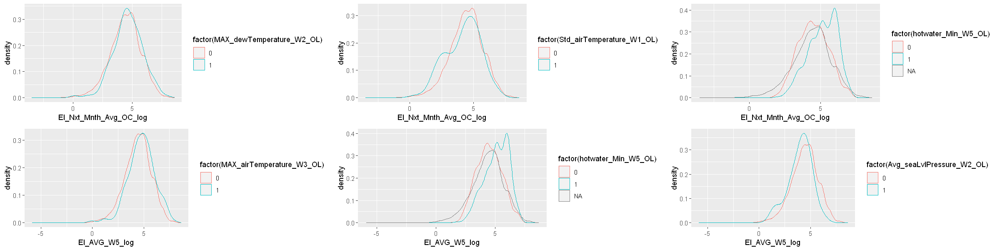

In [205]:
 
options(repr.plot.width = 20, repr.plot.height = 5 )

gp1<-  ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(MAX_dewTemperature_W2_OL),
            color=factor(MAX_dewTemperature_W2_OL))) +
            geom_density()
gp2<-ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(Std_airTemperature_W1_OL),
            color=factor(Std_airTemperature_W1_OL))) +
            geom_density()
gp3<-ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(hotwater_Min_W5_OL),
            color=factor(hotwater_Min_W5_OL))) +
            geom_density()

gp11<-  ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(MAX_airTemperature_W3_OL),
            color=factor(MAX_airTemperature_W3_OL))) +
            geom_density()
gp21<-ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(hotwater_Min_W5_OL),
            color=factor(hotwater_Min_W5_OL))) +
            geom_density()
gp31<-ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(Avg_seaLvlPressure_W2_OL),
            color=factor(Avg_seaLvlPressure_W2_OL))) +
            geom_density()


grid.arrange(gp1, gp2, gp3,gp11, gp21, gp31,  ncol = 3)  


### דוגמה לתאור גרפי של  השפעת הערכים החסרים באחד המשתנים ברשימה על התפלגות משתנה אחר באופן מובהק
##### התכוונתי לעשות לולאה לתצוגה של התפלגויות כל הערכים אבל הסתבכתי עם הגדרות התצוגה וגם זה לא באמת נחוץ אז אני מציג רק דוגמה אחת

Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 964 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1157 rows containing non-finite values (stat_density)."


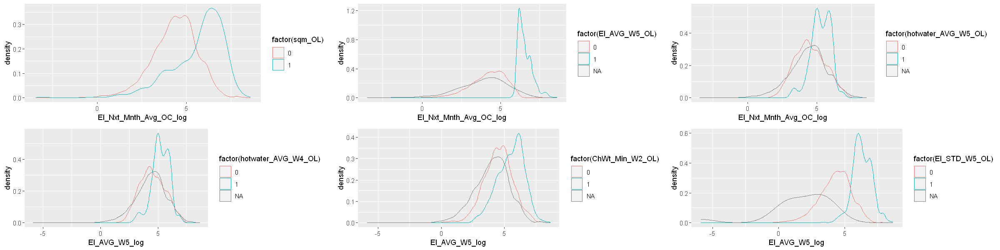

In [221]:
 
options(repr.plot.width = 20, repr.plot.height = 5 )

gp4<-ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(sqm_OL),
            color=factor(sqm_OL))) +
            geom_density()
gp5<-ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(El_AVG_W5_OL),
            color=factor(El_AVG_W5_OL))) +
            geom_density()
gp6<-ggplot(temp1, aes(x=El_Nxt_Mnth_Avg_OC_log, 
            group=factor(hotwater_AVG_W5_OL),
            color=factor(hotwater_AVG_W5_OL))) +
            geom_density()

gp41<-ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(hotwater_AVG_W4_OL),
            color=factor(hotwater_AVG_W4_OL))) +
            geom_density()
gp51<-ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(ChWt_Min_W2_OL),
            color=factor(ChWt_Min_W2_OL))) +
            geom_density()
gp61<-ggplot(temp1, aes(x=El_AVG_W5_log, 
            group=factor(El_STD_W5_OL),
            color=factor(El_STD_W5_OL))) +
            geom_density()

grid.arrange( gp4, gp5, gp6,gp41, gp51, gp61, ncol = 3)  


## ###########################################################################
## #
## קבלת החלטות - מערך משולב של השפעת ערכי קיצון / ערכים חריגים על התפלגות והשפעה על קורלציה
## #
#### יצירת מערך מידע משולב של מבחן קומלוגורוב סמירנוף ושל קוקור 

In [239]:
OL_dess<-inner_join(data.frame(res4_01c),data.frame(res2_1),by='var1')
OL_dess$drop <- ifelse(OL_dess$dis_chg=="+" & OL_dess$correlation_changed=="+","No","Yes")
head(OL_dess)

,X,var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
,<int>,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,761,sqm,1908,0.01609184,+,0.000560286084479555,+,No
2,761,sqm,1908,0.01609184,+,3.97838557164576e-06,+,No
3,761,sqm,1908,0.01609184,+,0,+,No
4,761,sqm,1908,0.01609184,+,1.52960491162091e-07,+,No
5,761,sqm,1908,0.01609184,+,0,+,No
6,761,sqm,1908,0.01609184,+,0,+,No


In [240]:
OL_dess<-OL_dess[,c(2:8)]
head(OL_dess)

,var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,sqm,1908,0.01609184,+,0.000560286084479555,+,No
2,sqm,1908,0.01609184,+,3.97838557164576e-06,+,No
3,sqm,1908,0.01609184,+,0,+,No
4,sqm,1908,0.01609184,+,1.52960491162091e-07,+,No
5,sqm,1908,0.01609184,+,0,+,No
6,sqm,1908,0.01609184,+,0,+,No


In [279]:
write.csv(OL_dess, file="OL_dess_29052022.csv")

### סינון רק של הערכים הדורשים טיפול על פי הכללים

In [241]:
OL_dess[(OL_dess[,7]=="Yes"),]

,var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
9,sqm,1908,0.01609184,+,0.0731857116803039,-,Yes
13,sqm,1908,0.01609184,+,0.158099484100165,-,Yes
14,sqm,1908,0.01609184,+,0.610151584467267,-,Yes
15,sqm,1908,0.01609184,+,0.110873892294057,-,Yes
16,sqm,1908,0.01609184,+,0.324741340076994,-,Yes
17,sqm,1908,0.01609184,+,0.0578876953536509,-,Yes
28,sqm,1908,0.01609184,+,0.917177044750104,-,Yes
32,sqm,1908,0.01609184,+,0.0618498698244556,-,Yes
48,sqm,1908,0.01609184,+,0.941781450669336,-,Yes


In [281]:
write.csv(OL_dess[(OL_dess[,7]=="Yes"),], file="OL_dess_YES_29052022.csv")

### הטבלה מעל מכילה גם את הערכים הלא מובהקים הדורשים לכאורה טיפול
#### נבדוק רק את הערכים המובהקים המשותפים

In [249]:
names(OL_dess[c(3,5,7)])
OL_dess[((OL_dess[,7]=="Yes")&(OL_dess[,3]<0.05)&(OL_dess[,5]<0.05)),]

[1] "p.value.KS" "p.val.CO"   "drop"

var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>


#### (?) לפי התוצאה ---  נראה כי אין אף ערך קיצון / ערך חריג שאפשר לטפל בו

### נבדוק את הערכים הגדולים ממובהקות אבל קרובים אליה
##### אולי הבדיקה אינה נותת תשובה נכונה

In [277]:
OL_dess[((OL_dess[,7]=="Yes")&(OL_dess[,3]<0.05)&(OL_dess[,5]<0.050137)),]

,var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
2200616,hotwater_STD_W1,1908,3.330669e-16,+,0.0501367435853488,-,Yes
2200765,hotwater_STD_W1,1908,3.330669e-16,+,0.0501367435853488,-,Yes
2203894,hotwater_STD_W1,5414,2.691192e-06,+,0.0501367435853488,-,Yes
2204043,hotwater_STD_W1,5413,1.602152e-05,+,0.0501367435853488,-,Yes
2204192,hotwater_STD_W1,5469,3.676875e-06,+,0.0501367435853488,-,Yes
2204341,hotwater_STD_W1,5454,5.027890e-06,+,0.0501367435853488,-,Yes
2204490,hotwater_STD_W1,5388,1.498959e-06,+,0.0501367435853488,-,Yes
2204639,hotwater_STD_W1,5331,4.574119e-14,+,0.0501367435853488,-,Yes
2204788,hotwater_STD_W1,5305,1.110223e-16,+,0.0501367435853488,-,Yes


##### הבדיקה עבדה.. כנראה שאין באמת ערכי קיצון / חריגים שניתן לטפל בהם
#### #
#### נבדוק את הערכים שאינם דורשים טיפול על פי הכללים ושהם מובהקים

In [245]:
OL_dess[((OL_dess[,3]<0.05)&(OL_dess[,5]<0.05)&(OL_dess[,7]=="No")),]

,var1,OL_n,p.value.KS,dis_chg,p.val.CO,correlation_changed,drop
,<chr>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,sqm,1908,0.01609184,+,0.000560286084479555,+,No
3,sqm,1908,0.01609184,+,0,+,No
5,sqm,1908,0.01609184,+,0,+,No
6,sqm,1908,0.01609184,+,0,+,No
7,sqm,1908,0.01609184,+,0,+,No
8,sqm,1908,0.01609184,+,0.0014238967335336,+,No
10,sqm,1908,0.01609184,+,0.00596890497715363,+,No
11,sqm,1908,0.01609184,+,0.0144741109059134,+,No
12,sqm,1908,0.01609184,+,0.000340592901220127,+,No


# ########################################
#                                           מסקנה מניתוח אנליטי של ערכי קיצון / ערכים חריגים
# #
## נראה שיש ערכי קיצון / ערכים חריגים שמשפיעים על ההתפלגות או על הקורלציה
## אבל באופן מובהק  יש רק כאלו שמשפיעים גם וגם ולכן אסור לטפל בהם

## ##############################
## #
##                      עד כאן בדיקת ערכי קיצון / ערכים חריגים בשלב זה עדיין לא מטפלים בהם  
## #
## ##############################

# #
# #
#                                             טיפול בערכים חסרים  
# #
## Missingness


#### צפיה בפעולת מטריצת החסרים (ממערך הנתונים המקורי) - מסומן 1 איפה שחסר 0 איפה שלא חסר

In [73]:
head(missingMatrix(DF_BGP_chFc))

,BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## טיפול בשורות עם ערכים חסרים רבים
### יצירת מטריצה לקבלת סיכומי ערכים חסרים

In [74]:
mm <- getMissingness(DF_BGP, getRows = TRUE) 

[[1]]
          var na.count rate
1  gas_Max_W2     9899 96.4
2  gas_Min_W2     9899 96.4
3  gas_AVG_W2     9899 96.4
4  gas_STD_W1     9899 96.4
5  gas_STD_W2     9899 96.4
6  gas_Max_W1     9898 96.4
7  gas_Max_W3     9898 96.4
8  gas_Max_W4     9898 96.4
9  gas_Max_W5     9898 96.4
10 gas_Min_W1     9898 96.4

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 10272 rows."



##### בגלל שקיבלנו 0 שורות מלאות - הפעלה לבדיקה עם מטריצת פקטורים

In [289]:
#mm <- getMissingness(DF_BGP_chFc, getRows = TRUE) 

[[1]]
          var na.count rate
1  gas_Max_W2     9899 96.4
2  gas_Min_W2     9899 96.4
3  gas_AVG_W2     9899 96.4
4  gas_STD_W1     9899 96.4
5  gas_STD_W2     9899 96.4
6  gas_Max_W1     9898 96.4
7  gas_Max_W3     9898 96.4
8  gas_Max_W4     9898 96.4
9  gas_Max_W5     9898 96.4
10 gas_Min_W1     9898 96.4

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 10272 rows."



In [291]:
which( colnames(DF_BGP)=="gas_Max_W2" )

[1] 50

##### מה קורה לאחוז השורות החסרות כשמסירים את השורות החסרות במטריצה המיוחסת למערך המקורי ולמערך עם הפקטורים

In [32]:
mm <- getMissingness(DF_BGP[c(1:48,69:209)], getRows = TRUE) # drped gas...

[[1]]
               var na.count rate
1  hotwater_STD_W1     8442 82.2
2  hotwater_Max_W1     8441 82.2
3  hotwater_Max_W3     8441 82.2
4  hotwater_Min_W1     8441 82.2
5  hotwater_Min_W3     8441 82.2
6  hotwater_AVG_W1     8441 82.2
7  hotwater_AVG_W3     8441 82.2
8  hotwater_STD_W3     8441 82.2
9  hotwater_Max_W2     8440 82.2
10 hotwater_Max_W4     8440 82.2

[[2]]
[1] "This dataset has 9 (0.1%) complete rows. Original data has 10272 rows."



In [33]:
mm <- getMissingness(DF_BGP[c(1:48,89:209)], getRows = TRUE) # drped gas and hot water

[[1]]
          var na.count rate
1  Stm_STD_W3     6616 64.4
2  Stm_Max_W3     6615 64.4
3  Stm_Min_W3     6615 64.4
4  Stm_AVG_W3     6615 64.4
5  Stm_Max_W4     6614 64.4
6  Stm_Min_W4     6614 64.4
7  Stm_AVG_W4     6614 64.4
8  Stm_STD_W4     6614 64.4
9  Stm_STD_W1     6562 63.9
10 Stm_STD_W2     6561 63.9

[[2]]
[1] "This dataset has 2237 (21.8%) complete rows. Original data has 10272 rows."



# ויזואליזציה של ערכים חסרים  
## Missing values visualization

### Missing Values Heat Map of DF_BGP part 1 1-87 (data too big for visualisation)

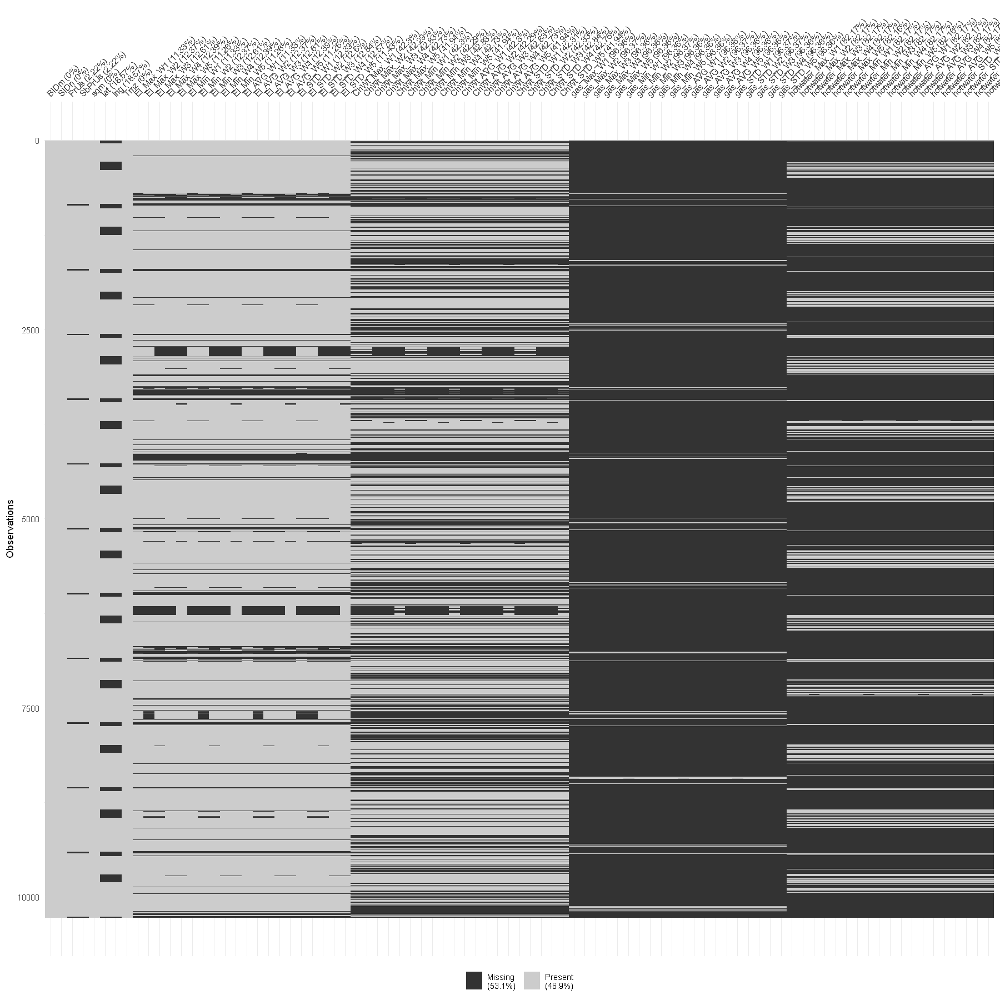

In [311]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(DF_BGP[,c(1:87)])

### Missing Values Heat Map of DF_BGP part 2 88-149

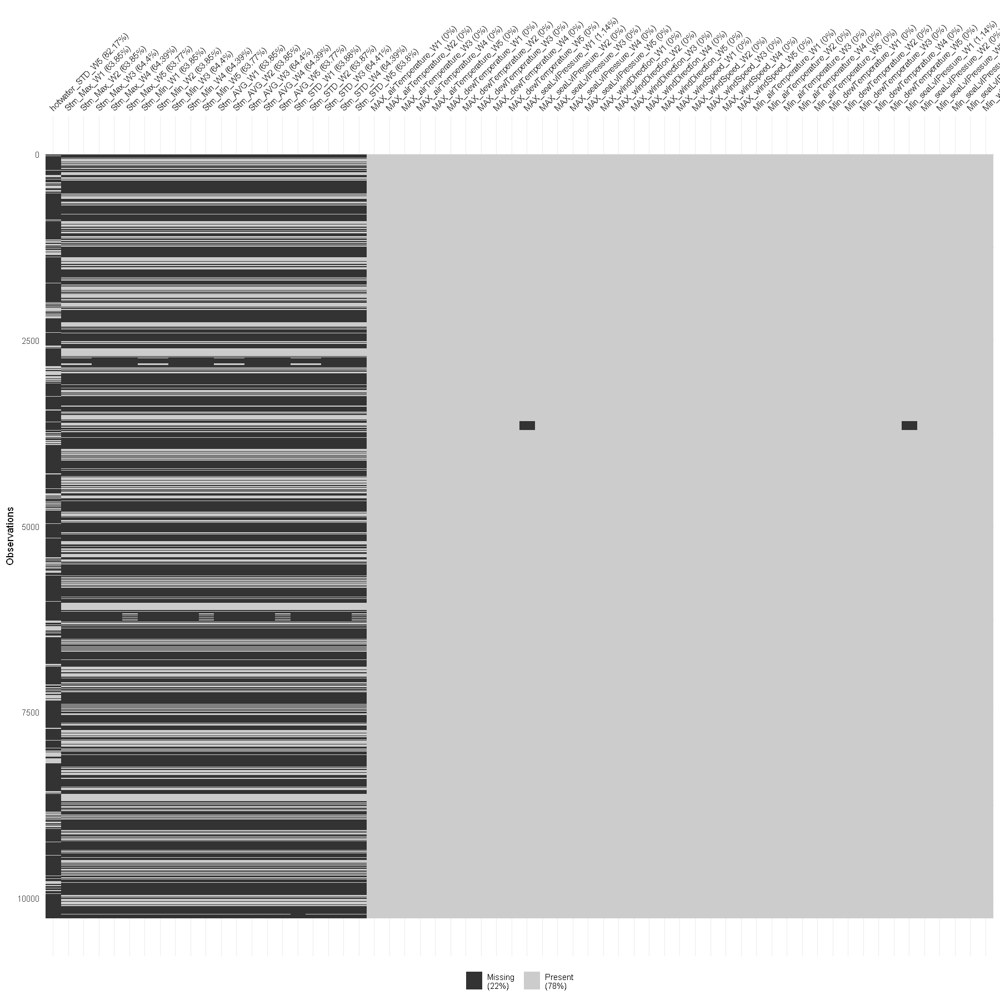

In [314]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(DF_BGP[,c(88:149)])

### Missing Values Heat Map of DF_BGP part 3 150-209

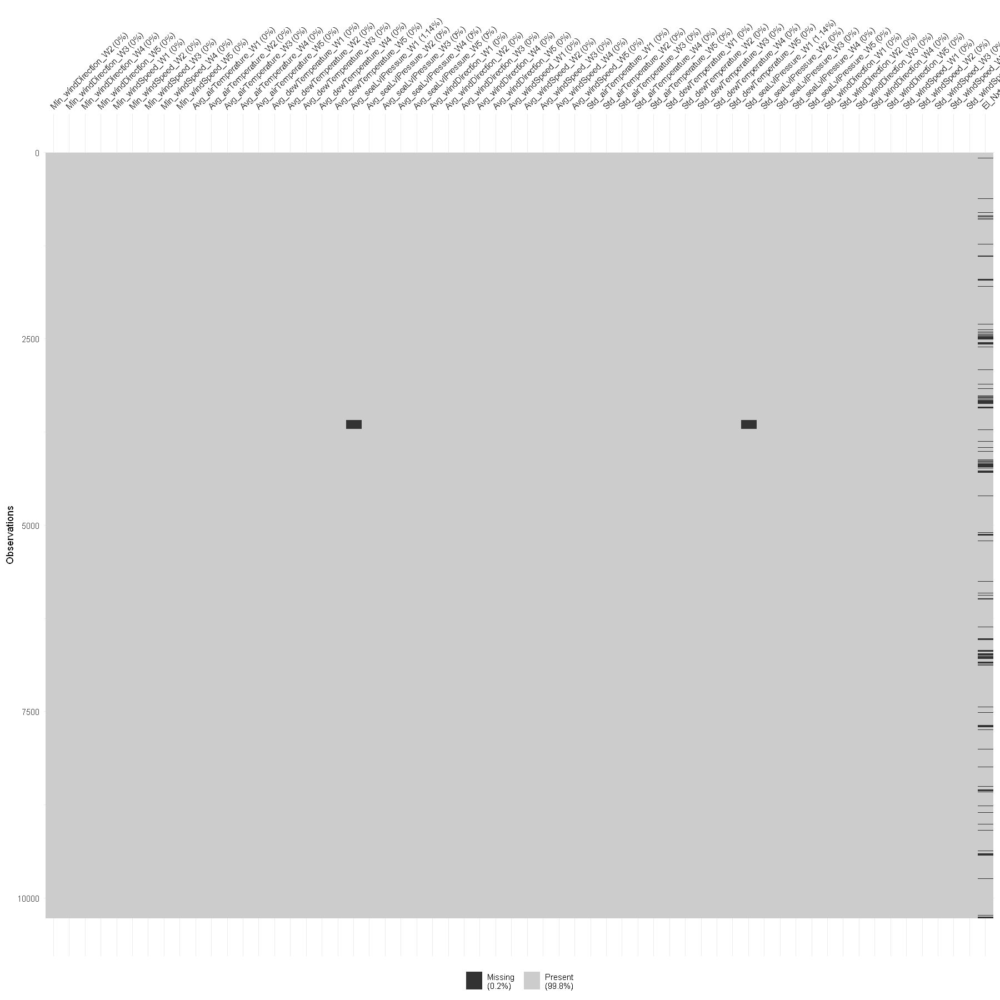

In [315]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(DF_BGP[,c(150:209)])

### Missing Values Heat Map of DF_BGP without gas and hotwater  1 (up to 124)

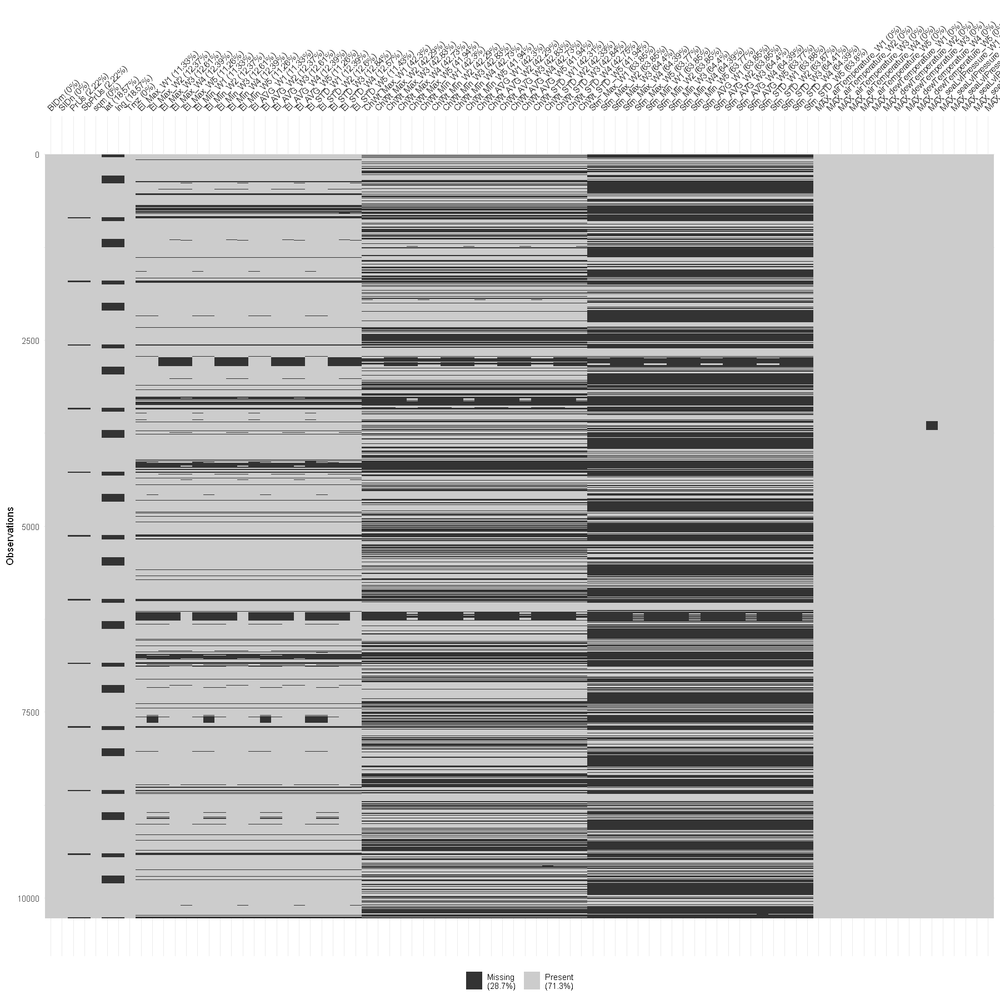

In [317]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(DF_BGP[,c(1:48,89:124)])

### Missing Values Heat Map of DF_BGP without gas and hotwater  2 (125  to 209)

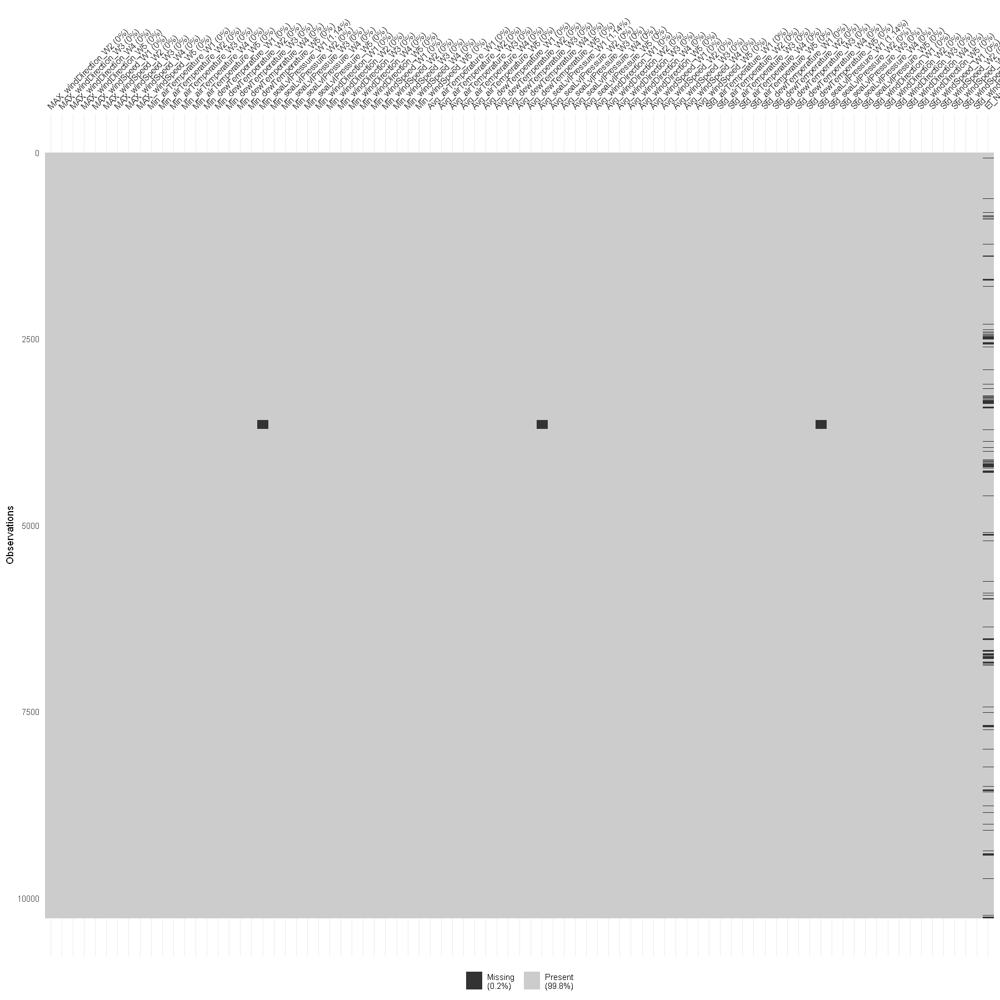

In [328]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(DF_BGP[,c(125:209)])

##   חישוב אחוז הערכים החסרים לפי שורה
### יצירת מערך מידע חדש כדי לא לפגוע בטעות במערך המידע המקורי

In [75]:
BGP_T_na <- missingMatrix(DF_BGP)


In [76]:
BGP_NA_sum <- BGP_T_na
BGP_NA_sum$mss_prs <-round(100*(rowSums(BGP_T_na)/ncol(BGP_T_na)),2)
BGP_Rw_misPr<-BGP_NA_sum %>% group_by(mss_prs) %>% tally

In [77]:
BGP_Rw_misPr

mss_prs,n
<dbl>,<int>
9.57,9
10.53,182
11.00,1
11.48,1
12.44,1
12.92,2
14.35,9
14.83,1
16.27,1


In [341]:
write.csv(BGP_Rw_misPr, file="BGP_mssRwDr_29052022.csv")

#### החלטה שרירותית לסלק 1001 שורות מתוך 10272 שהם 9% אחוז מהשורות  היות ויש יותר מ 40% מידע חסר

In [78]:
BGP_mssRwDr<-DF_BGP
BGP_mssRwDr$dropRw <- ifelse(BGP_NA_sum$mss_prs >=40,1,0)
BGP_mssRwDr<-BGP_mssRwDr %>% filter(BGP_mssRwDr$dropRw==0)

#### ביטול עמודת האינדיקציה ששימשה להסרת השורות החסרות

In [79]:
BGP_mssRwDr$dropRw <-NULL
BGP_mssRwDr_NA <- missingMatrix(BGP_mssRwDr)


### בדיקת השינוי - אמנם אין שורות בהם יש יותר מ 30% מידע חסר

In [80]:
BGP_mssRwDr_NA_sum <- BGP_mssRwDr_NA
BGP_mssRwDr_NA_sum$mss_prs <-round(100*(rowSums(BGP_mssRwDr_NA_sum)/ncol(BGP_mssRwDr_NA_sum)),2)
BGP_mssRwDr_NA_sum %>% group_by(mss_prs) %>% tally

mss_prs,n
<dbl>,<int>
9.57,9
10.53,182
11.00,1
11.48,1
12.44,1
12.92,2
14.35,9
14.83,1
16.27,1


#### השפעת הורדת השורות על הערכים החסרים בעמודות לפני ואחרי ההורדה

In [81]:
getMissingness(DF_BGP)

[[1]]
          var na.count rate
1  gas_Max_W2     9899 96.4
2  gas_Min_W2     9899 96.4
3  gas_AVG_W2     9899 96.4
4  gas_STD_W1     9899 96.4
5  gas_STD_W2     9899 96.4
6  gas_Max_W1     9898 96.4
7  gas_Max_W3     9898 96.4
8  gas_Max_W4     9898 96.4
9  gas_Max_W5     9898 96.4
10 gas_Min_W1     9898 96.4

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 10272 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>
gas_Max_W2,9899,96.4
gas_Min_W2,9899,96.4
gas_AVG_W2,9899,96.4
gas_STD_W1,9899,96.4
gas_STD_W2,9899,96.4
gas_Max_W1,9898,96.4
gas_Max_W3,9898,96.4
gas_Max_W4,9898,96.4
gas_Max_W5,9898,96.4


In [82]:
getMissingness(BGP_mssRwDr)

[[1]]
          var na.count rate
1  gas_Max_W2     8897   96
2  gas_Min_W2     8897   96
3  gas_AVG_W2     8897   96
4  gas_STD_W1     8897   96
5  gas_STD_W2     8897   96
6  gas_Max_W1     8896   96
7  gas_Max_W3     8896   96
8  gas_Max_W4     8896   96
9  gas_Max_W5     8896   96
10 gas_Min_W1     8896   96

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 9270 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>
gas_Max_W2,8897,96.0
gas_Min_W2,8897,96.0
gas_AVG_W2,8897,96.0
gas_STD_W1,8897,96.0
gas_STD_W2,8897,96.0
gas_Max_W1,8896,96.0
gas_Max_W3,8896,96.0
gas_Max_W4,8896,96.0
gas_Max_W5,8896,96.0


## תצוגה ויזואלית של הערכים החזרים אחרי הורדת השורות

Warning message:
"`gather_()` was deprecated in tidyr 1.2.0.
Please use `gather()` instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated."


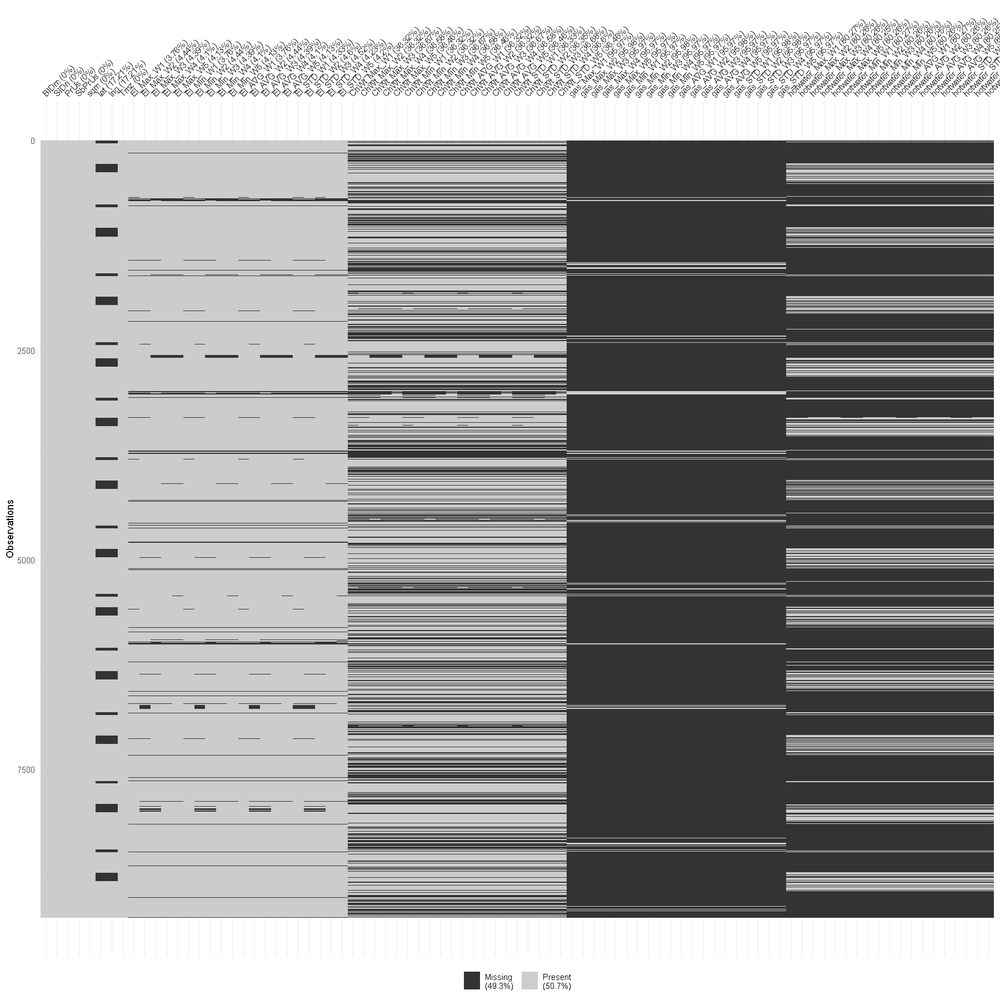

In [43]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_mssRwDr[,c(1:87)])

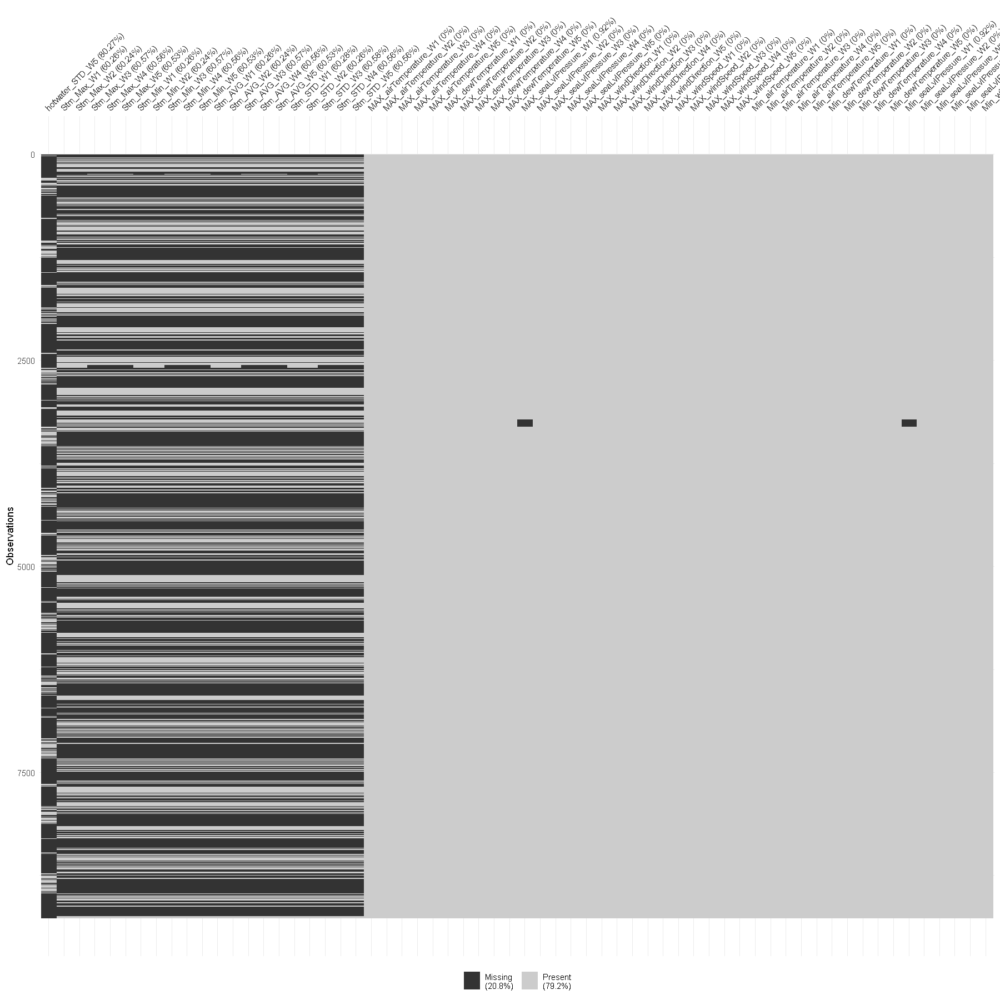

In [44]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_mssRwDr[,c(88:149)])

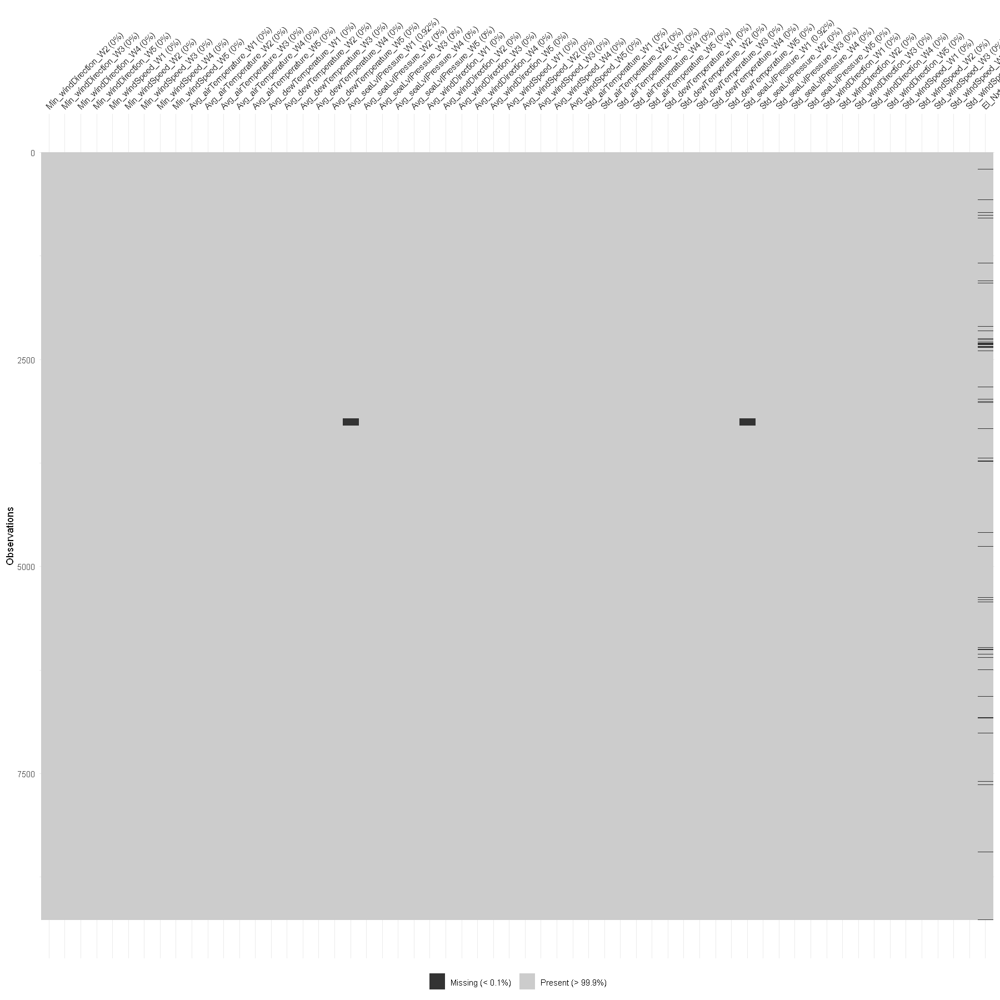

In [47]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_mssRwDr[,c(150:209)])

##   חישוב אחוז הערכים החסרים לפי שורה
# without gas and hot water
### יצירת מערך מידע חדש כדי לא לפגוע בטעות במערך המידע המקורי

In [48]:
BGP_Xghw_T_na <- missingMatrix(DF_BGP[,c(1:48,89:124)])


In [49]:
BGP_Xghw_NA_sum <- BGP_Xghw_T_na 
BGP_Xghw_NA_sum$mss_prs <-round(100*(rowSums(BGP_Xghw_T_na )/ncol(BGP_Xghw_T_na )),2)
BGP_Xghw_Rw_misPr<-BGP_Xghw_NA_sum %>% group_by(mss_prs) %>% tally

In [50]:
BGP_Xghw_Rw_misPr

mss_prs,n
<dbl>,<int>
0.00,2242
1.19,34
2.38,483
4.76,15
5.95,3
7.14,5
9.52,5
10.71,1
11.90,15


In [350]:
write.csv(BGP_Xghw_Rw_misPr, file="BGP_Xghw_mssRwDr_29052022.csv")

#### החלטה שרירותית לסלק  1100שורות מתוך  10272שהם 10% אחוז מהשורות  היות ויש יותר מ 50% מידע חסר

In [51]:
BGP_Xghw_mssRwDr<-DF_BGP[,c(1:48,89:124)]
BGP_Xghw_mssRwDr$dropRw <- ifelse(BGP_Xghw_NA_sum$mss_prs >=50,1,0)
BGP_Xghw_mssRwDr<-BGP_Xghw_mssRwDr %>% filter(BGP_Xghw_mssRwDr$dropRw==0)

#### ביטול עמודת האינדיקציה ששימשה להסרת השורות החסרות

In [52]:
BGP_Xghw_mssRwDr$dropRw <-NULL
BGP_Xghw_mssRwDr_NA <- missingMatrix(BGP_Xghw_mssRwDr)


### בדיקת השינוי - אמנם אין שורות בהם יש יותר מ 50% מידע חסר

In [53]:
BGP_Xghw_mssRwDr_NA_sum <- BGP_Xghw_mssRwDr_NA
BGP_Xghw_mssRwDr_NA_sum$mss_prs <-round(100*(rowSums(BGP_Xghw_mssRwDr_NA_sum)/ncol(BGP_Xghw_mssRwDr_NA_sum)),2)
BGP_Xghw_mssRwDr_NA_sum %>% group_by(mss_prs) %>% tally

mss_prs,n
<dbl>,<int>
0.00,2242
1.19,34
2.38,483
4.76,15
5.95,3
7.14,5
9.52,5
10.71,1
11.90,15


#### השפעת הורדת השורות על הערכים החסרים בעמודות לפני ואחרי ההורדה

In [54]:
getMissingness(DF_BGP[,c(1:48,89:124)])

[[1]]
          var na.count rate
1  Stm_STD_W3     6616 64.4
2  Stm_Max_W3     6615 64.4
3  Stm_Min_W3     6615 64.4
4  Stm_AVG_W3     6615 64.4
5  Stm_Max_W4     6614 64.4
6  Stm_Min_W4     6614 64.4
7  Stm_AVG_W4     6614 64.4
8  Stm_STD_W4     6614 64.4
9  Stm_STD_W1     6562 63.9
10 Stm_STD_W2     6561 63.9

[[2]]
[1] "This dataset has 2242 (21.8%) complete rows. Original data has 10272 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>
Stm_STD_W3,6616,64.4
Stm_Max_W3,6615,64.4
Stm_Min_W3,6615,64.4
Stm_AVG_W3,6615,64.4
Stm_Max_W4,6614,64.4
Stm_Min_W4,6614,64.4
Stm_AVG_W4,6614,64.4
Stm_STD_W4,6614,64.4
Stm_STD_W1,6562,63.9


In [55]:
getMissingness(BGP_Xghw_mssRwDr)

[[1]]
          var na.count rate
1  Stm_STD_W3     5217 58.8
2  Stm_Max_W3     5216 58.8
3  Stm_Min_W3     5216 58.8
4  Stm_AVG_W3     5216 58.8
5  Stm_Max_W4     5215 58.8
6  Stm_Min_W4     5215 58.8
7  Stm_AVG_W4     5215 58.8
8  Stm_STD_W4     5215 58.8
9  Stm_STD_W5     5215 58.8
10 Stm_Max_W5     5212 58.8

[[2]]
[1] "This dataset has 2242 (25.3%) complete rows. Original data has 8871 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>
Stm_STD_W3,5217,58.8
Stm_Max_W3,5216,58.8
Stm_Min_W3,5216,58.8
Stm_AVG_W3,5216,58.8
Stm_Max_W4,5215,58.8
Stm_Min_W4,5215,58.8
Stm_AVG_W4,5215,58.8
Stm_STD_W4,5215,58.8
Stm_STD_W5,5215,58.8


In [287]:
#options(repr.plot.width = 15, repr.plot.height = 15)
#vis_miss(ShBo_Fc[c(1,3:8,10,12:36,39,40,45:79,81:83)])

### #############################
## עד כאן ניתוח והסרת שורות
## מכאן ניתוח וטיפול בעמודות / משתנים


In [83]:
mm <- getMissingness(DF_BGP, getRows = TRUE) # All the original data frame

[[1]]
          var na.count rate
1  gas_Max_W2     9899 96.4
2  gas_Min_W2     9899 96.4
3  gas_AVG_W2     9899 96.4
4  gas_STD_W1     9899 96.4
5  gas_STD_W2     9899 96.4
6  gas_Max_W1     9898 96.4
7  gas_Max_W3     9898 96.4
8  gas_Max_W4     9898 96.4
9  gas_Max_W5     9898 96.4
10 gas_Min_W1     9898 96.4

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 10272 rows."



#### כמות השורות שונה - במערך המידע החדש ללא שורות בעייתיות הורדנו 1002 שורות 

In [84]:
mm <- getMissingness(BGP_mssRwDr, getRows = TRUE) # After lines with 50% missing droped (1100)

[[1]]
          var na.count rate
1  gas_Max_W2     8897   96
2  gas_Min_W2     8897   96
3  gas_AVG_W2     8897   96
4  gas_STD_W1     8897   96
5  gas_STD_W2     8897   96
6  gas_Max_W1     8896   96
7  gas_Max_W3     8896   96
8  gas_Max_W4     8896   96
9  gas_Max_W5     8896   96
10 gas_Min_W1     8896   96

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 9270 rows."



#### כמות השורות שונה - במערך המידע החדש ללא שורות בעייתיות הורדנו 1401 שורות 

In [85]:
mm <- getMissingness(BGP_Xghw_mssRwDr, getRows = TRUE) # after lines witout 40% missing and Without gas and hotwater (1401)

ERROR: Error in nrow(data): object 'BGP_Xghw_mssRwDr' not found


### ויזואליזציה של השפעת הערכים החסרים על התפלגות המשתנים הנומריים

In [60]:
library(gridExtra)
library(ggplot2)

In [86]:
numrNames<-names(Filter(is.numeric, DF_BGP))

In [87]:
length(numrNames)

[1] 204

### just checking - The non numeric featuers were converted to factors...

In [88]:
numrNames<-names(Filter(is.numeric, DF_BGP_chFc))

In [89]:
length(numrNames)

[1] 204

In [66]:
numrNames

[1] "sqm"                   "lat"                   "lng"                  
  [4] "El_Max_W1"             "El_Max_W2"             "El_Max_W3"            
  [7] "El_Max_W4"             "El_Max_W5"             "El_Min_W1"            
 [10] "El_Min_W2"             "El_Min_W3"             "El_Min_W4"            
 [13] "El_Min_W5"             "El_AVG_W1"             "El_AVG_W2"            
 [16] "El_AVG_W3"             "El_AVG_W4"             "El_AVG_W5"            
 [19] "El_STD_W1"             "El_STD_W2"             "El_STD_W3"            
 [22] "El_STD_W4"             "El_STD_W5"             "ChWt_Max_W1"          
 [25] "ChWt_Max_W2"           "ChWt_Max_W3"           "ChWt_Max_W4"          
 [28] "ChWt_Max_W5"           "ChWt_Min_W1"           "ChWt_Min_W2"          
 [31] "ChWt_Min_W3"           "ChWt_Min_W4"           "ChWt_Min_W5"          
 [34] "ChWt_AVG_W1"           "ChWt_AVG_W2"           "ChWt_AVG_W3"          
 [37] "ChWt_AVG_W4"           "ChWt_AVG_W5"           "ChWt_STD_W1"          
 [40] "ChWt_STD_W2"           "ChWt_STD_W3"           "ChWt_STD_W4"          
 [43] "ChWt_STD_W5"           "gas_Max_W1"            "gas_Max_W2"           
 [46] "gas_Max_W3"            "gas_Max_W4"            "gas_Max_W5"           
 [49] "gas_Min_W1"            "gas_Min_W2"            "gas_Min_W3"           
 [52] "gas_Min_W4"            "gas_Min_W5"            "gas_AVG_W1"           
 [55] "gas_AVG_W2"            "gas_AVG_W3"            "gas_AVG_W4"           
 [58] "gas_AVG_W5"            "gas_STD_W1"            "gas_STD_W2"           
 [61] "gas_STD_W3"            "gas_STD_W4"            "gas_STD_W5"           
 [64] "hotwater_Max_W1"       "hotwater_Max_W2"       "hotwater_Max_W3"      
 [67] "hotwater_Max_W4"       "hotwater_Max_W5"       "hotwater_Min_W1"      
 [70] "hotwater_Min_W2"       "hotwater_Min_W3"       "hotwater_Min_W4"      
 [73] "hotwater_Min_W5"       "hotwater_AVG_W1"       "hotwater_AVG_W2"      
 [76] "hotwater_AVG_W3"       "hotwater_AVG_W4"       "hotwater_AVG_W5"      
 [79] "hotwater_STD_W1"       "hotwater_STD_W2"       "hotwater_STD_W3"      
 [82] "hotwater_STD_W4"       "hotwater_STD_W5"       "Stm_Max_W1"           
 [85] "Stm_Max_W2"            "Stm_Max_W3"            "Stm_Max_W4"           
 [88] "Stm_Max_W5"            "Stm_Min_W1"            "Stm_Min_W2"           
 [91] "Stm_Min_W3"            "Stm_Min_W4"            "Stm_Min_W5"           
 [94] "Stm_AVG_W1"            "Stm_AVG_W2"            "Stm_AVG_W3"           
 [97] "Stm_AVG_W4"            "Stm_AVG_W5"            "Stm_STD_W1"           
[100] "Stm_STD_W2"            "Stm_STD_W3"            "Stm_STD_W4"           
[103] "Stm_STD_W5"            "MAX_airTemperature_W1" "MAX_airTemperature_W2"
[106] "MAX_airTemperature_W3" "MAX_airTemperature_W4" "MAX_airTemperature_W5"
[109] "MAX_dewTemperature_W1" "MAX_dewTemperature_W2" "MAX_dewTemperature_W3"
[112] "MAX_dewTemperature_W4" "MAX_dewTemperature_W5" "MAX_seaLvlPressure_W1"
[115] "MAX_seaLvlPressure_W2" "MAX_seaLvlPressure_W3" "MAX_seaLvlPressure_W4"
[118] "MAX_seaLvlPressure_W5" "MAX_windDirection_W1"  "MAX_windDirection_W2" 
[121] "MAX_windDirection_W3"  "MAX_windDirection_W4"  "MAX_windDirection_W5" 
[124] "MAX_windSpeed_W1"      "MAX_windSpeed_W2"      "MAX_windSpeed_W3"     
[127] "MAX_windSpeed_W4"      "MAX_windSpeed_W5"      "Min_airTemperature_W1"
[130] "Min_airTemperature_W2" "Min_airTemperature_W3" "Min_airTemperature_W4"
[133] "Min_airTemperature_W5" "Min_dewTemperature_W1" "Min_dewTemperature_W2"
[136] "Min_dewTemperature_W3" "Min_dewTemperature_W4" "Min_dewTemperature_W5"
[139] "Min_seaLvlPressure_W1" "Min_seaLvlPressure_W2" "Min_seaLvlPressure_W3"
[142] "Min_seaLvlPressure_W4" "Min_seaLvlPressure_W5" "Min_windDirection_W1" 
[145] "Min_windDirection_W2"  "Min_windDirection_W3"  "Min_windDirection_W4" 
[148] "Min_windDirection_W5"  "Min_windSpeed_W1"      "Min_windSpeed_W2"     
[151] "Min_windSpeed_W3"      "Min_windSpeed_W4"      "Min_windSpeed_W5"     
[154] "Avg_airTemperatur

# -- changed... must run agien
### Visual check of influance of with and without missingnes on density plot


Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."


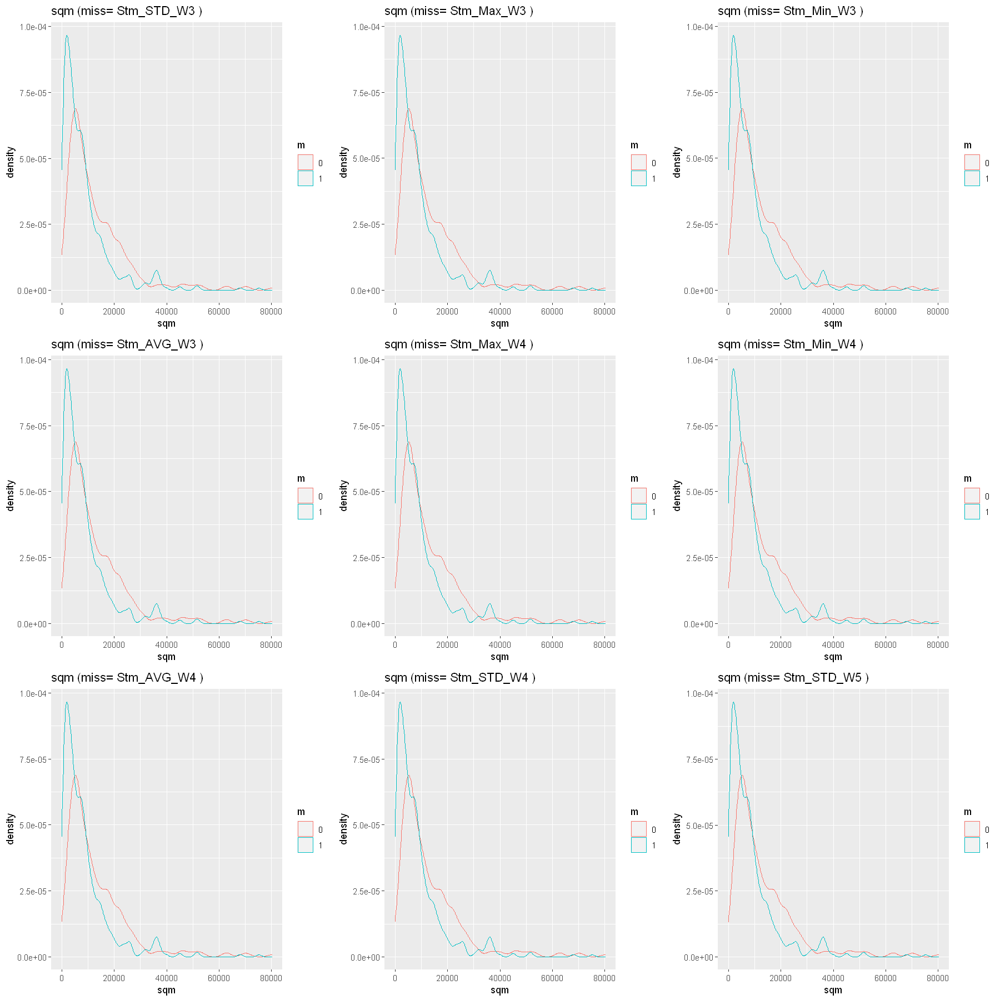

Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1595 rows containing non-finite values (stat_density)."


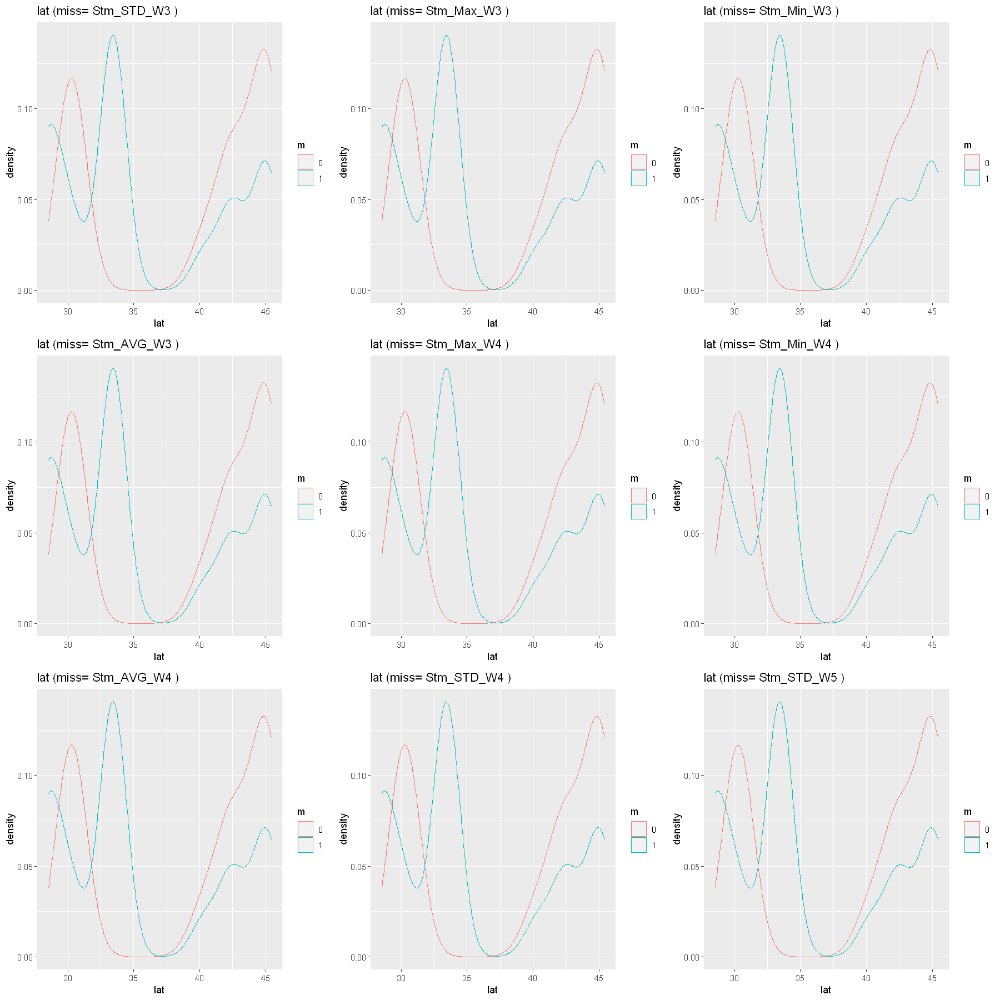

Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."


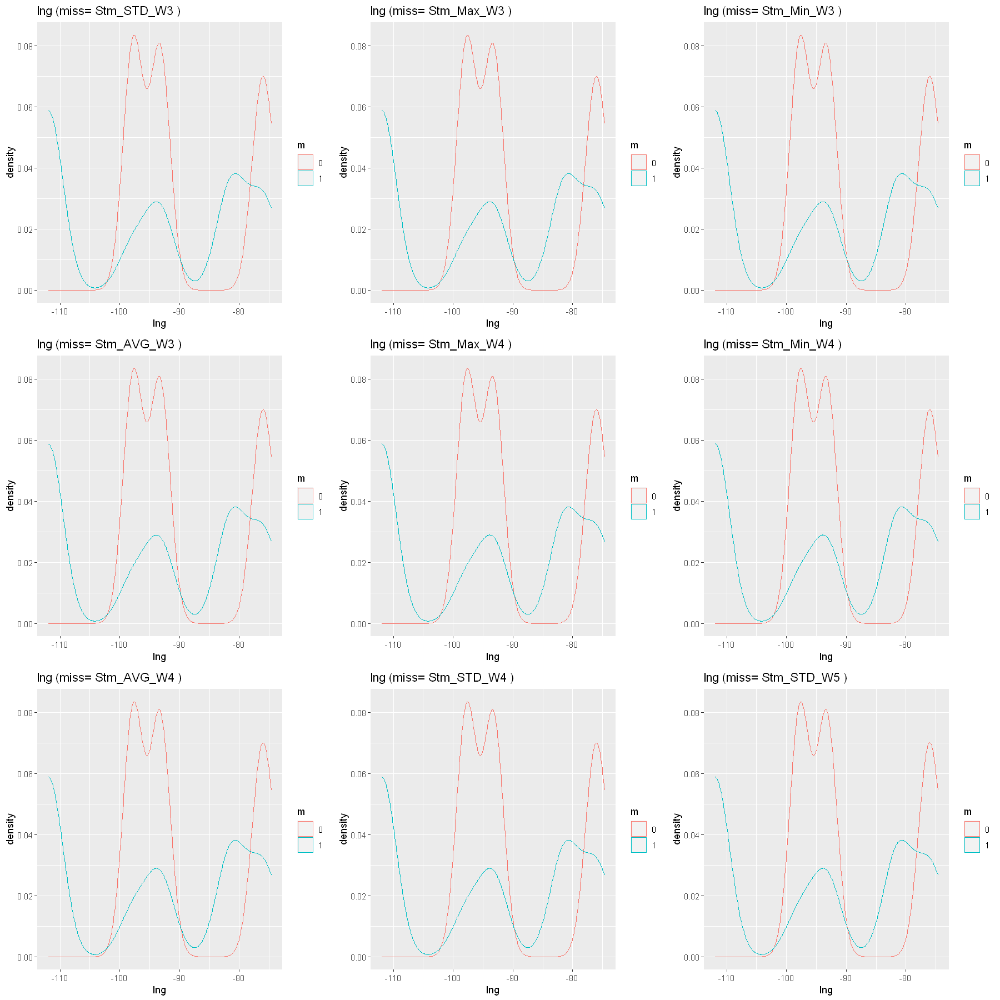

Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."


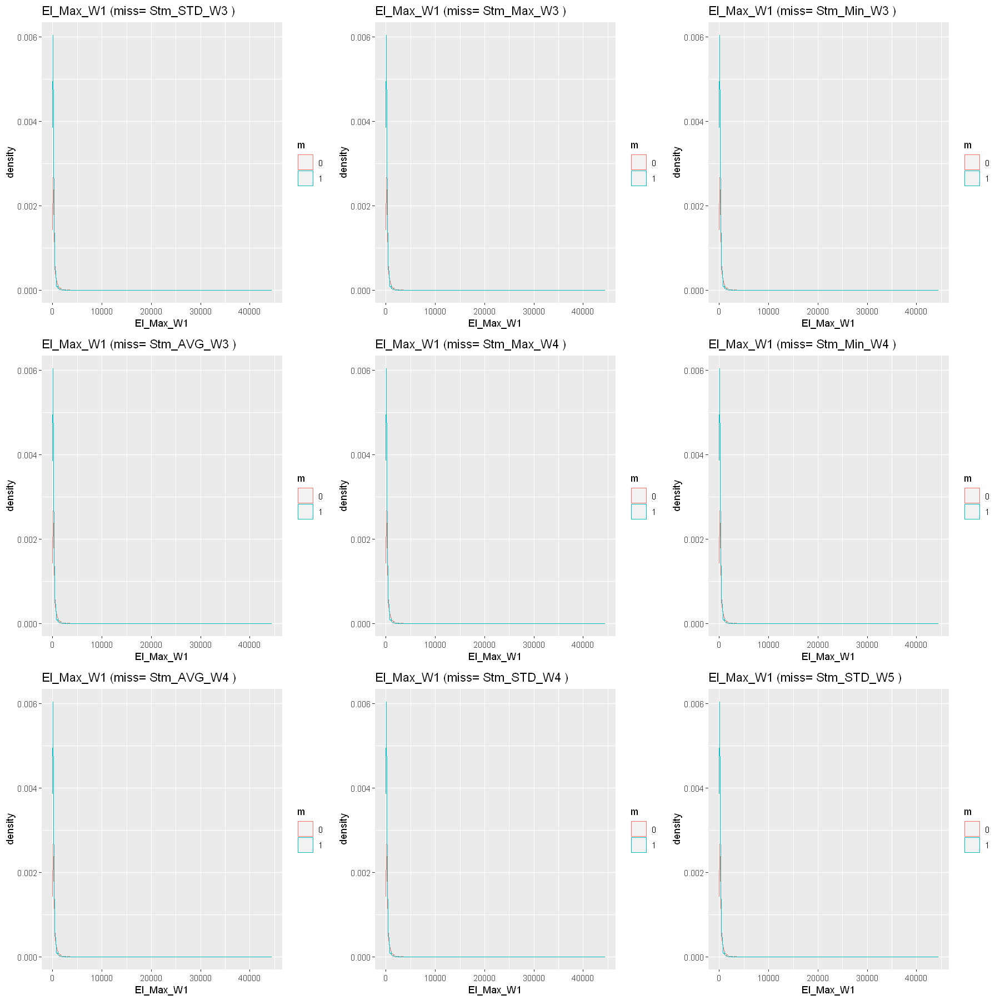

Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."


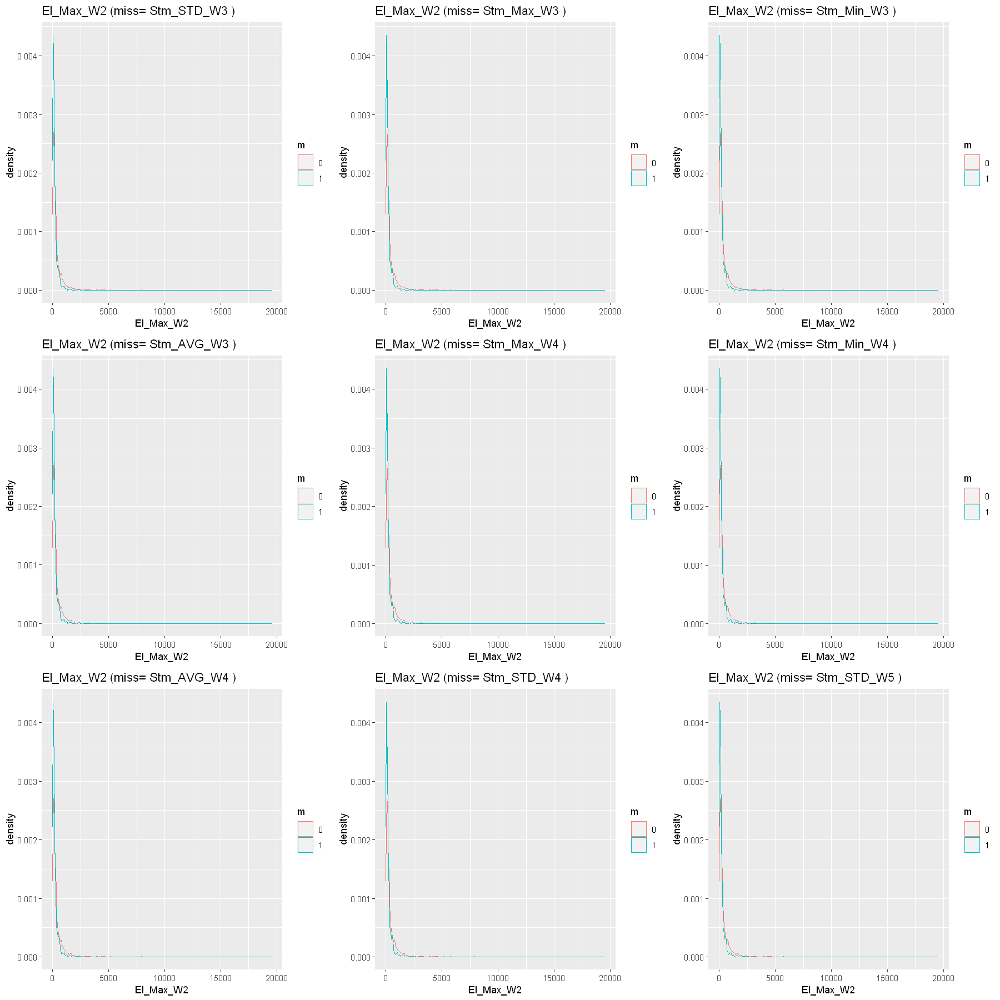

Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."


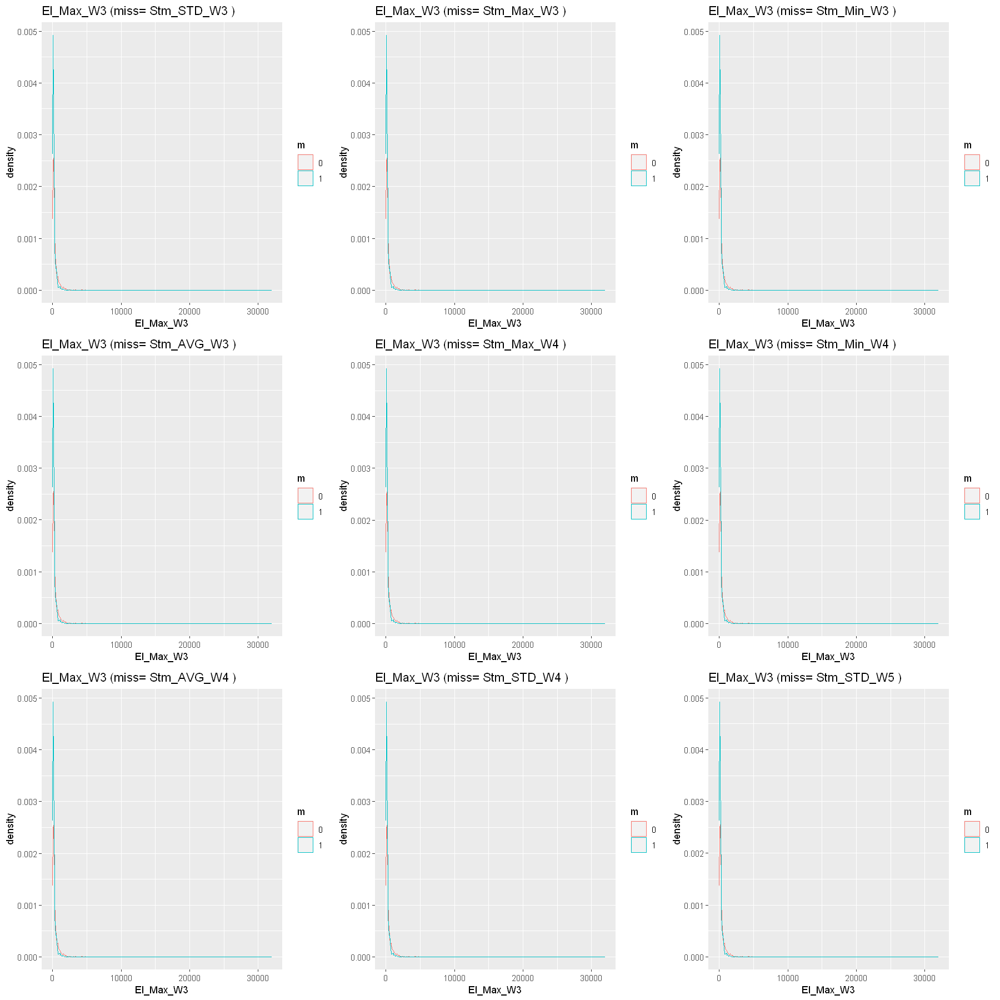

Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."


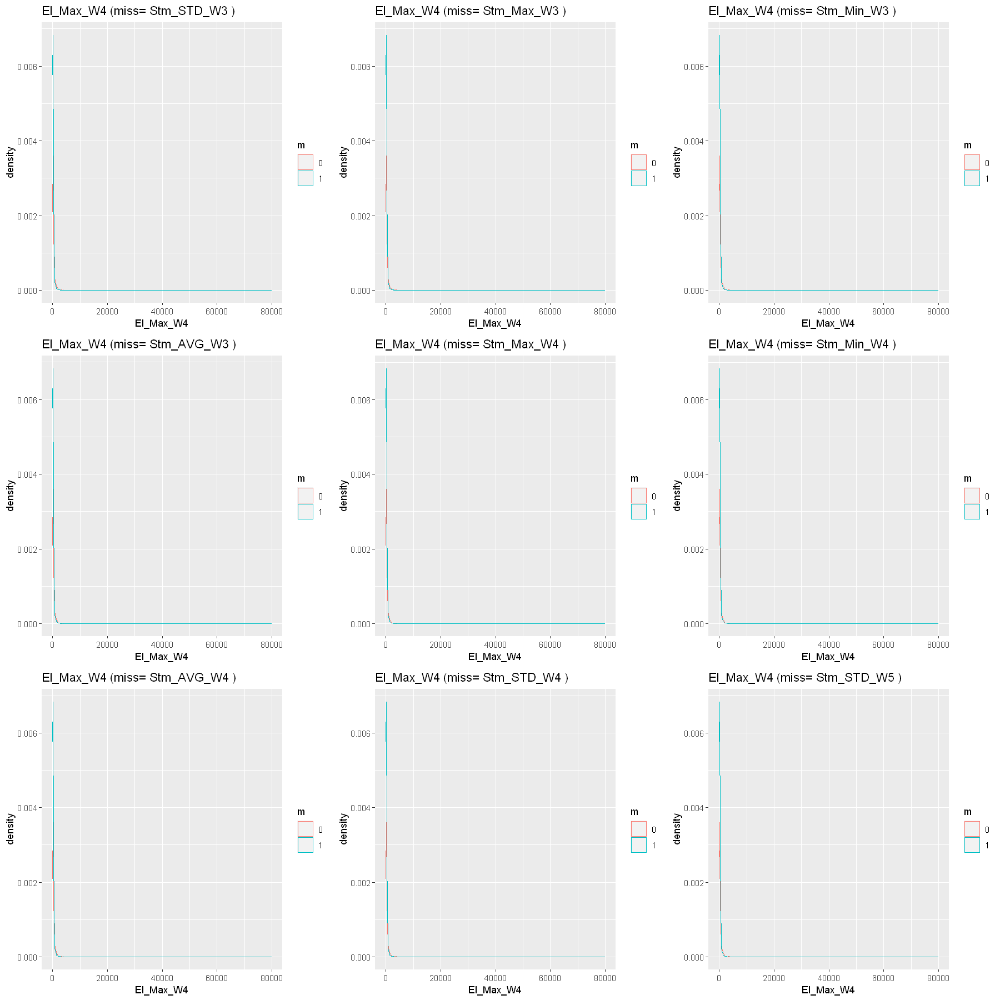

Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."


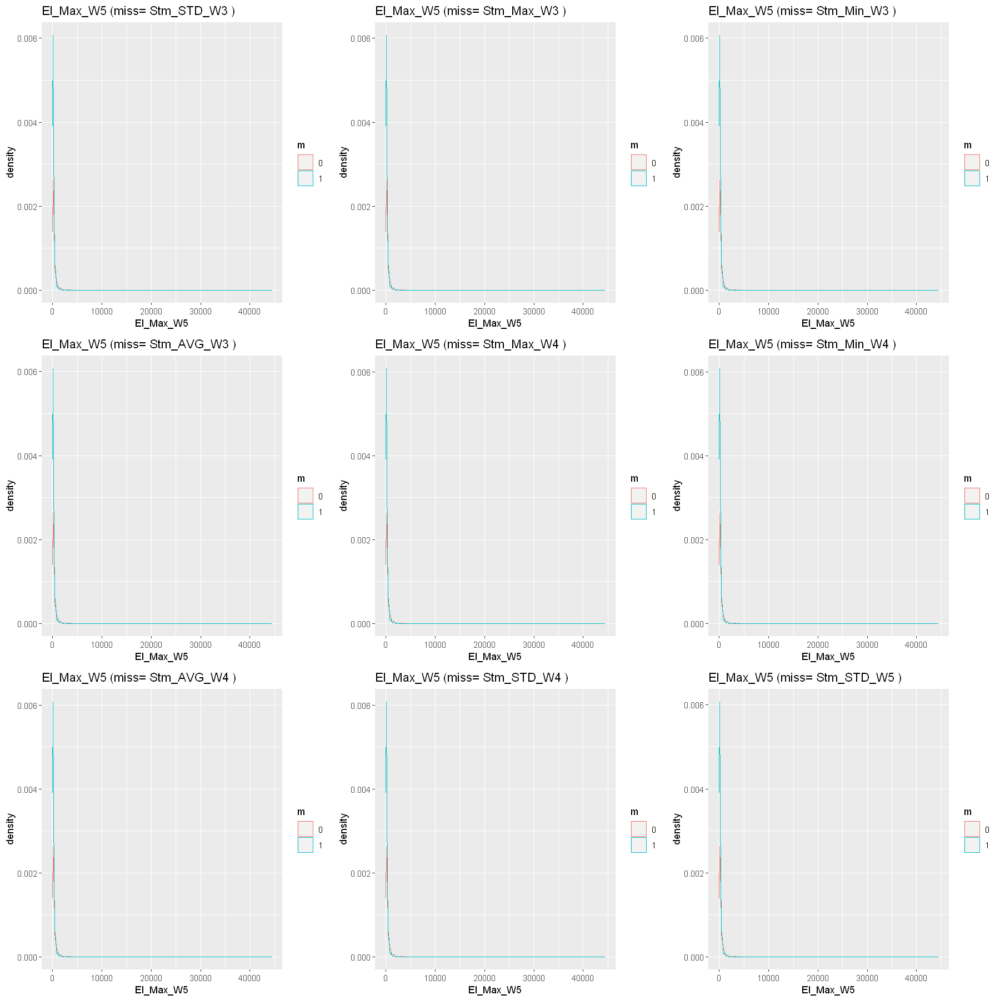

Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."


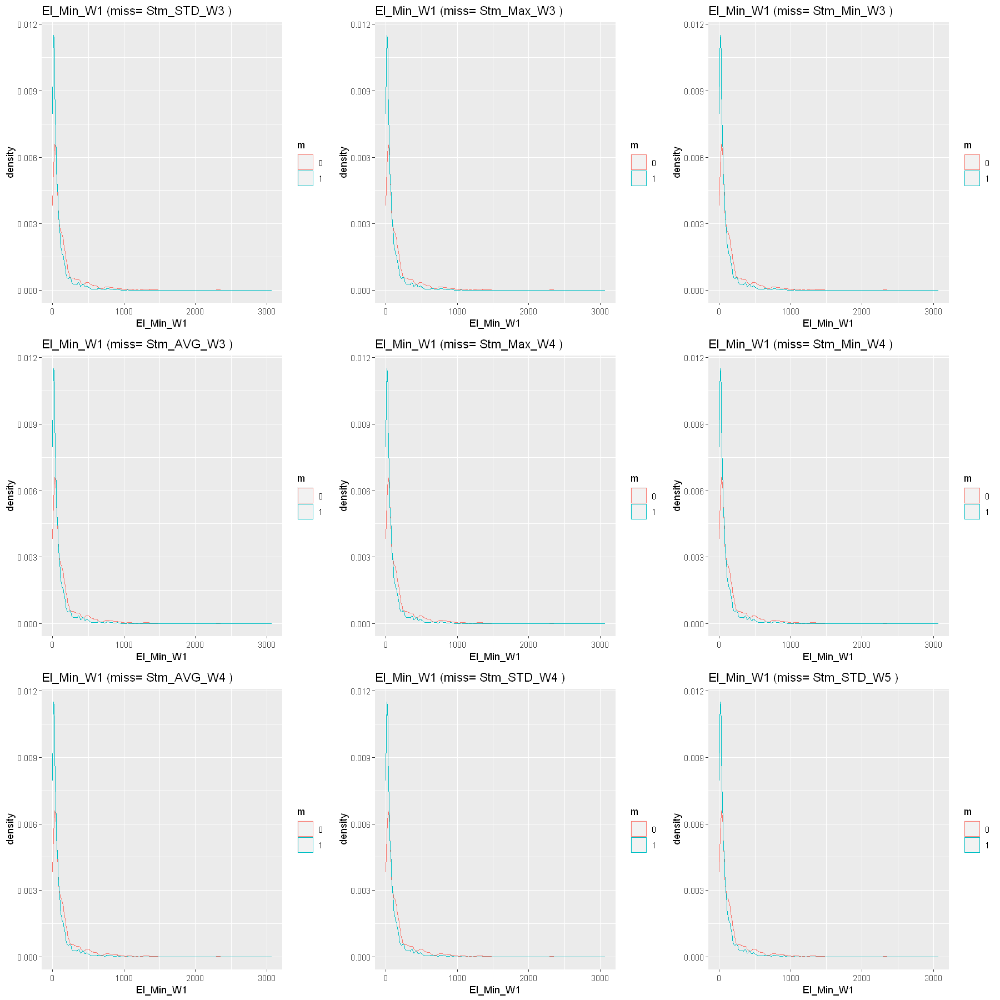

Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."


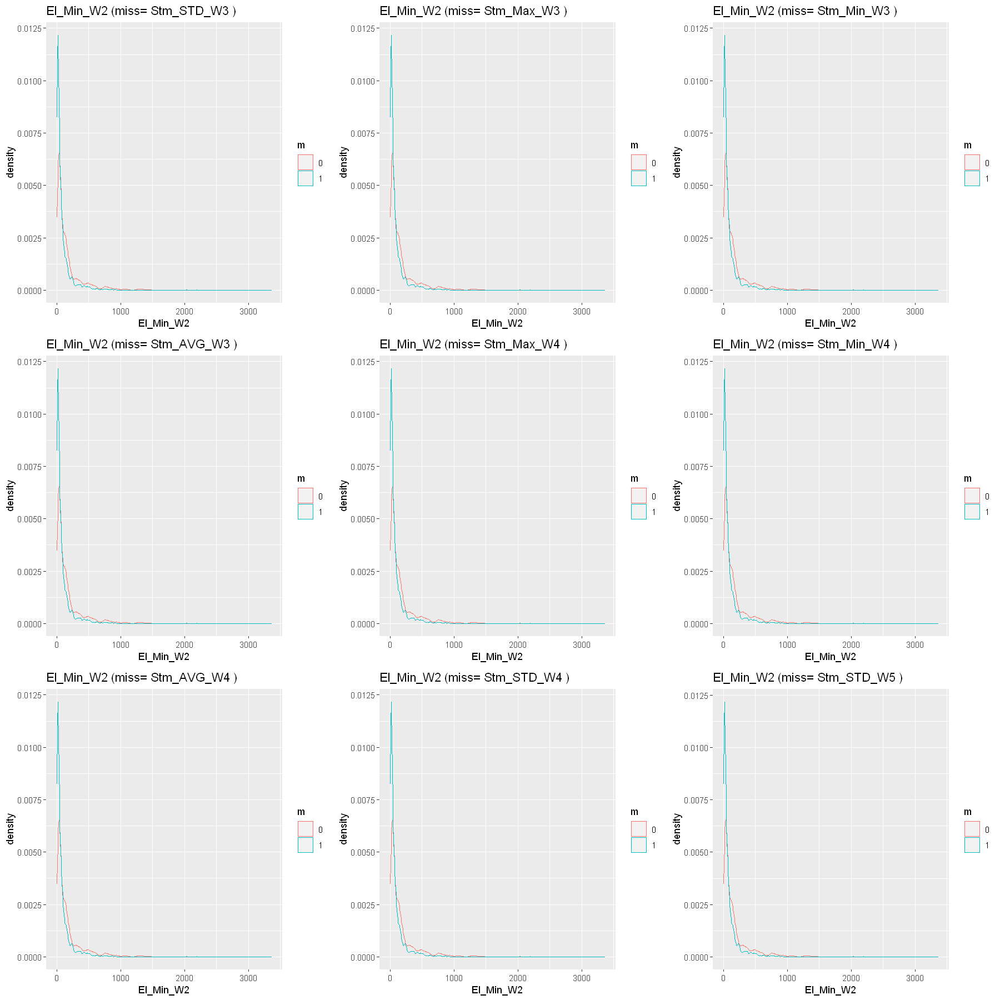

Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."


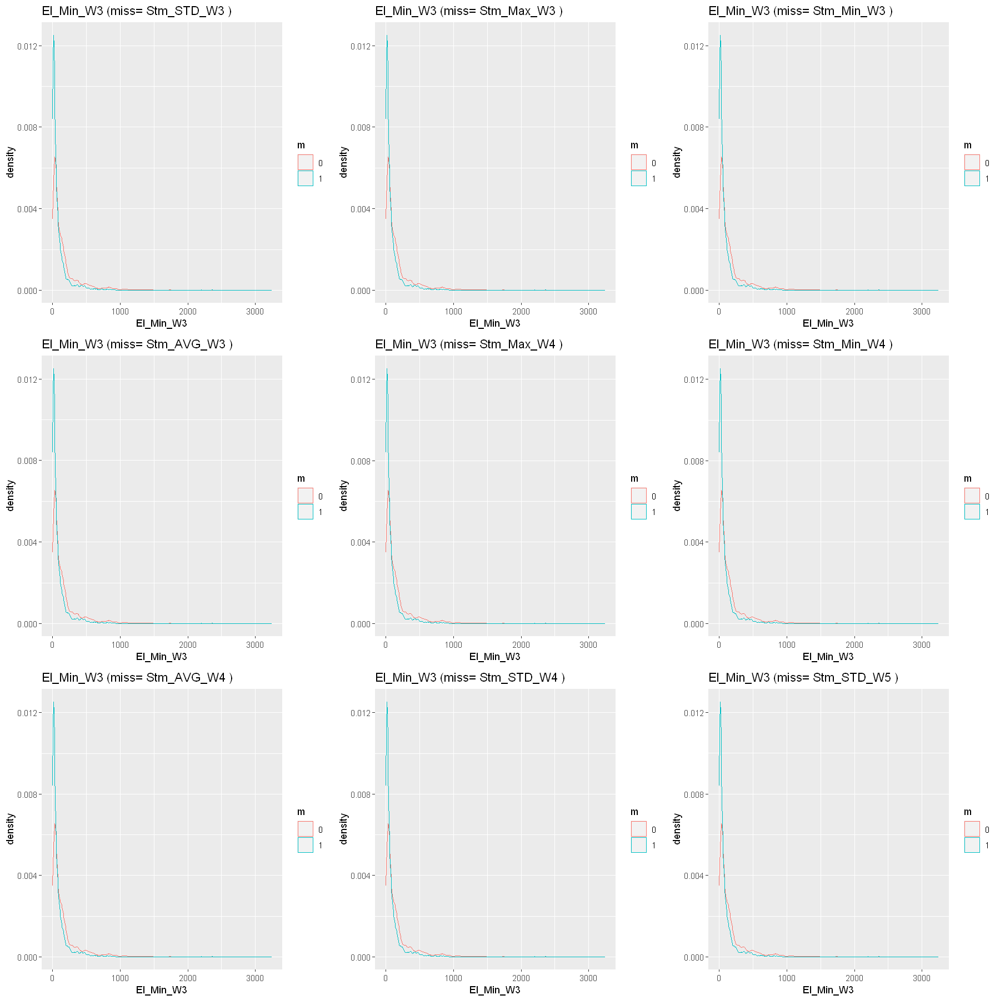

Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."


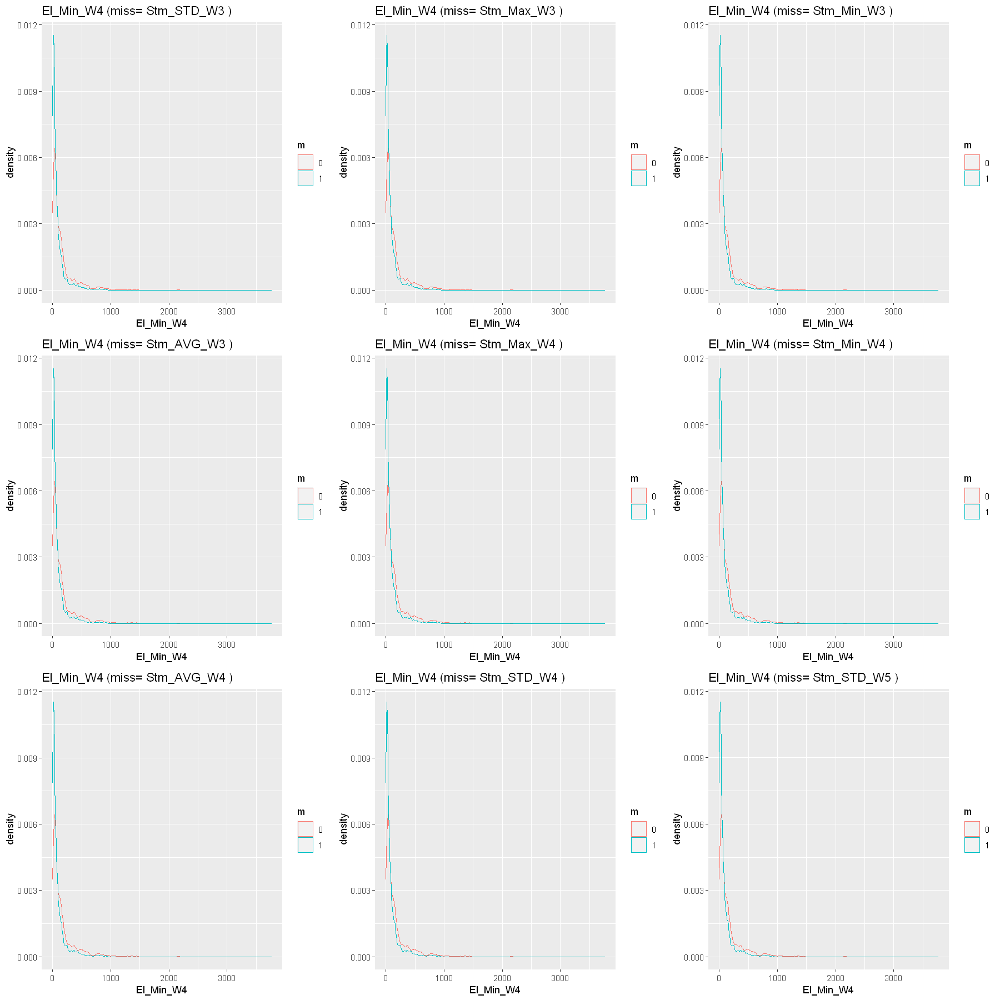

Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."
Warning message:
"Removed 349 rows containing non-finite values (stat_density)."


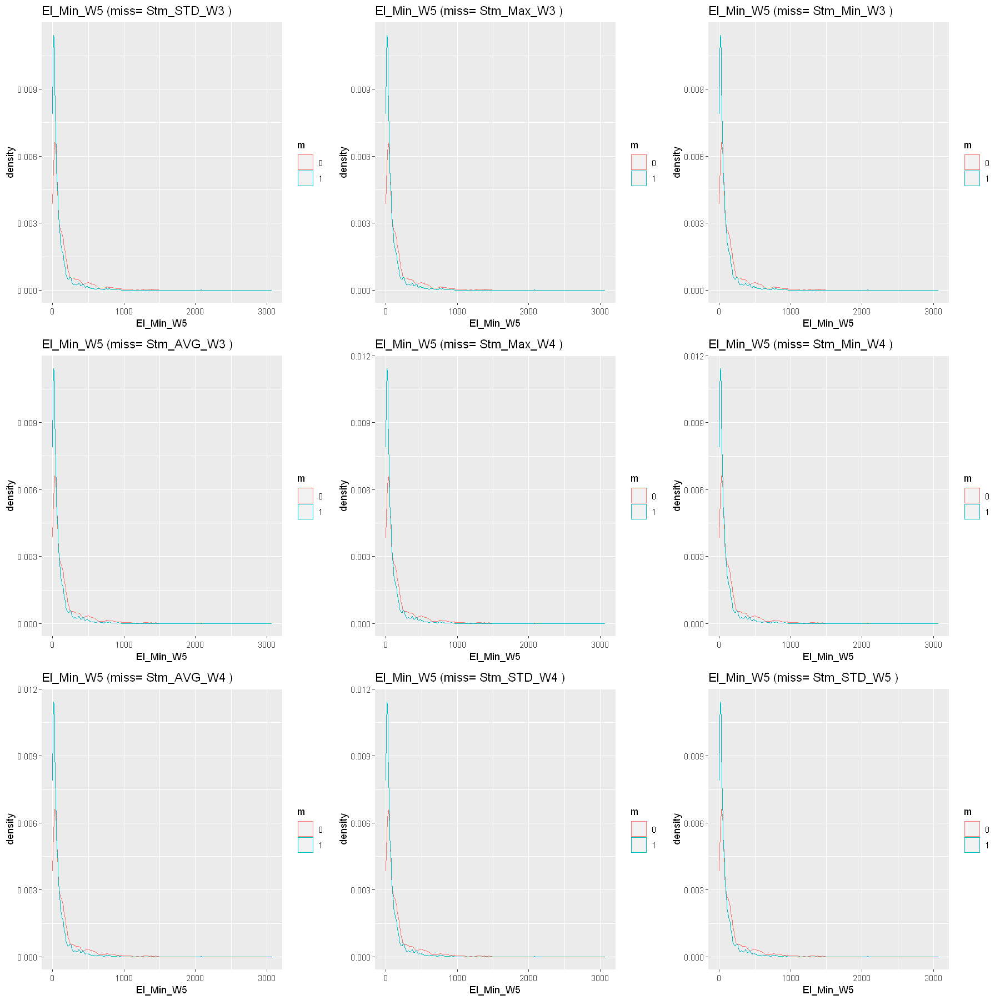

Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."
Warning message:
"Removed 412 rows containing non-finite values (stat_density)."


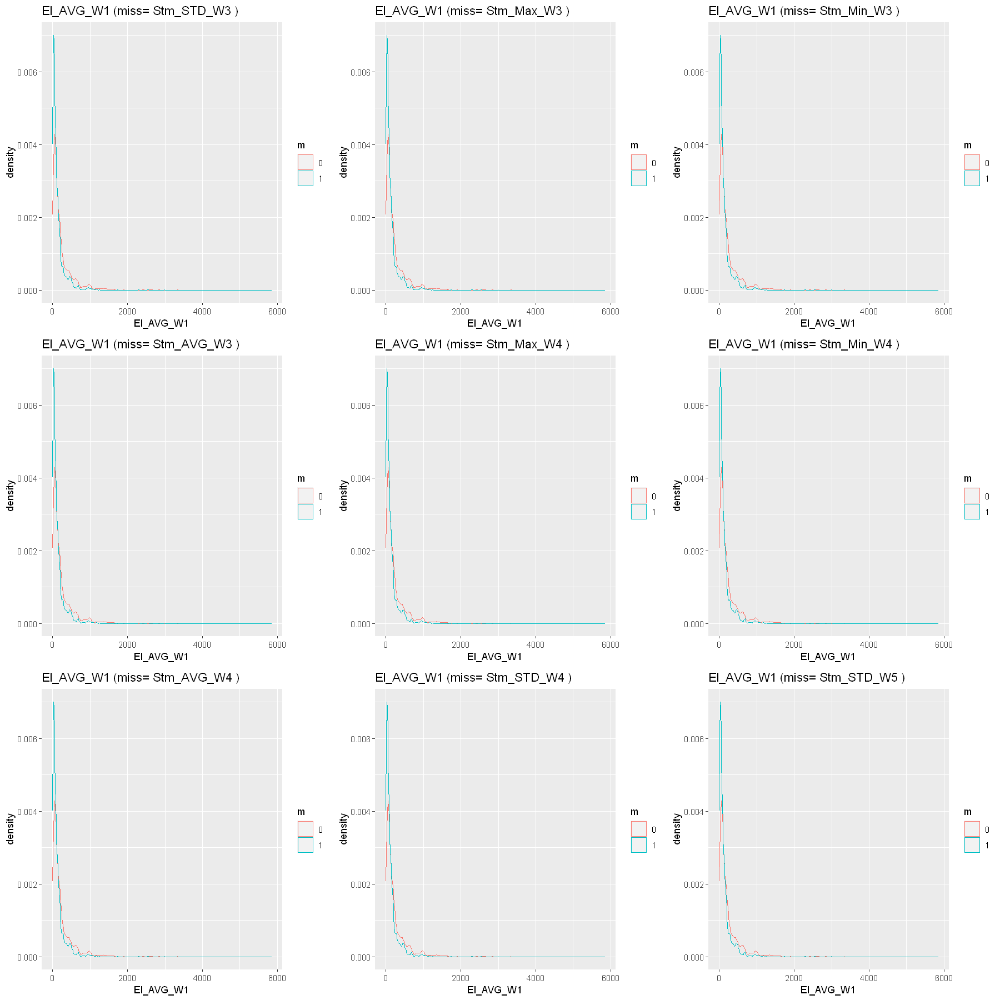

Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."
Warning message:
"Removed 407 rows containing non-finite values (stat_density)."


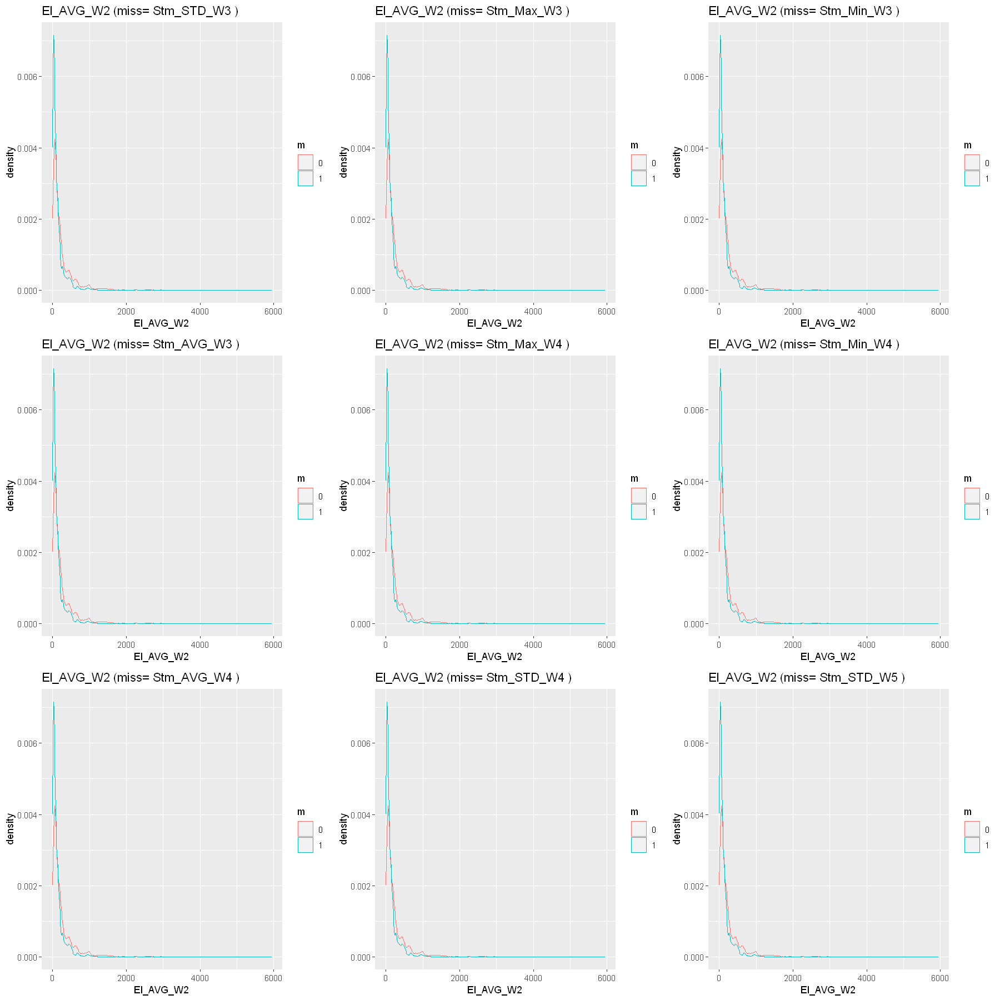

Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 380 rows containing non-finite values (stat_density)."


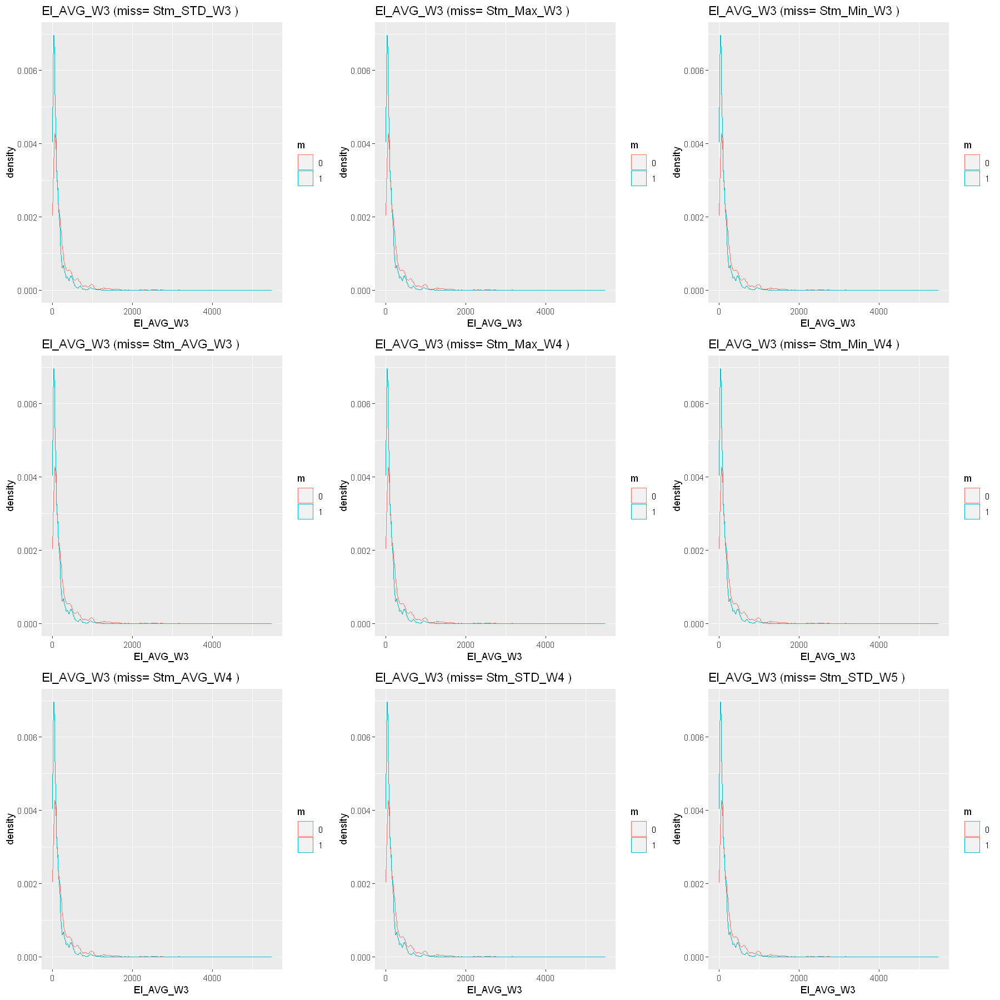

Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."
Warning message:
"Removed 383 rows containing non-finite values (stat_density)."


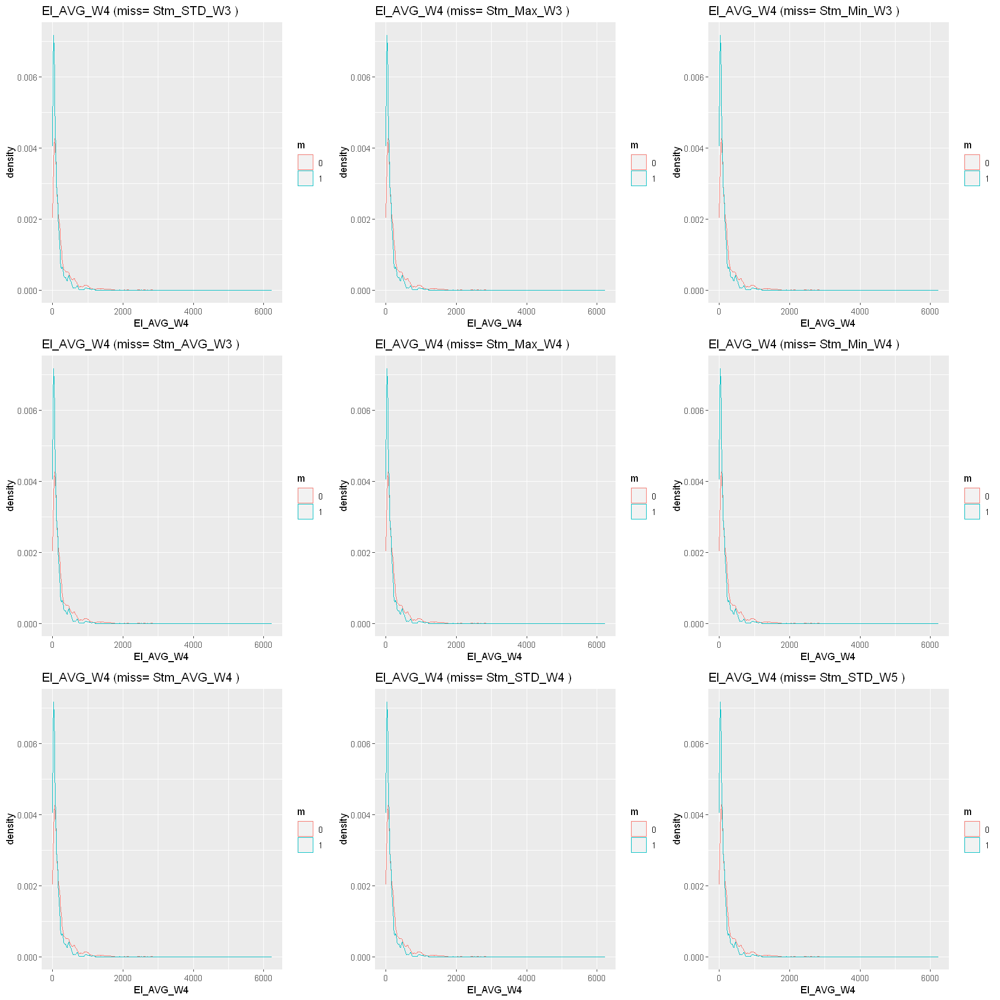

Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."
Warning message:
"Removed 401 rows containing non-finite values (stat_density)."


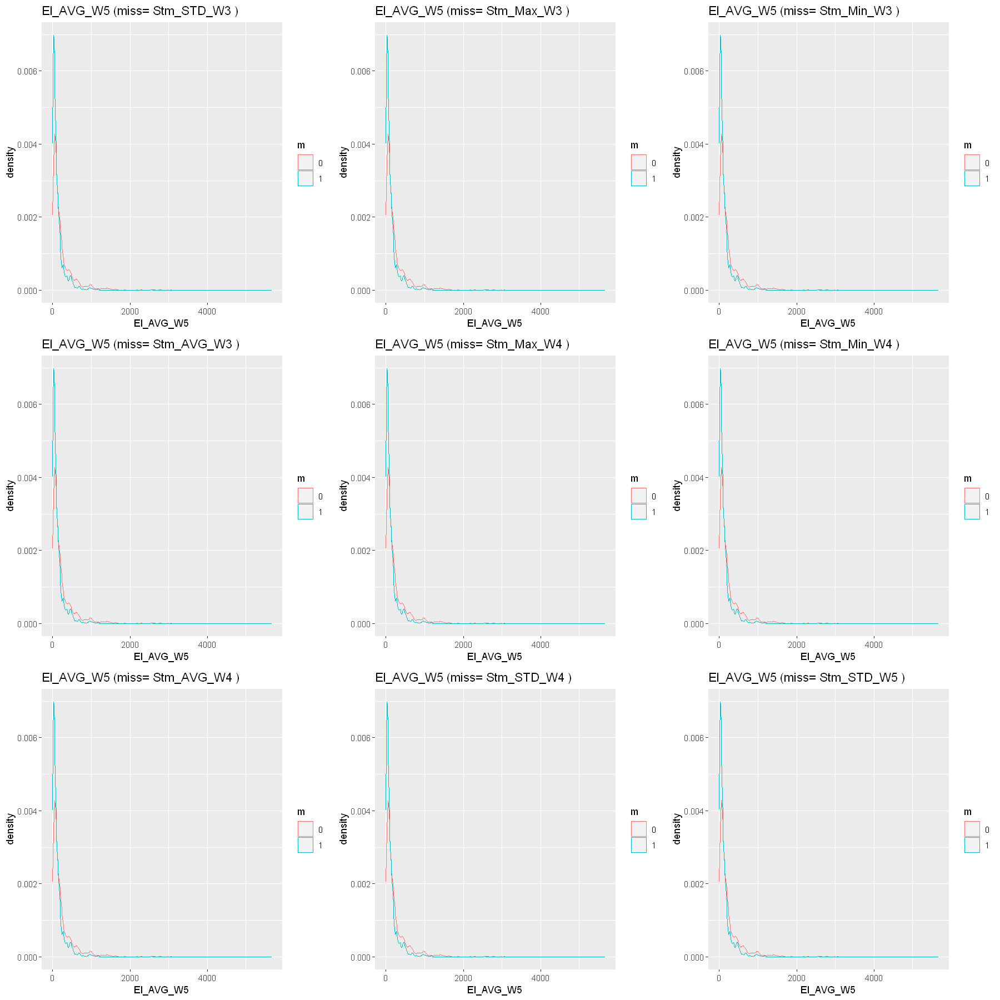

Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."
Warning message:
"Removed 426 rows containing non-finite values (stat_density)."


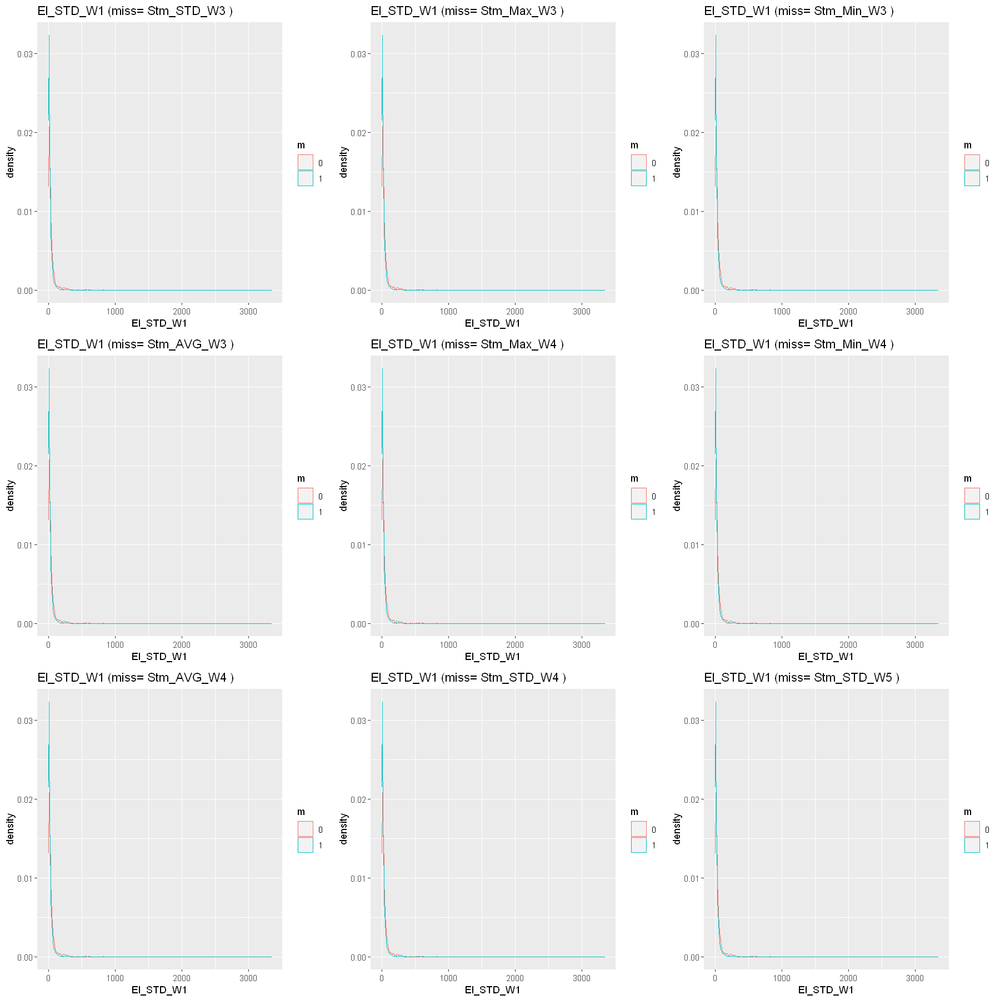

Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."
Warning message:
"Removed 419 rows containing non-finite values (stat_density)."


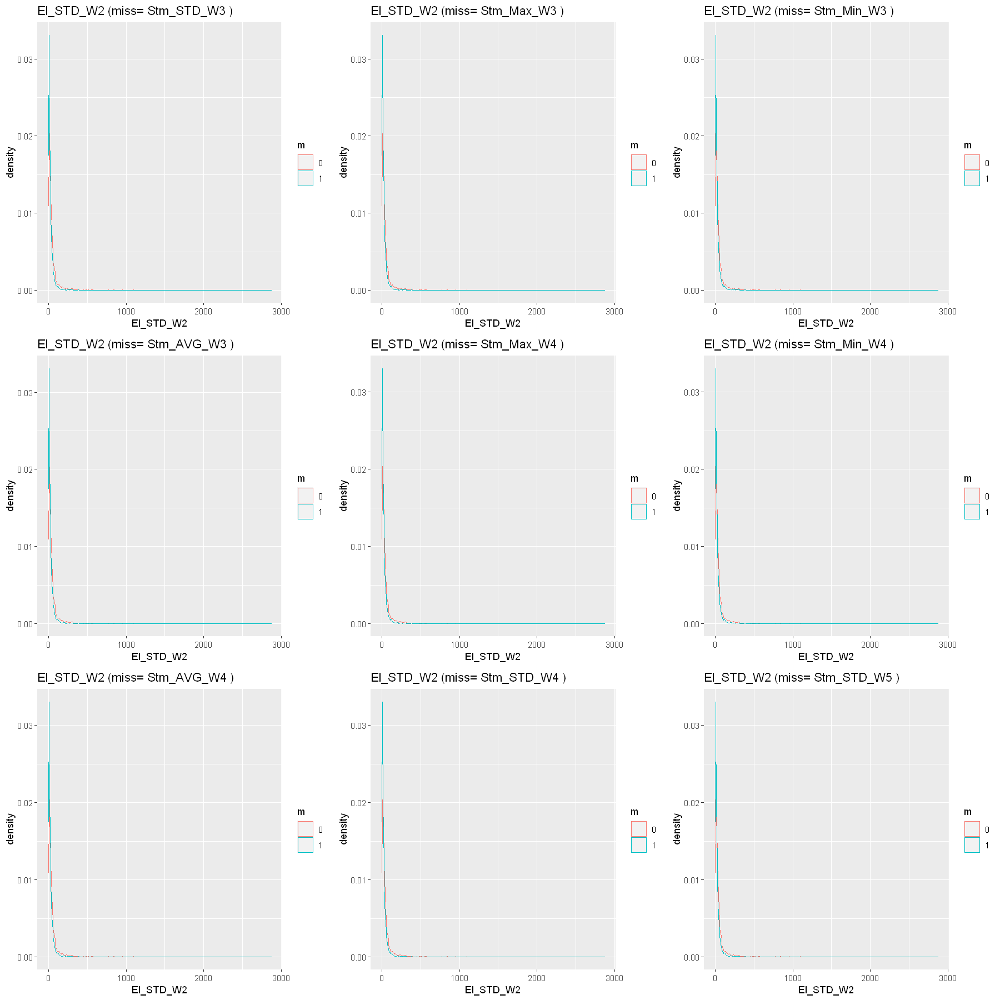

Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."
Warning message:
"Removed 392 rows containing non-finite values (stat_density)."


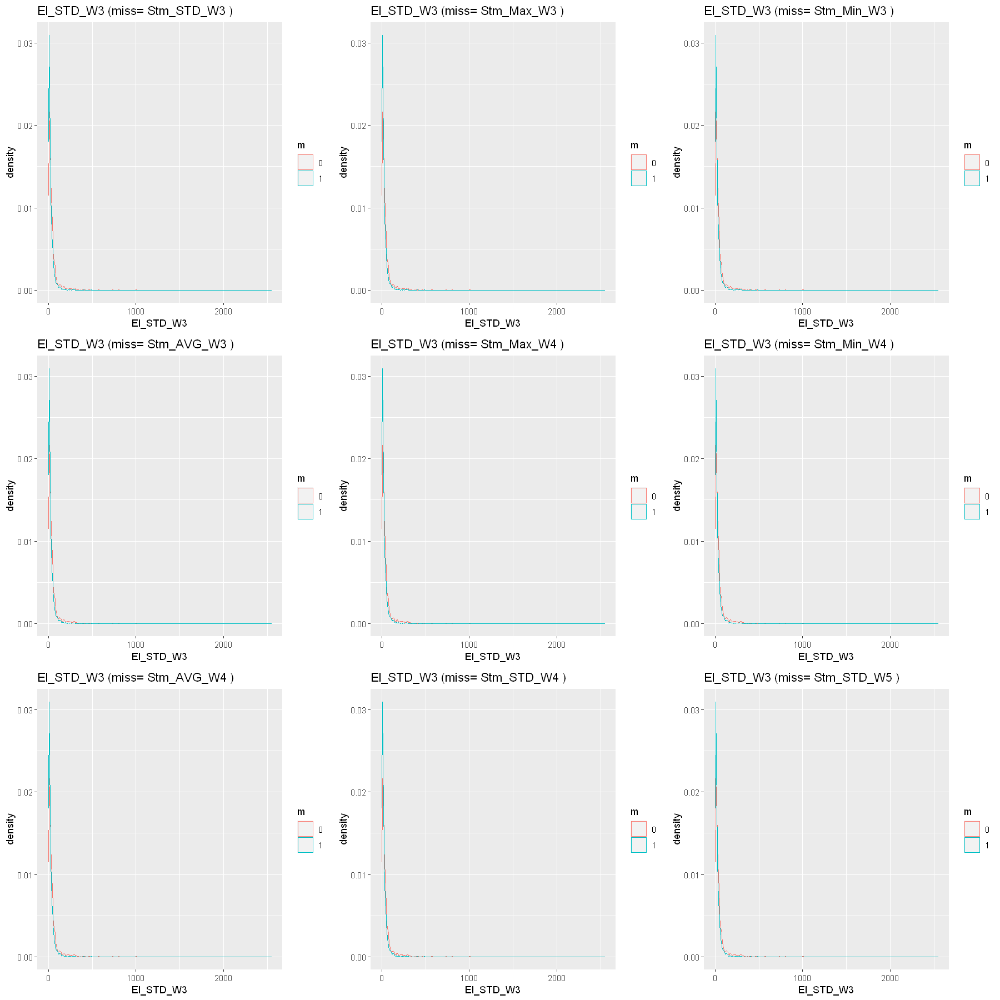

Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."
Warning message:
"Removed 389 rows containing non-finite values (stat_density)."


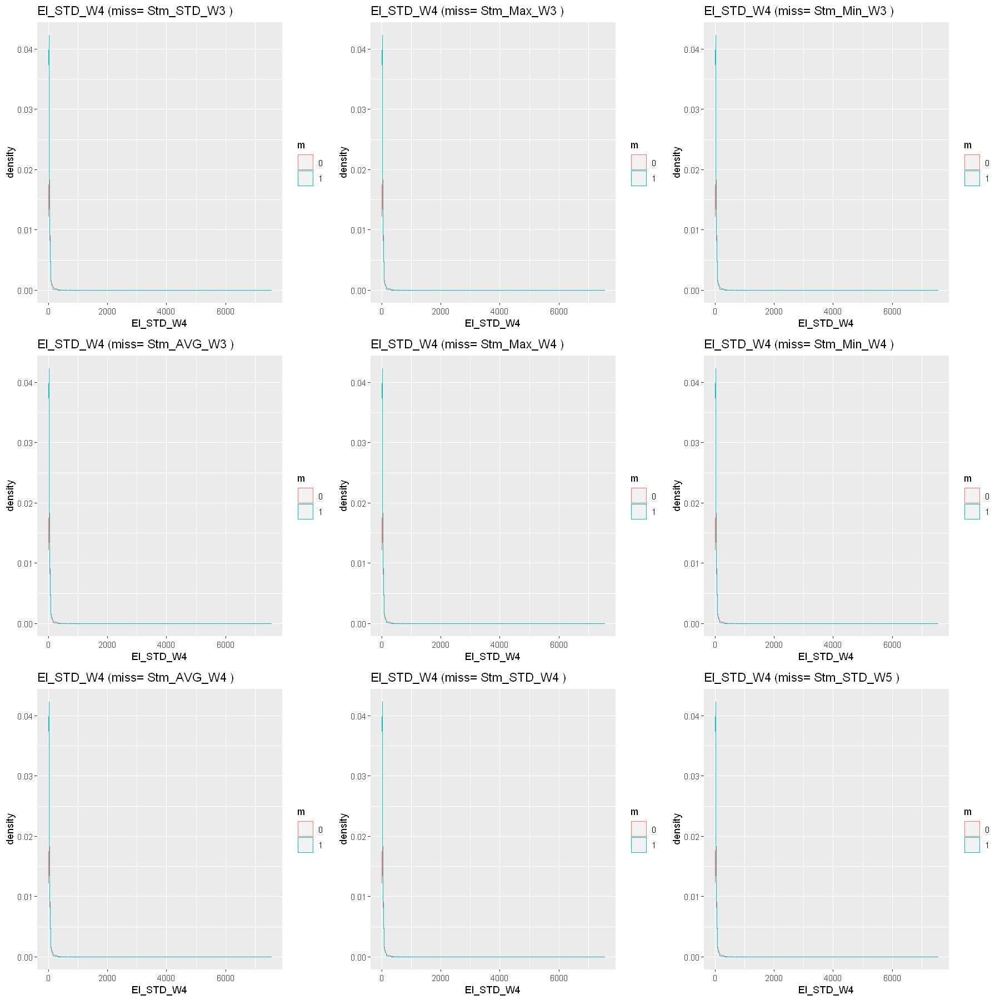

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


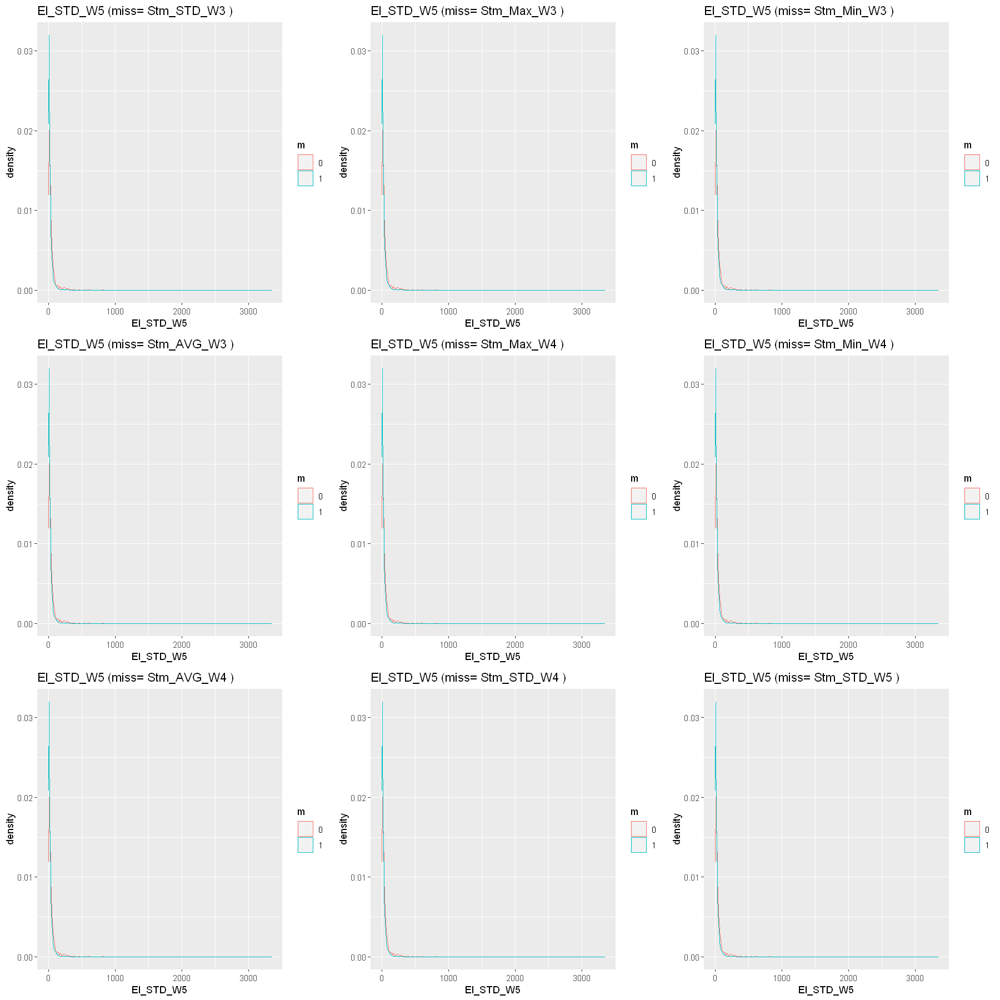

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


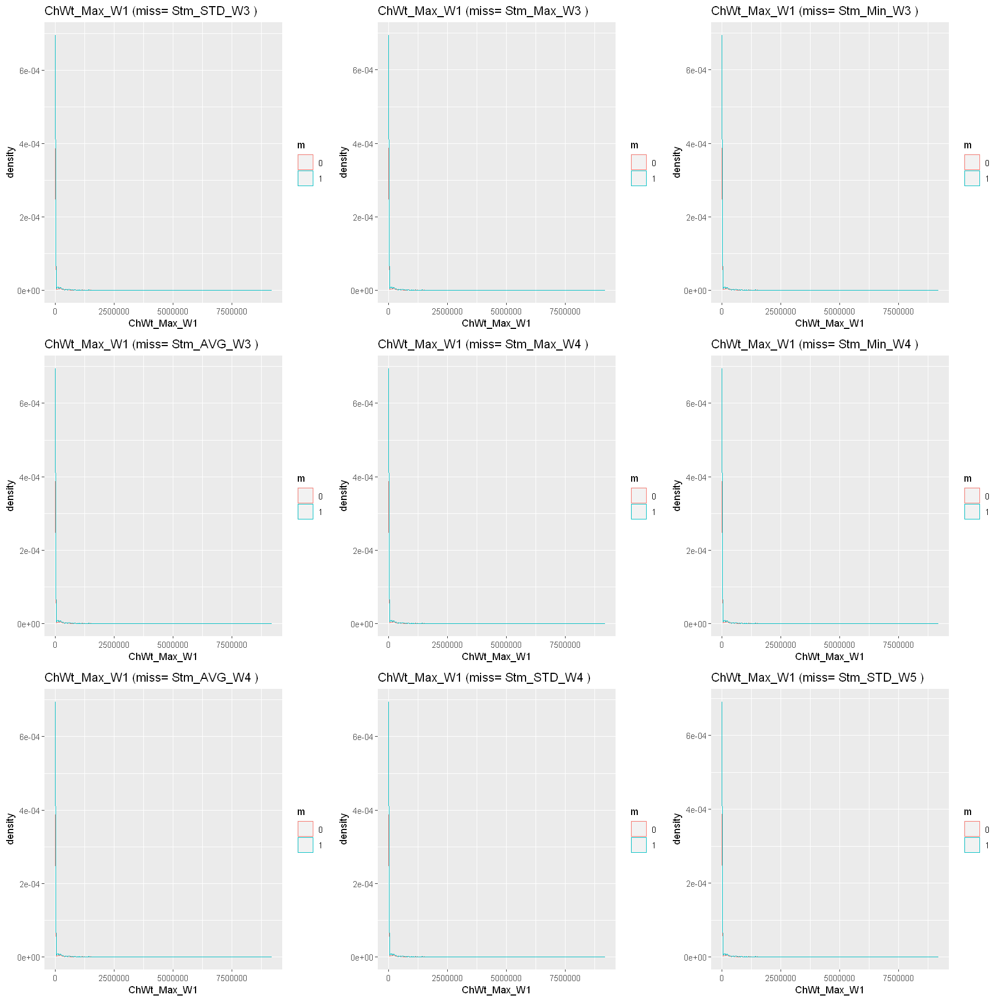

Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."


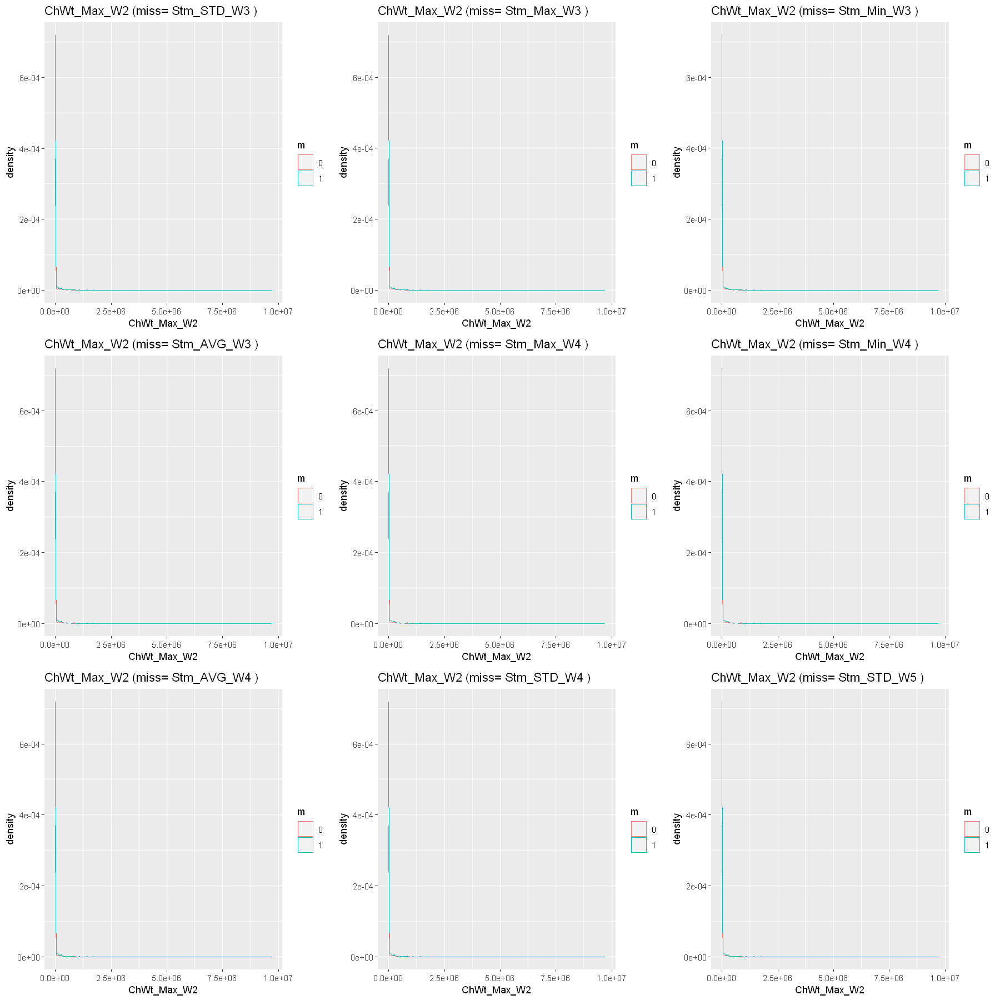

Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."


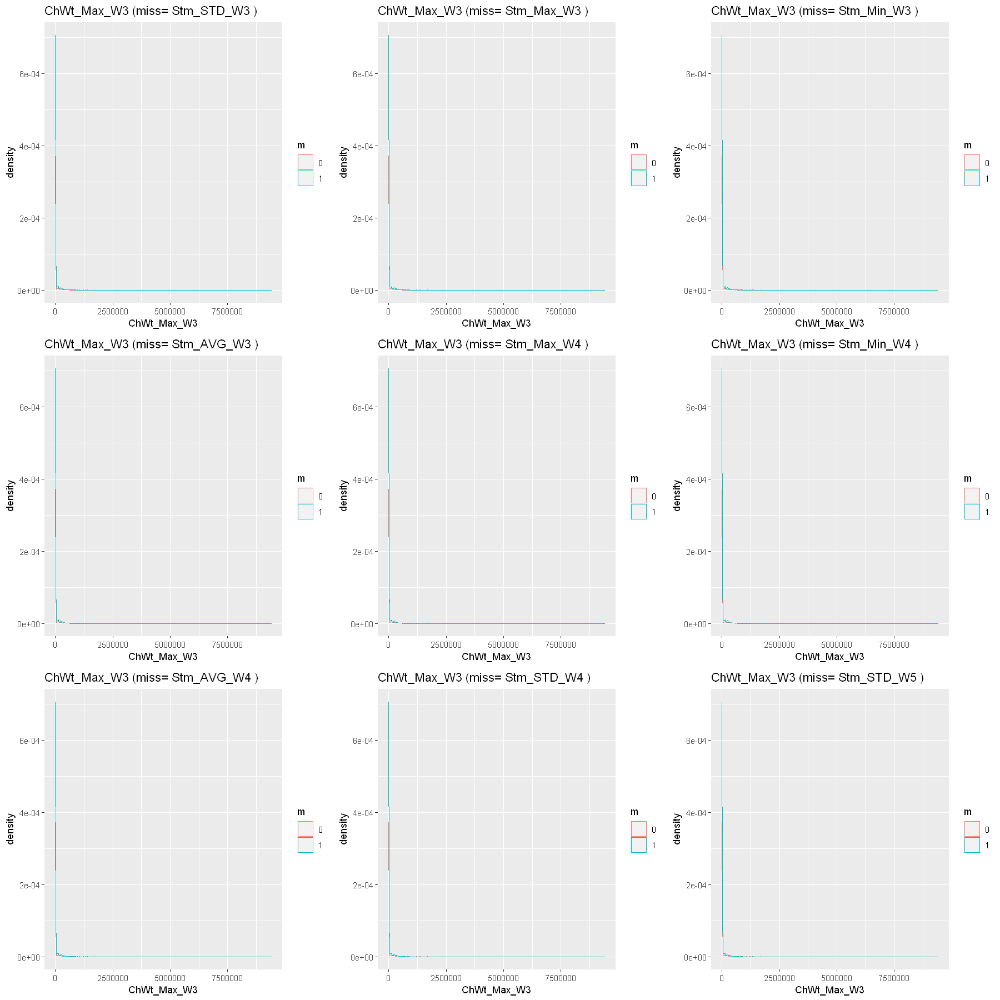

Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."


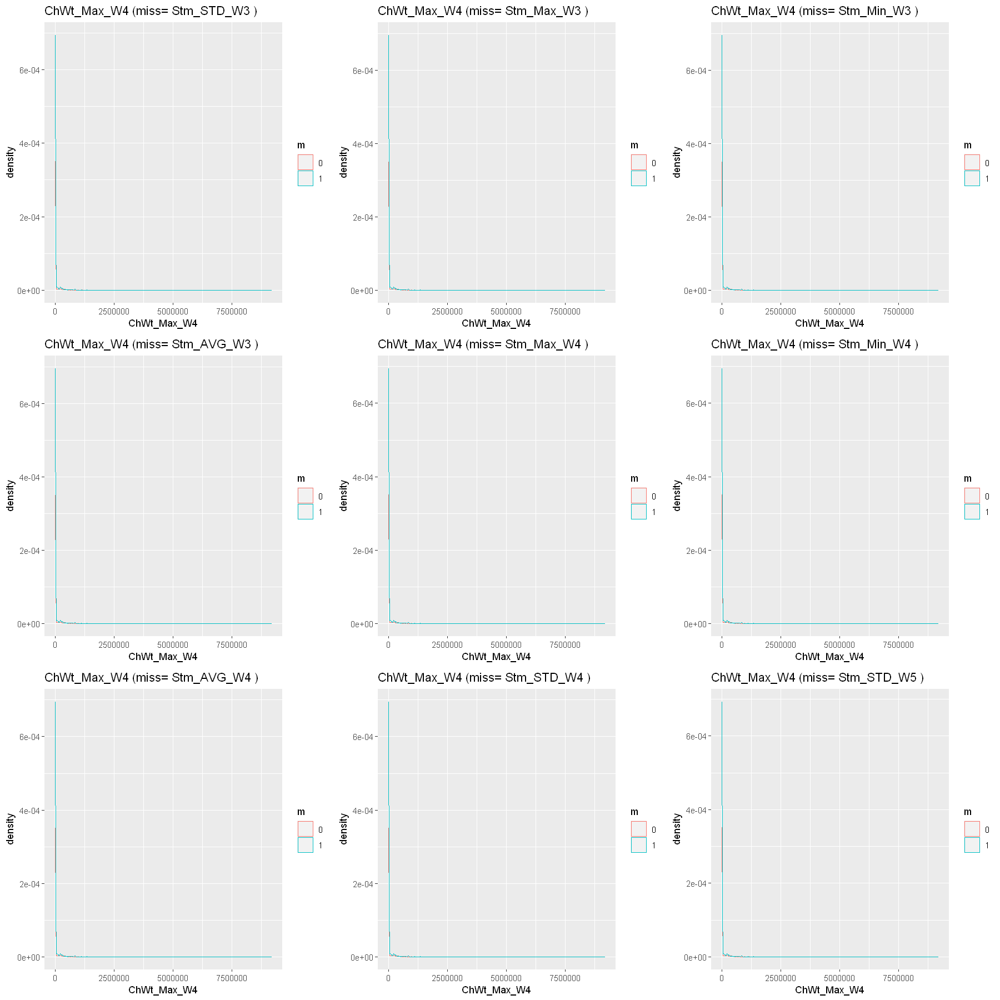

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


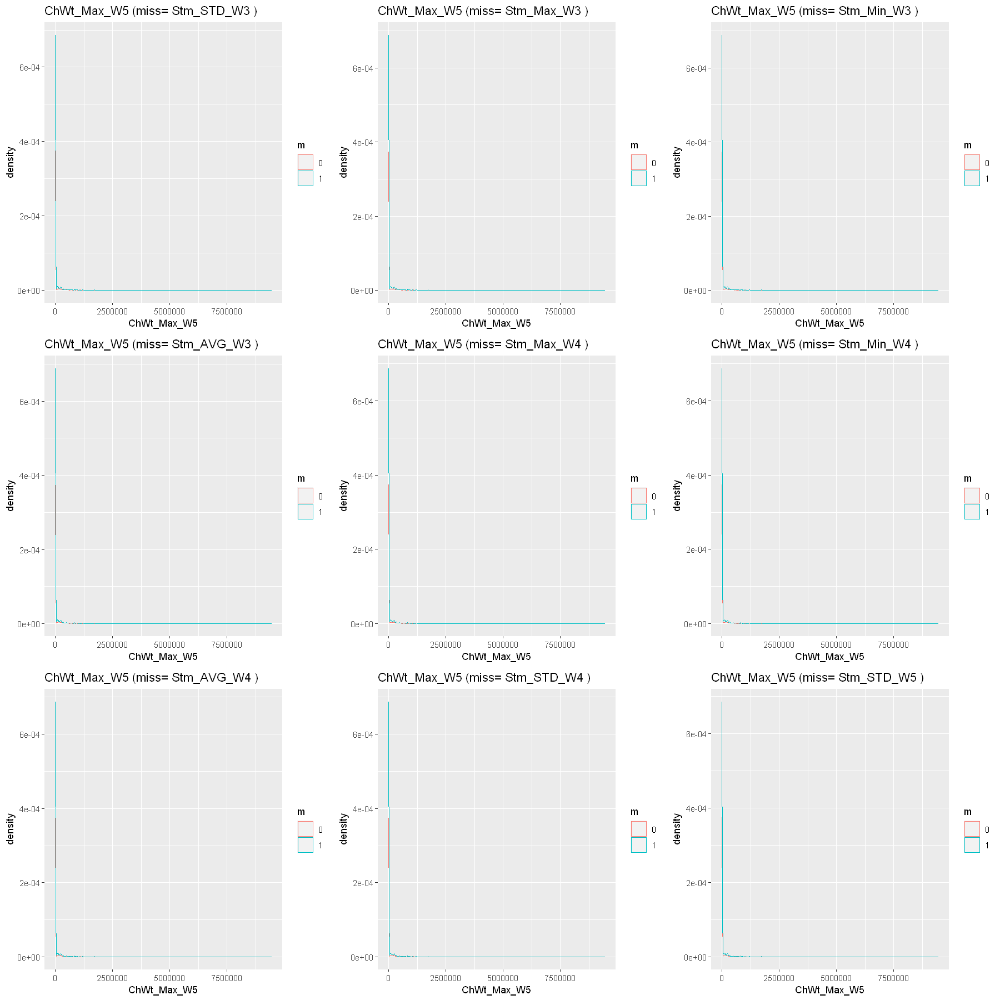

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


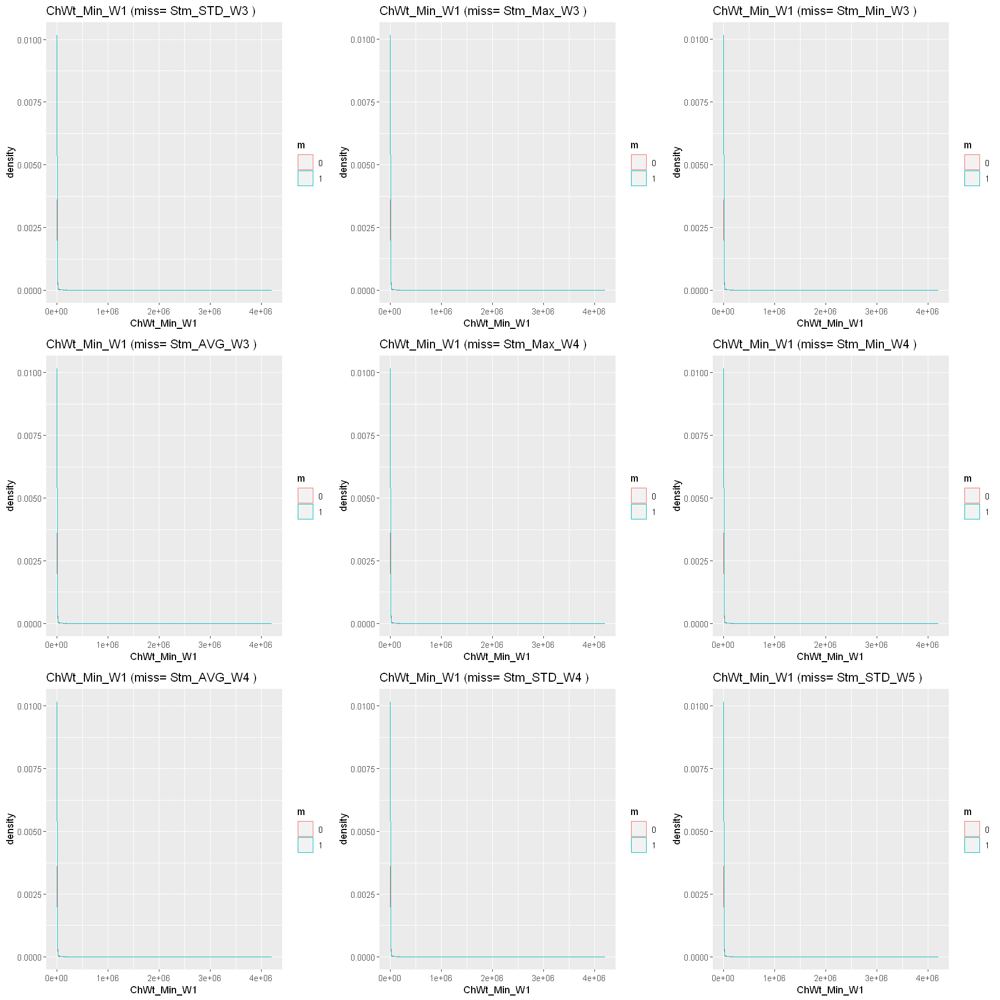

Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."


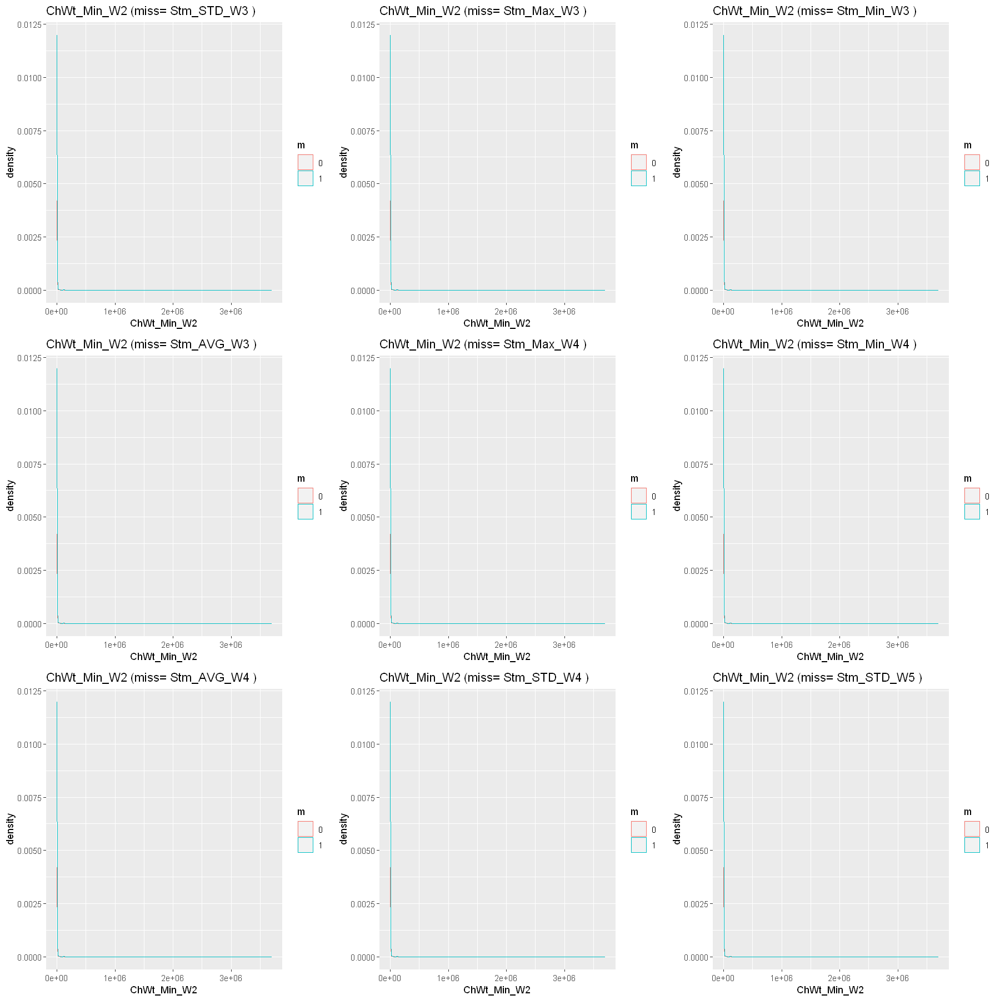

Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."


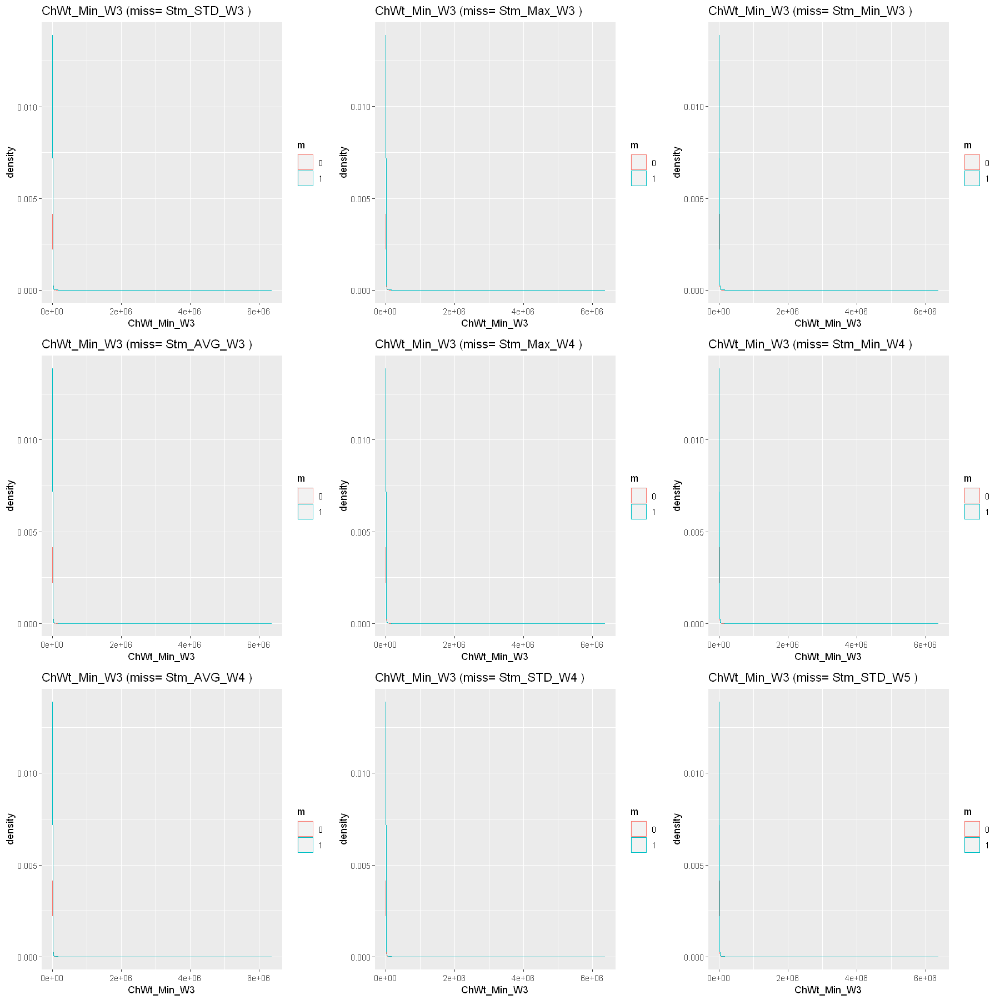

Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."


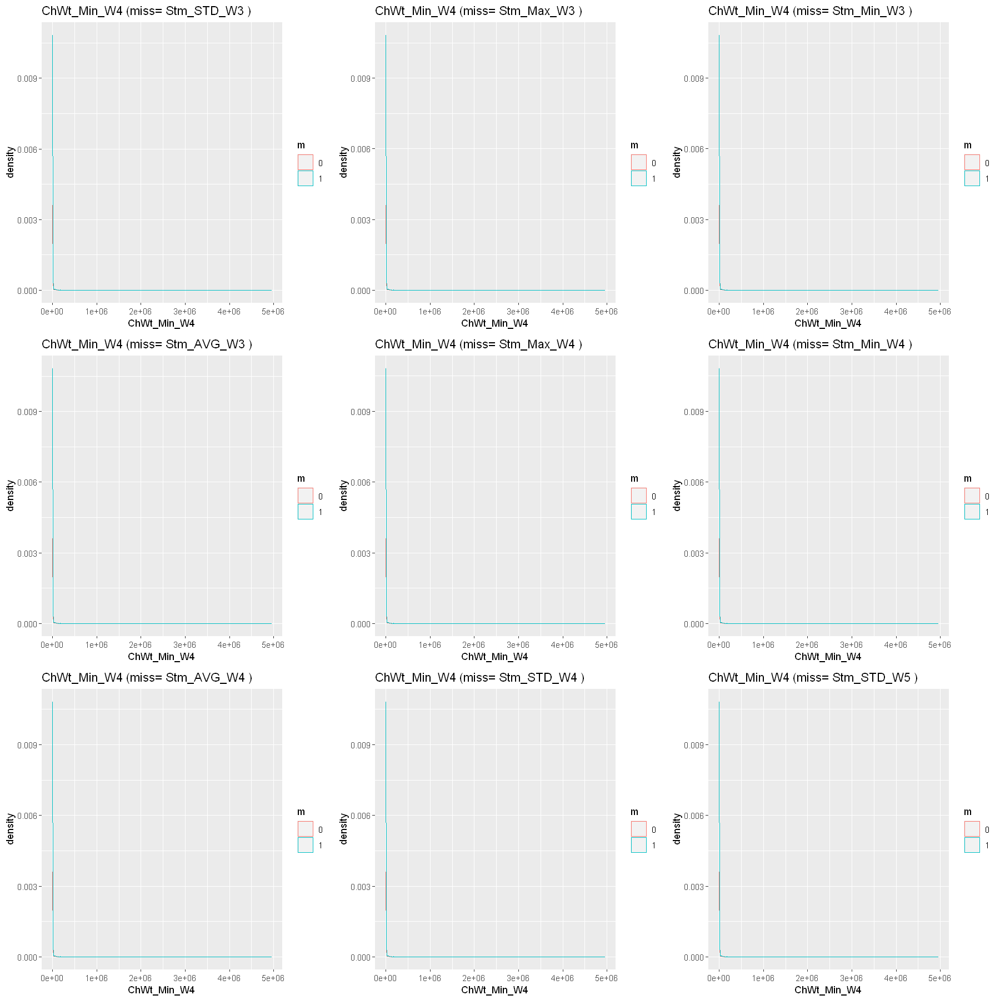

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


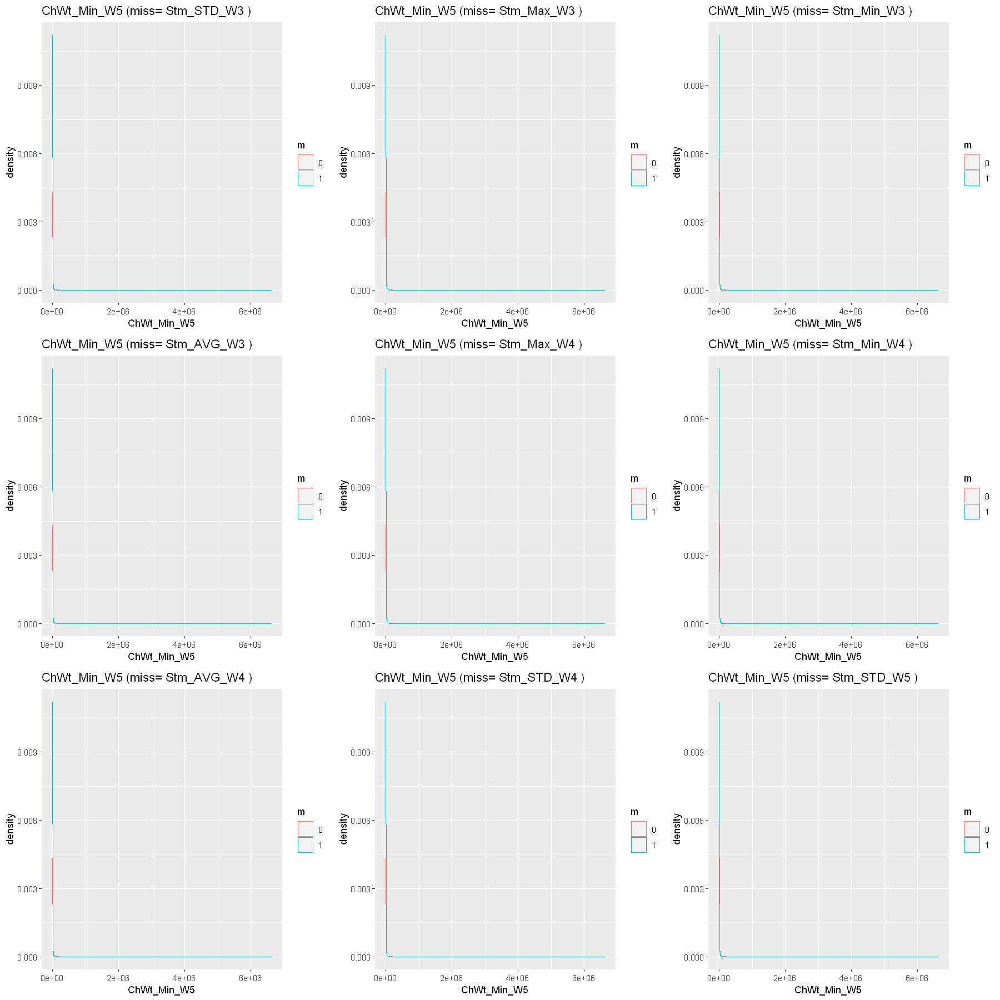

Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3367 rows containing non-finite values (stat_density)."


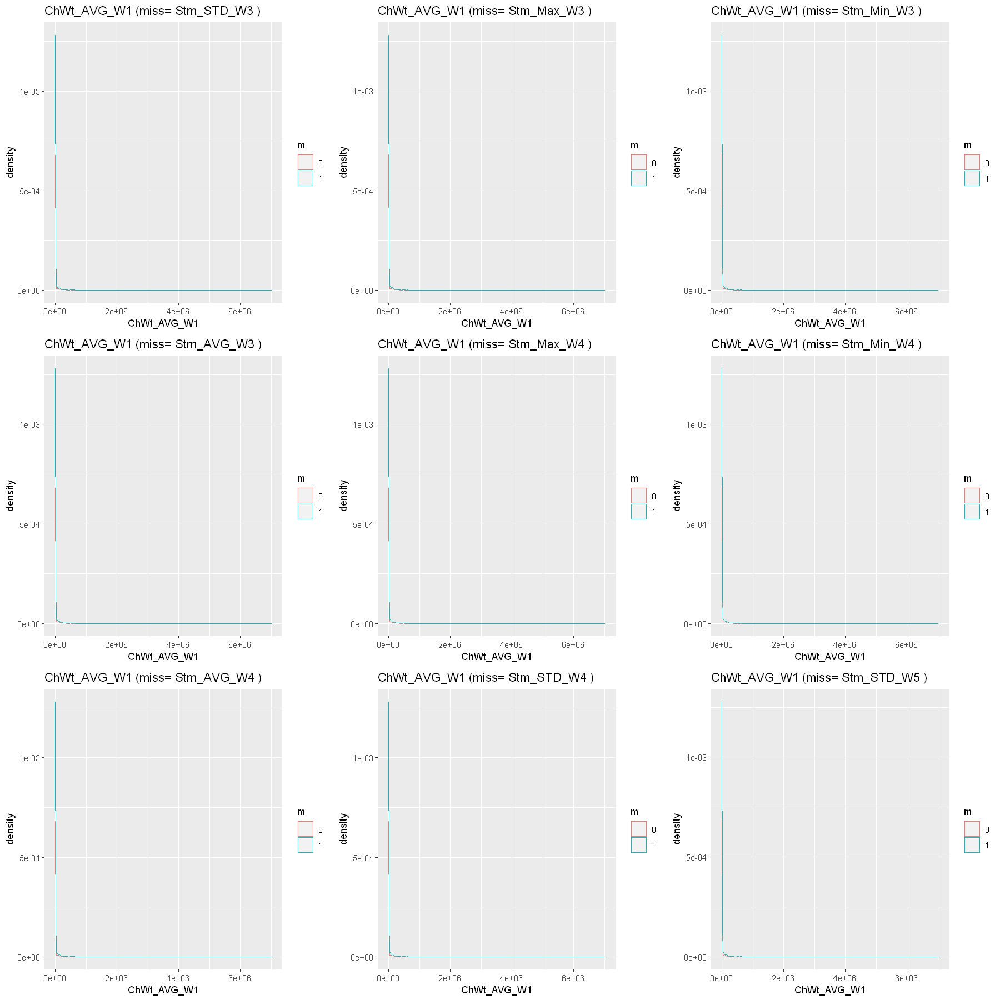

Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3399 rows containing non-finite values (stat_density)."


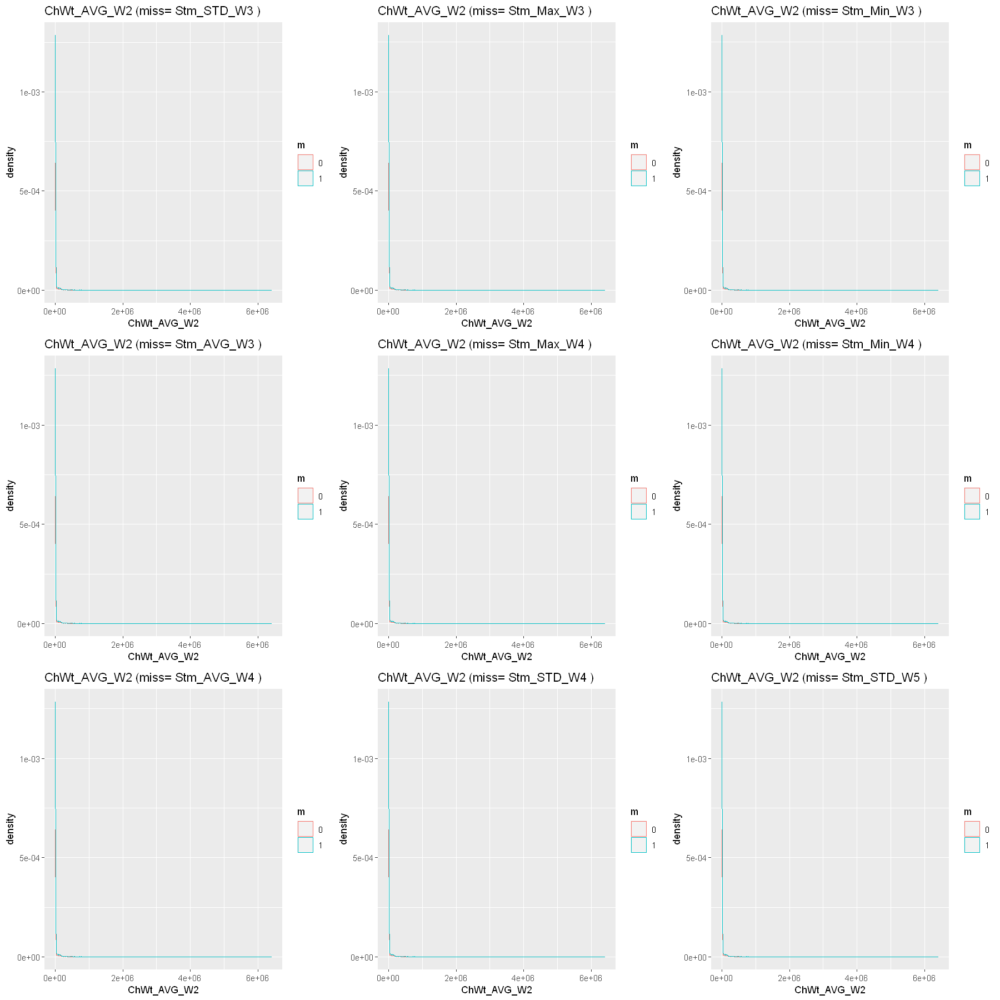

Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3391 rows containing non-finite values (stat_density)."


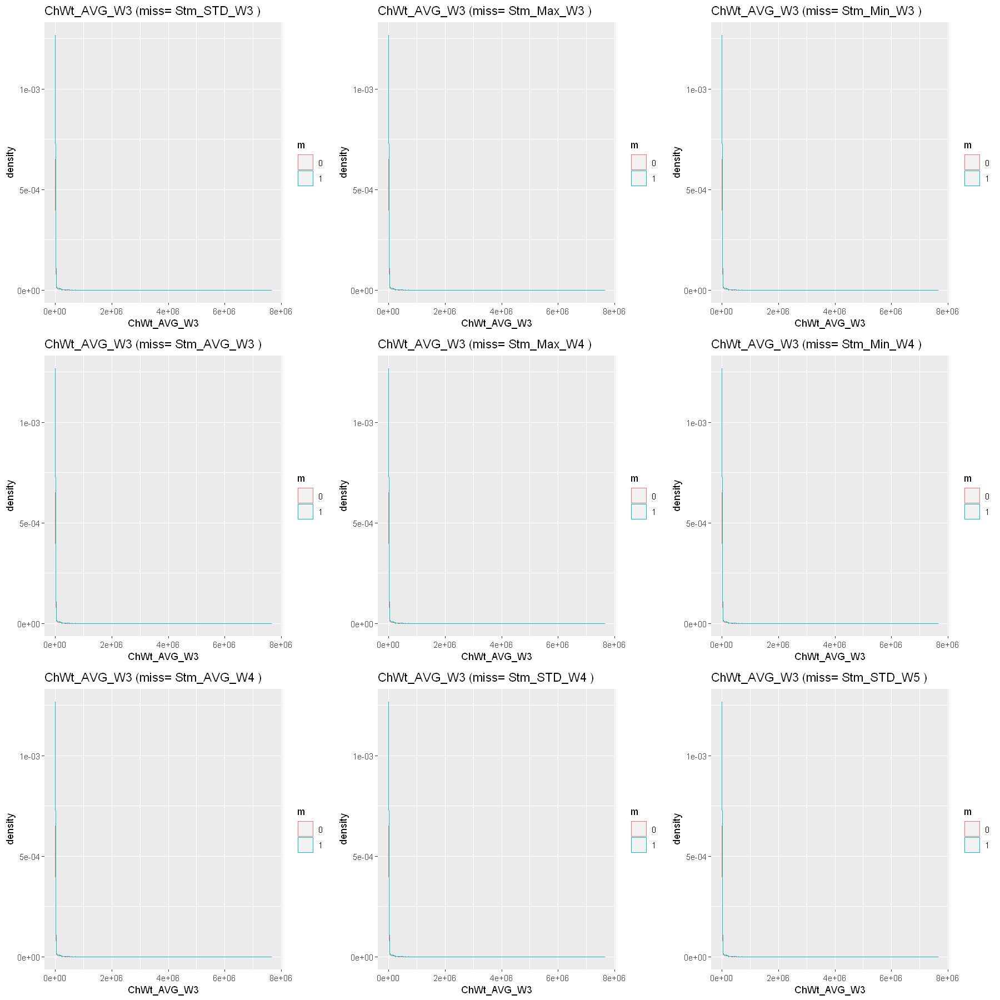

Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."


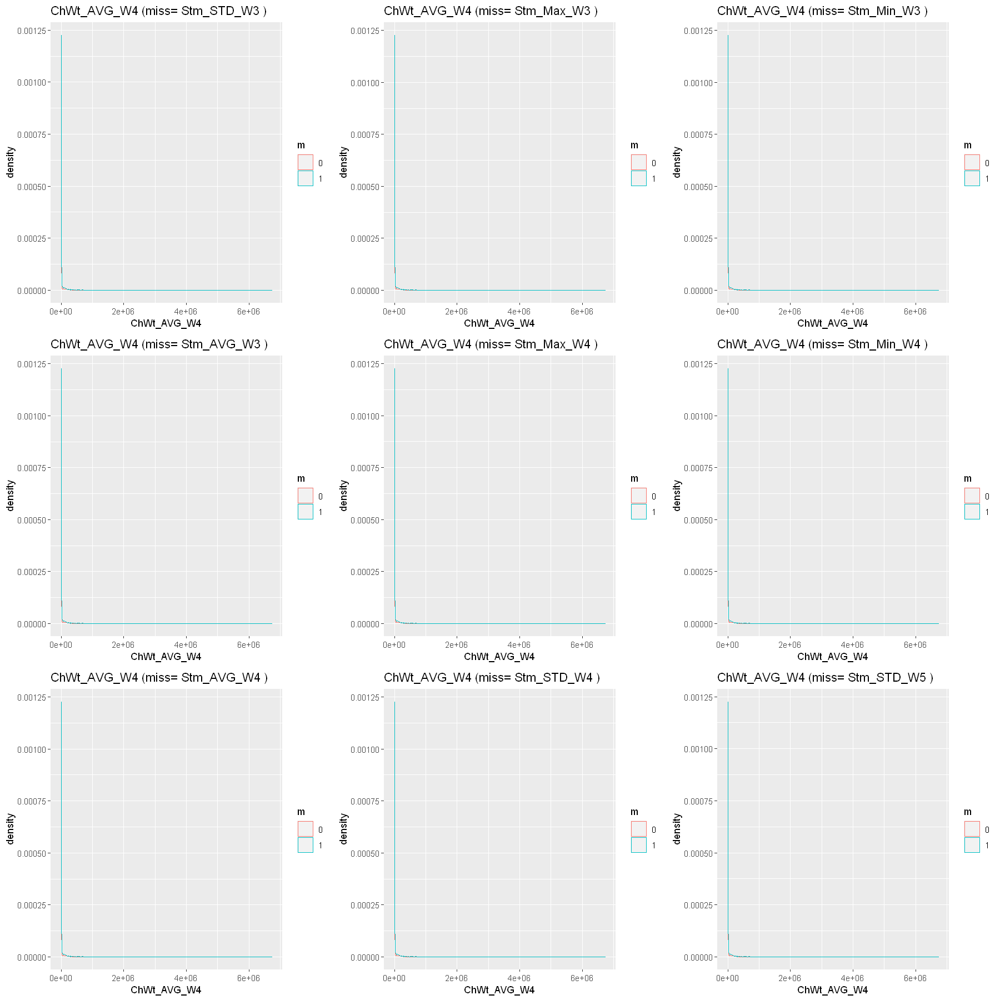

Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3368 rows containing non-finite values (stat_density)."


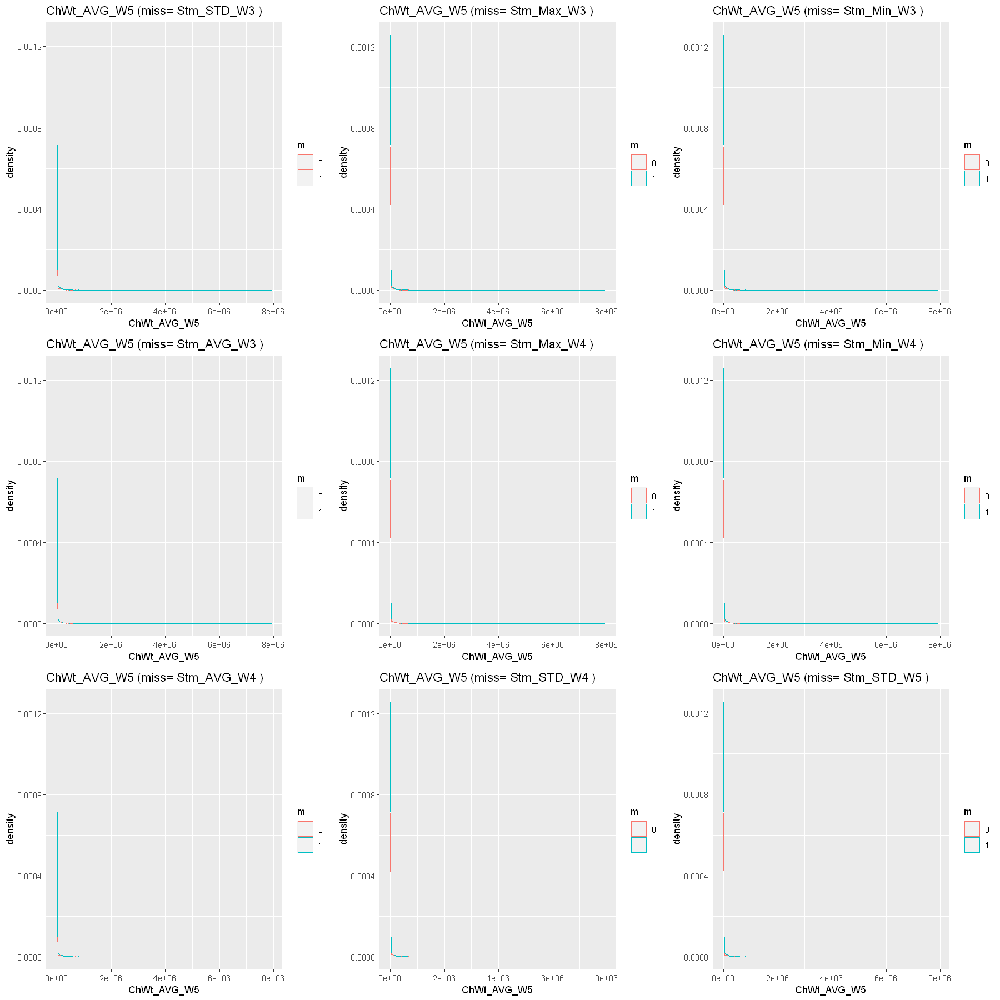

Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3370 rows containing non-finite values (stat_density)."


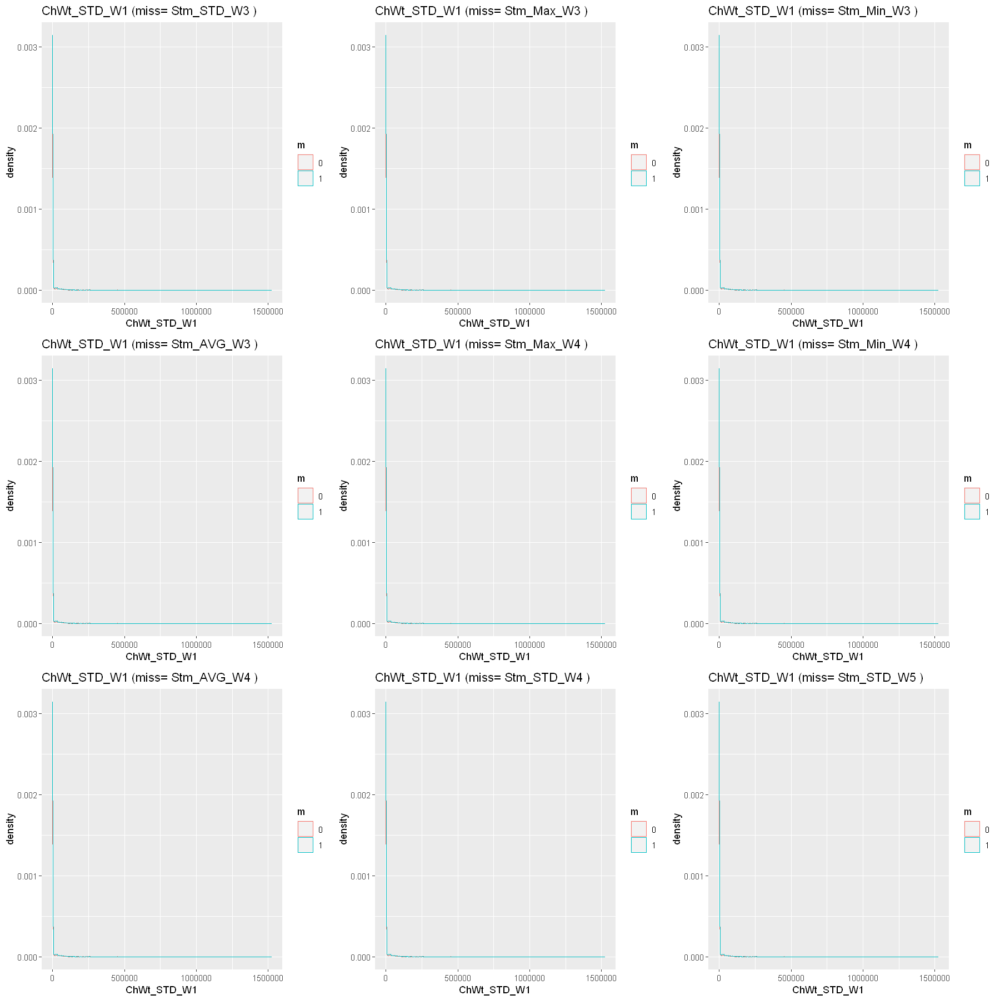

Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3400 rows containing non-finite values (stat_density)."


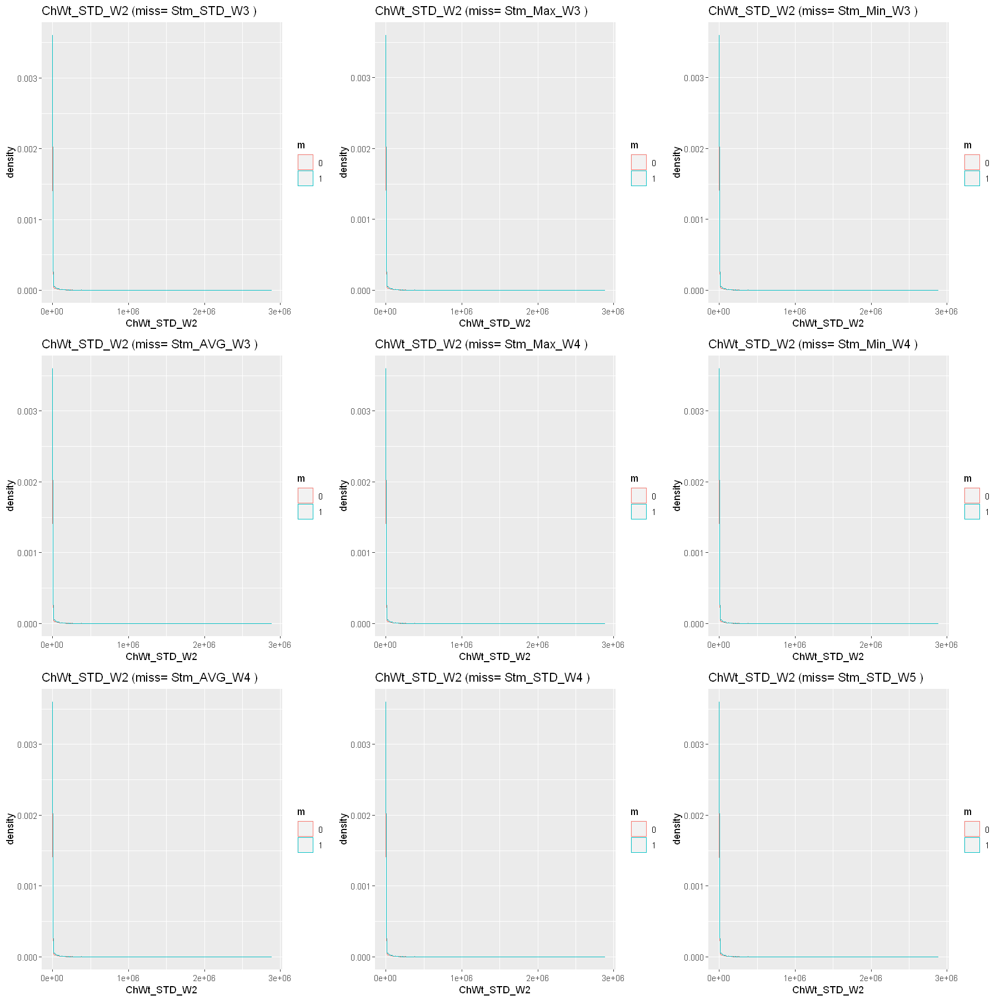

Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3393 rows containing non-finite values (stat_density)."


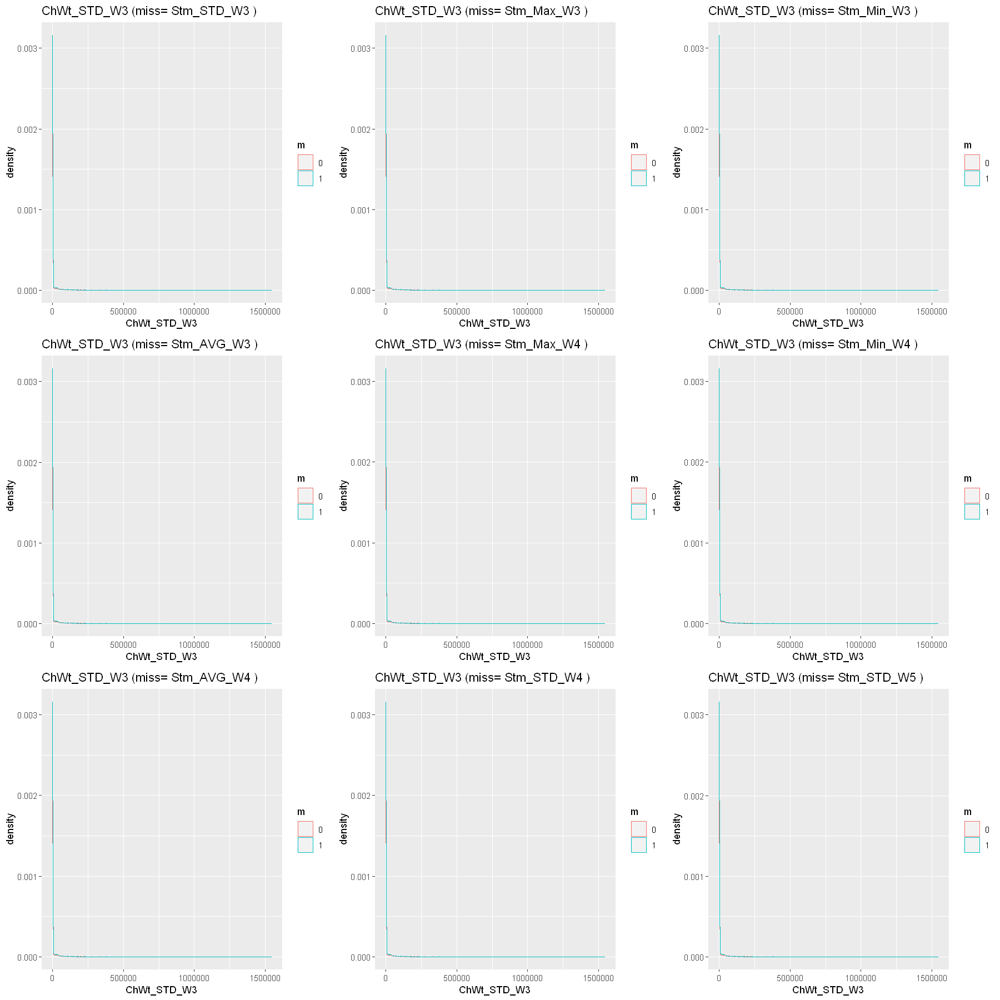

Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3380 rows containing non-finite values (stat_density)."


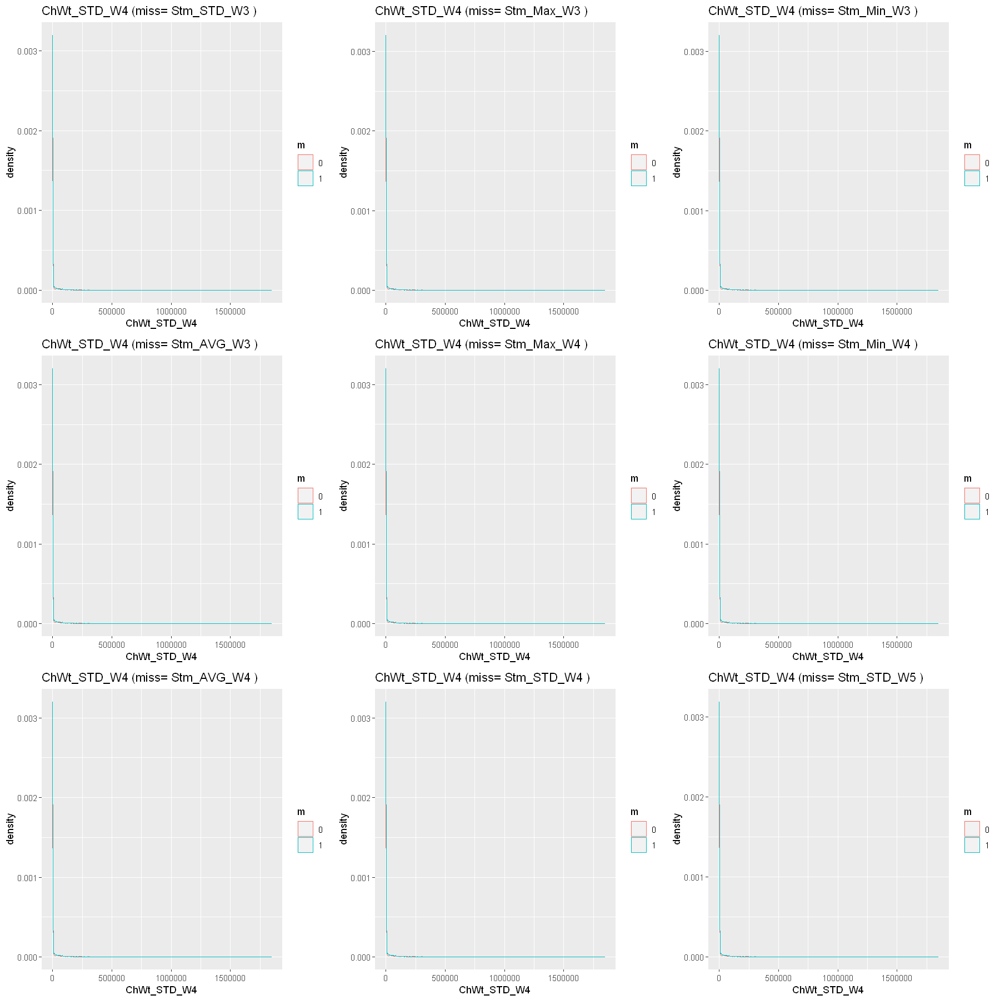

Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."


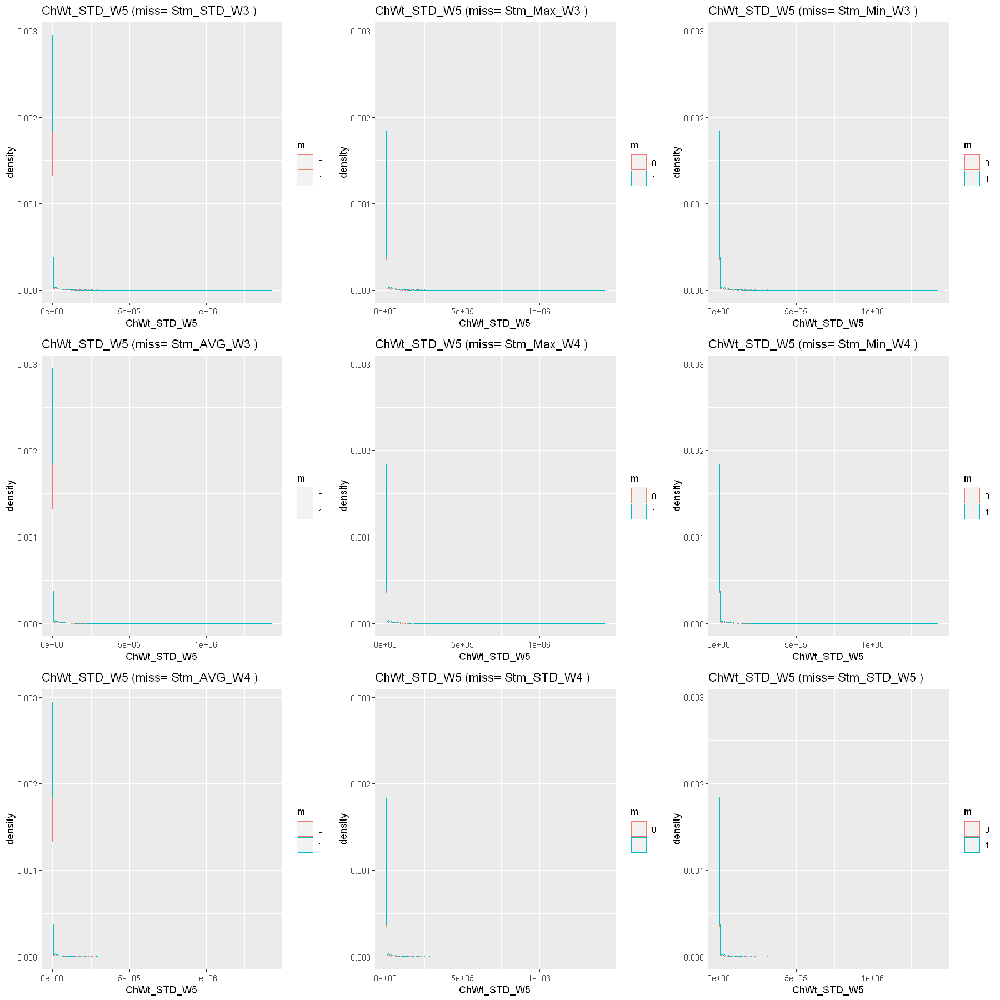

Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."


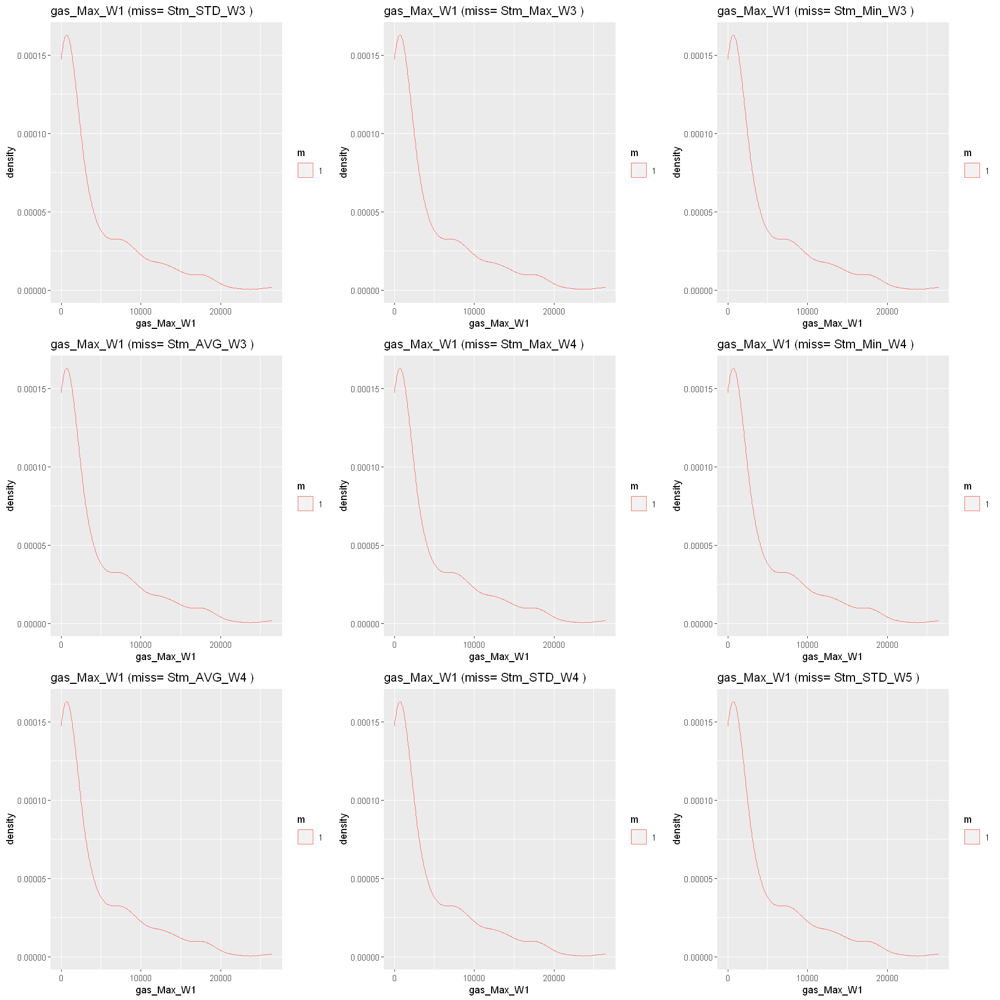

Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."


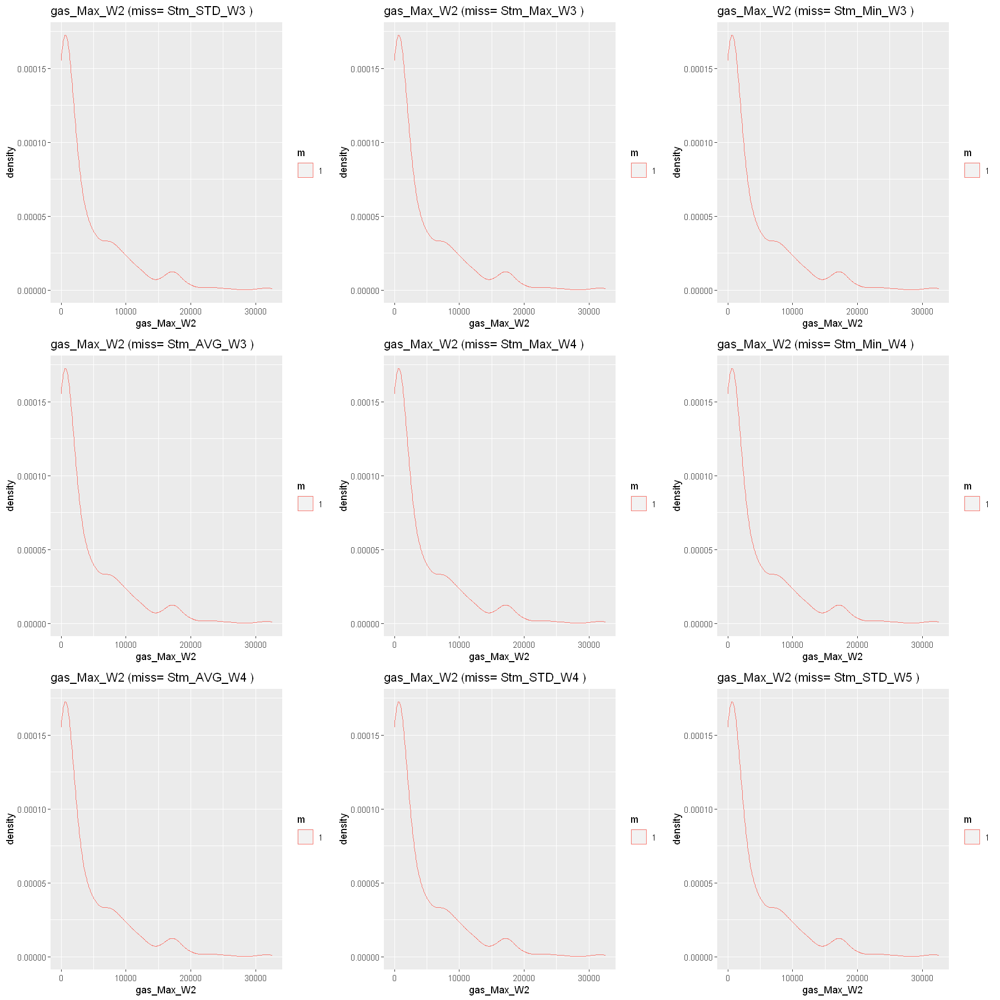

Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."


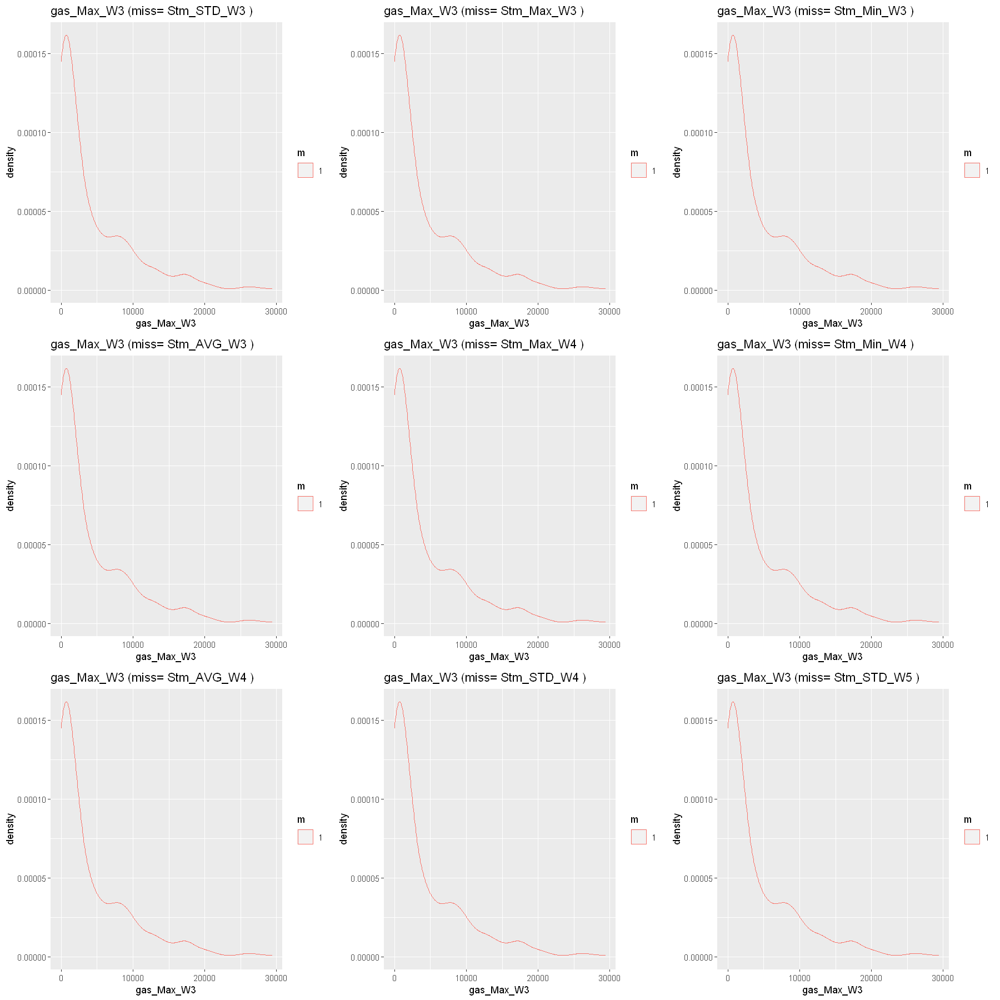

Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."


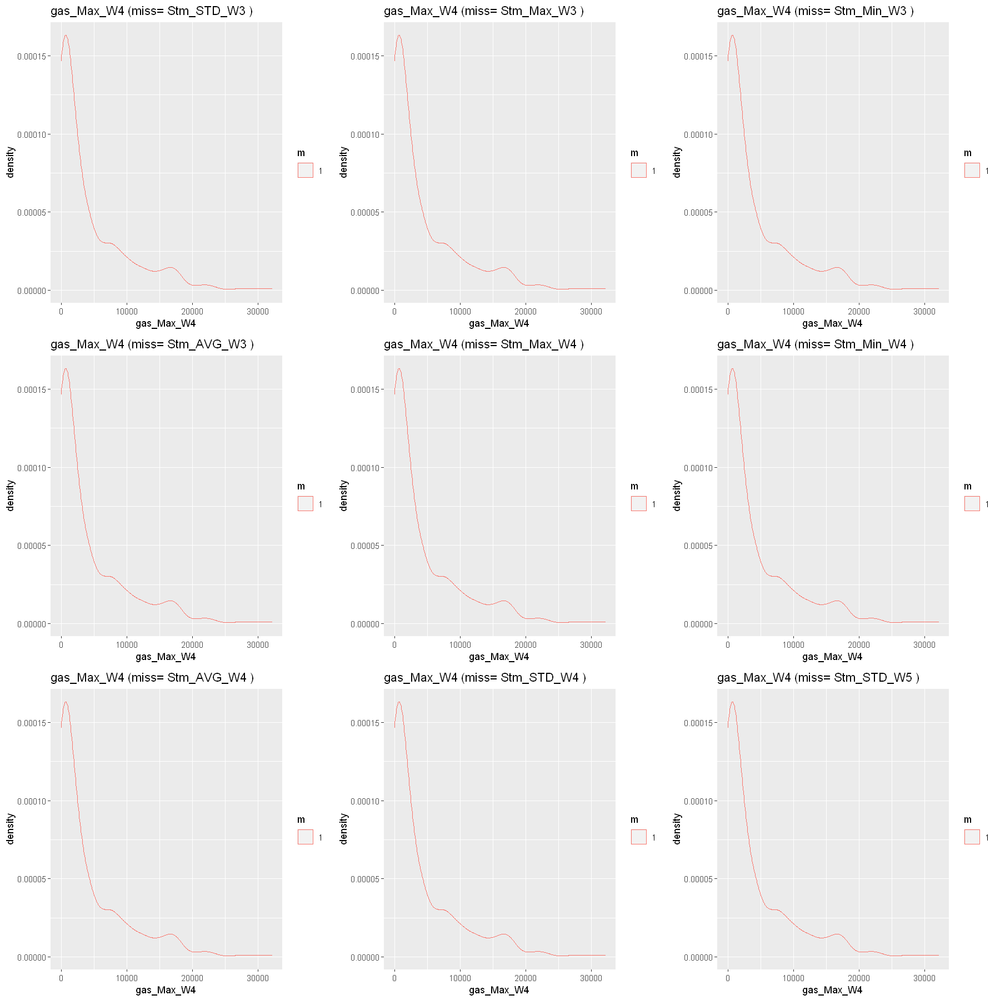

Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8896 rows containing non-finite values (stat_density)."


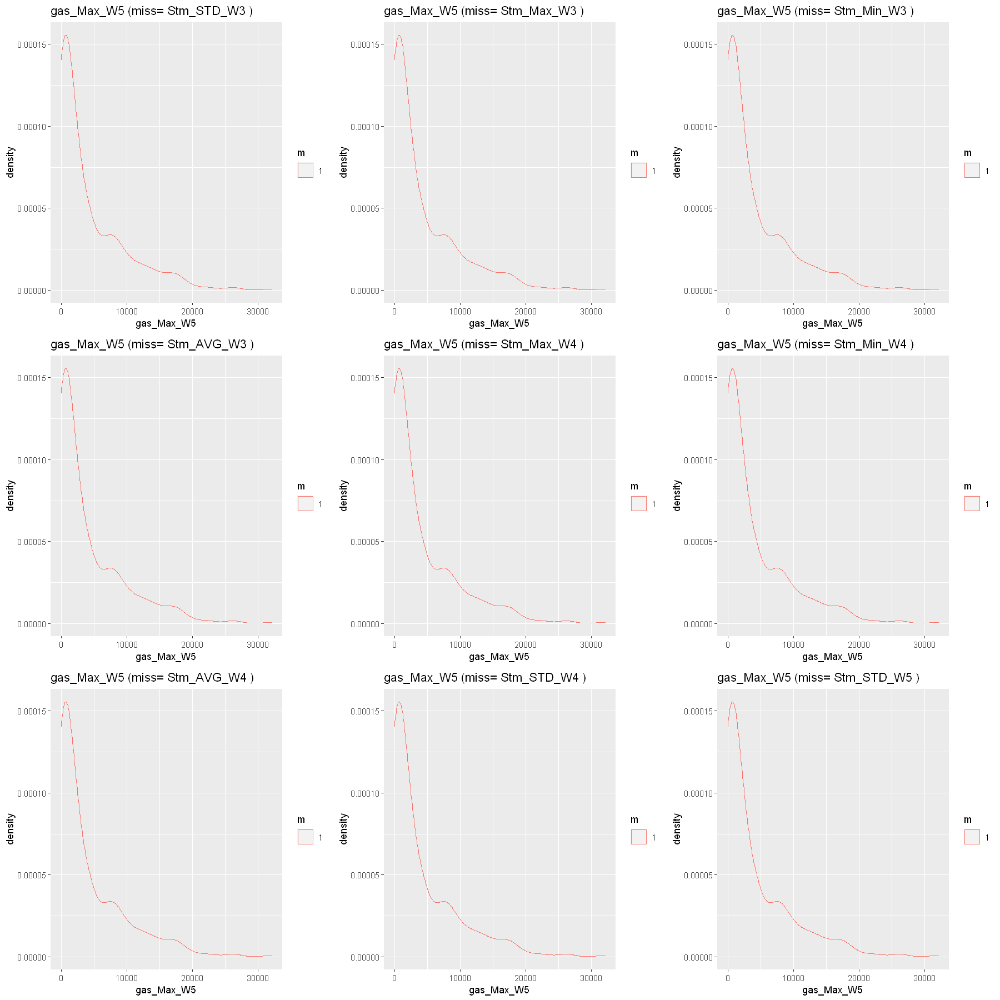

Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."
Warning message:
"Removed 8897 rows containing non-finite values (stat_density)."


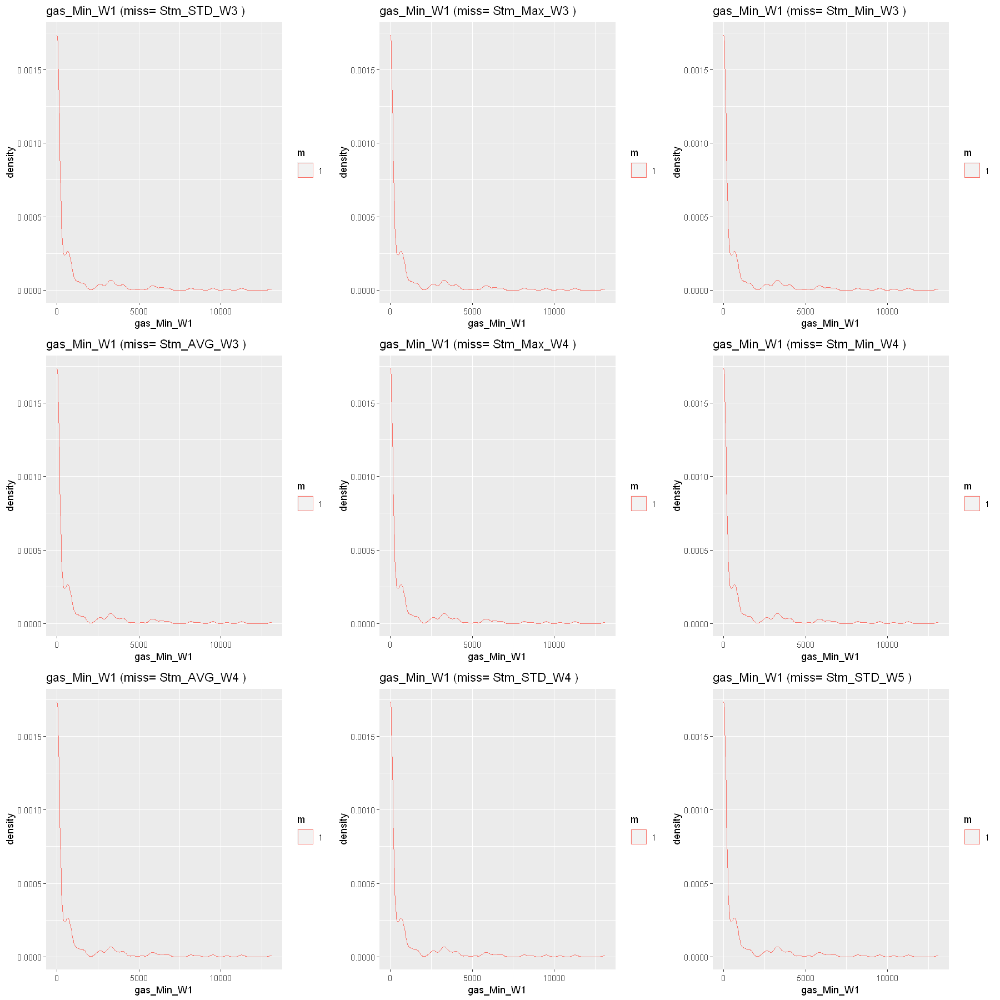

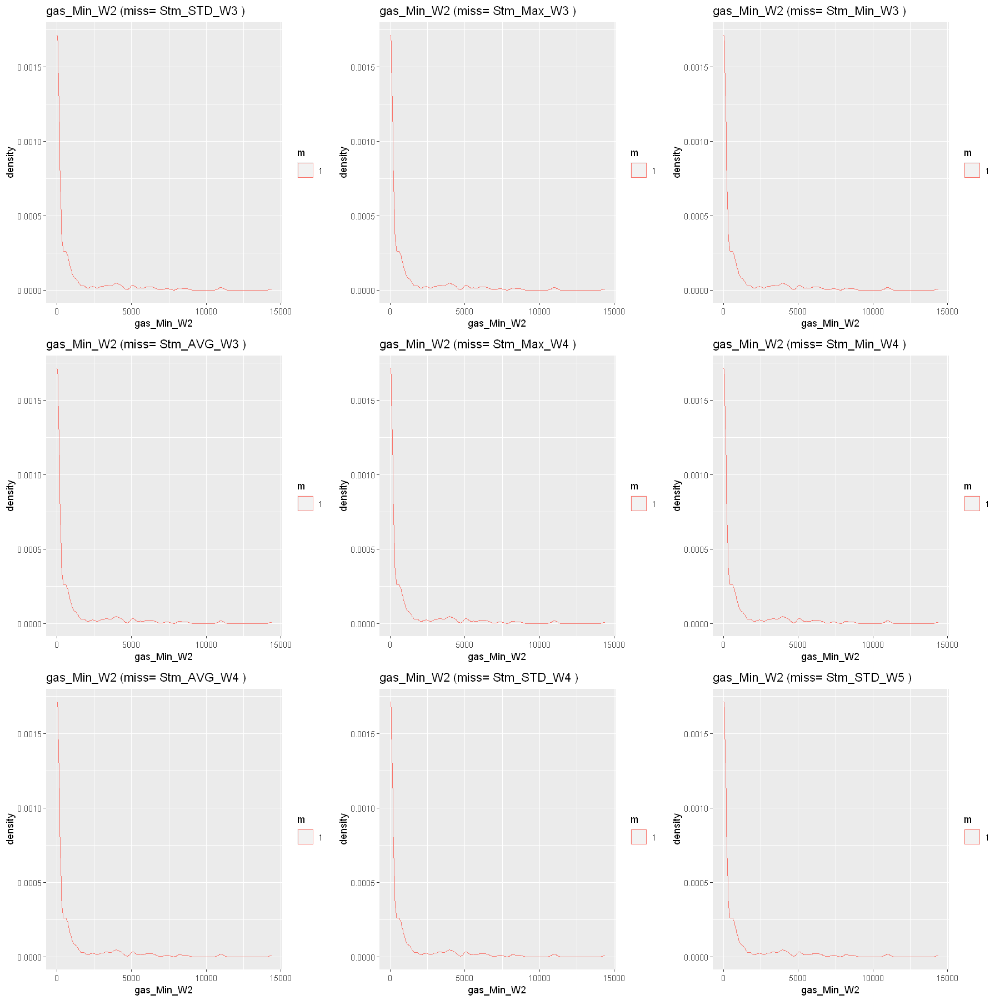

In [375]:
options(repr.plot.width = 15, repr.plot.height = 15 )

for (v in numrNames[1:204])
    {
        p <- list()
        i <- 1
        for (m in mm$missingness$var[1:63])
            {
                if (v != m)
                    {
                        ff <- data.frame(v=BGP_mssRwDr[[v]], m=factor(BGP_mssRwDr_NA[[m]])) # original data frame missingnes
                        p[[i]] <- suppressMessages(ggplot(data=ff,aes(x=v, group=m, color=m))) +
                          geom_density()+labs(title=paste(v, "(miss=" , m,")"),x=v)
                        i <- i+1
                    }
            }
        do.call(grid.arrange,p)
    }


## gas and hot water dose not have any second plot... moving to check without them

In [67]:
numrNames_Xghw<-names(Filter(is.numeric, DF_BGP[,c(1:48,89:124)]))

In [68]:
length(numrNames_Xghw)

[1] 79

In [69]:
numrNames_Xghw

[1] "sqm"                   "lat"                   "lng"                  
 [4] "El_Max_W1"             "El_Max_W2"             "El_Max_W3"            
 [7] "El_Max_W4"             "El_Max_W5"             "El_Min_W1"            
[10] "El_Min_W2"             "El_Min_W3"             "El_Min_W4"            
[13] "El_Min_W5"             "El_AVG_W1"             "El_AVG_W2"            
[16] "El_AVG_W3"             "El_AVG_W4"             "El_AVG_W5"            
[19] "El_STD_W1"             "El_STD_W2"             "El_STD_W3"            
[22] "El_STD_W4"             "El_STD_W5"             "ChWt_Max_W1"          
[25] "ChWt_Max_W2"           "ChWt_Max_W3"           "ChWt_Max_W4"          
[28] "ChWt_Max_W5"           "ChWt_Min_W1"           "ChWt_Min_W2"          
[31] "ChWt_Min_W3"           "ChWt_Min_W4"           "ChWt_Min_W5"          
[34] "ChWt_AVG_W1"           "ChWt_AVG_W2"           "ChWt_AVG_W3"          
[37] "ChWt_AVG_W4"           "ChWt_AVG_W5"           "ChWt_STD_W1"          
[40] "ChWt_STD_W2"           "ChWt_STD_W3"           "ChWt_STD_W4"          
[43] "ChWt_STD_W5"           "Stm_Max_W1"            "Stm_Max_W2"           
[46] "Stm_Max_W3"            "Stm_Max_W4"            "Stm_Max_W5"           
[49] "Stm_Min_W1"            "Stm_Min_W2"            "Stm_Min_W3"           
[52] "Stm_Min_W4"            "Stm_Min_W5"            "Stm_AVG_W1"           
[55] "Stm_AVG_W2"            "Stm_AVG_W3"            "Stm_AVG_W4"           
[58] "Stm_AVG_W5"            "Stm_STD_W1"            "Stm_STD_W2"           
[61] "Stm_STD_W3"            "Stm_STD_W4"            "Stm_STD_W5"           
[64] "MAX_airTemperature_W1" "MAX_airTemperature_W2" "MAX_airTemperature_W3"
[67] "MAX_airTemperature_W4" "MAX_airTemperature_W5" "MAX_dewTemperature_W1"
[70] "MAX_dewTemperature_W2" "MAX_dewTemperature_W3" "MAX_dewTemperature_W4"
[73] "MAX_dewTemperature_W5" "MAX_seaLvlPressure_W1" "MAX_seaLvlPressure_W2"
[76] "MAX_seaLvlPressure_W3" "MAX_seaLvlPressure_W4" "MAX_seaLvlPressure_W5"
[79] "MAX_windDirection_W1"

In [70]:
length(mm$missingness$var)

[1] 63

Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:

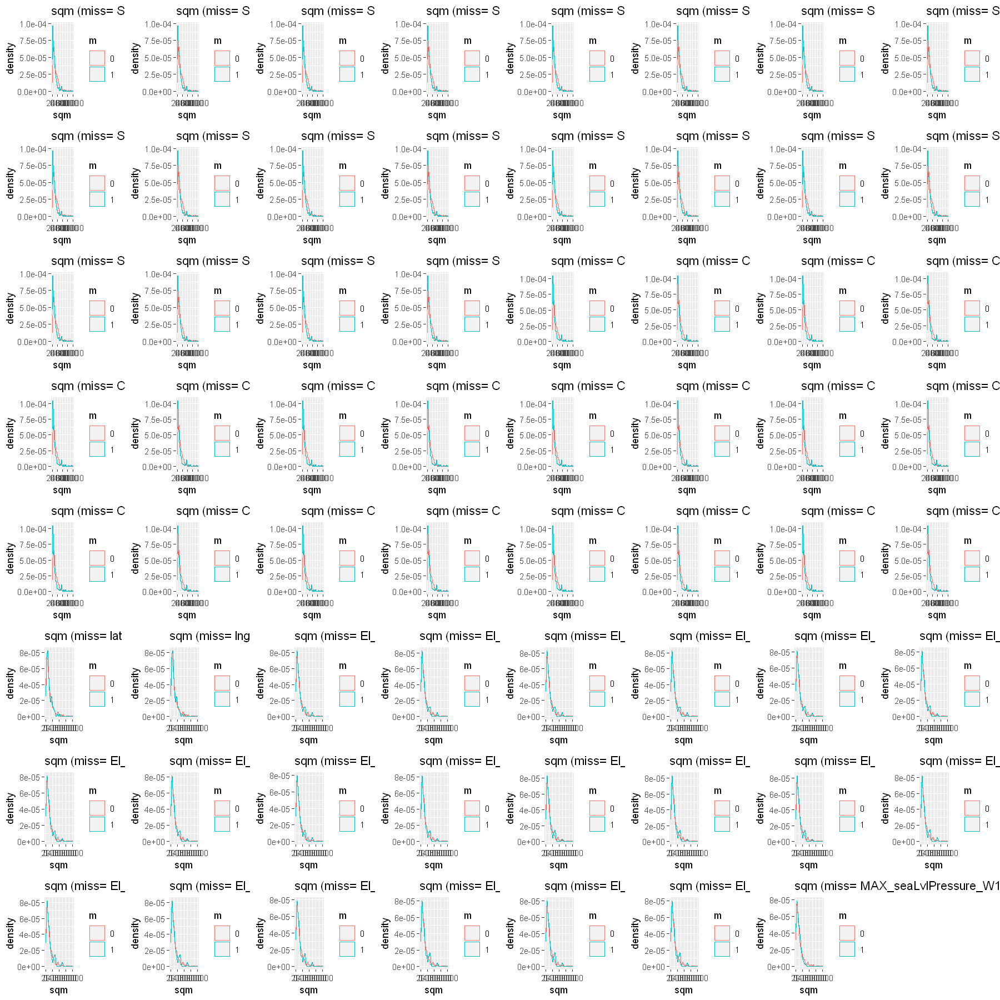

Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:
"Removed 1288 rows containing non-finite values (stat_density)."
Warning message:

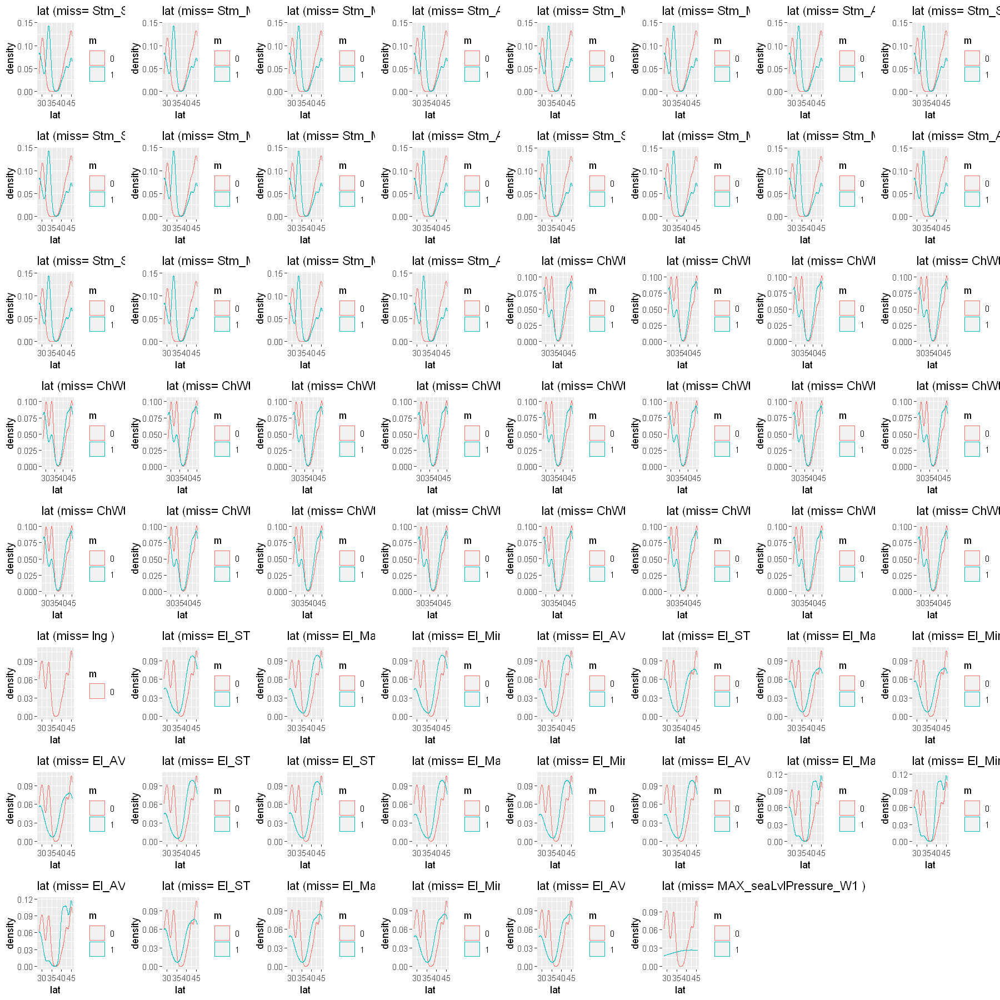

Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 23

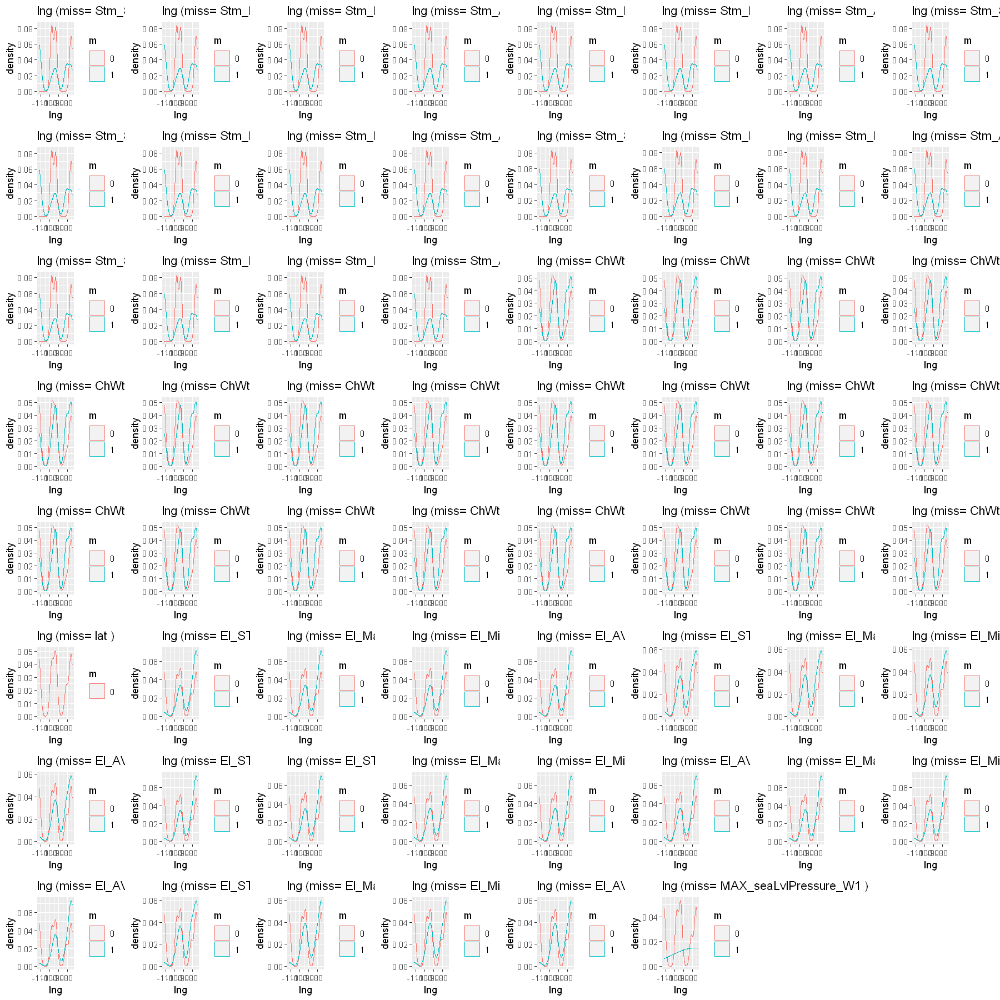

Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 27

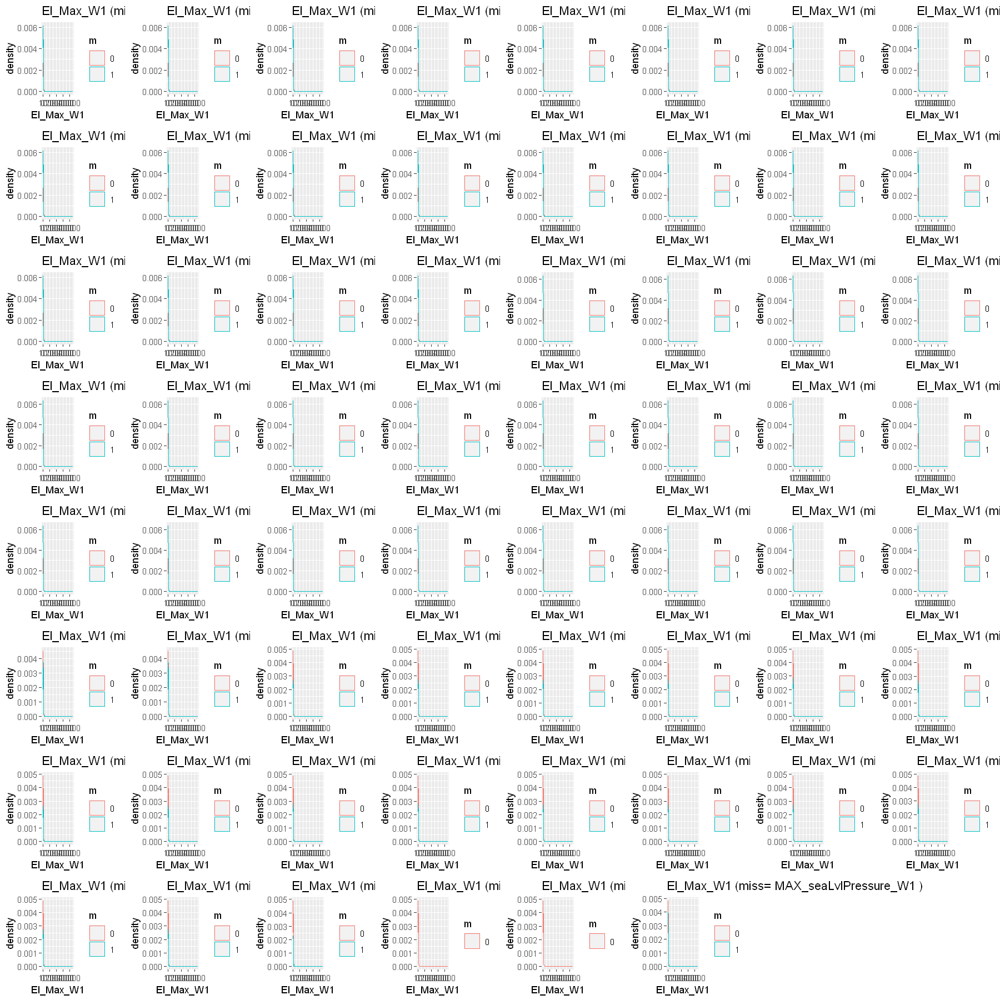

Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 29

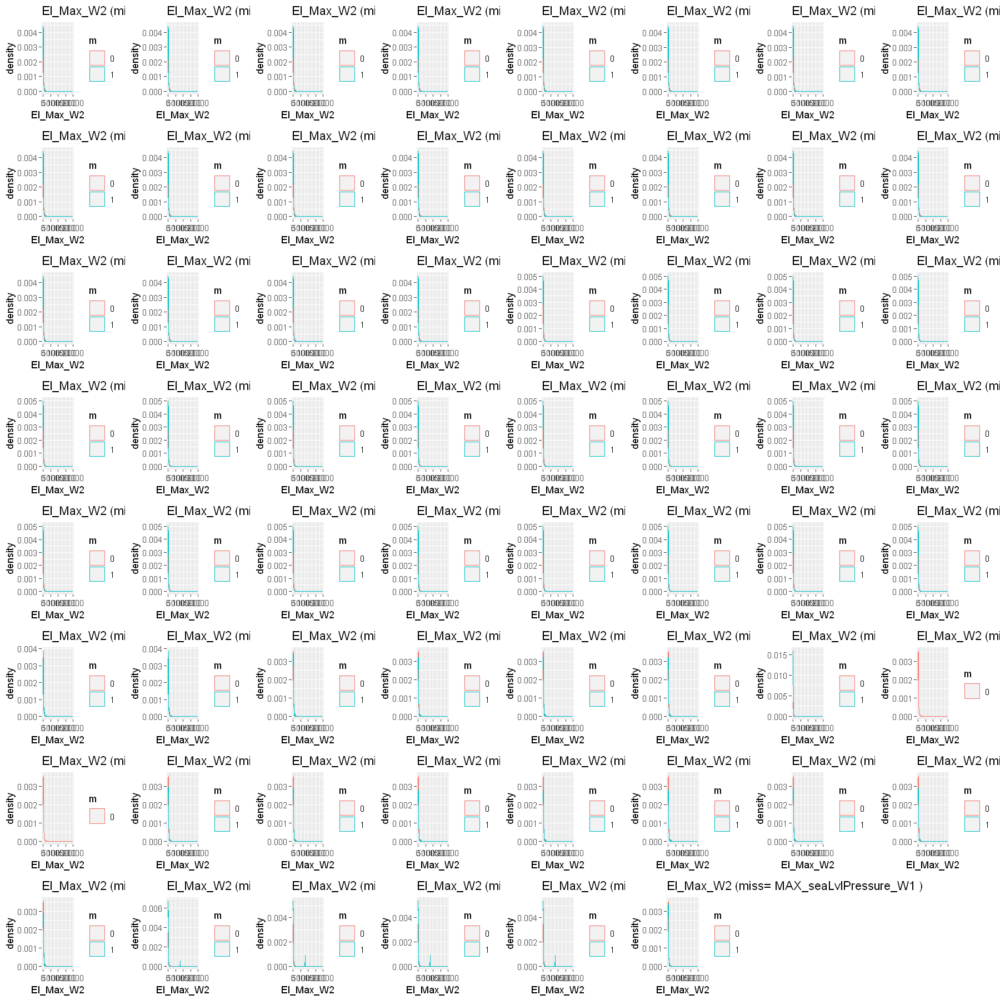

Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

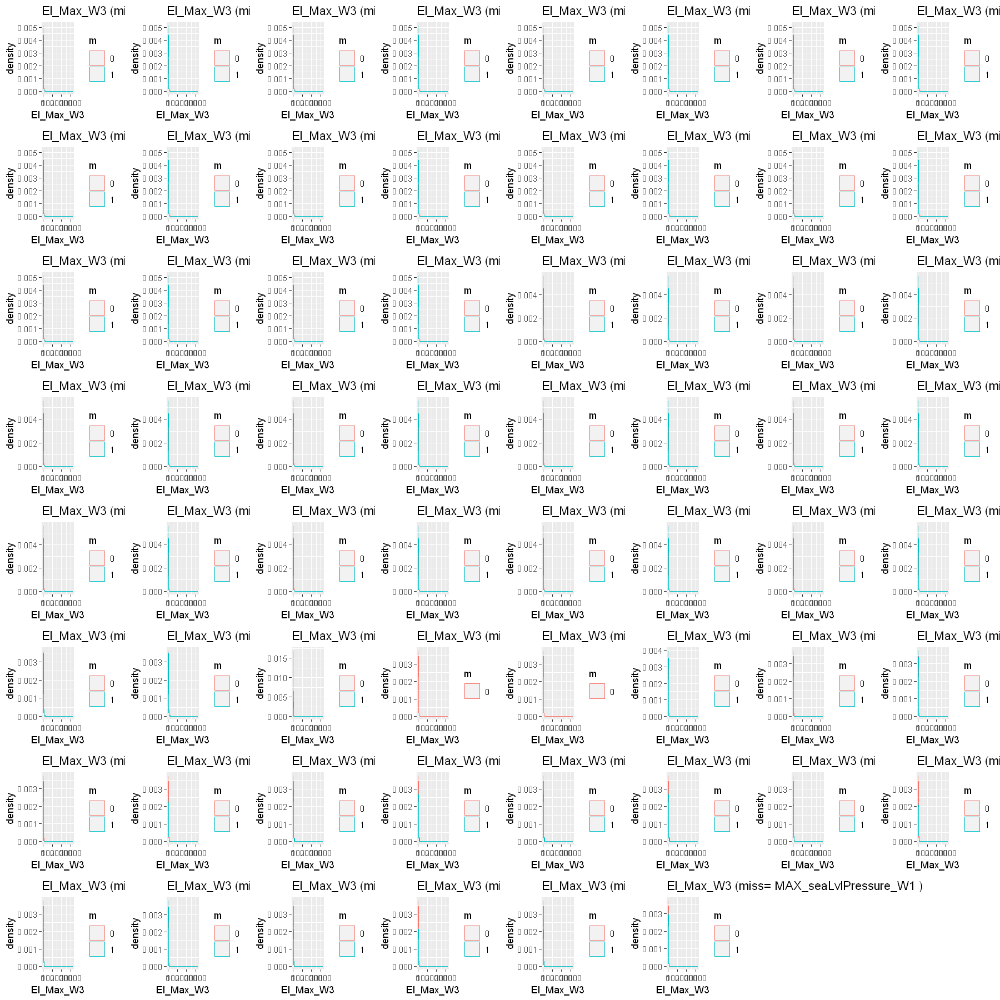

Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

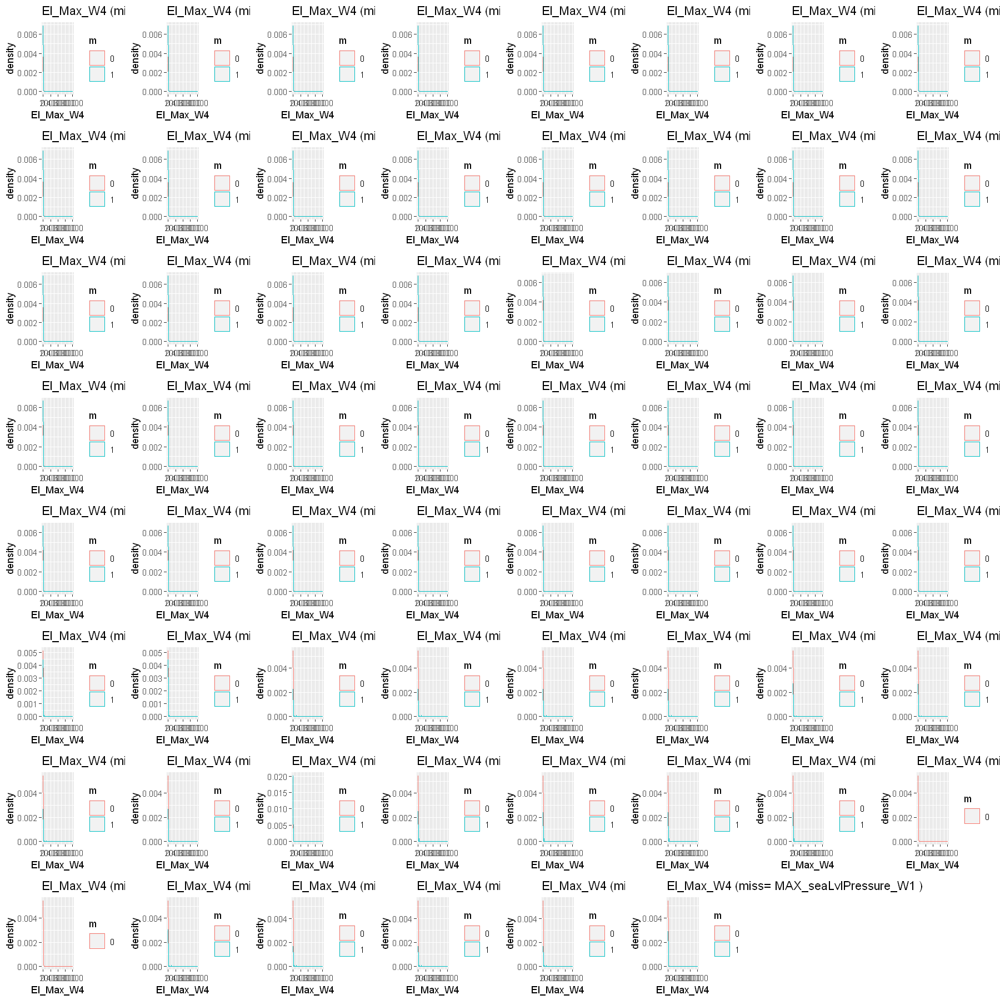

Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 23

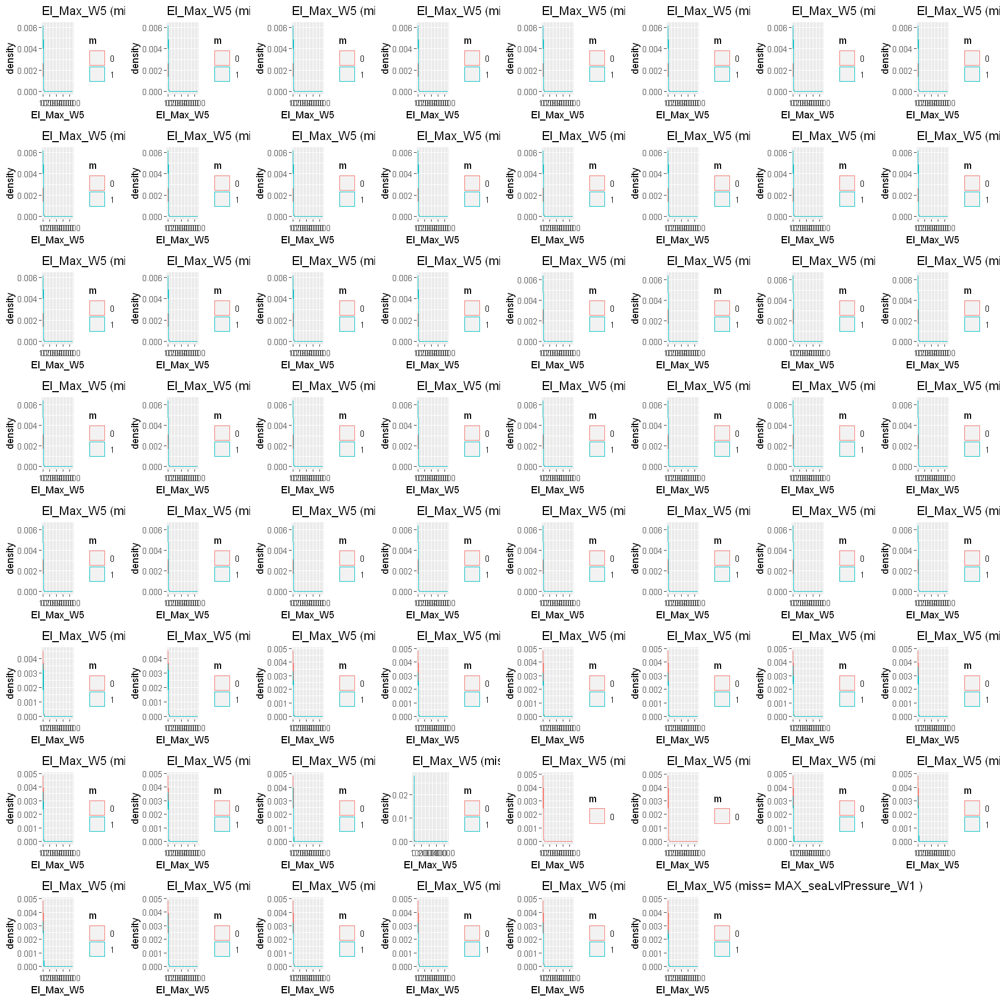

Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 27

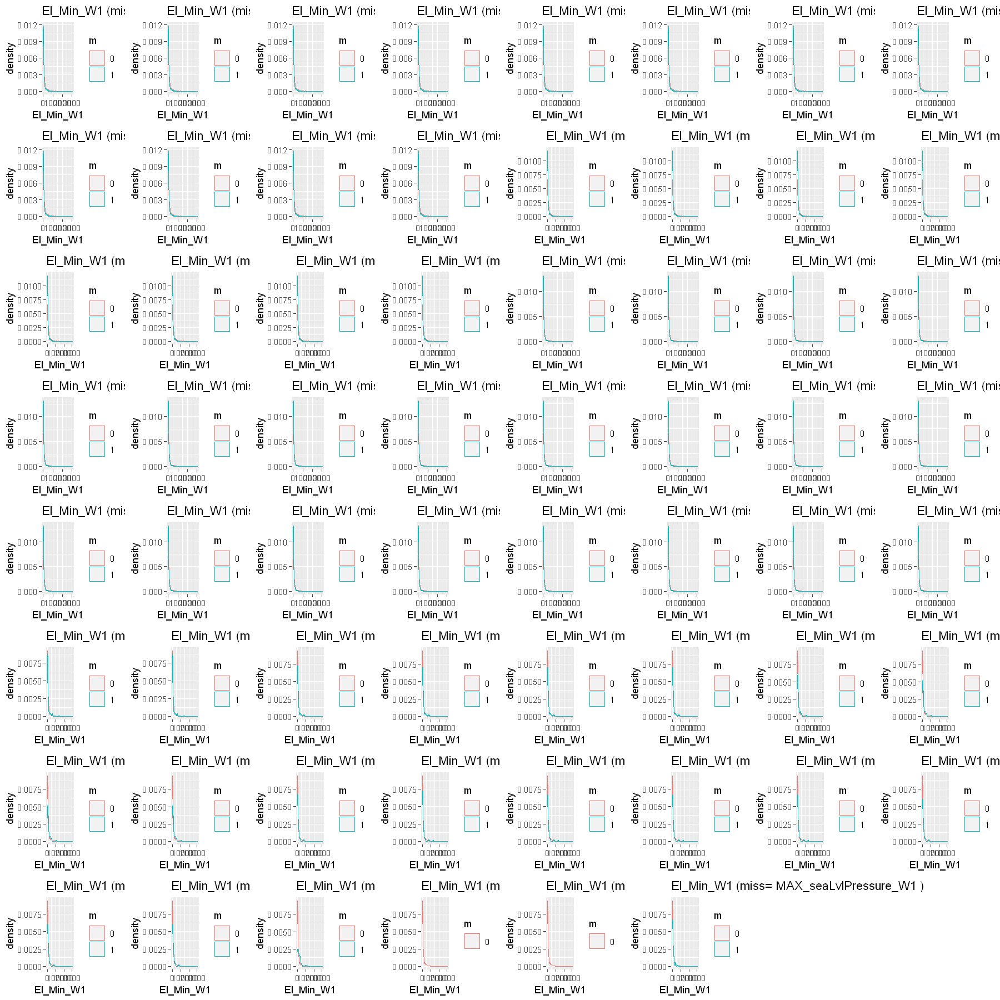

Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 29

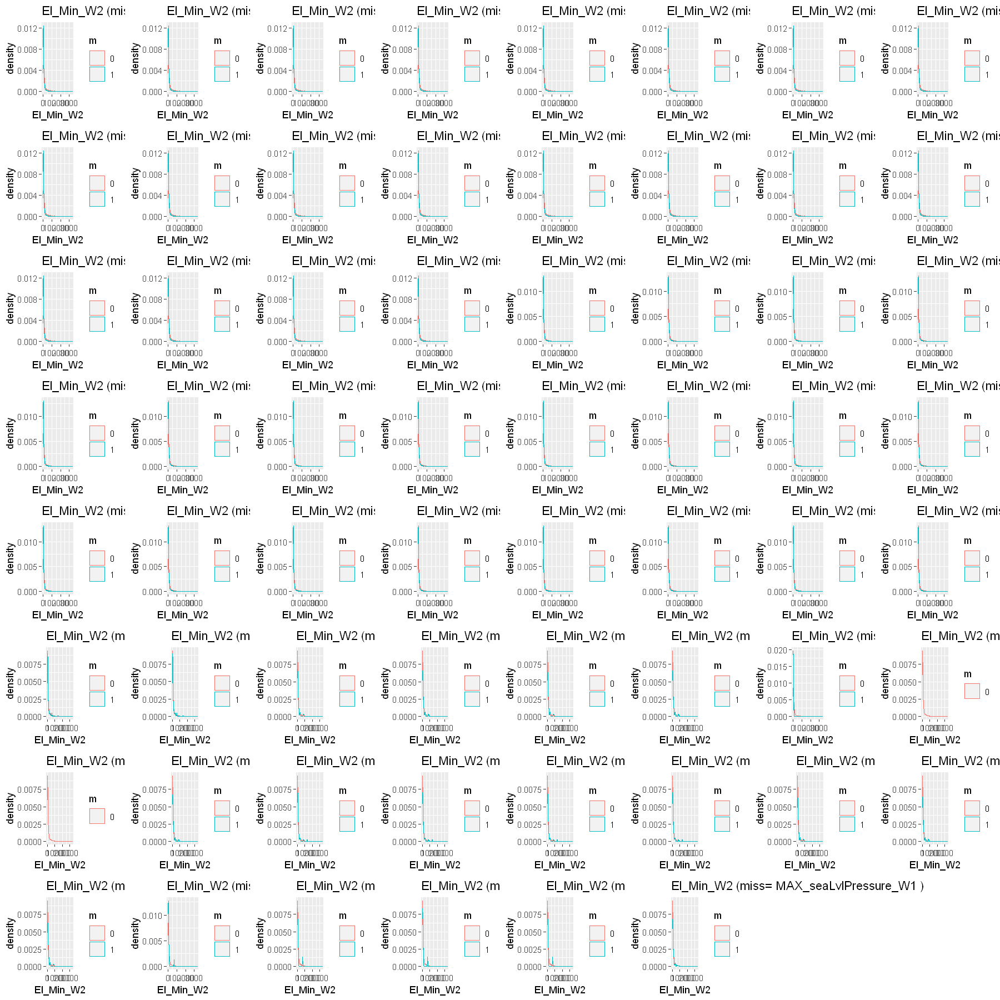

Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

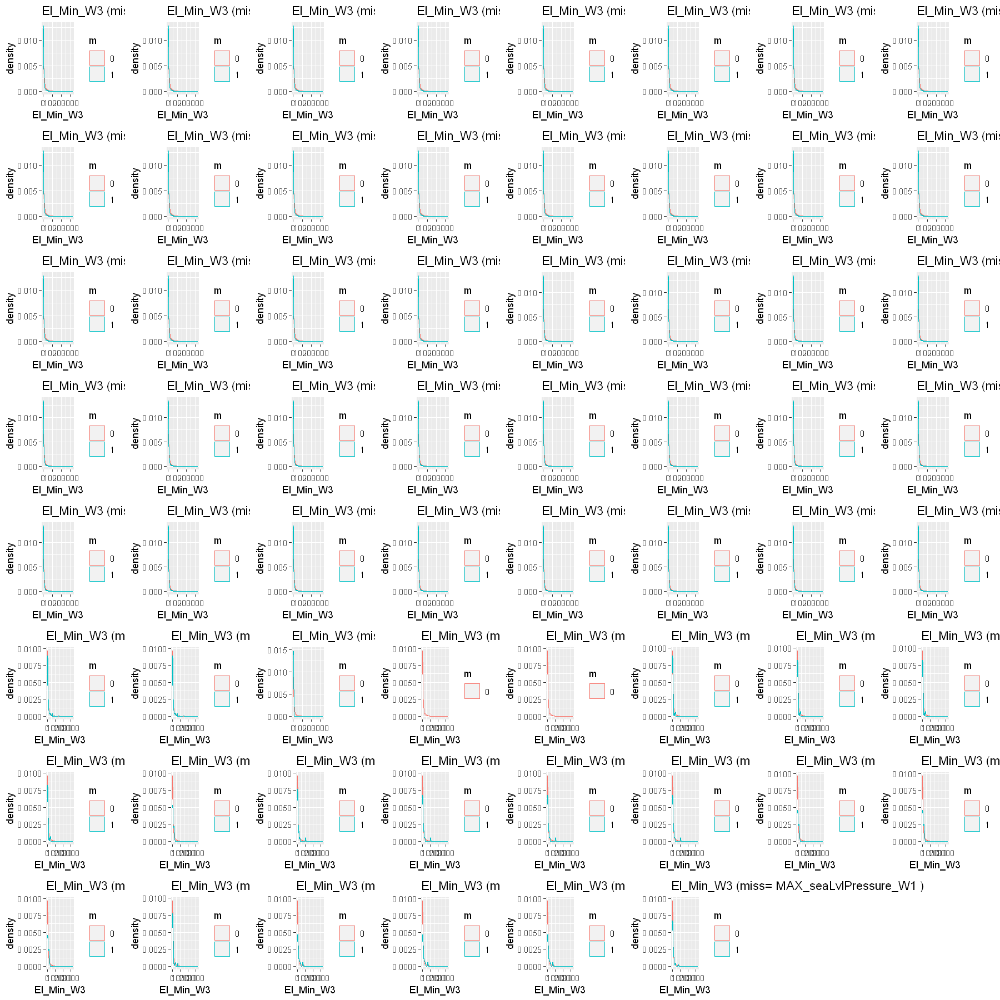

Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

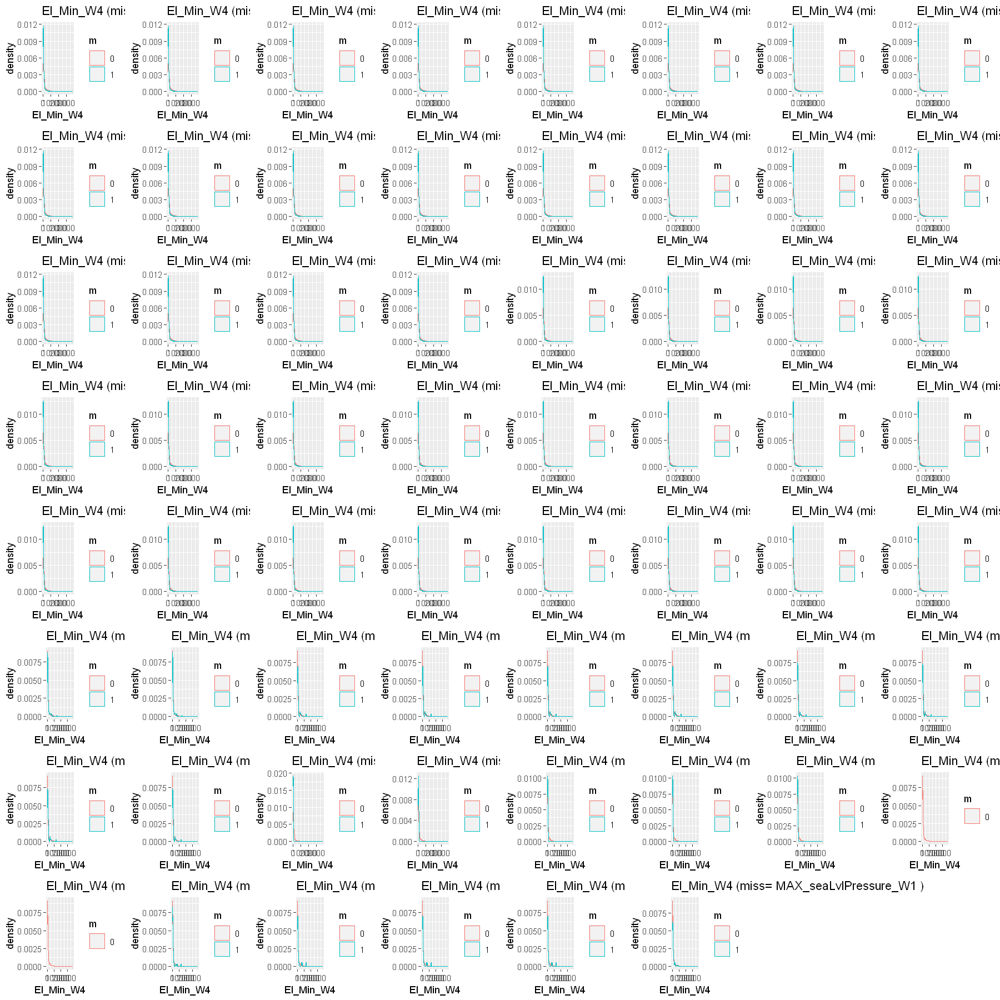

Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 231 rows containing non-finite values (stat_density)."
Warning message:
"Removed 23

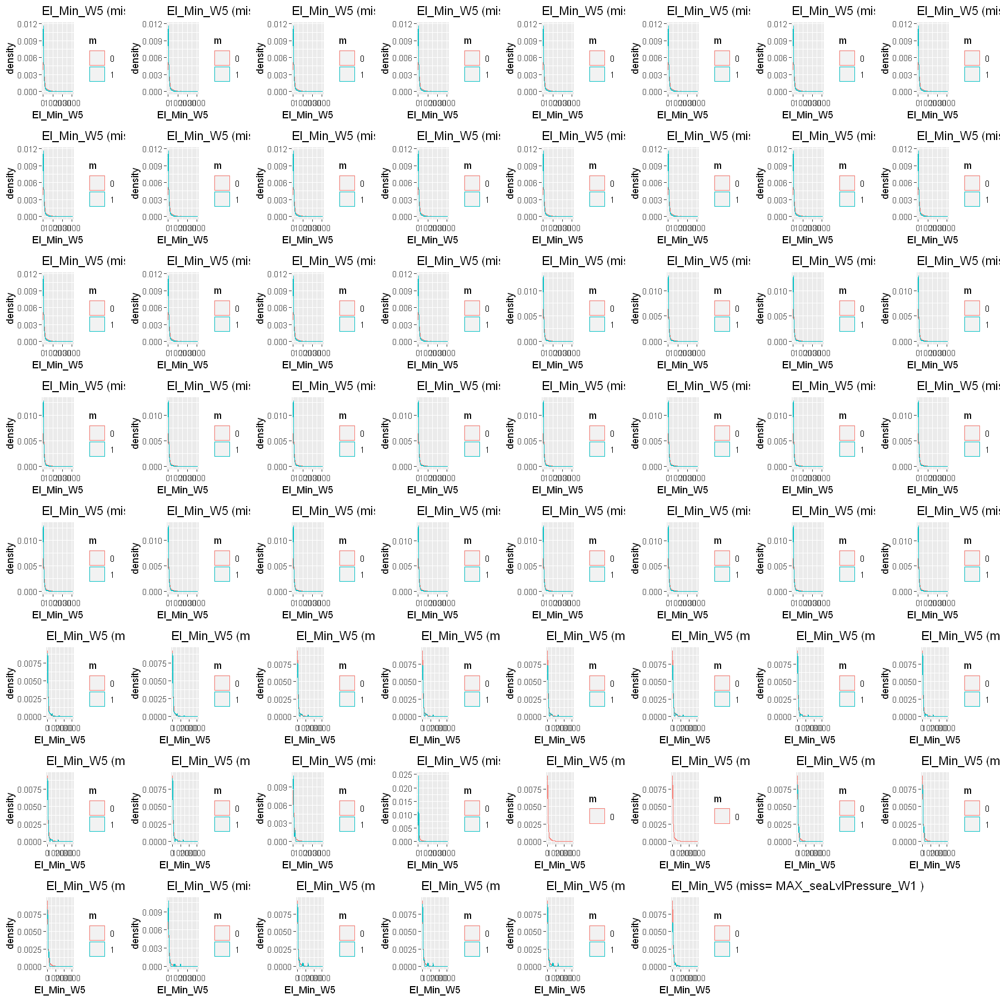

Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 274 rows containing non-finite values (stat_density)."
Warning message:
"Removed 27

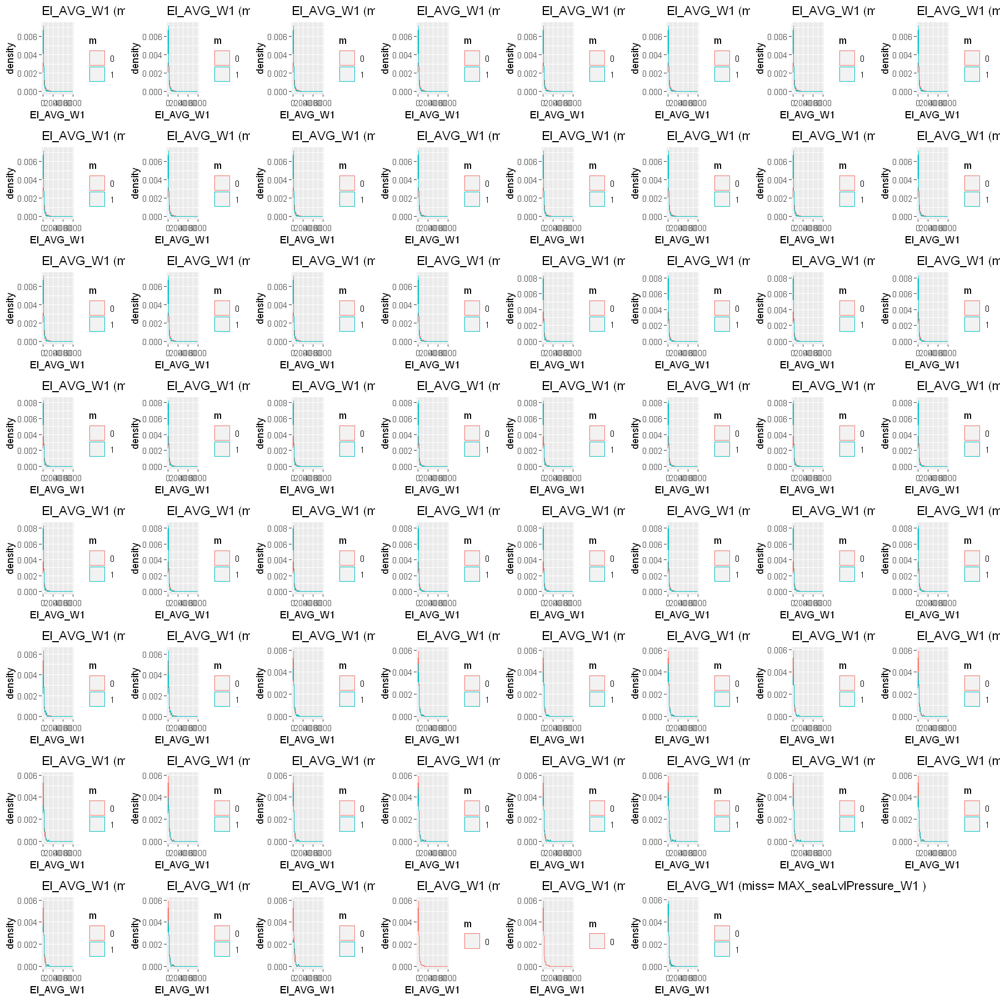

Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 293 rows containing non-finite values (stat_density)."
Warning message:
"Removed 29

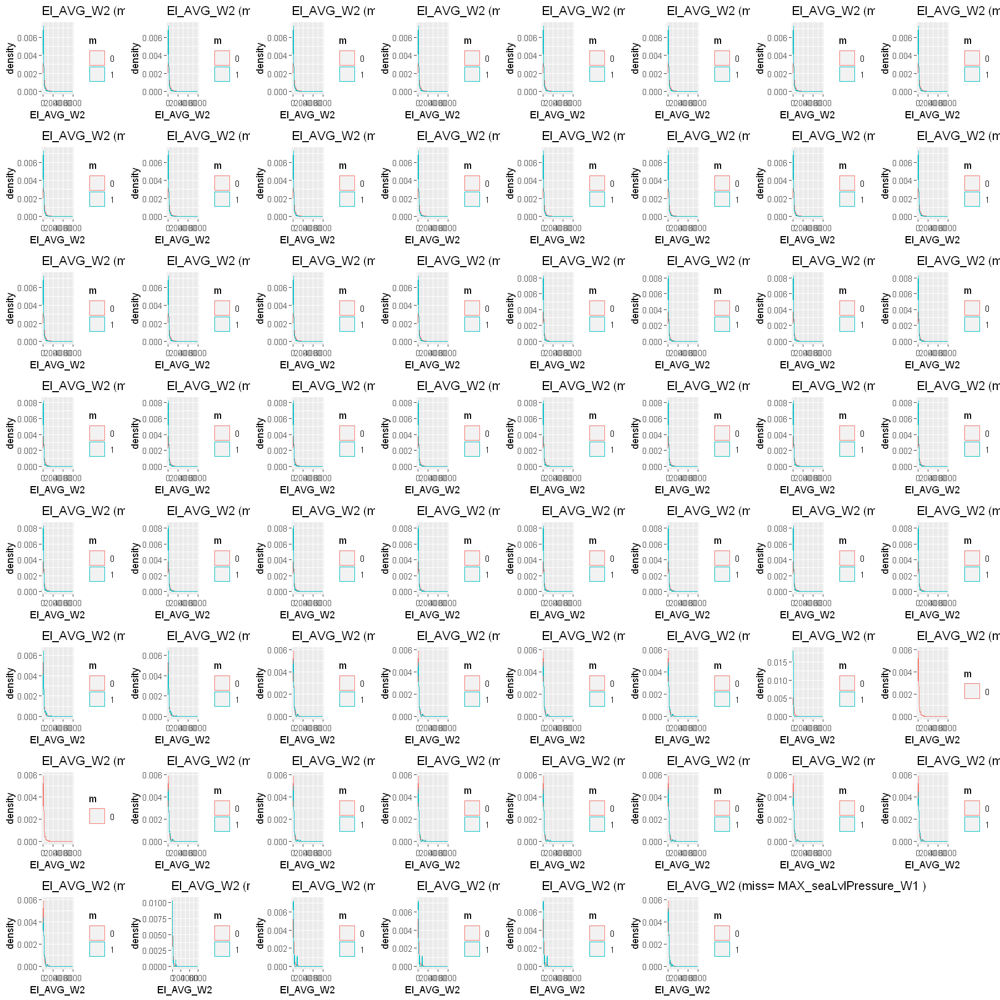

Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 261 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

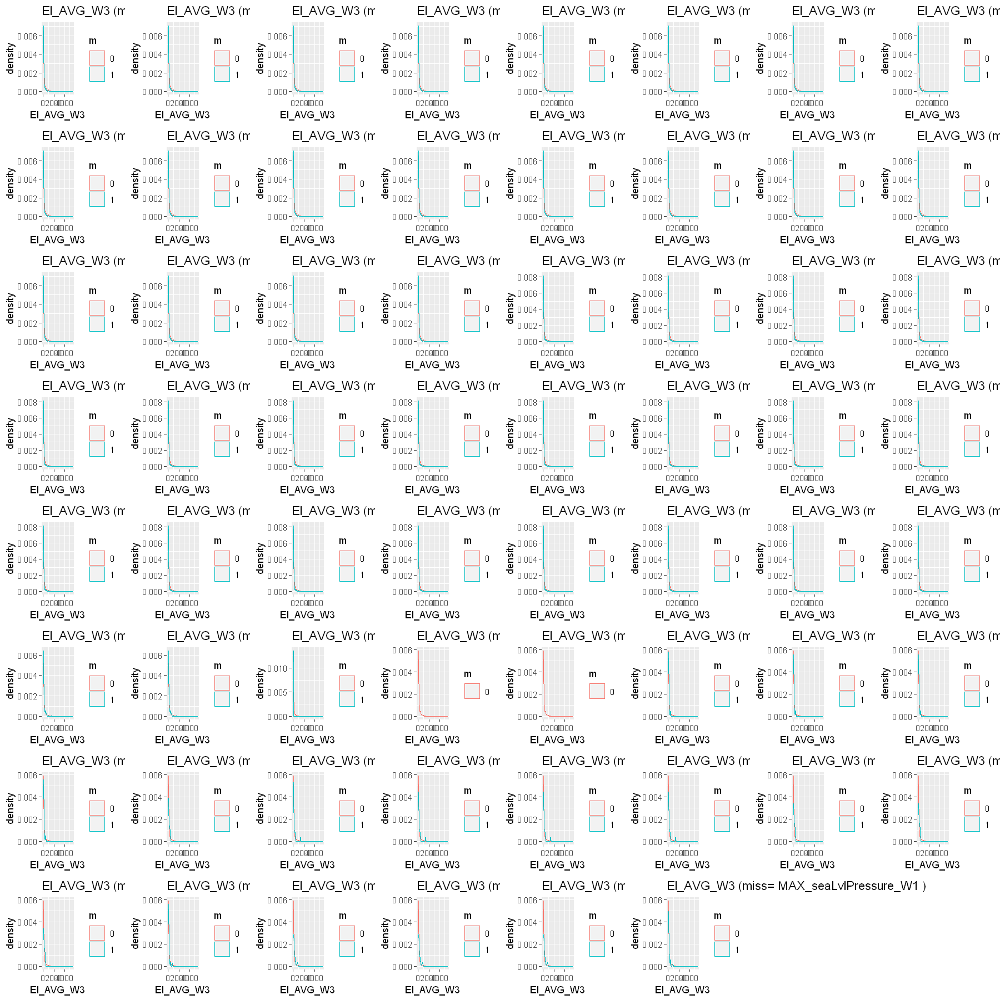

Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 262 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

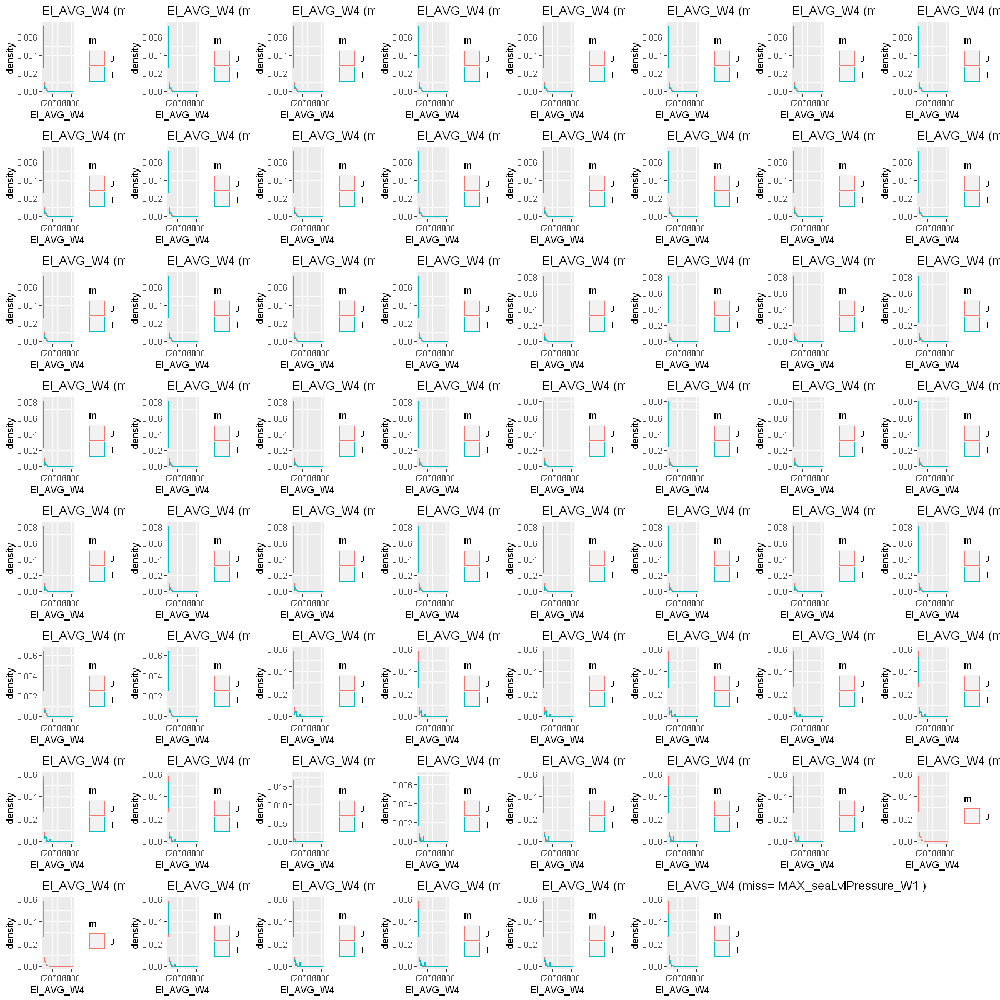

Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 257 rows containing non-finite values (stat_density)."
Warning message:
"Removed 25

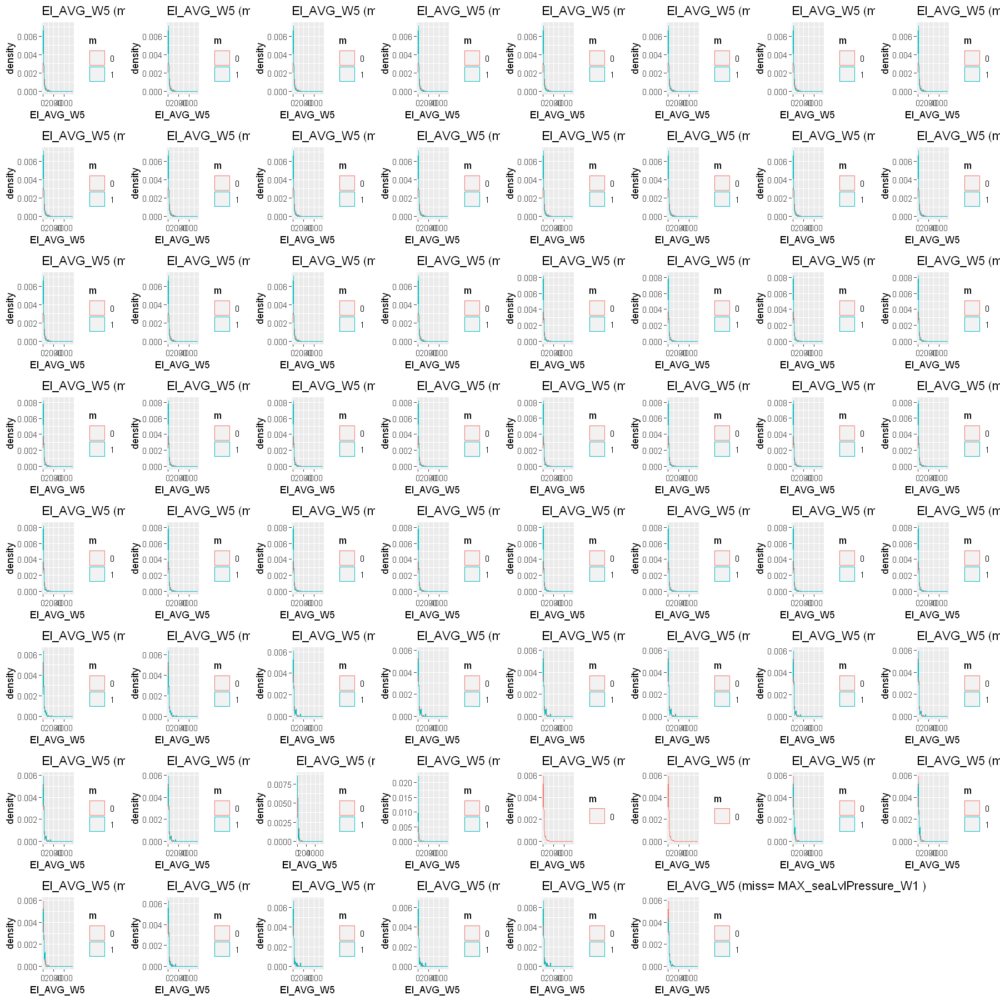

Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 283 rows containing non-finite values (stat_density)."
Warning message:
"Removed 28

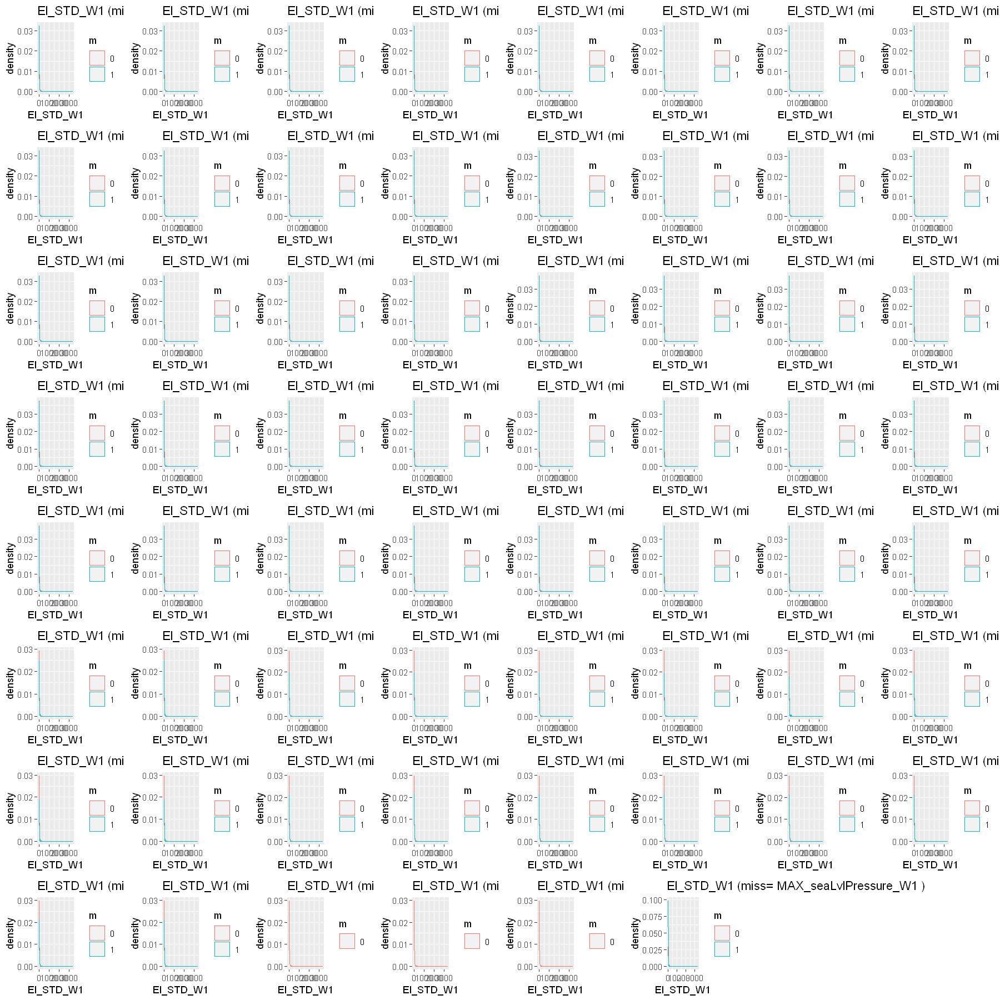

Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 295 rows containing non-finite values (stat_density)."
Warning message:
"Removed 29

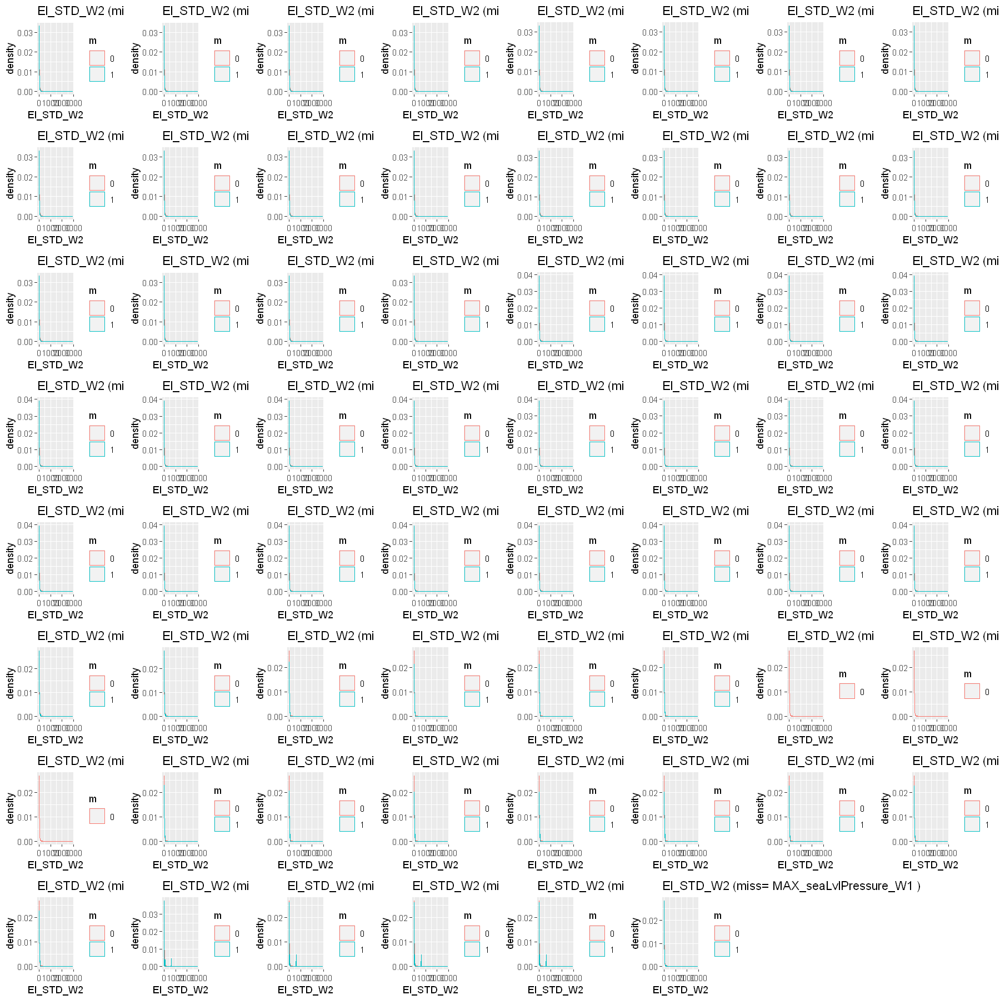

Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

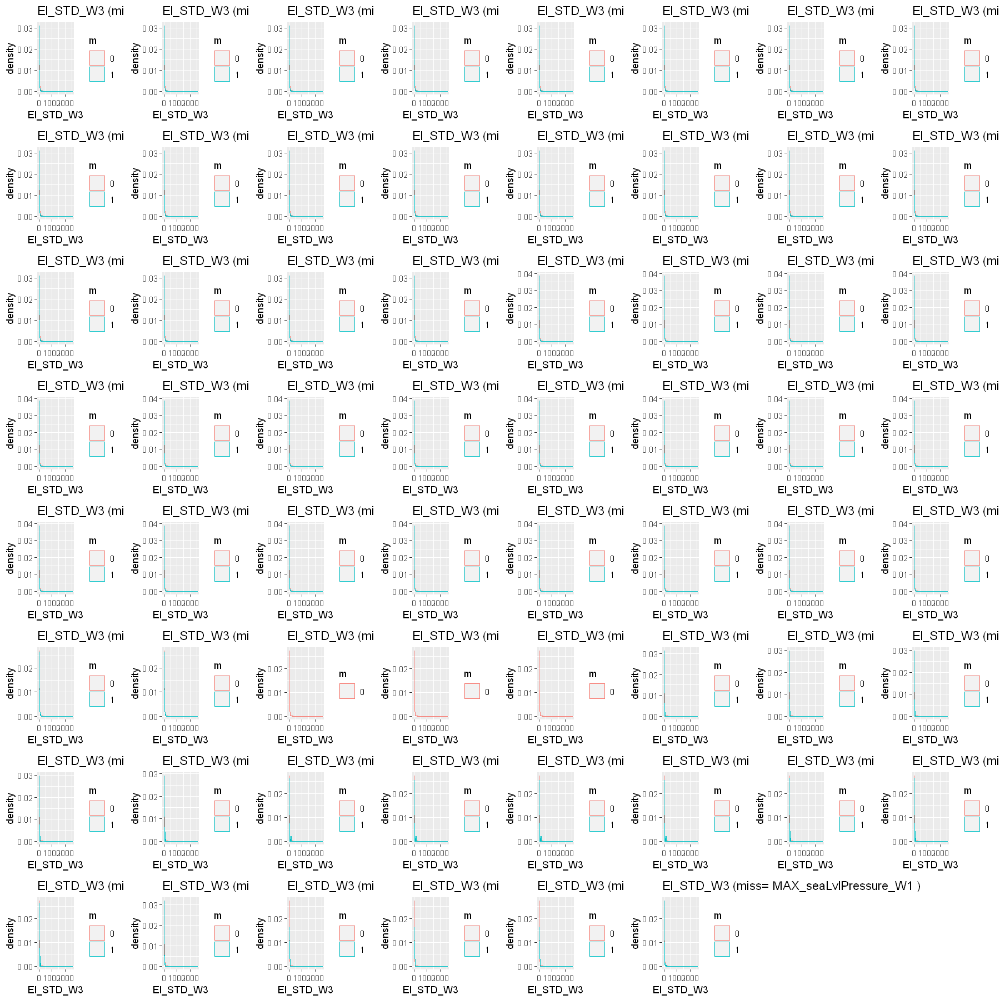

Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 267 rows containing non-finite values (stat_density)."
Warning message:
"Removed 26

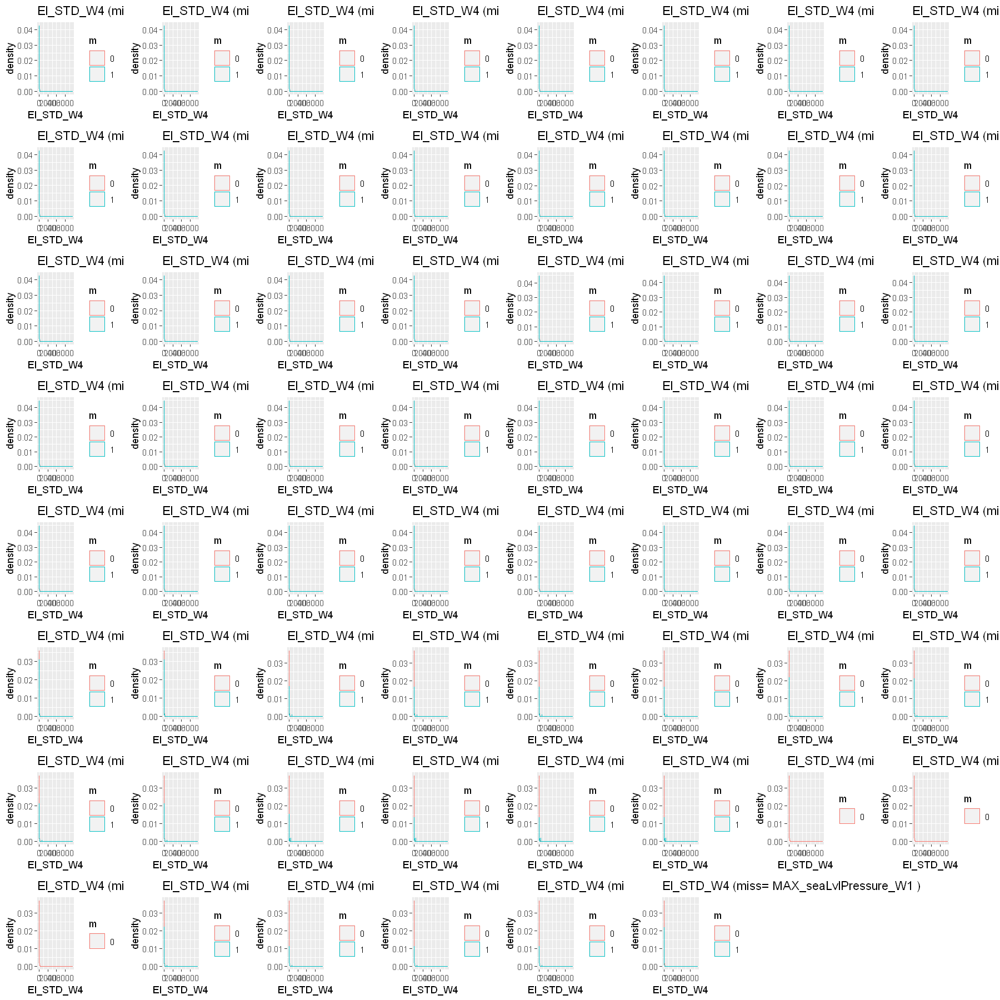

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

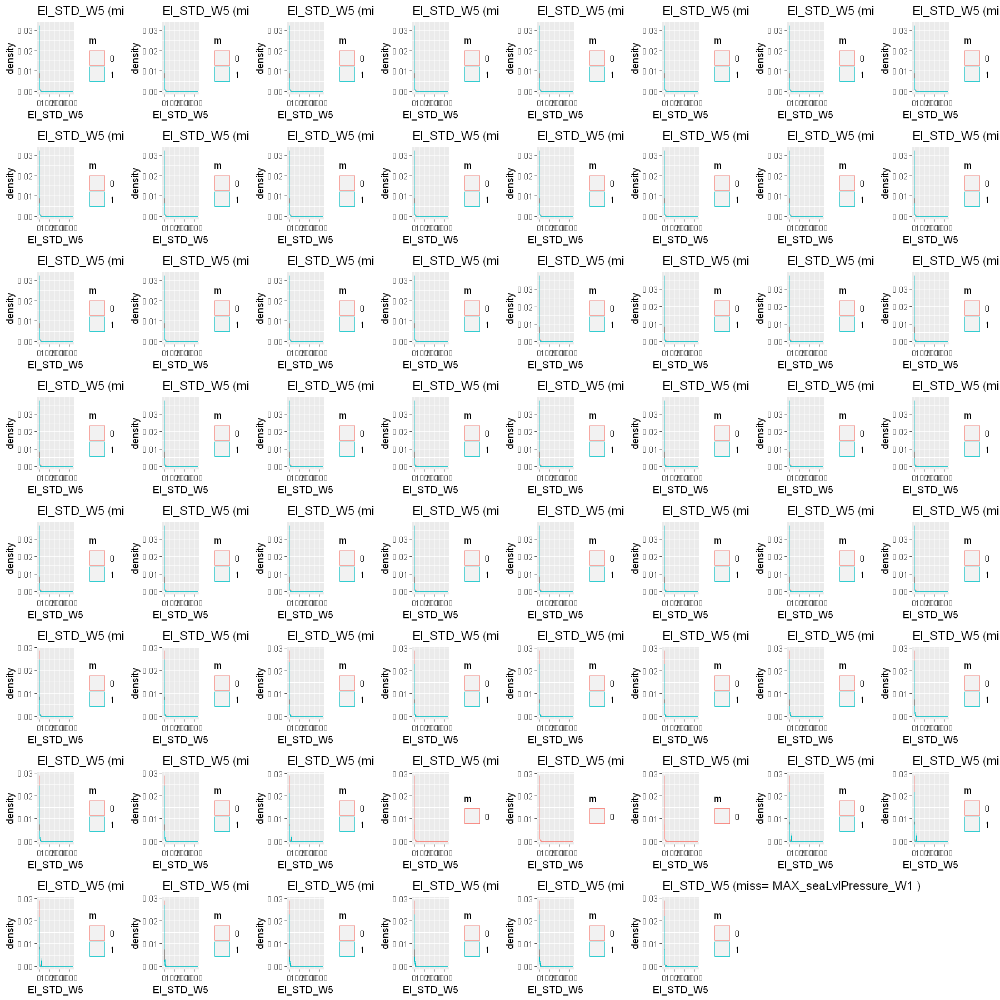

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

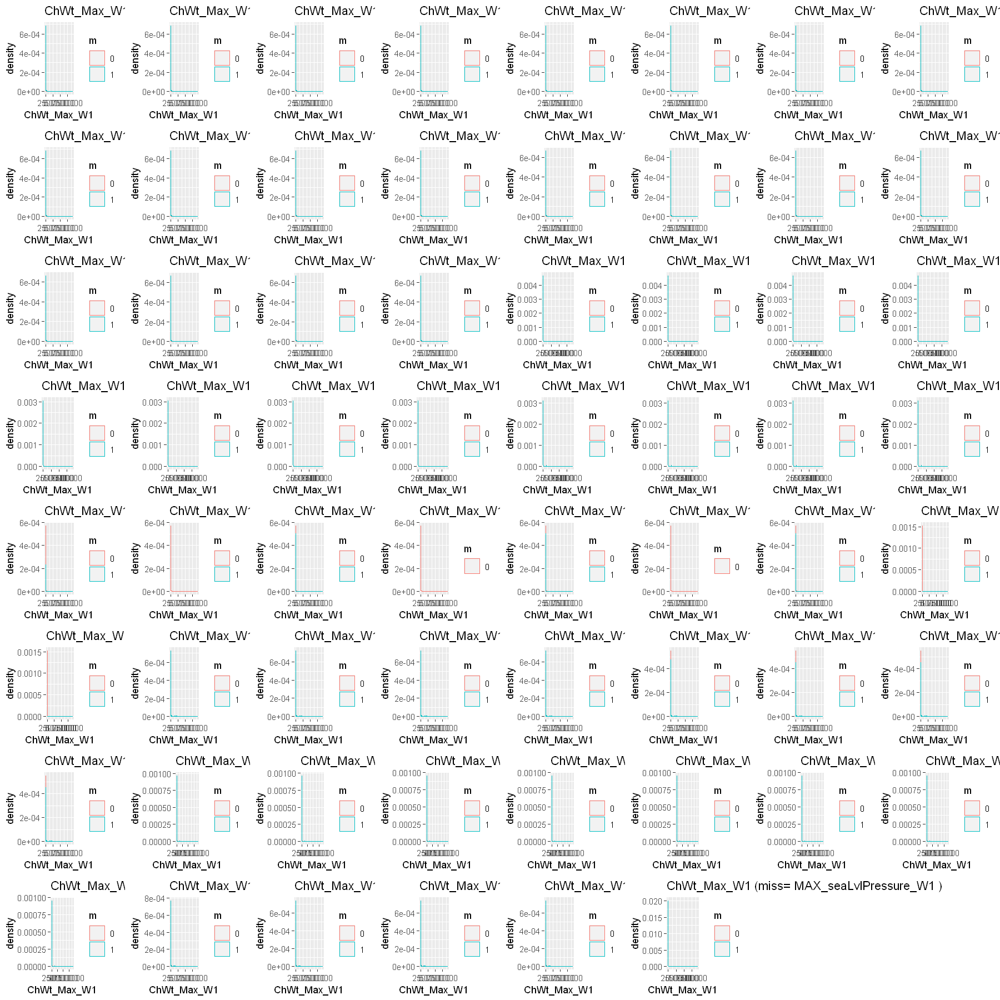

Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:

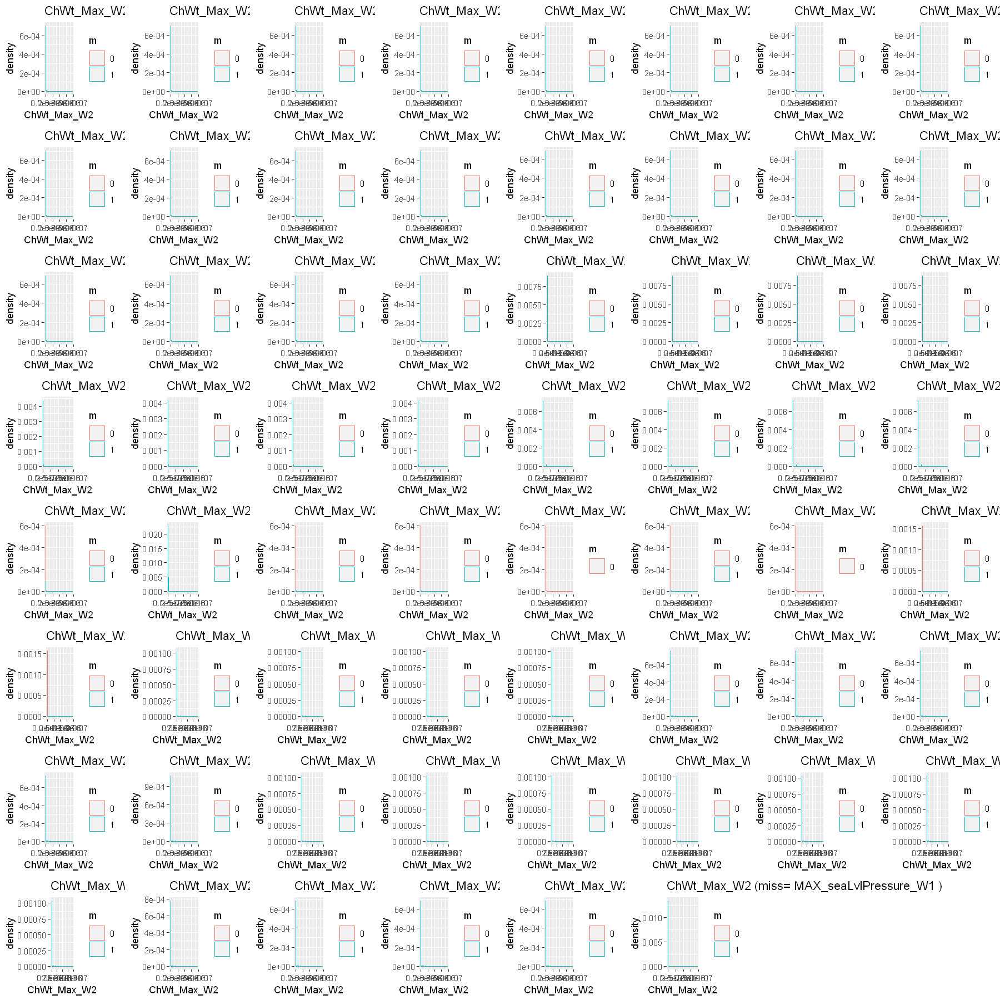

Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:

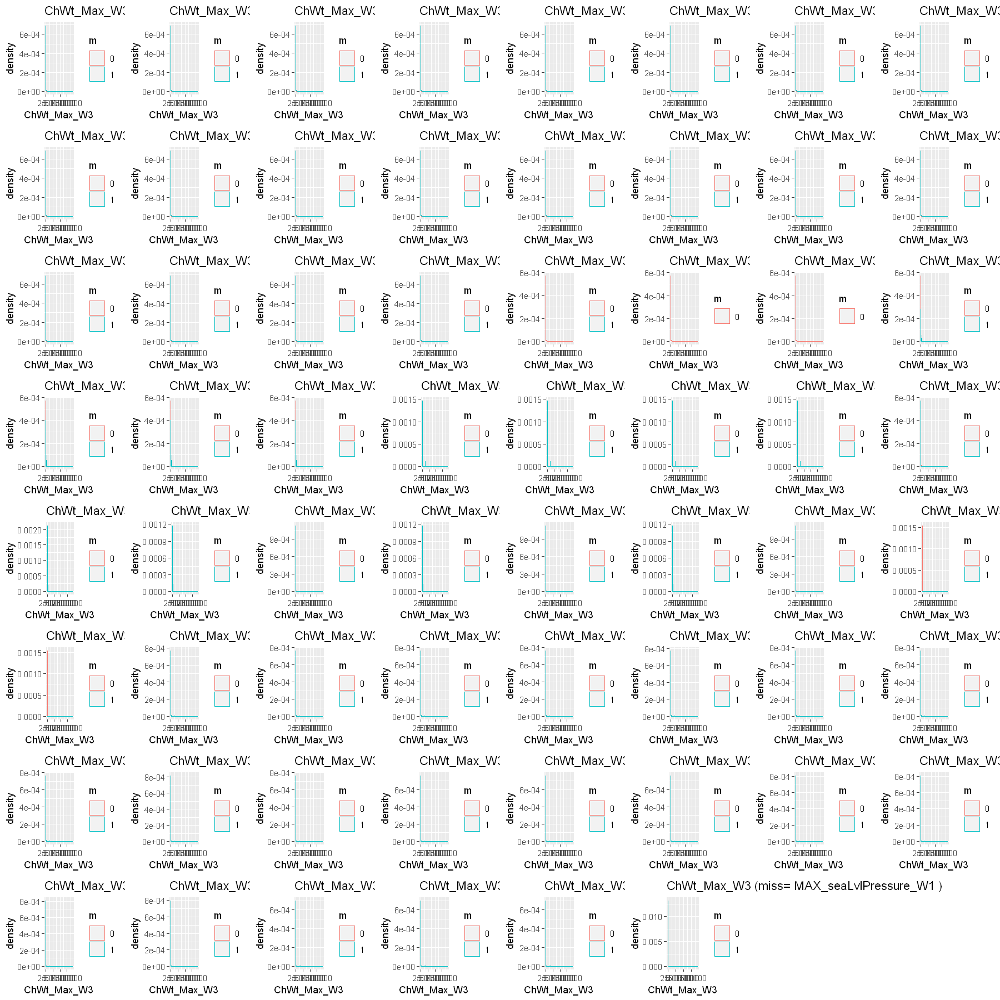

Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:

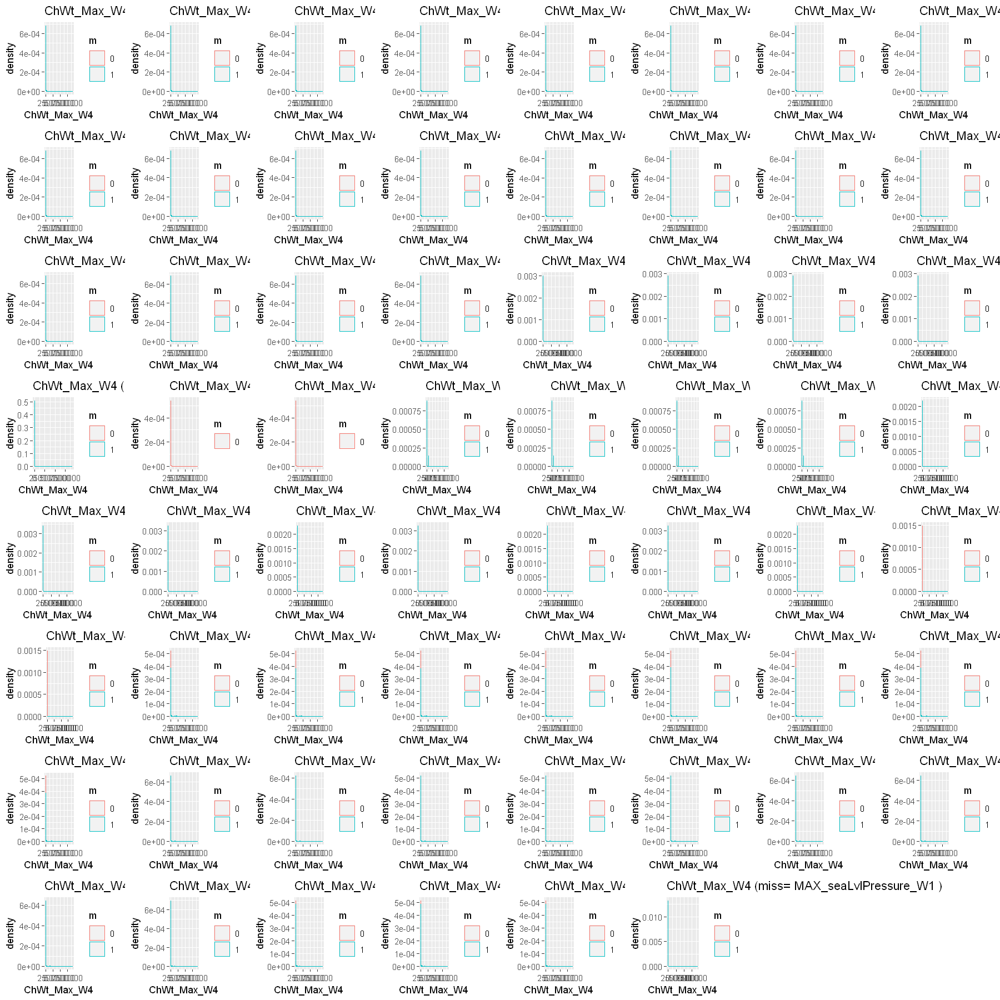

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

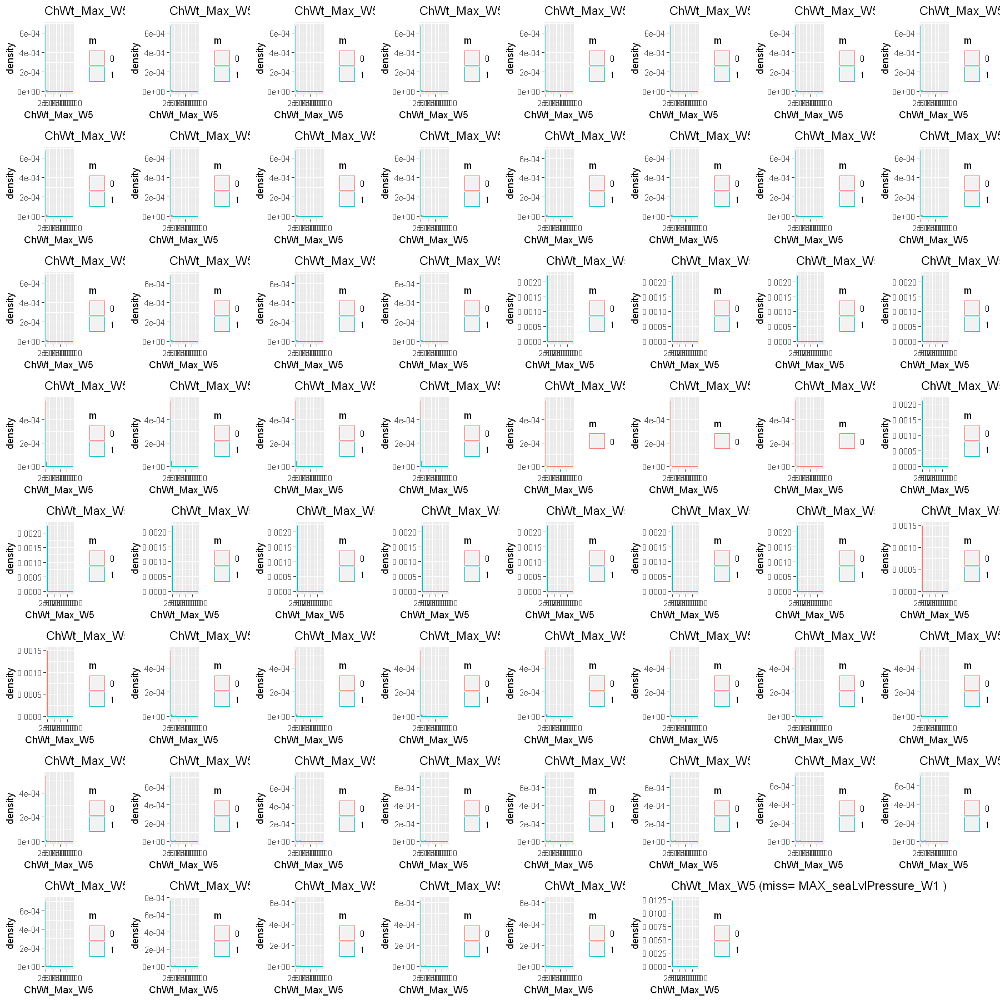

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

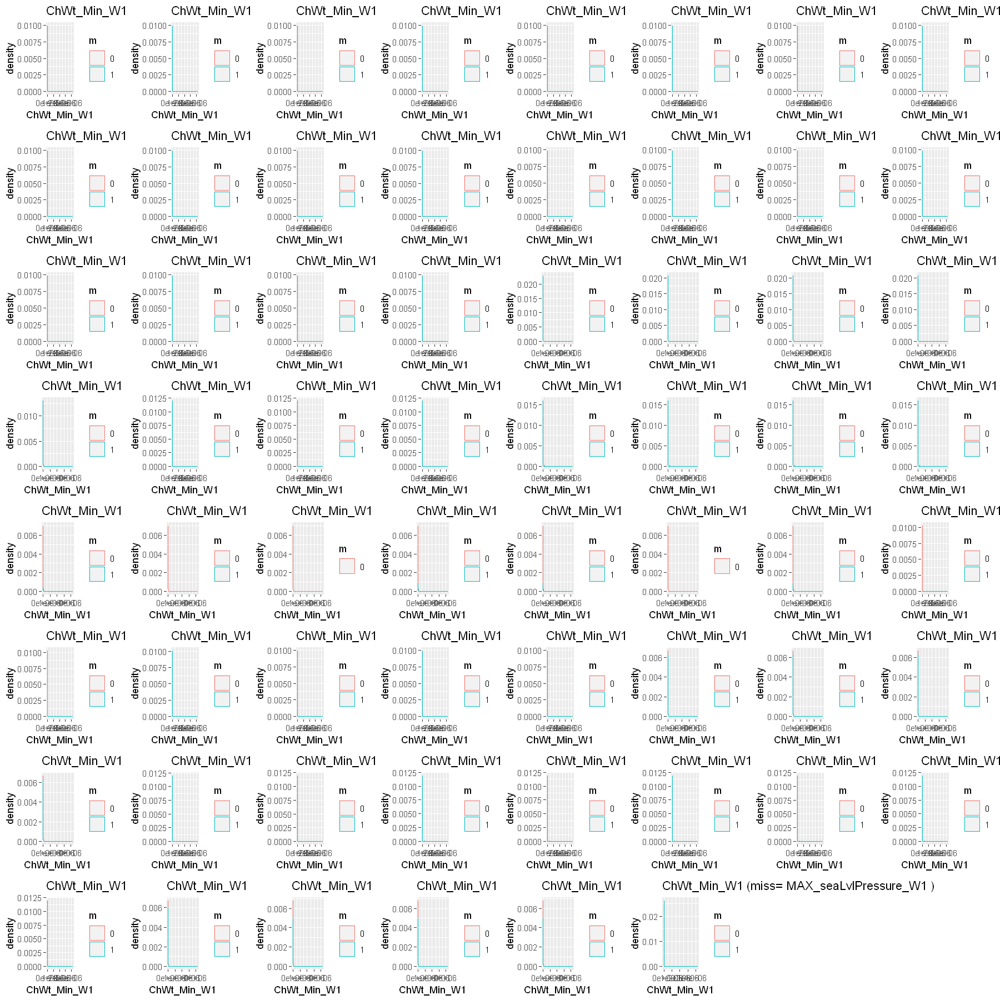

Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:

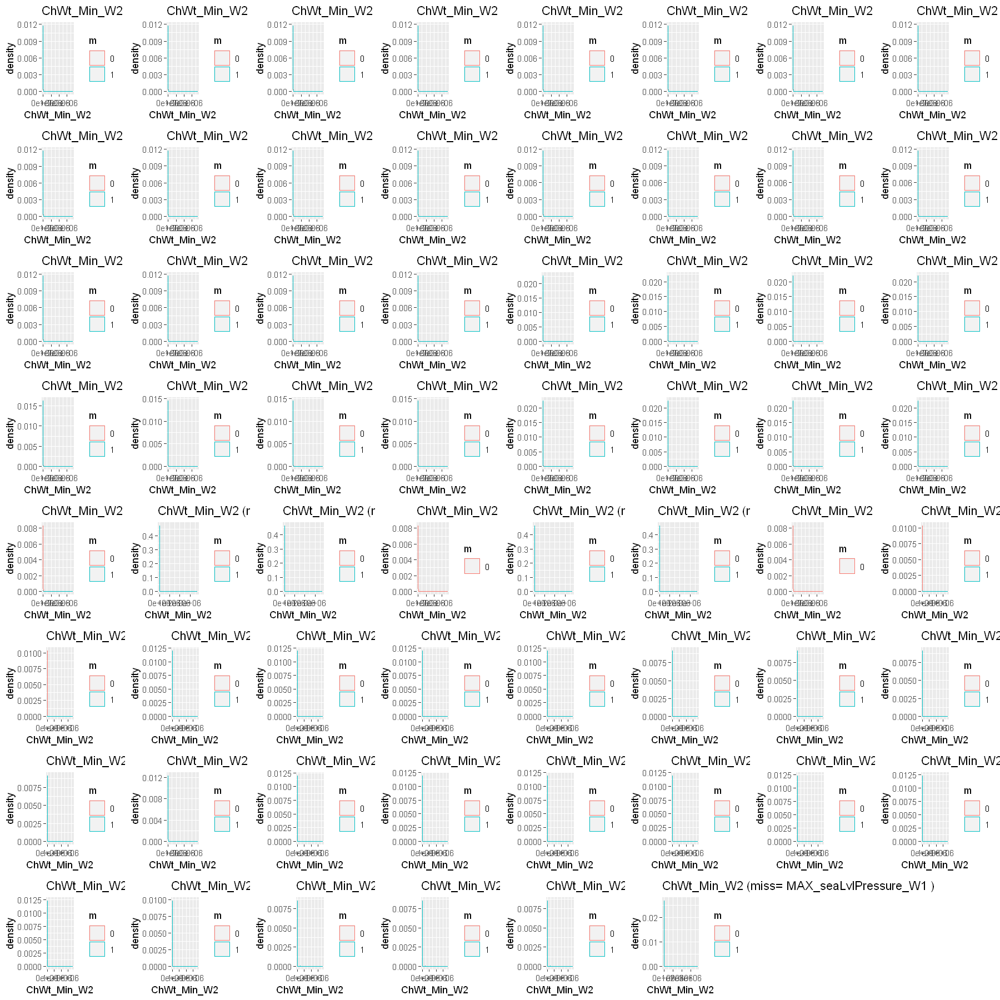

Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:

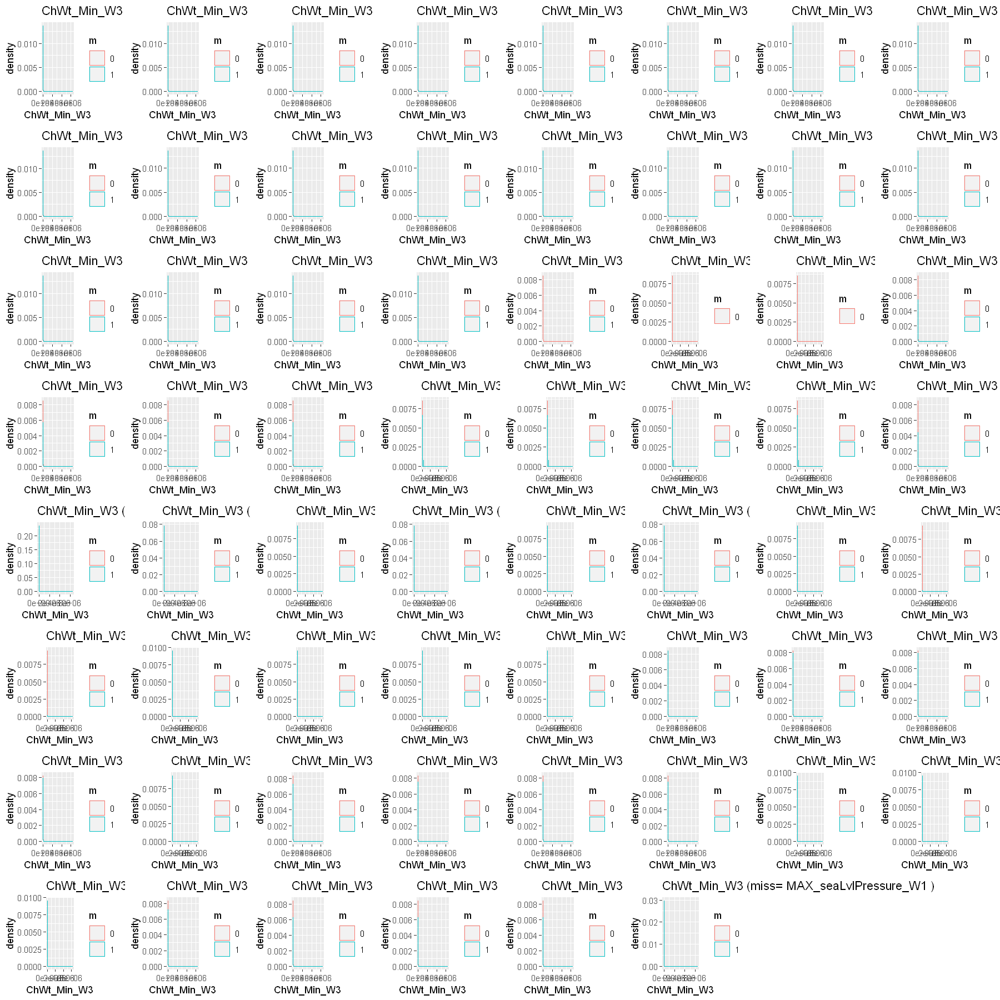

Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:

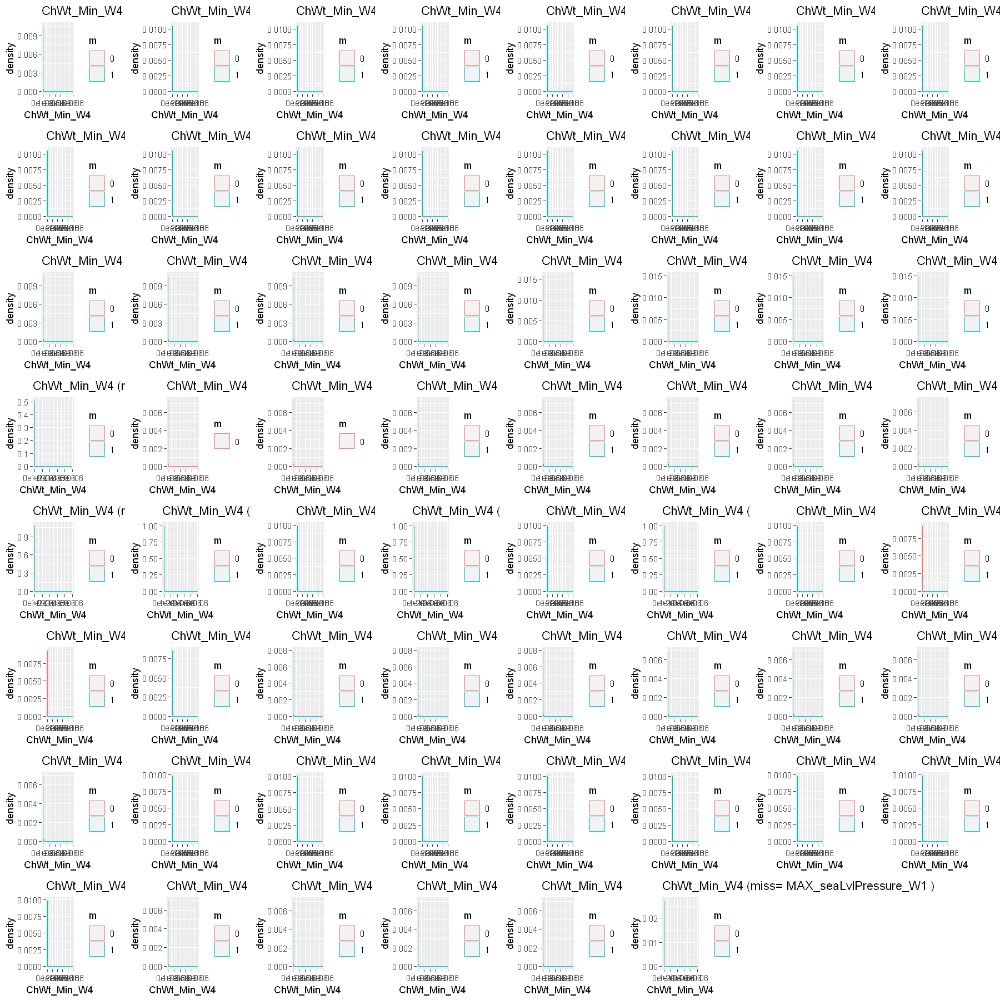

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

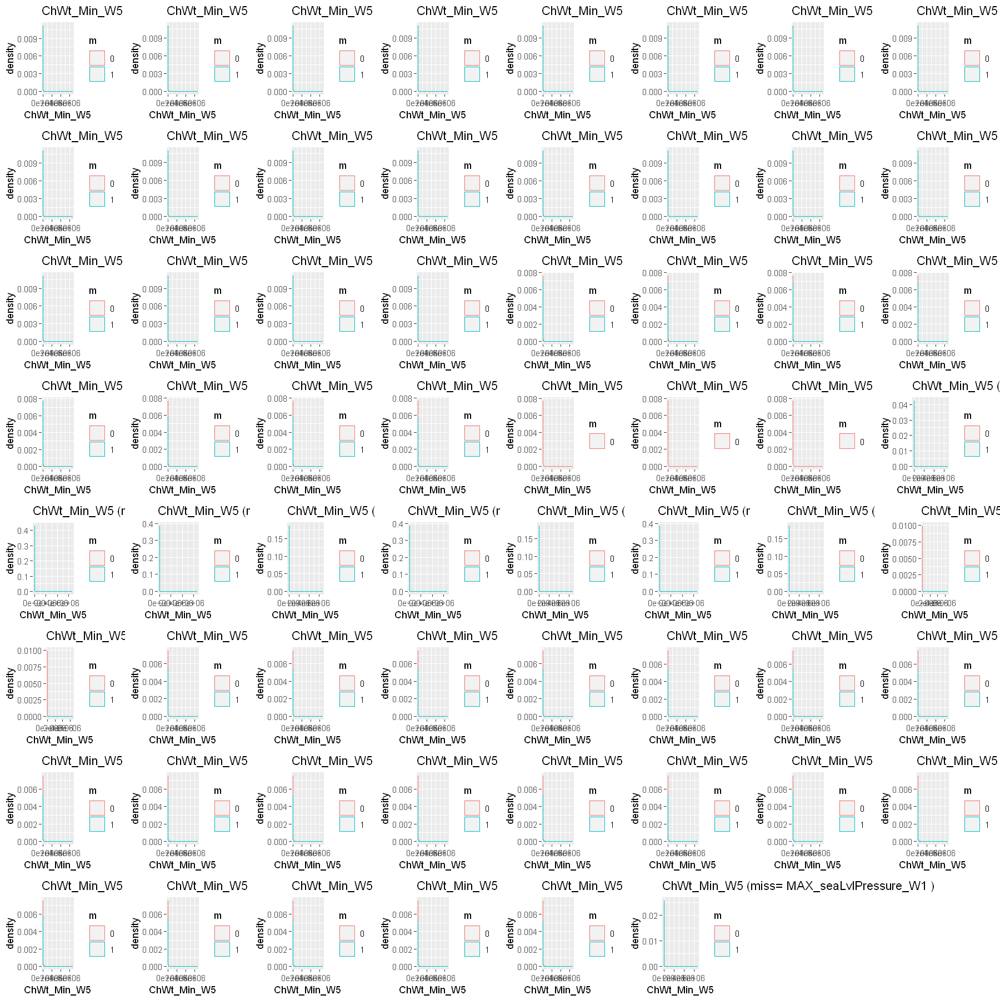

Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2988 rows containing non-finite values (stat_density)."
Warning message:

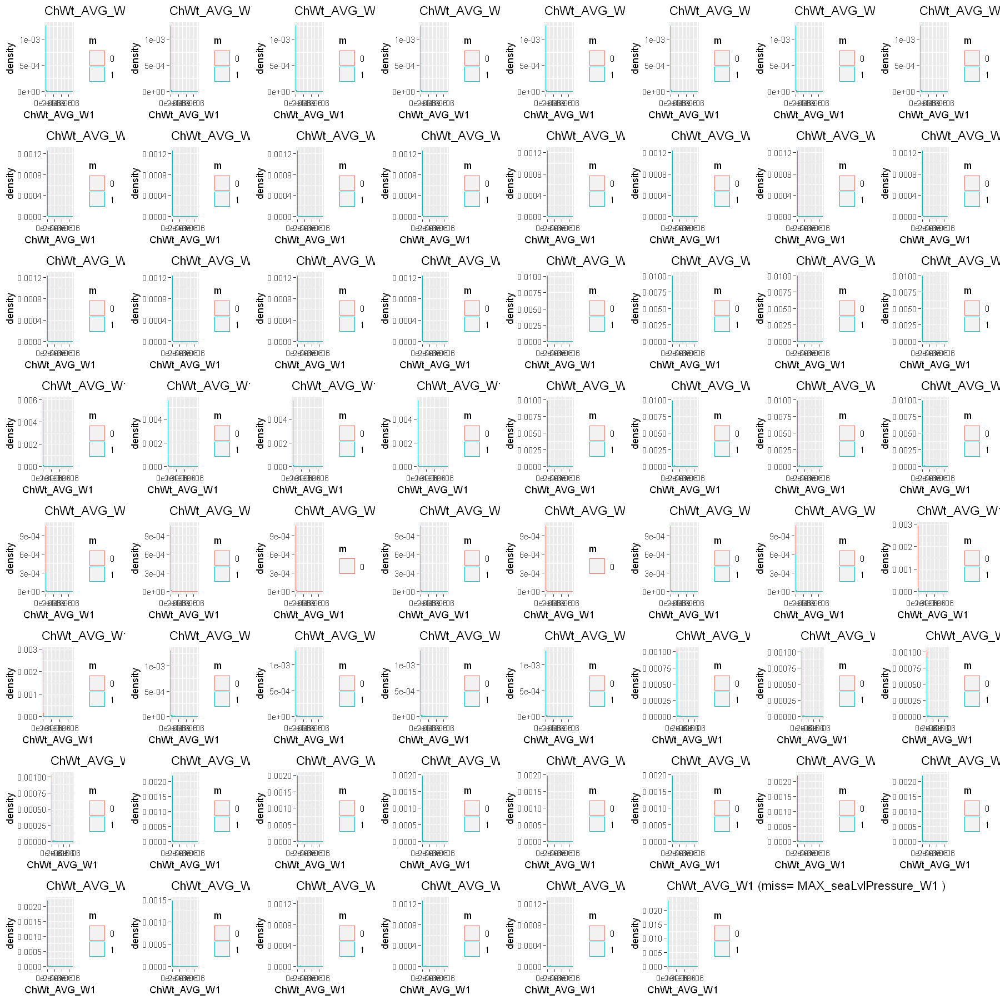

Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3020 rows containing non-finite values (stat_density)."
Warning message:

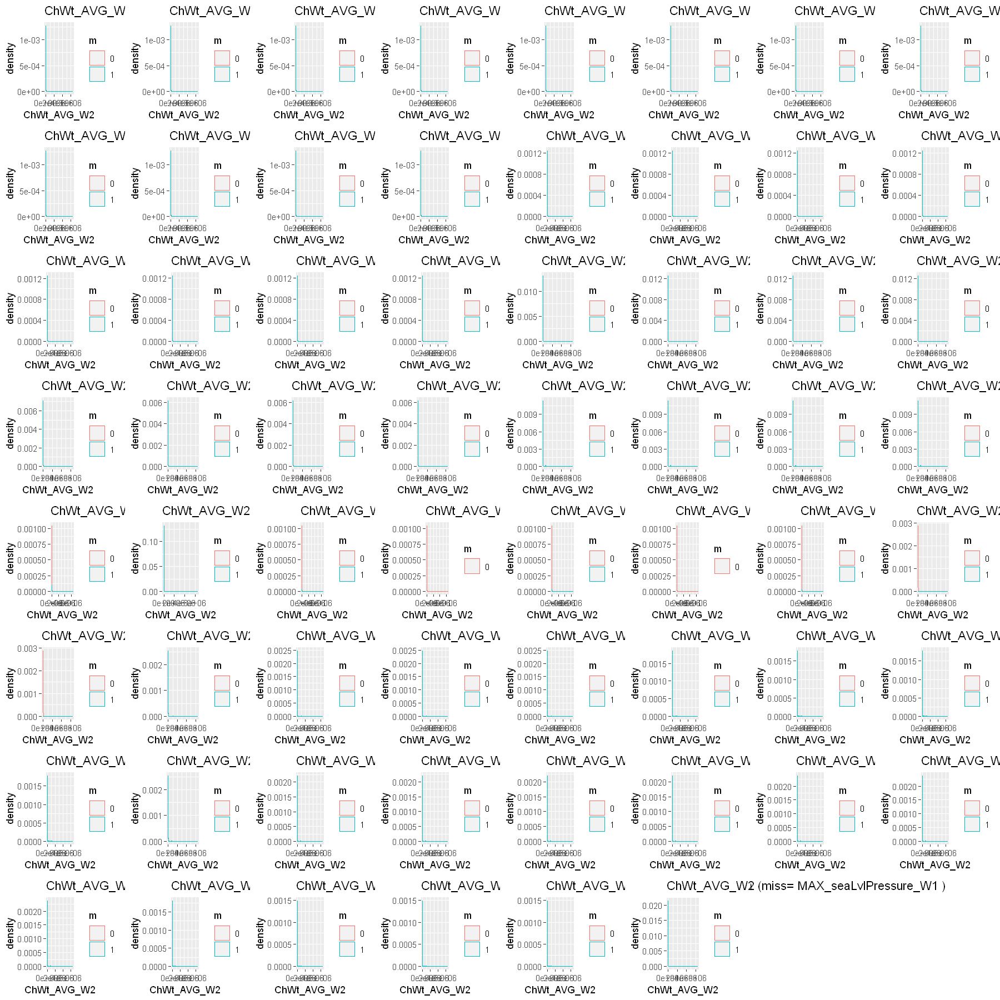

Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3012 rows containing non-finite values (stat_density)."
Warning message:

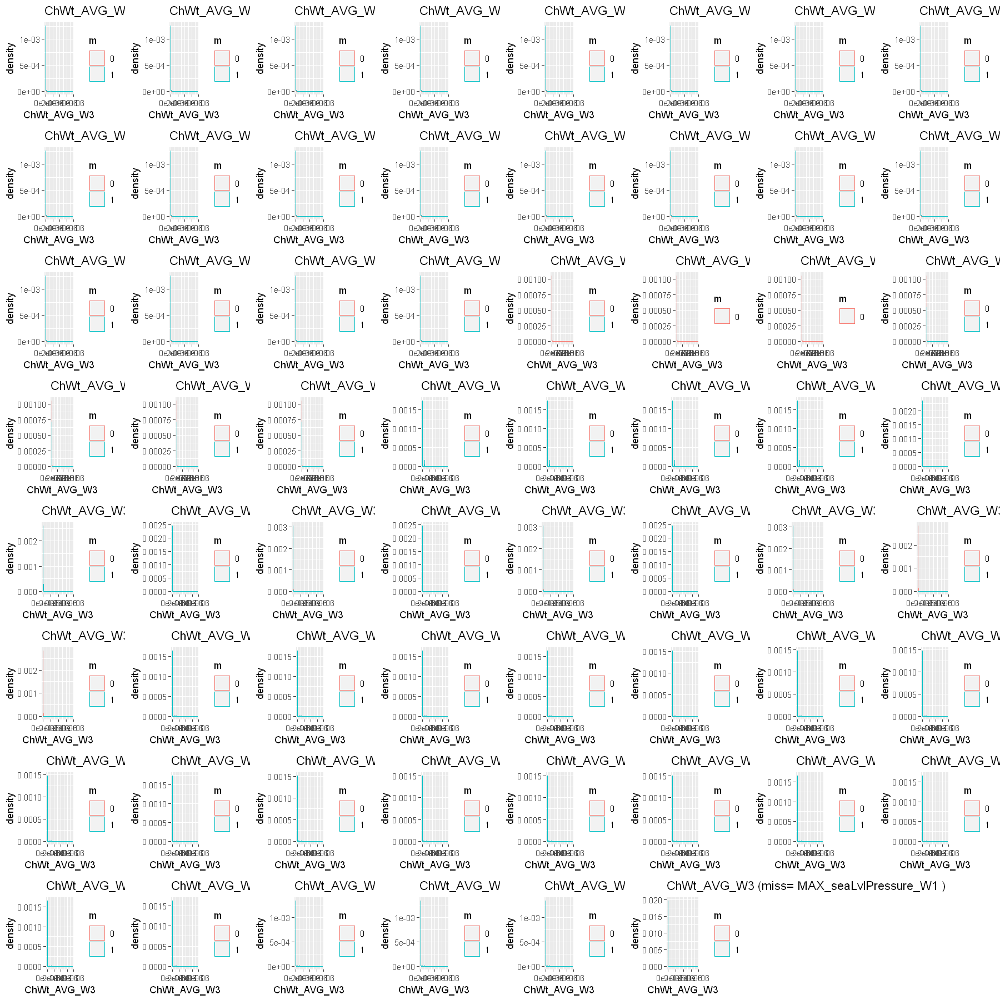

Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:

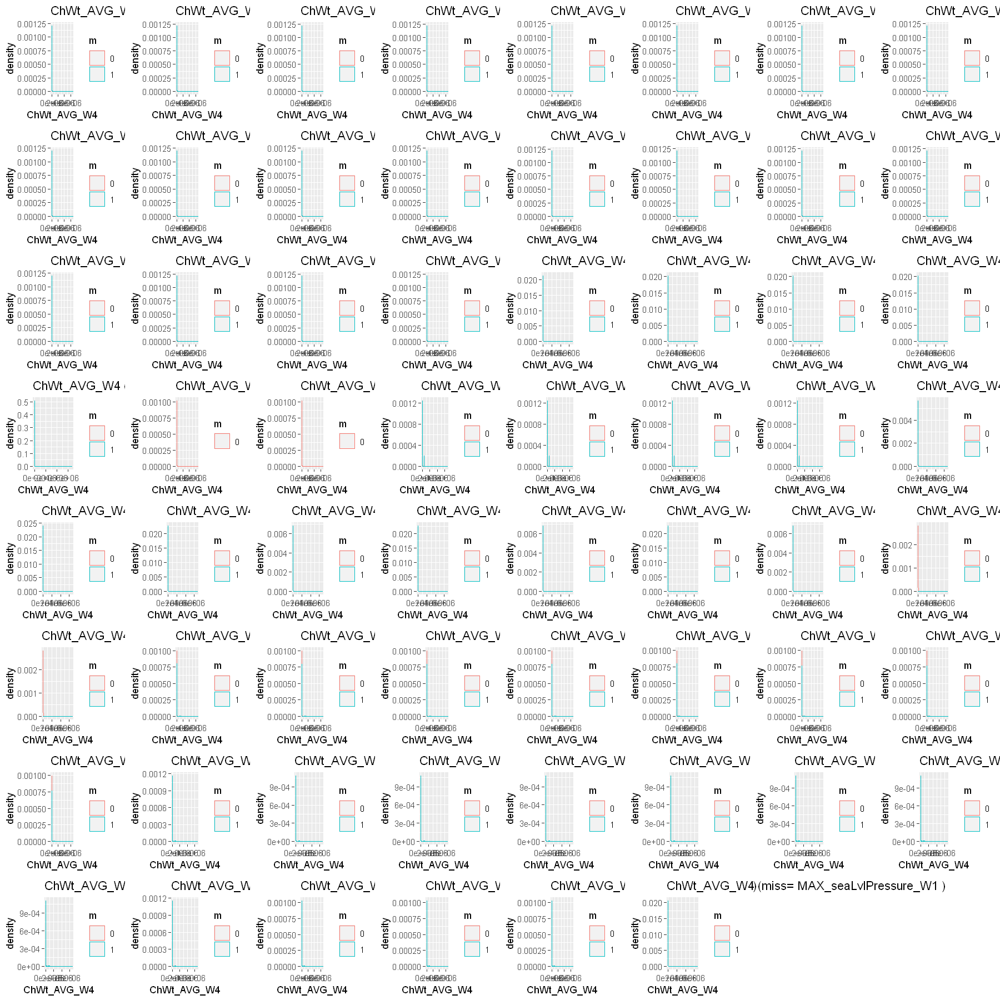

Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2989 rows containing non-finite values (stat_density)."
Warning message:

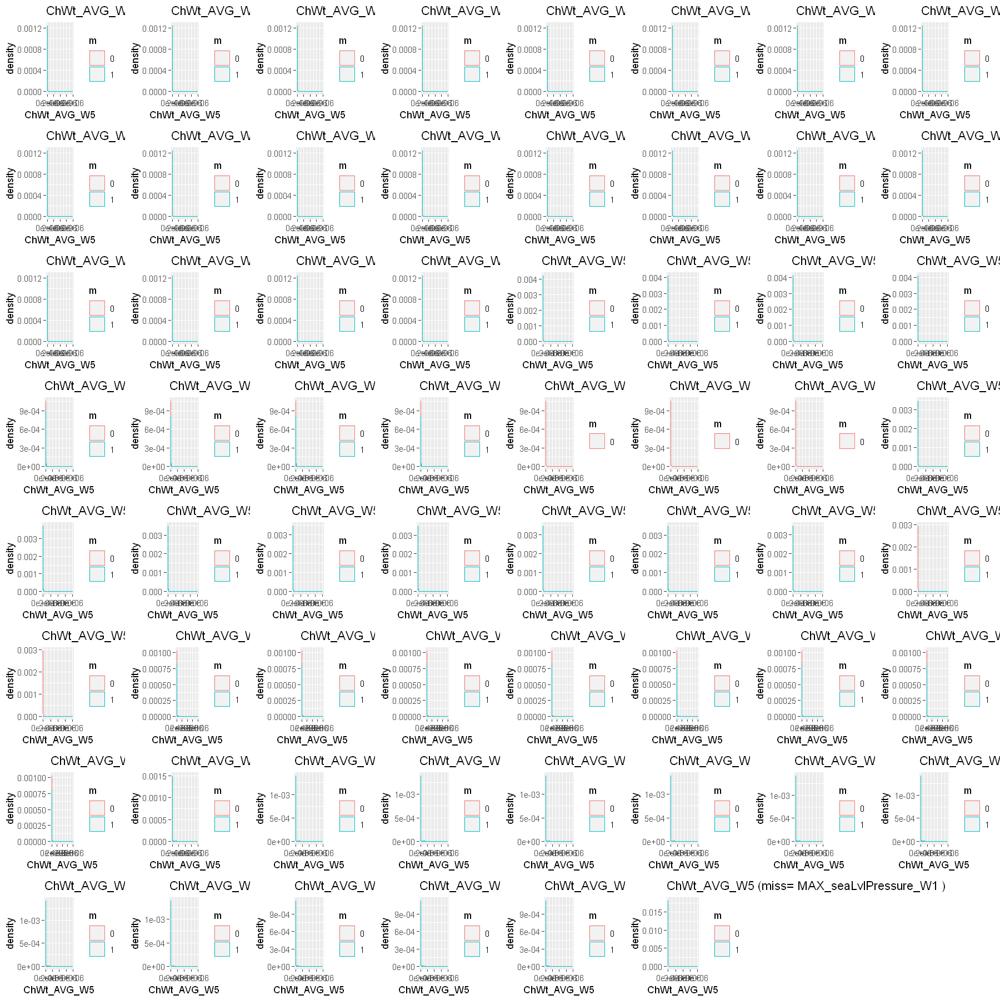

Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:
"Removed 2991 rows containing non-finite values (stat_density)."
Warning message:

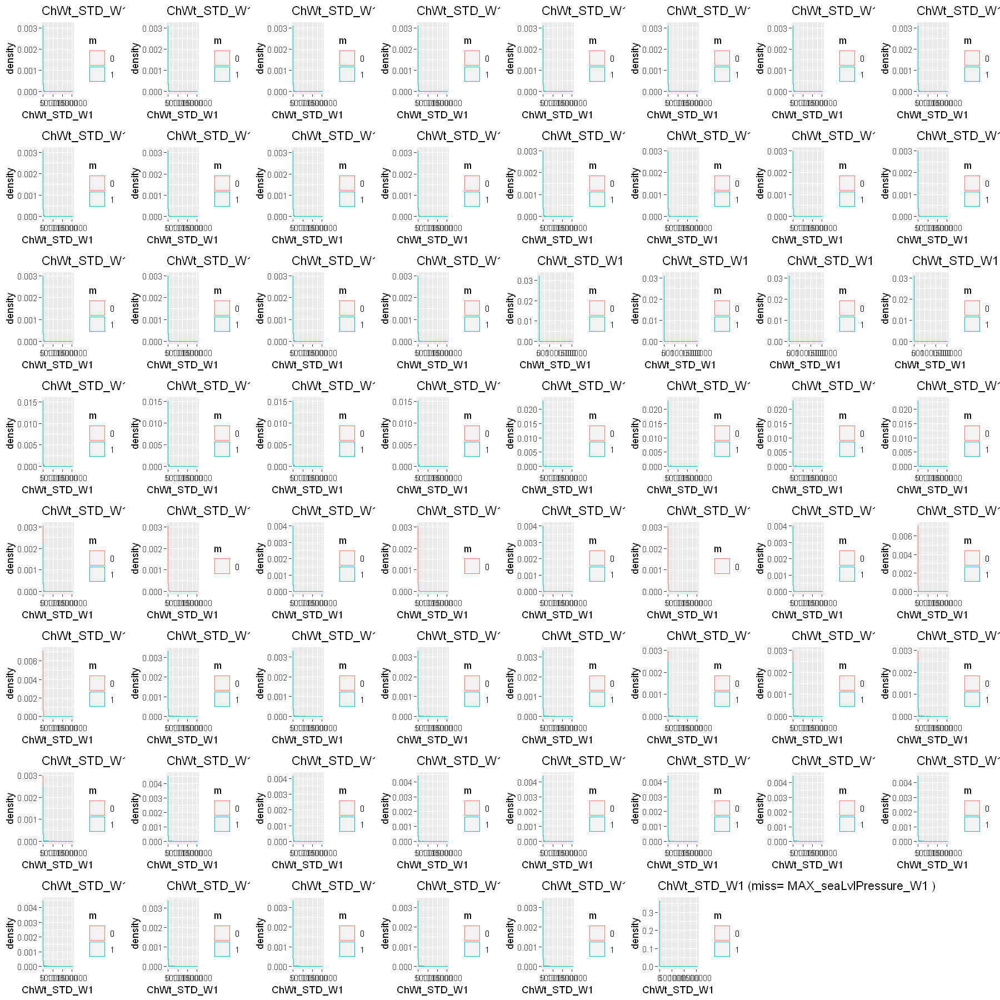

Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3021 rows containing non-finite values (stat_density)."
Warning message:

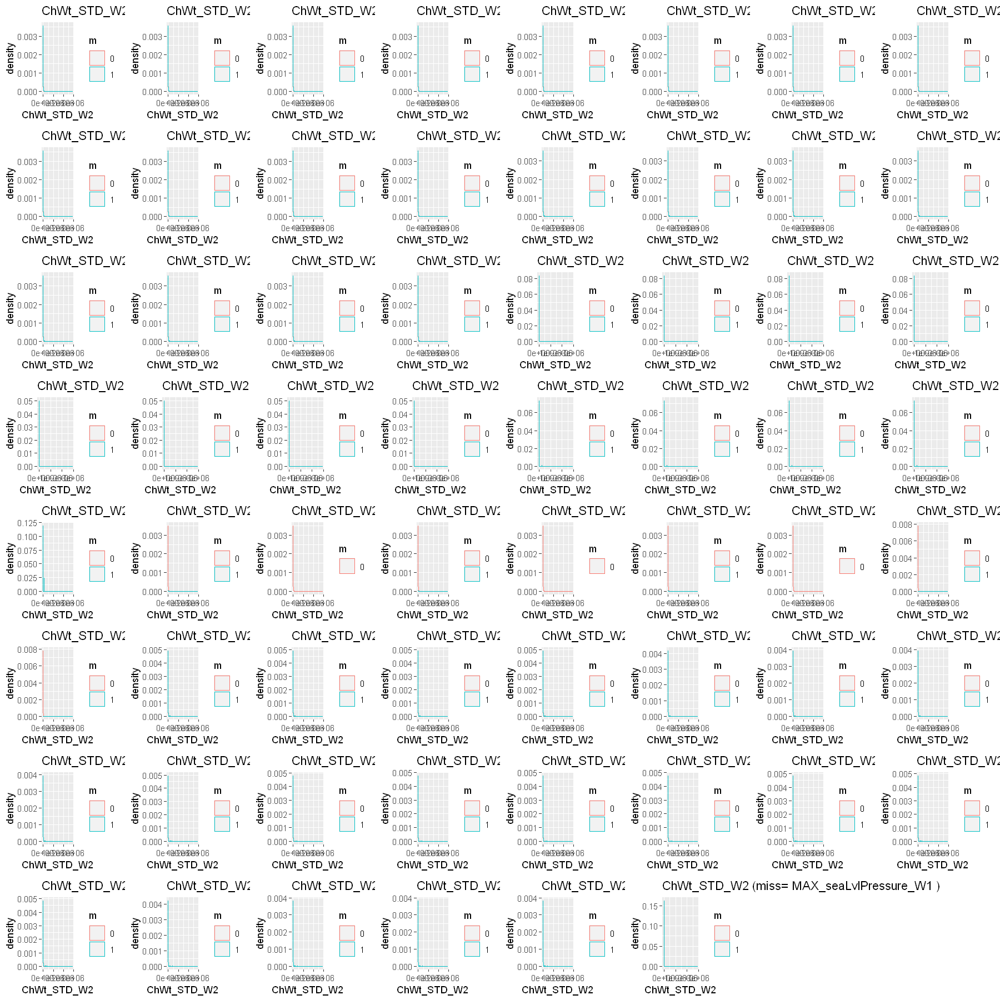

Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3014 rows containing non-finite values (stat_density)."
Warning message:

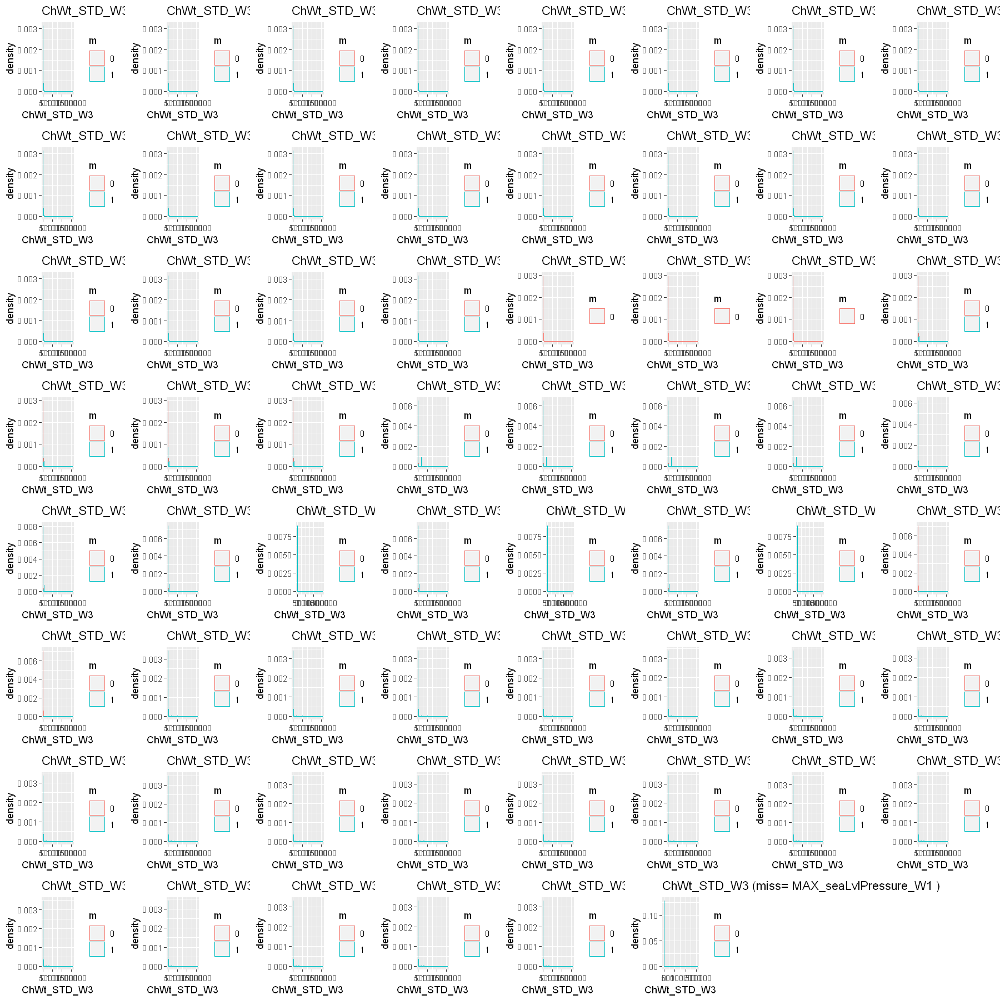

Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:
"Removed 3007 rows containing non-finite values (stat_density)."
Warning message:

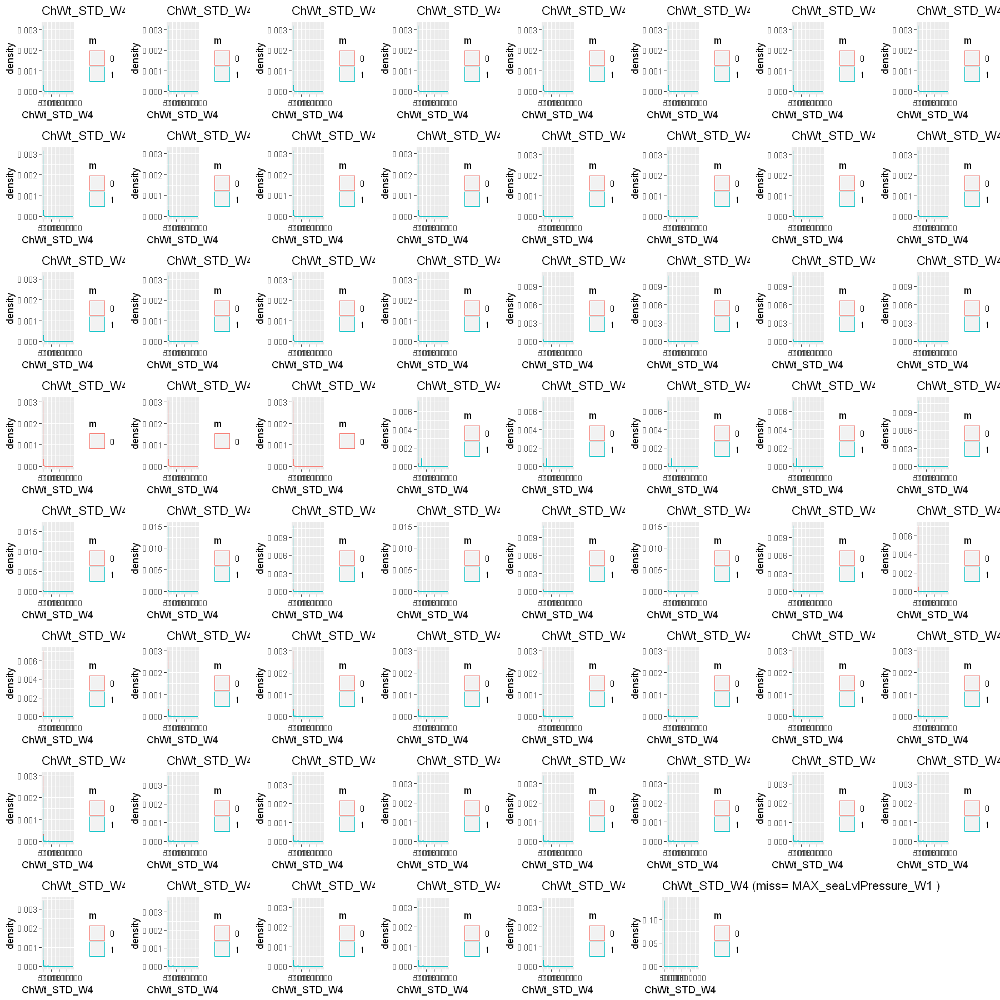

Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:

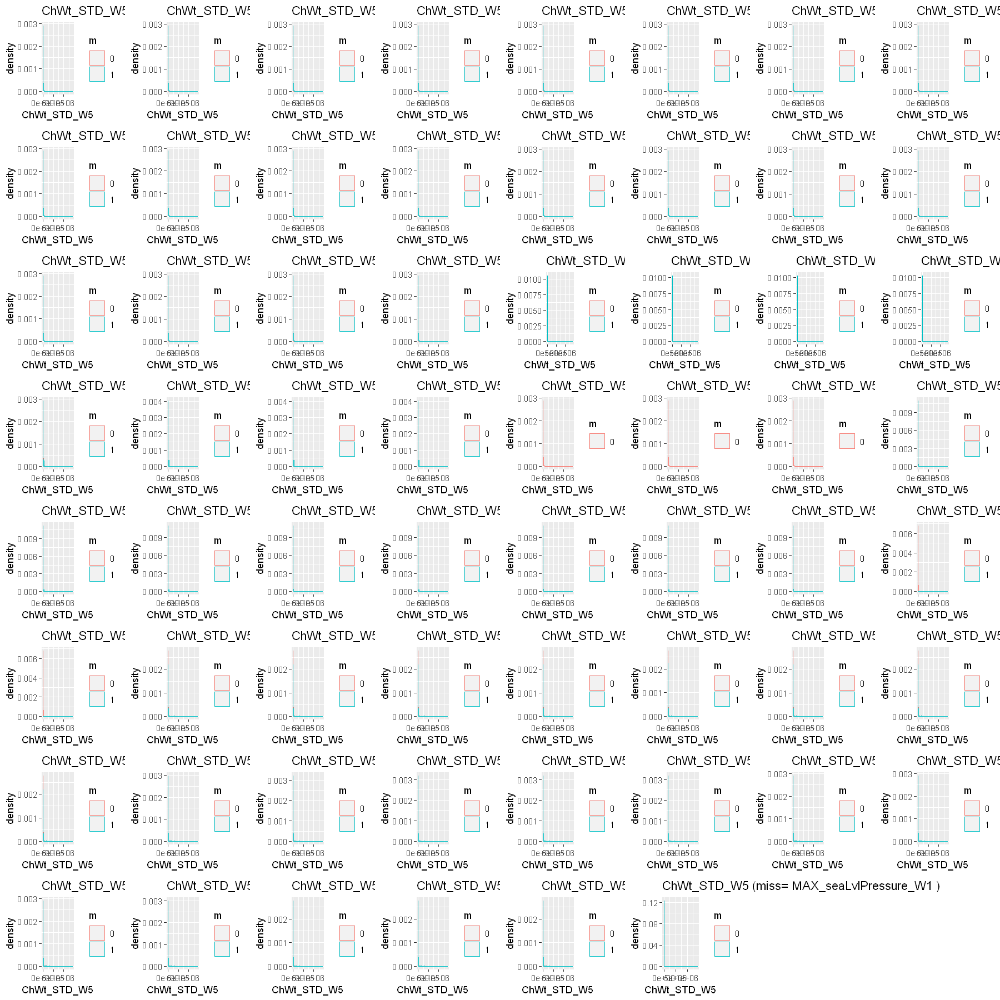

Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:

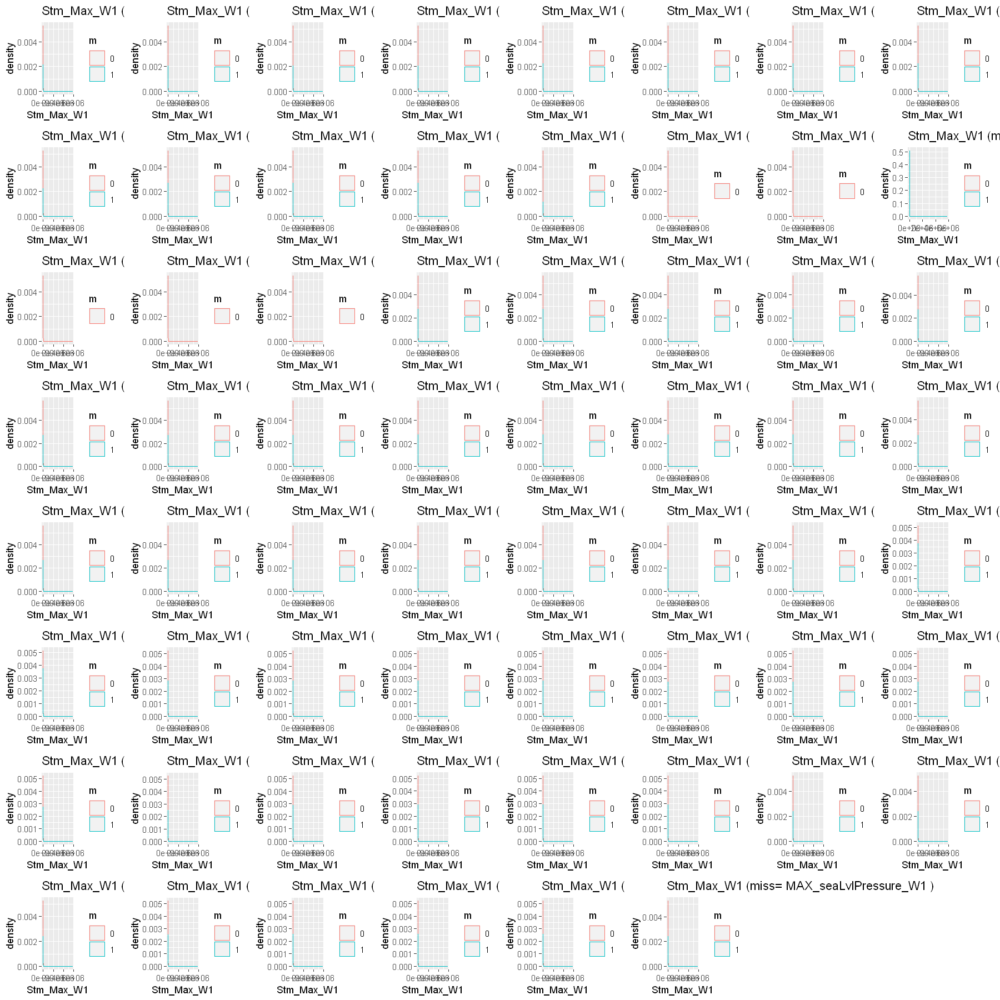

Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density).

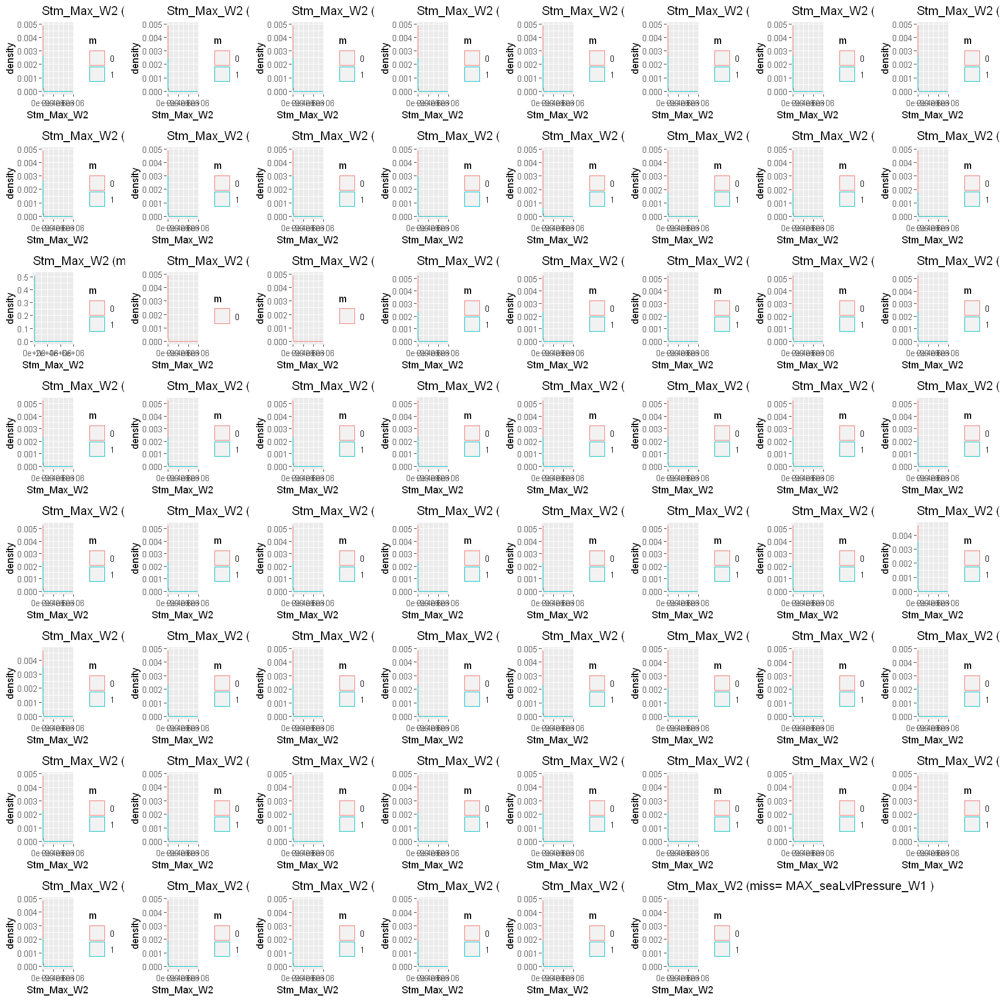

Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning me

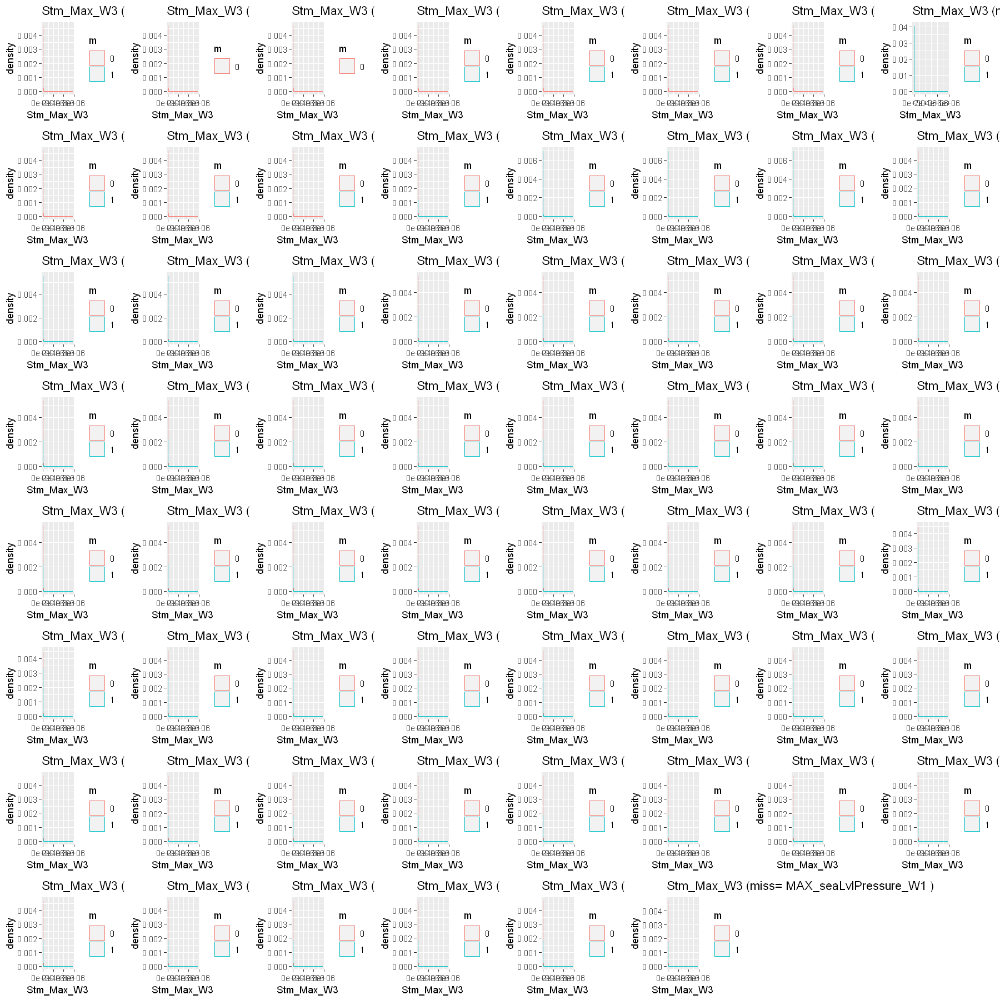

Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:

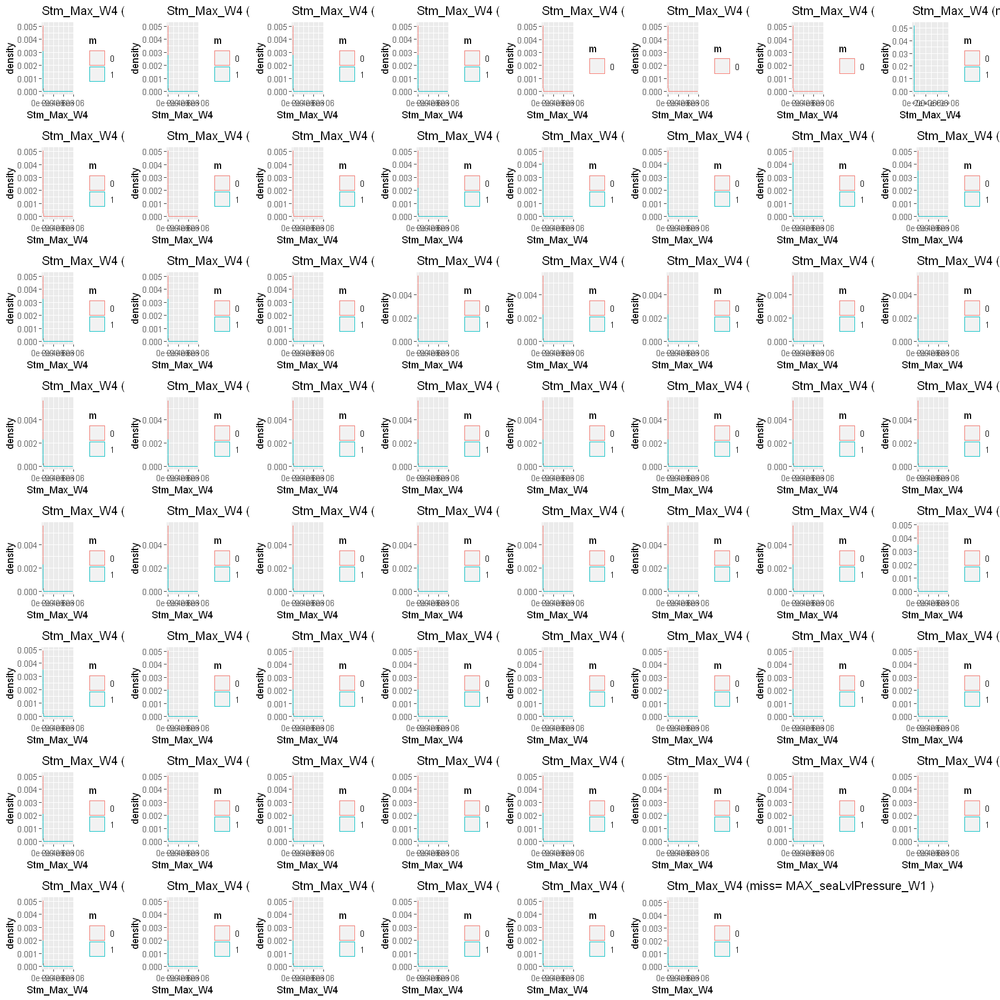

Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:

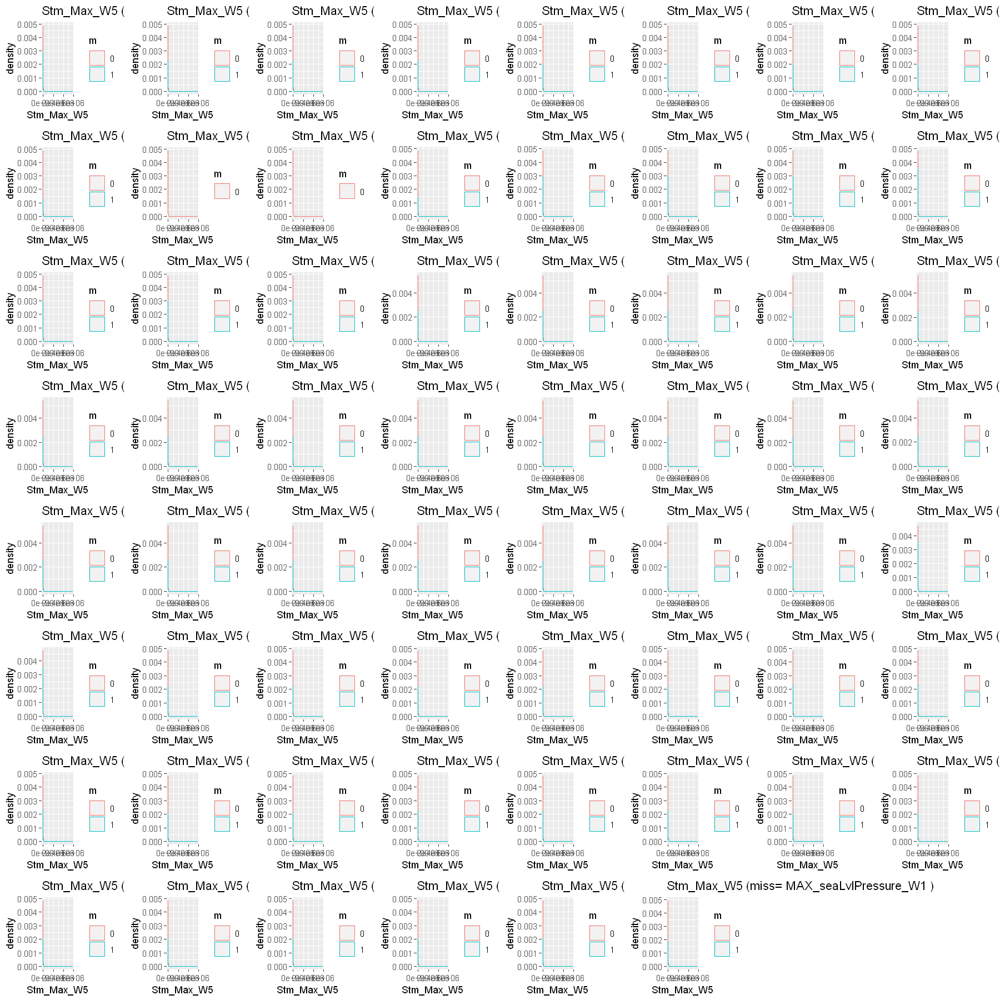

Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:

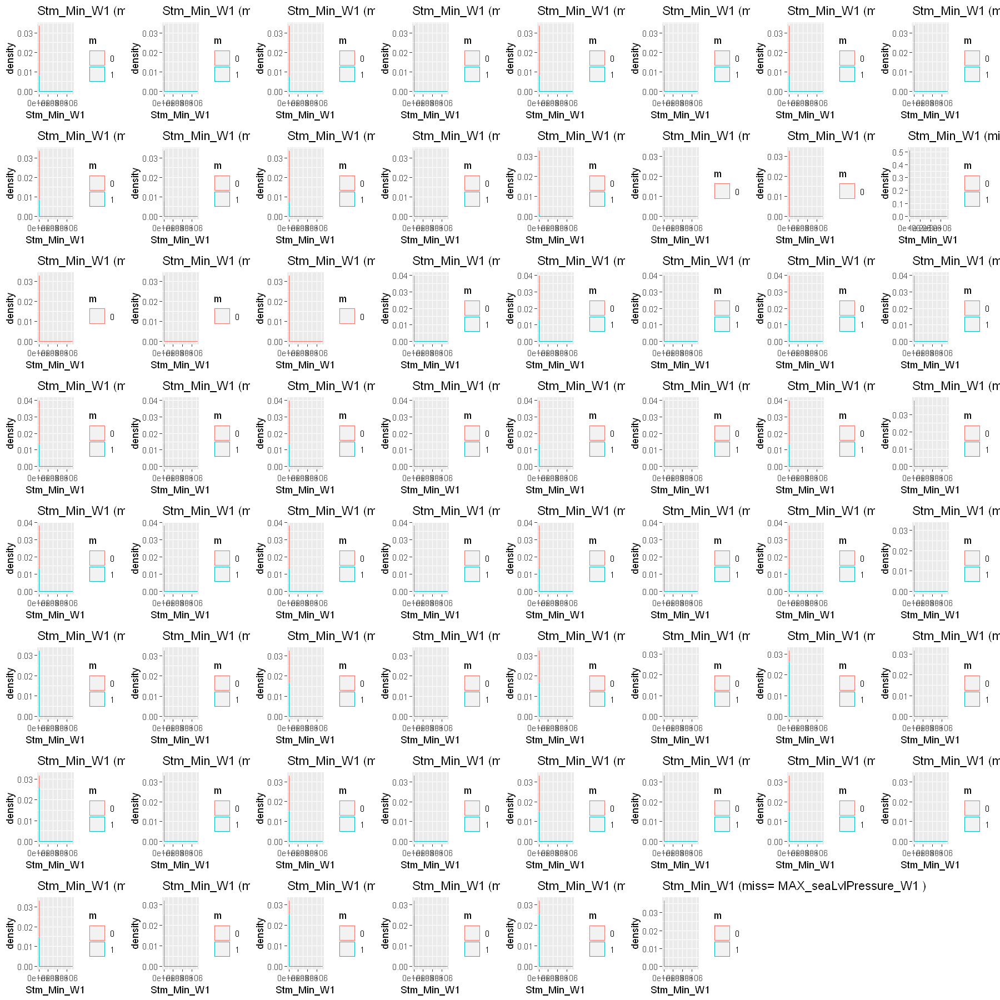

Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density).

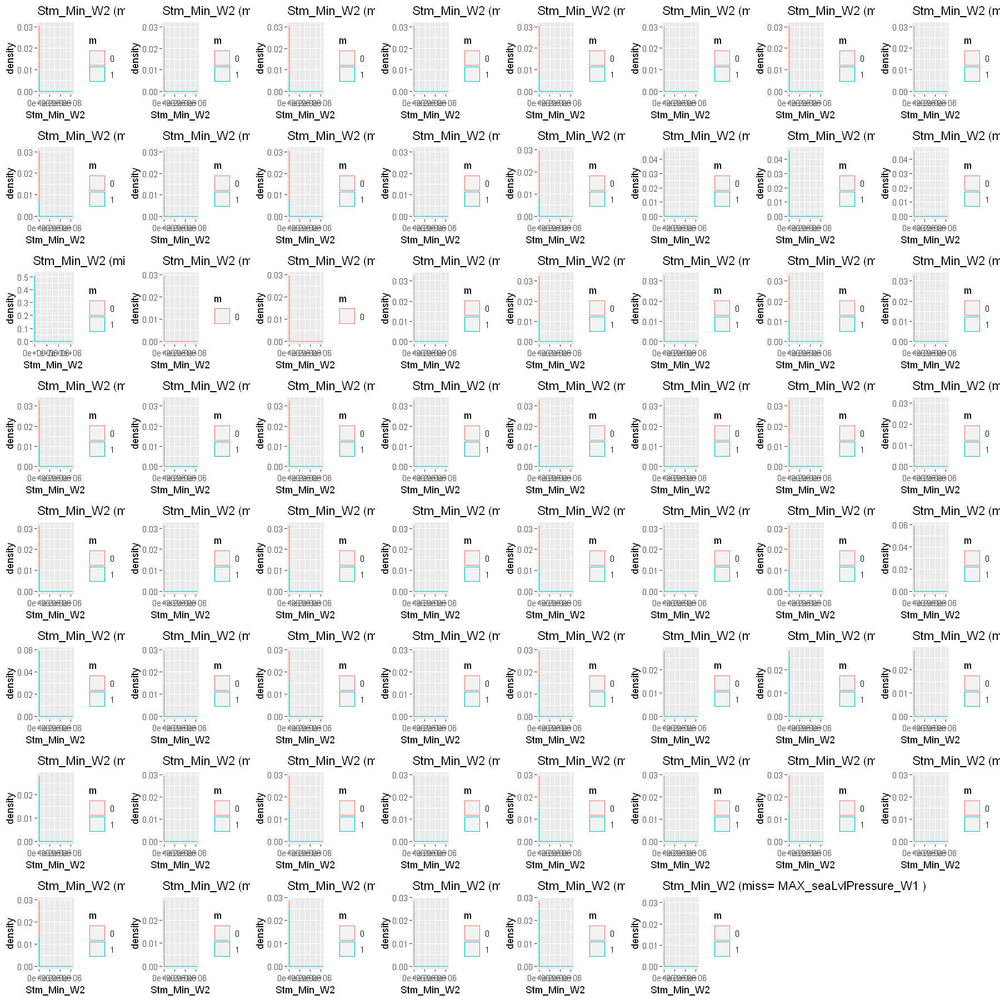

Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning me

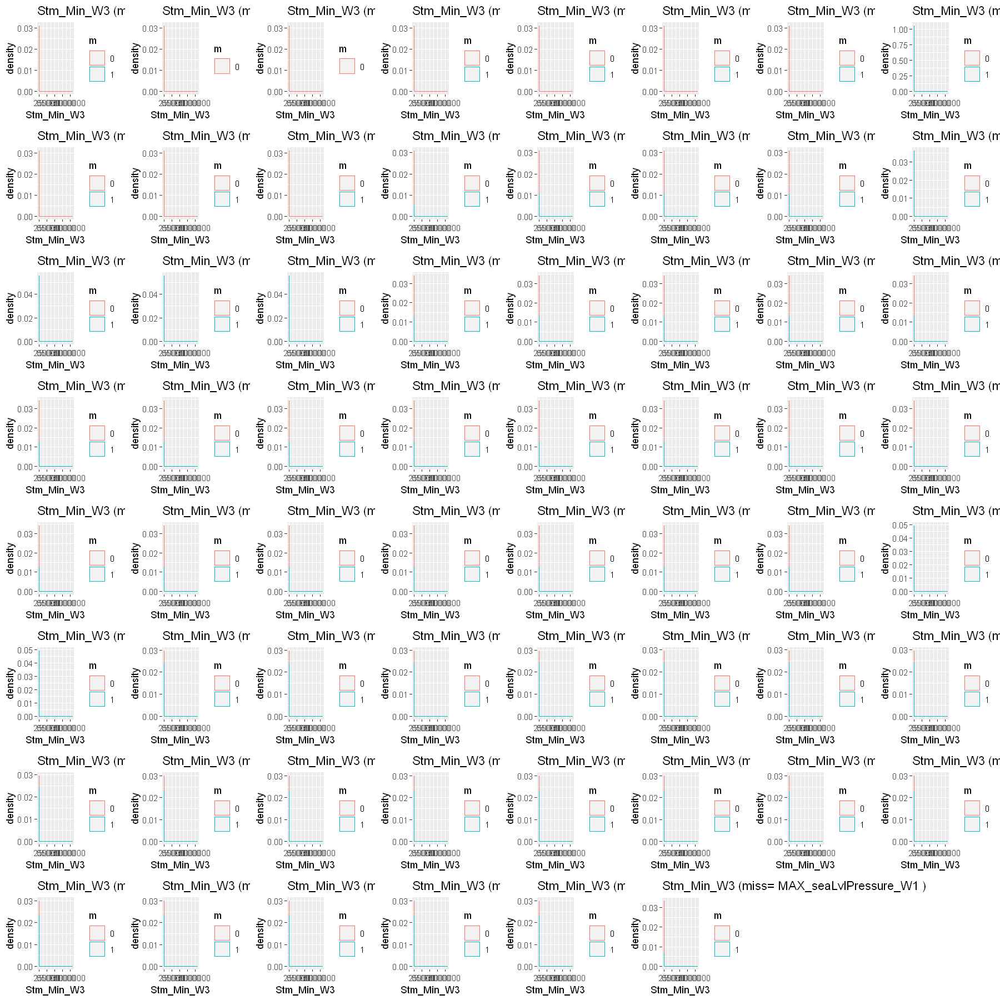

Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:

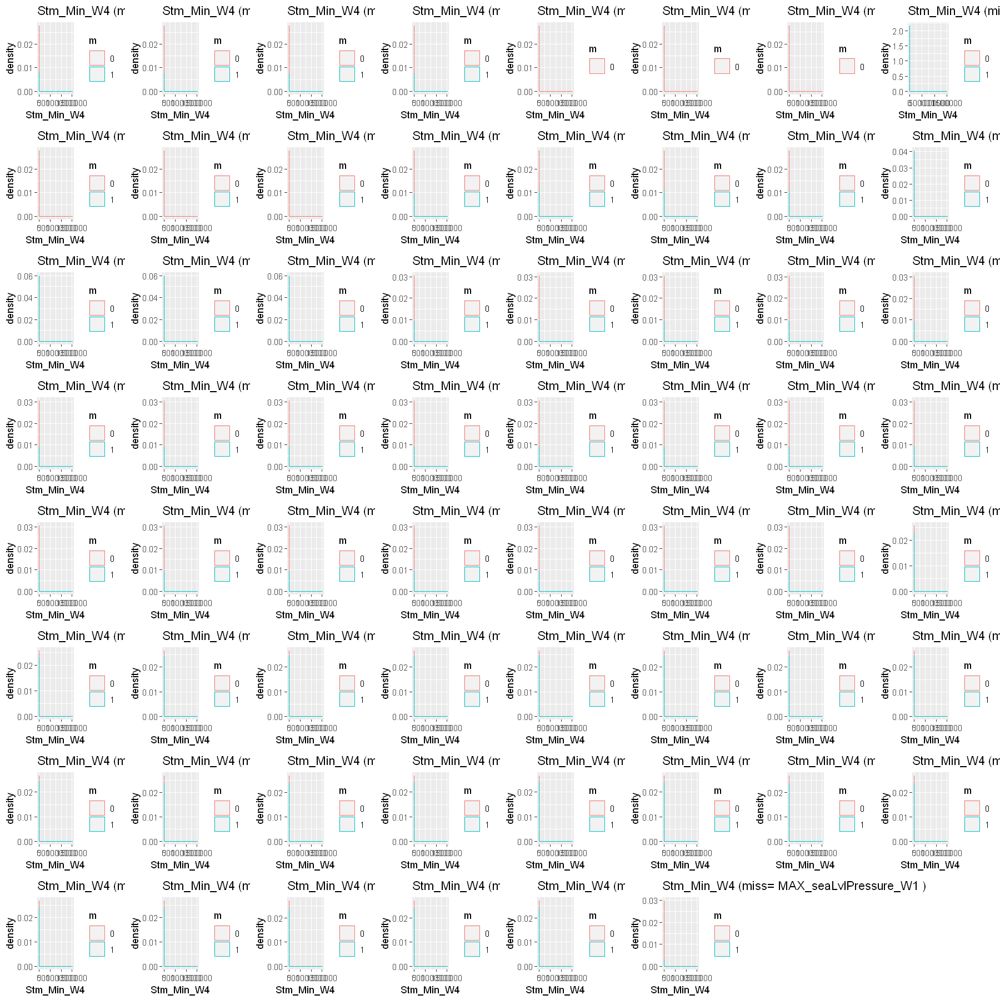

Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:

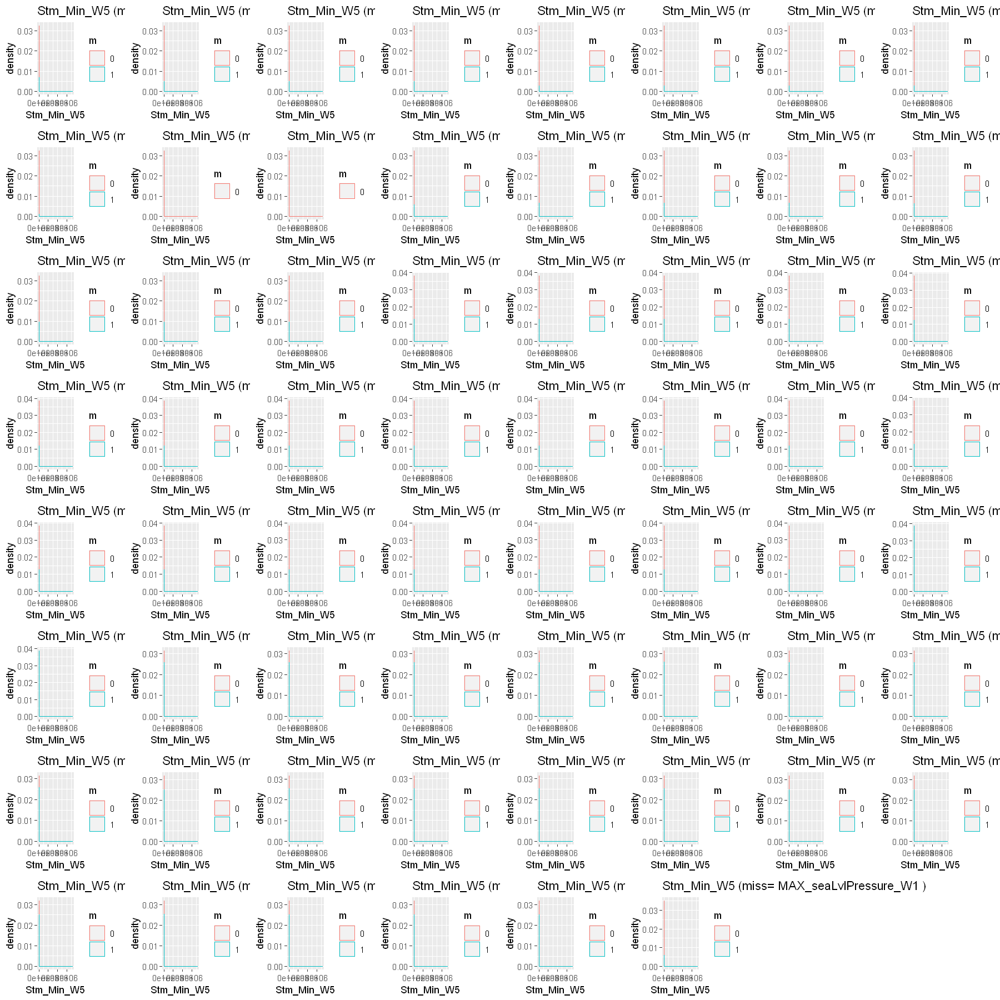

Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5185 rows containing non-finite values (stat_density)."
Warning message:

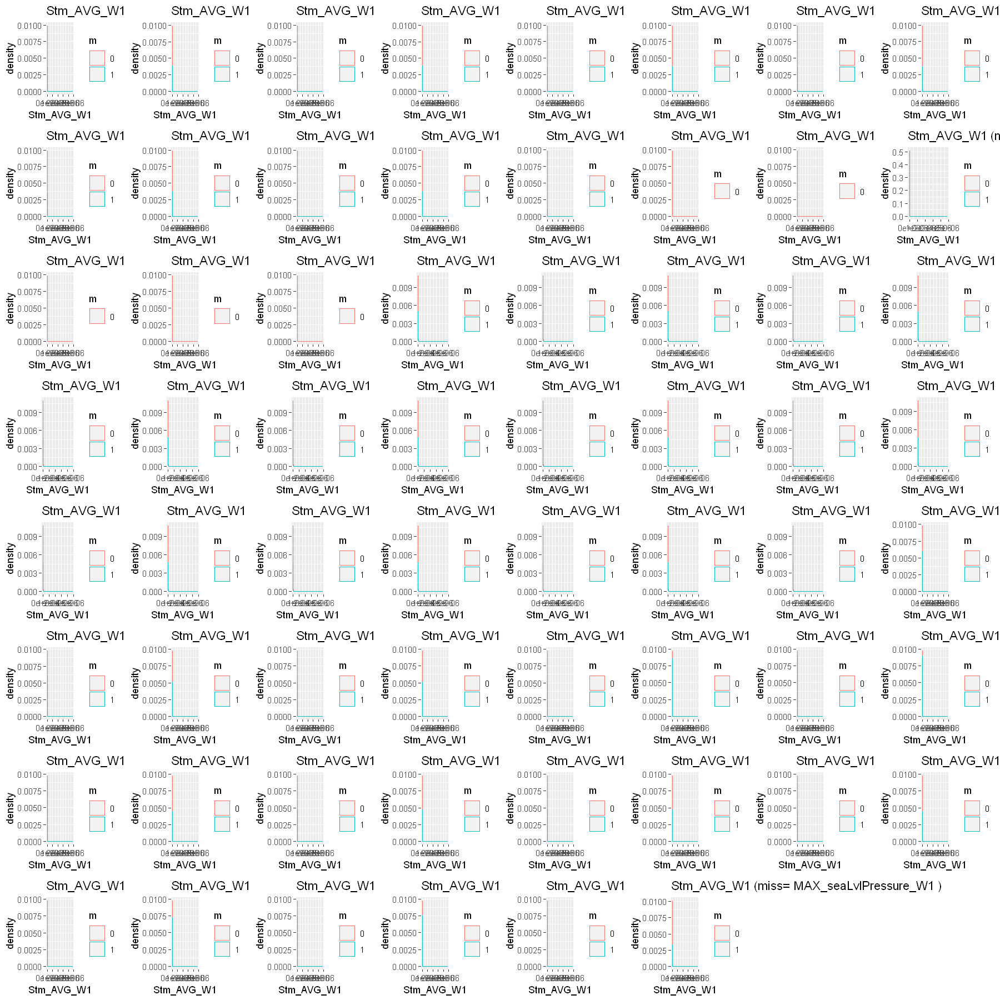

Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5216 rows containing non-finite values (stat_density).

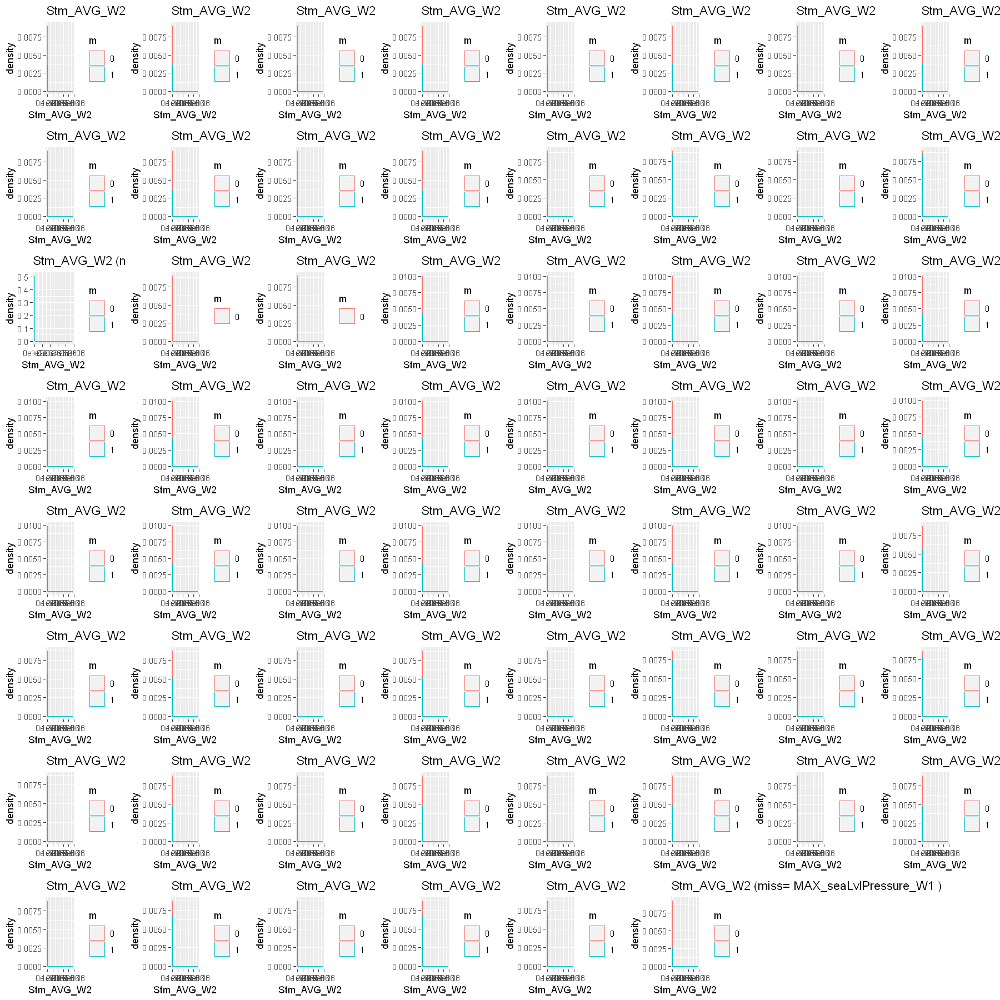

Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning me

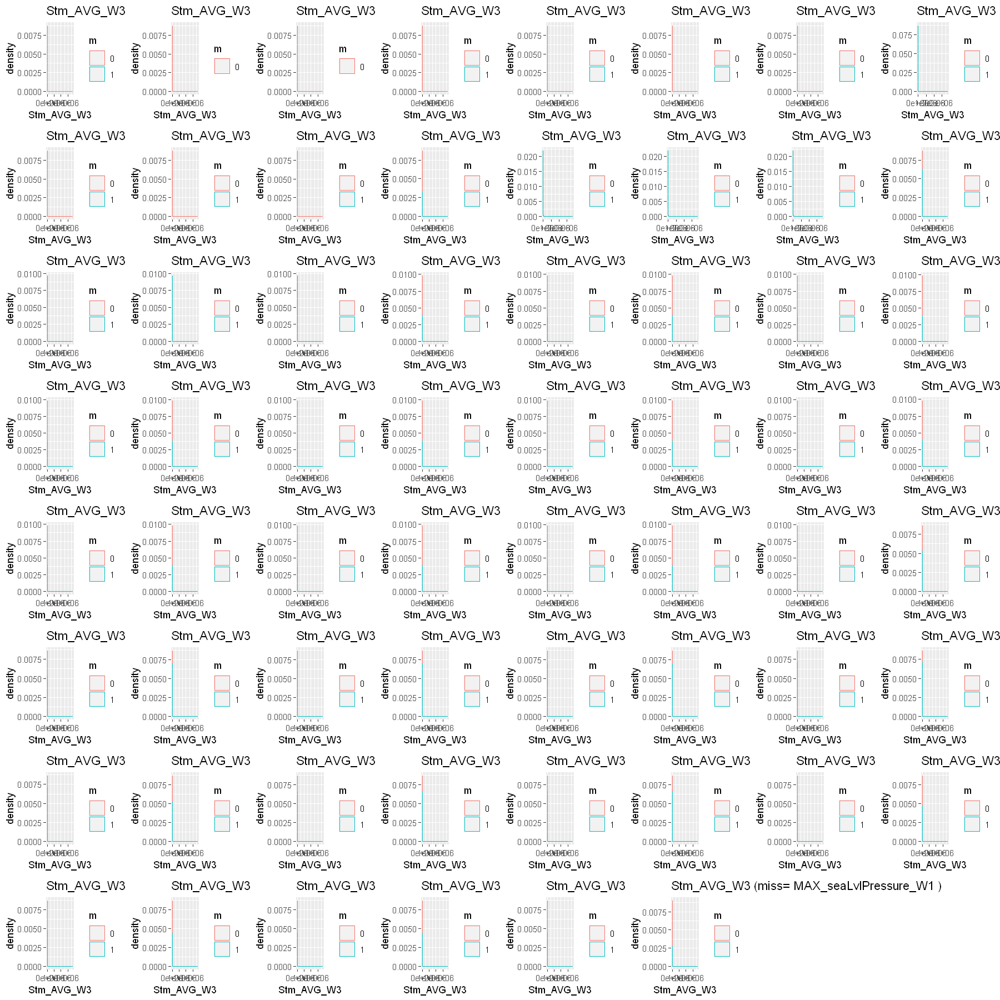

Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5212 rows containing non-finite values (stat_density)."
Warning message:

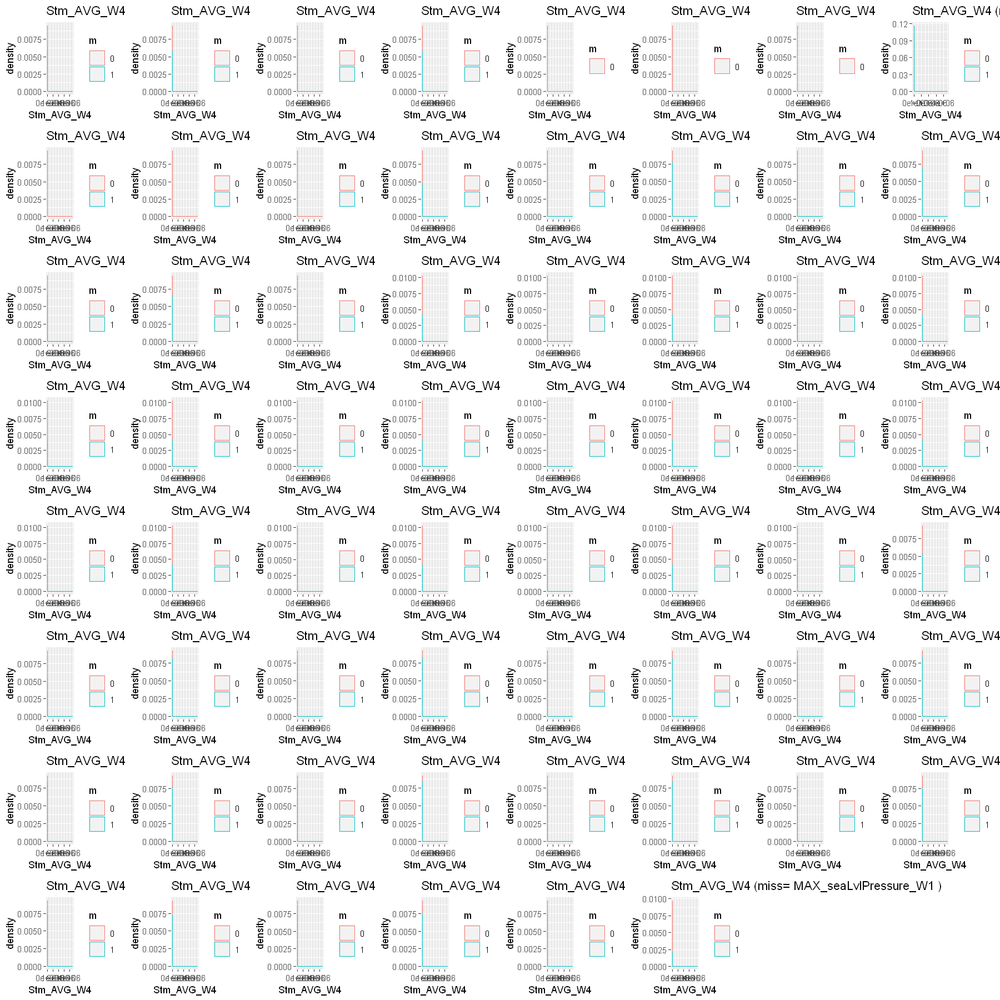

Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5189 rows containing non-finite values (stat_density)."
Warning message:

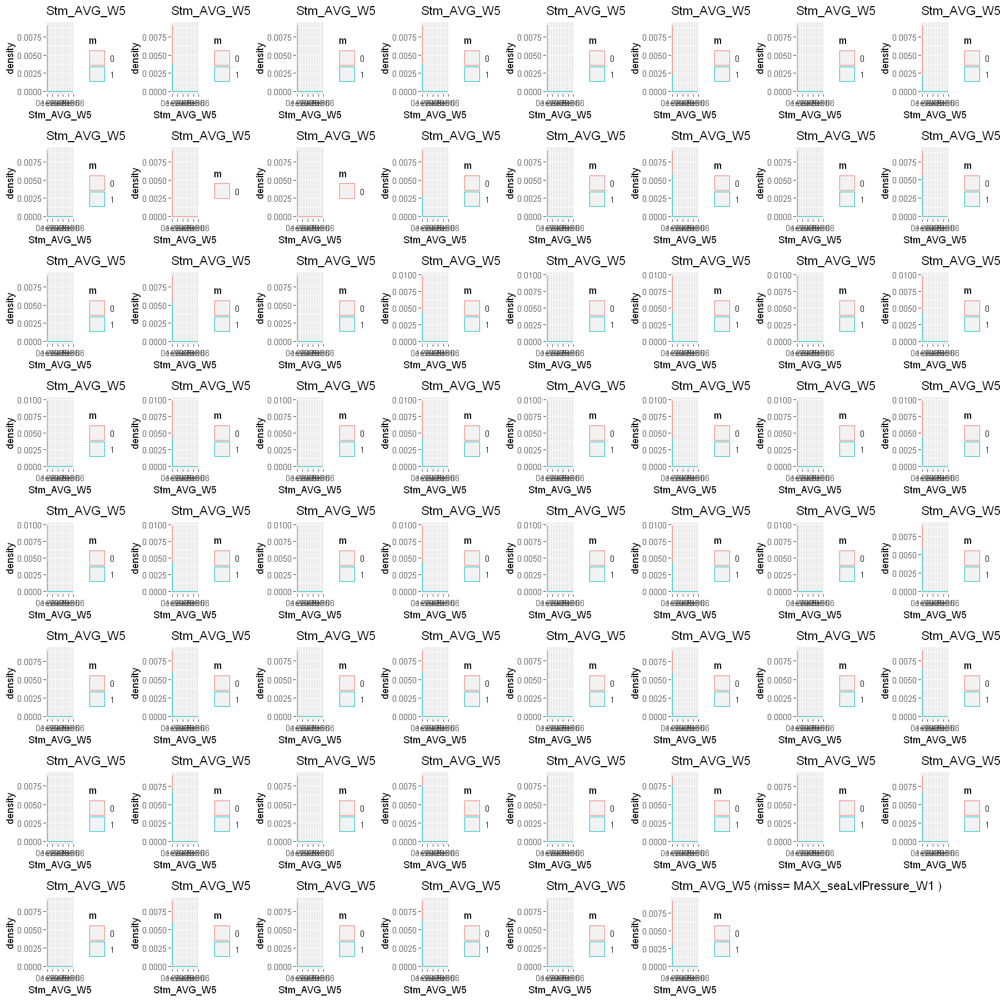

Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5187 rows containing non-finite values (stat_density)."
Warning message:

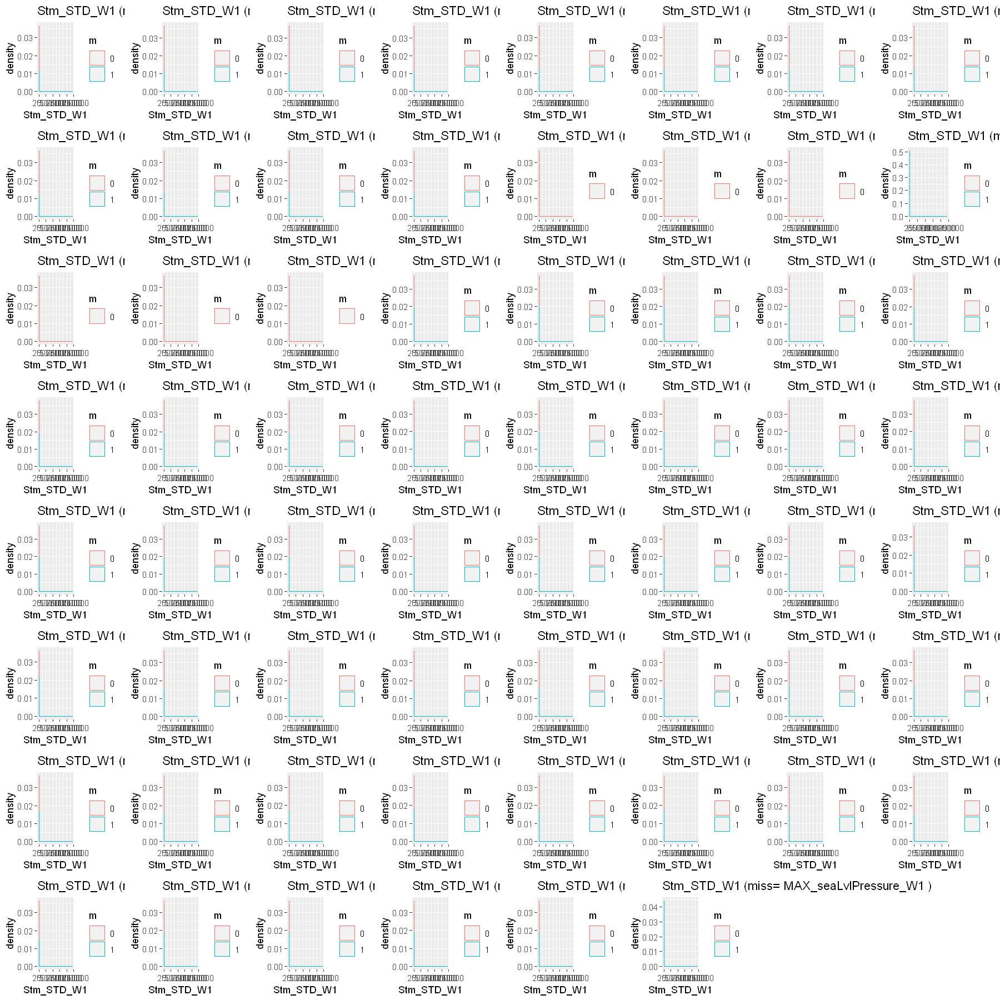

Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5217 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf

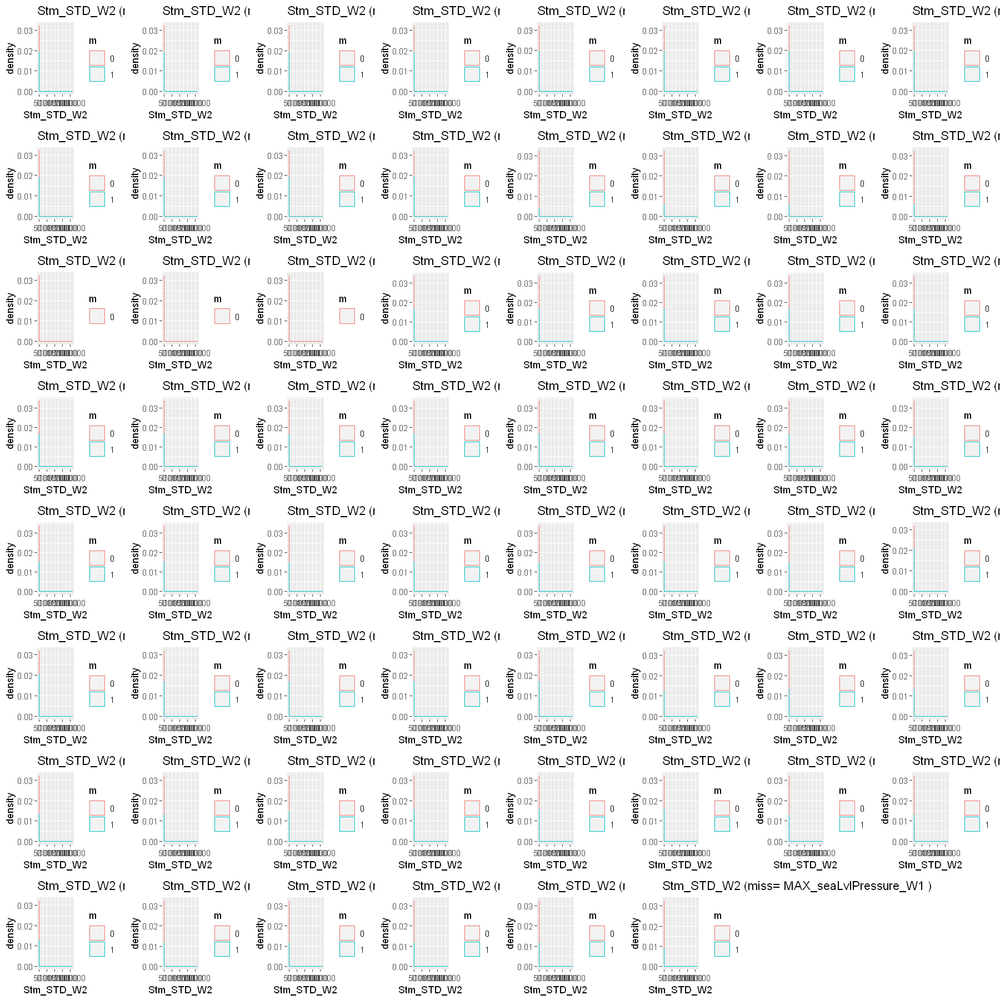

Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning me

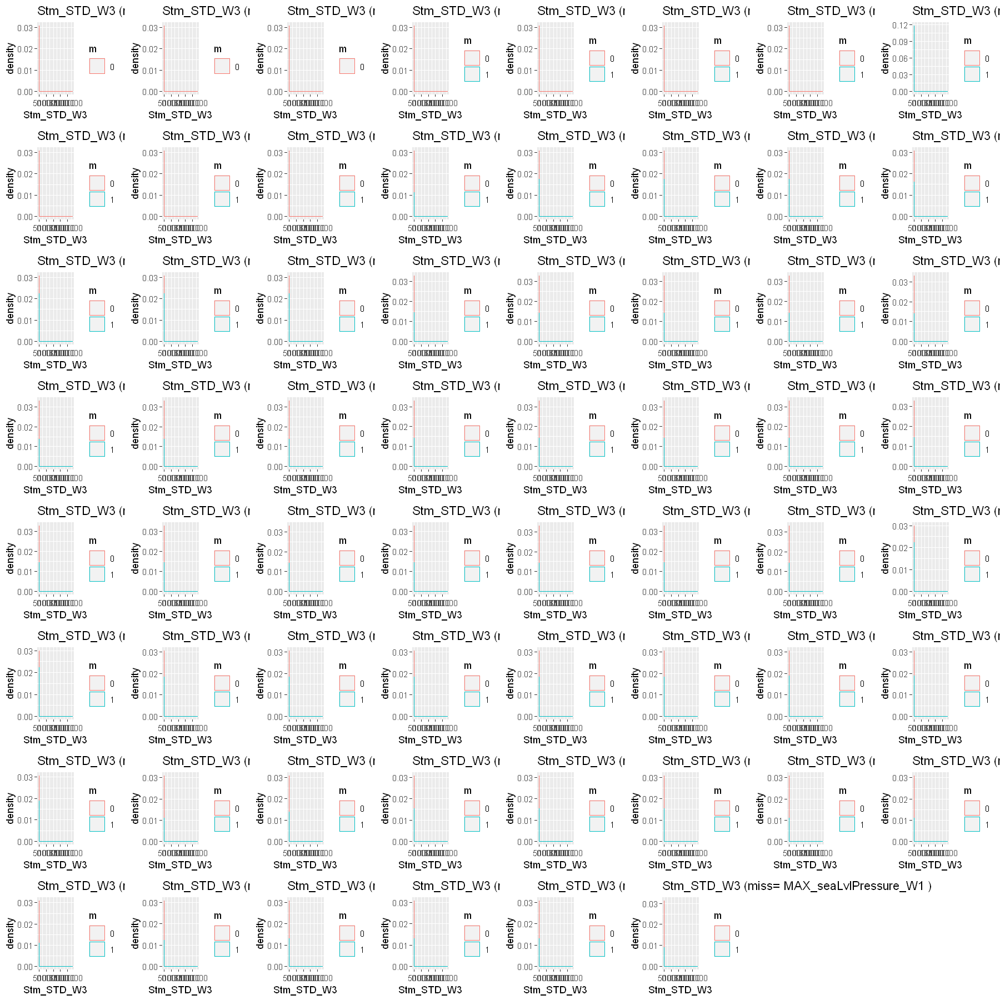

Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:
"Removed 5215 rows containing non-finite values (stat_density)."
Warning message:

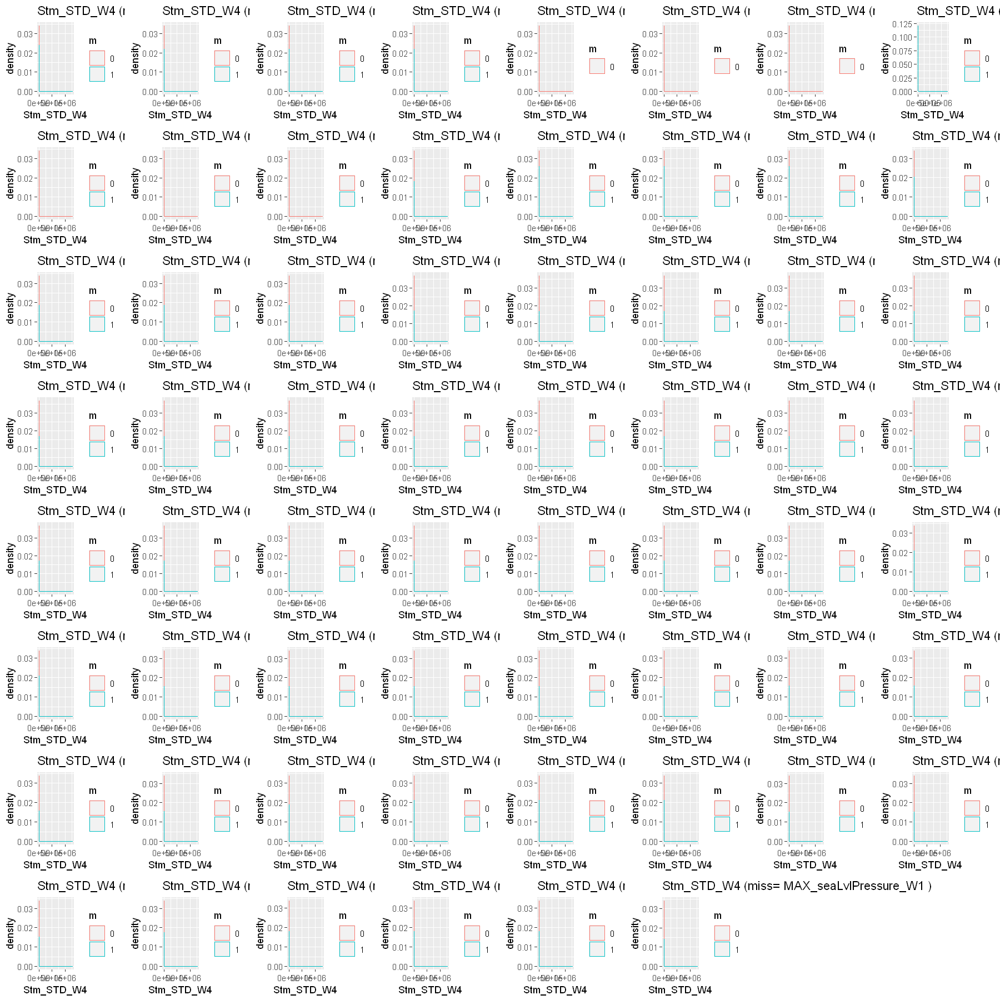

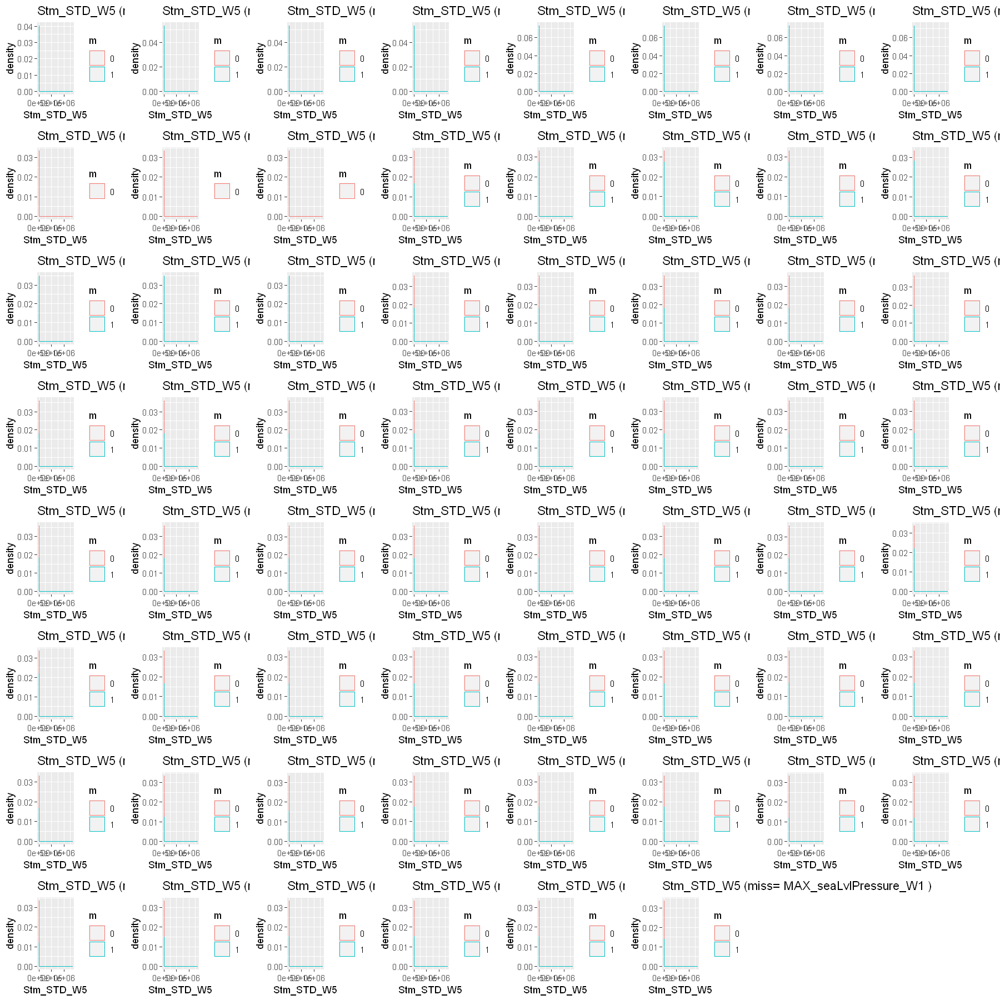

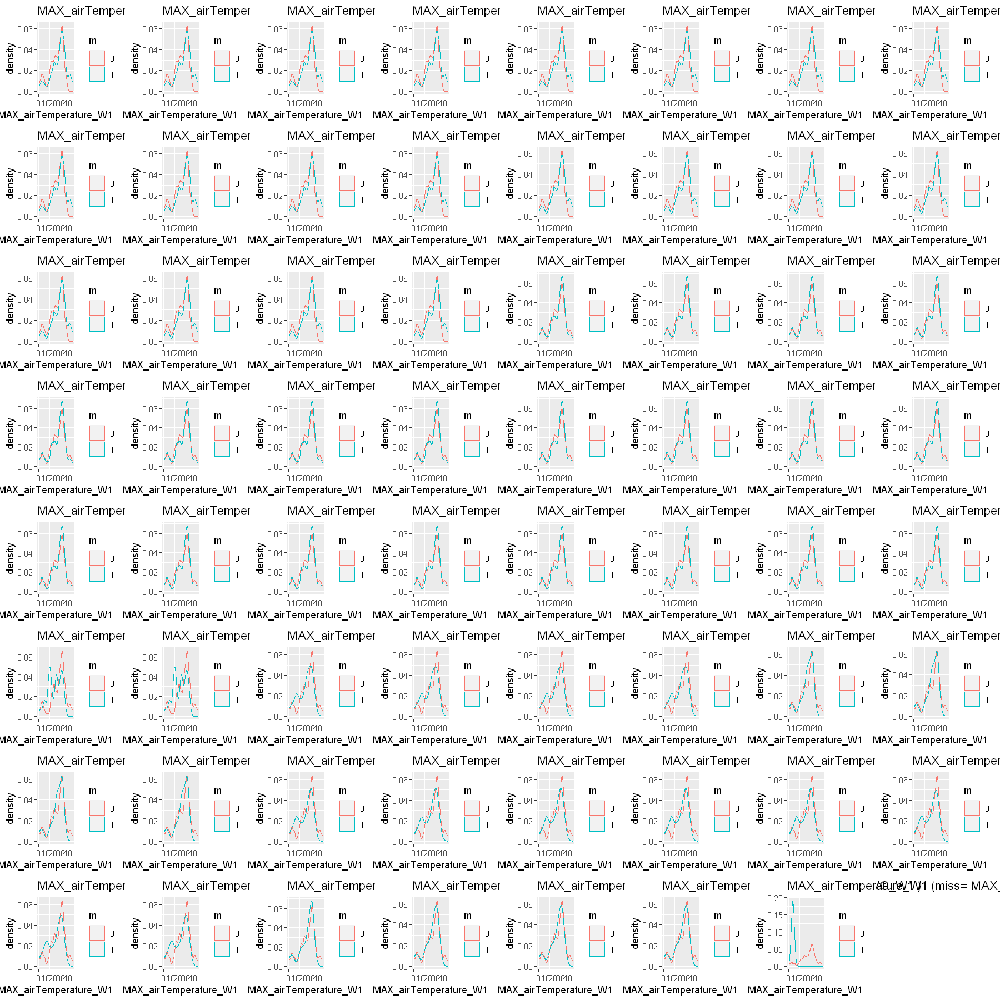

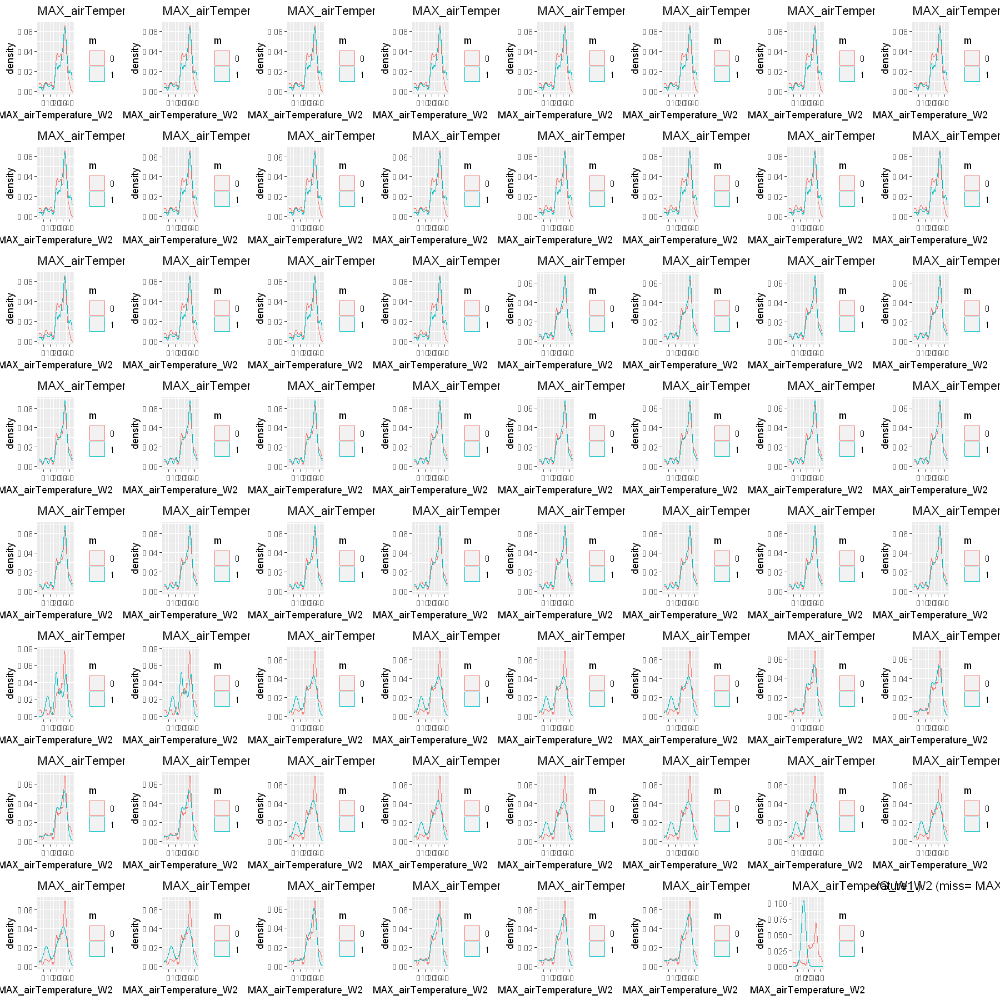

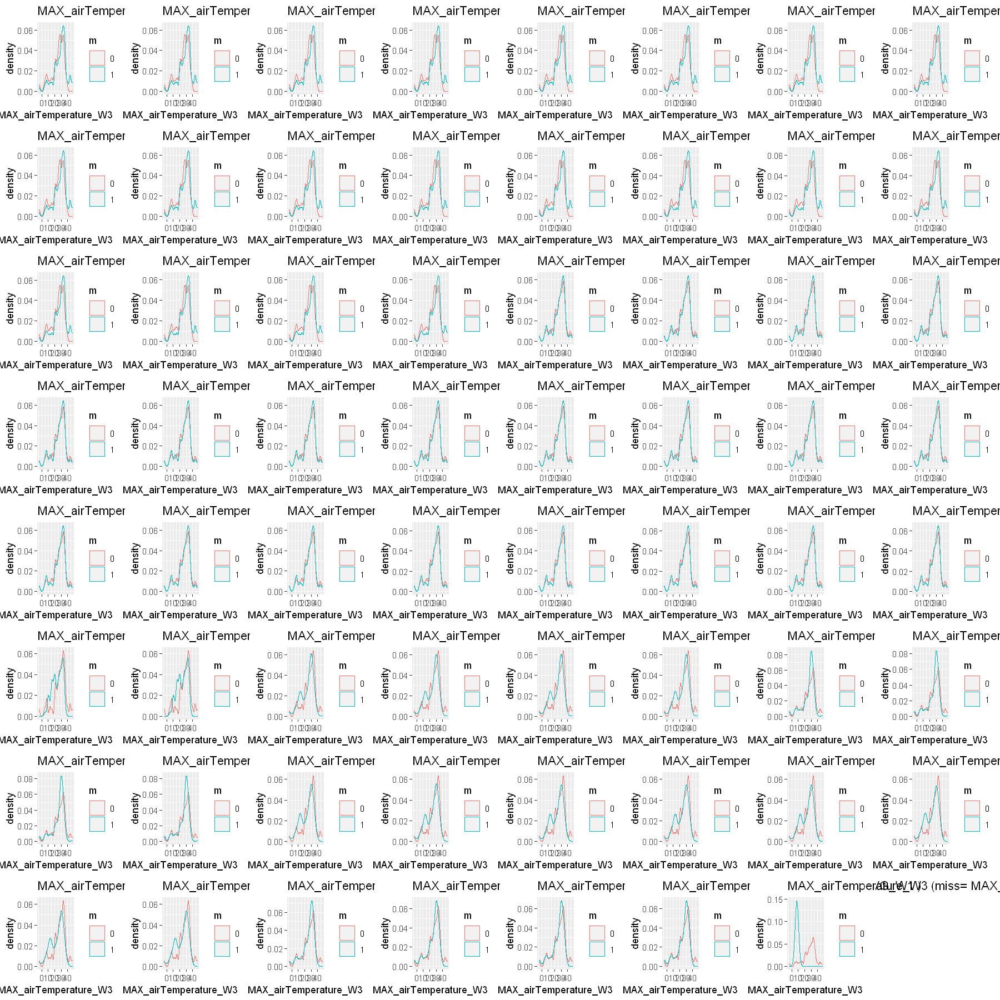

...

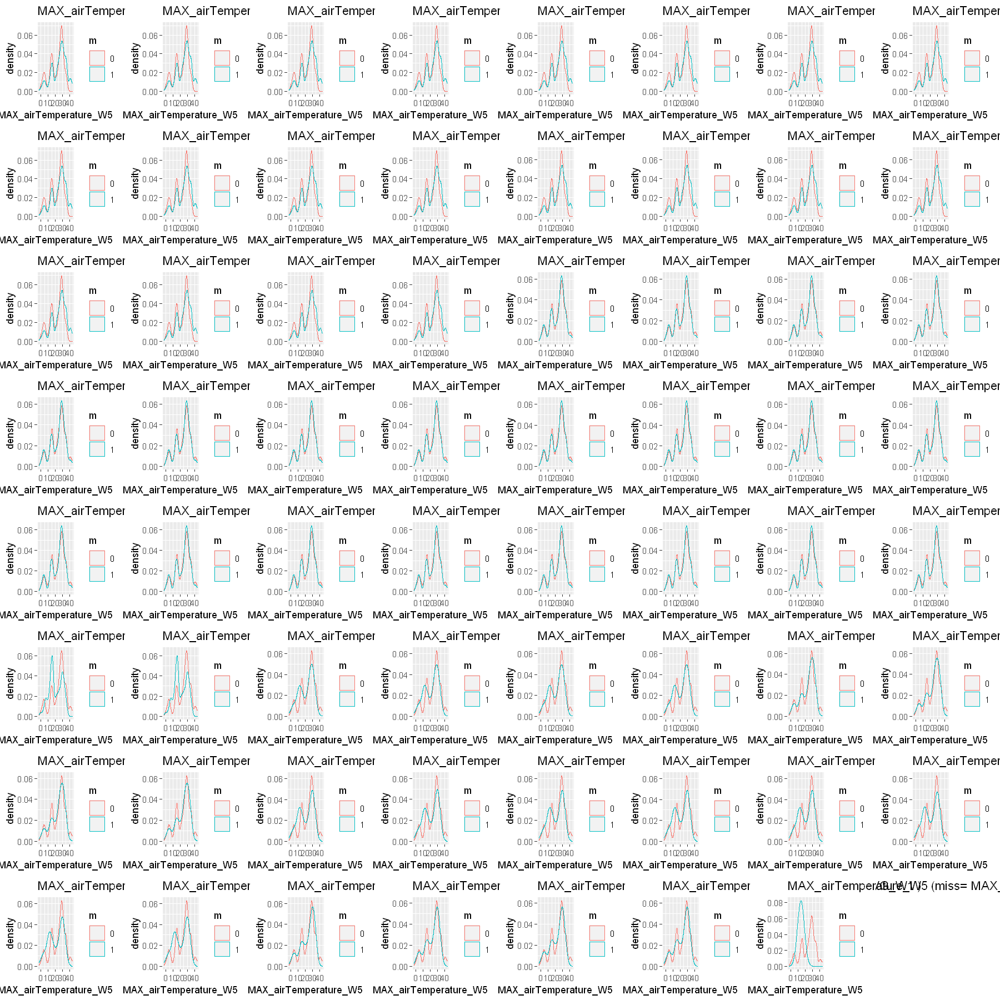

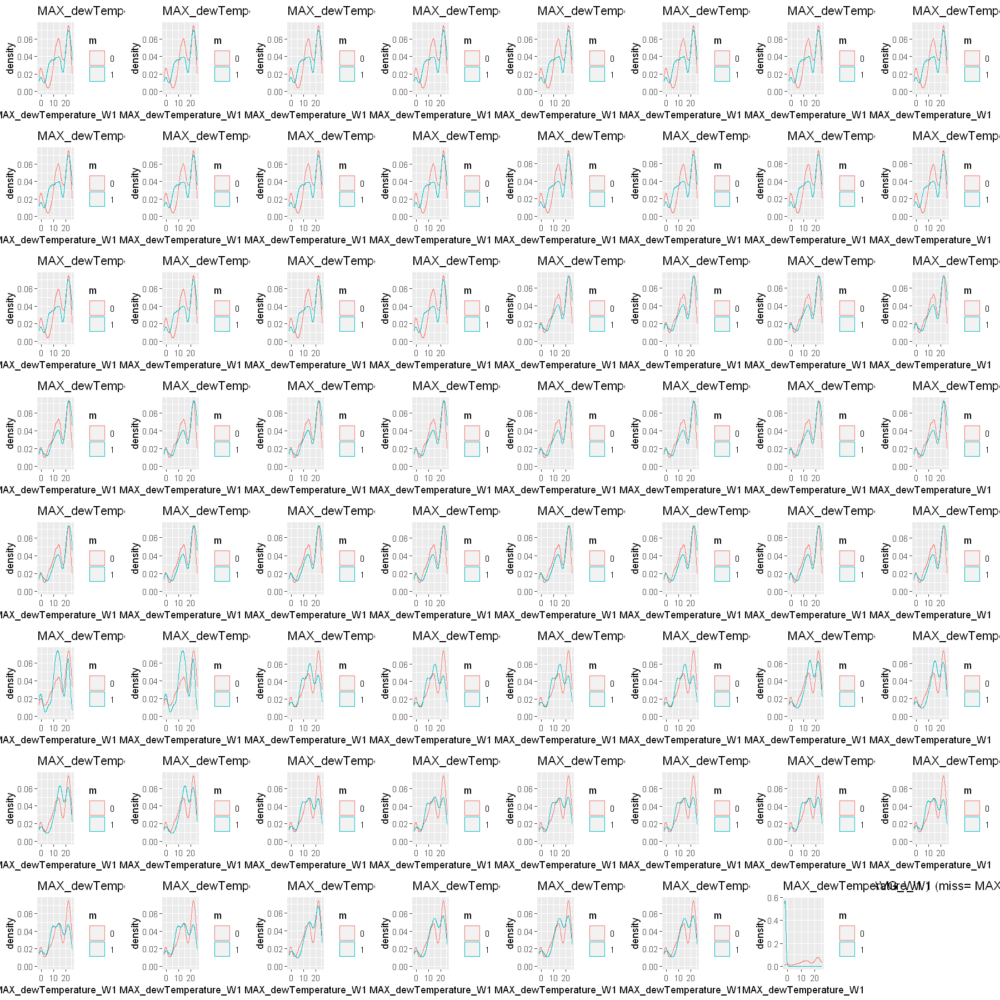

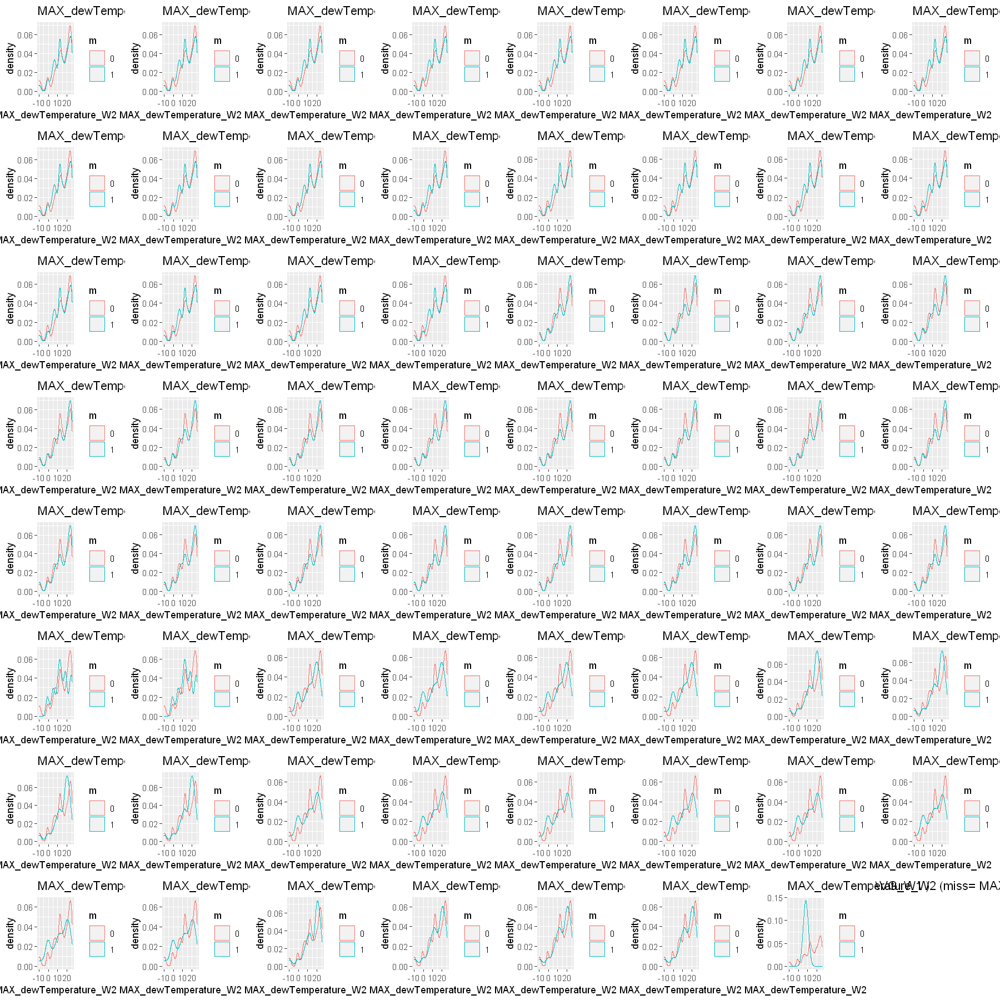

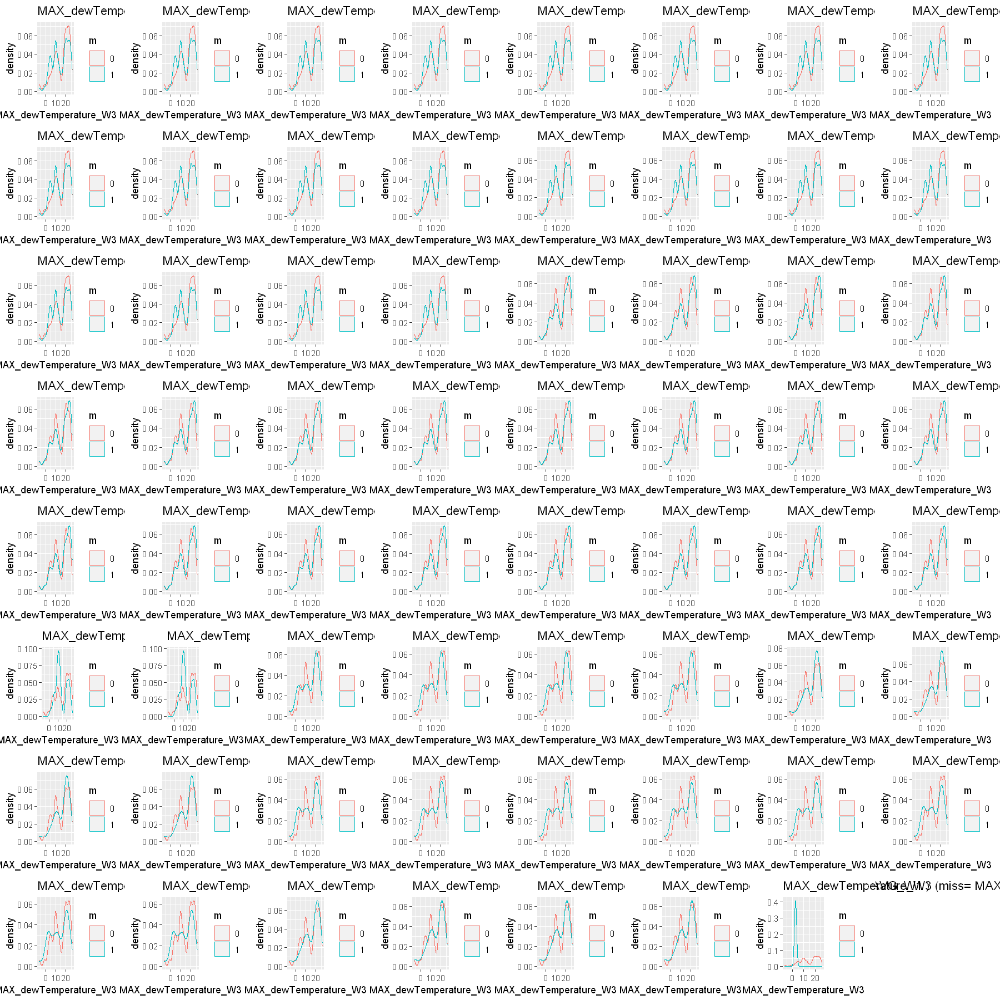

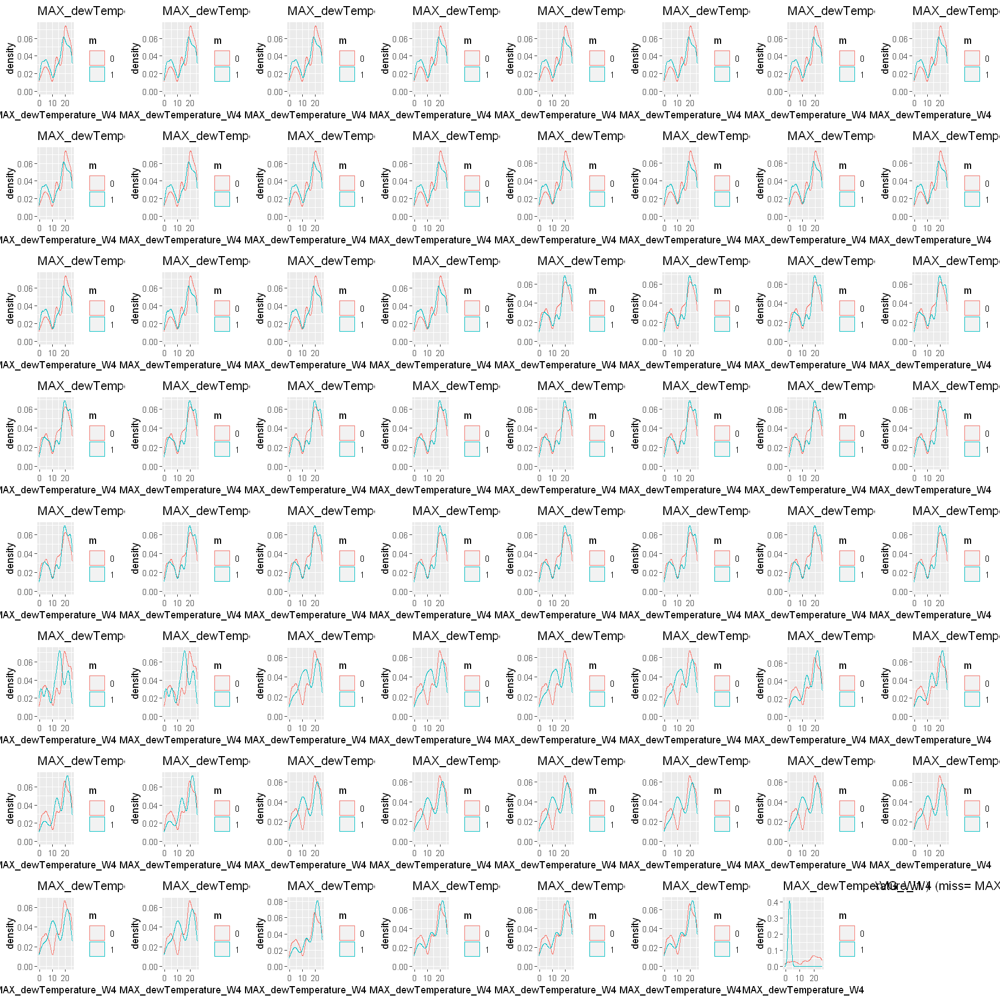

Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 116 rows containing non-finite values (stat_density)."
Warning message:
"Removed 11

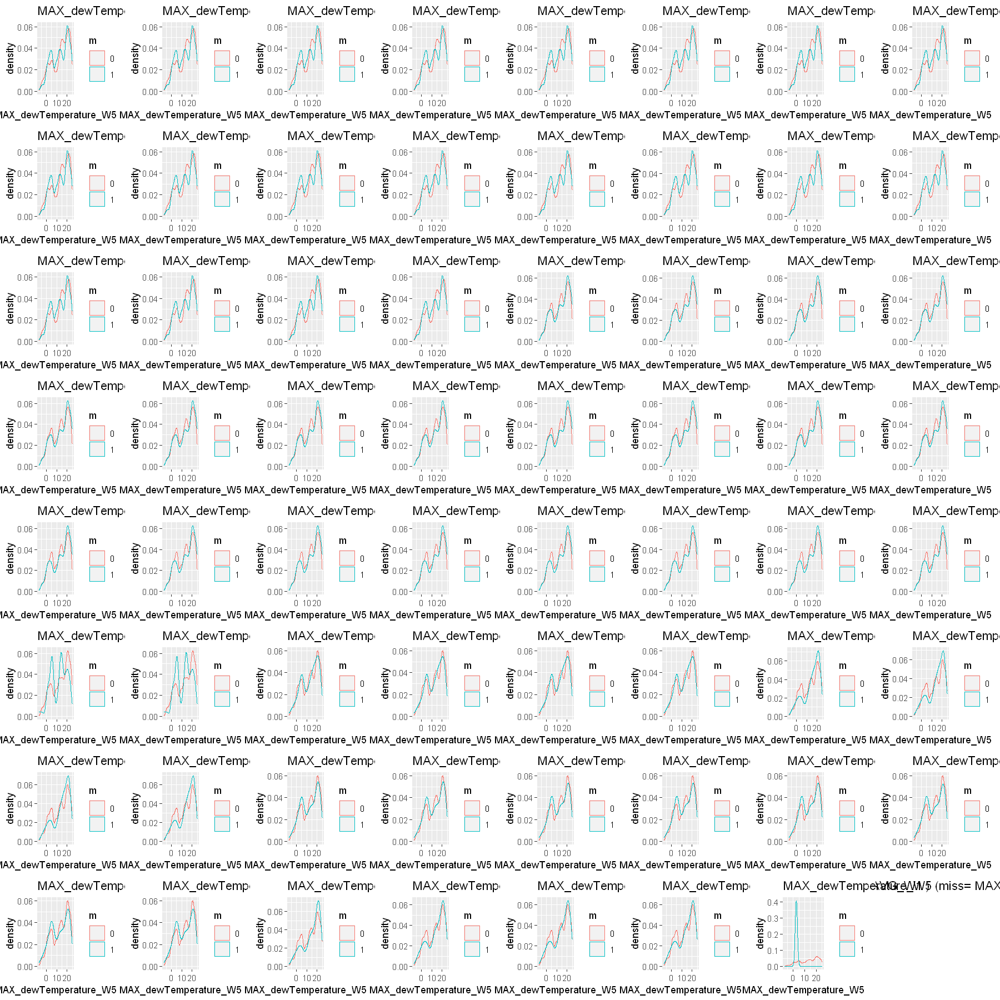

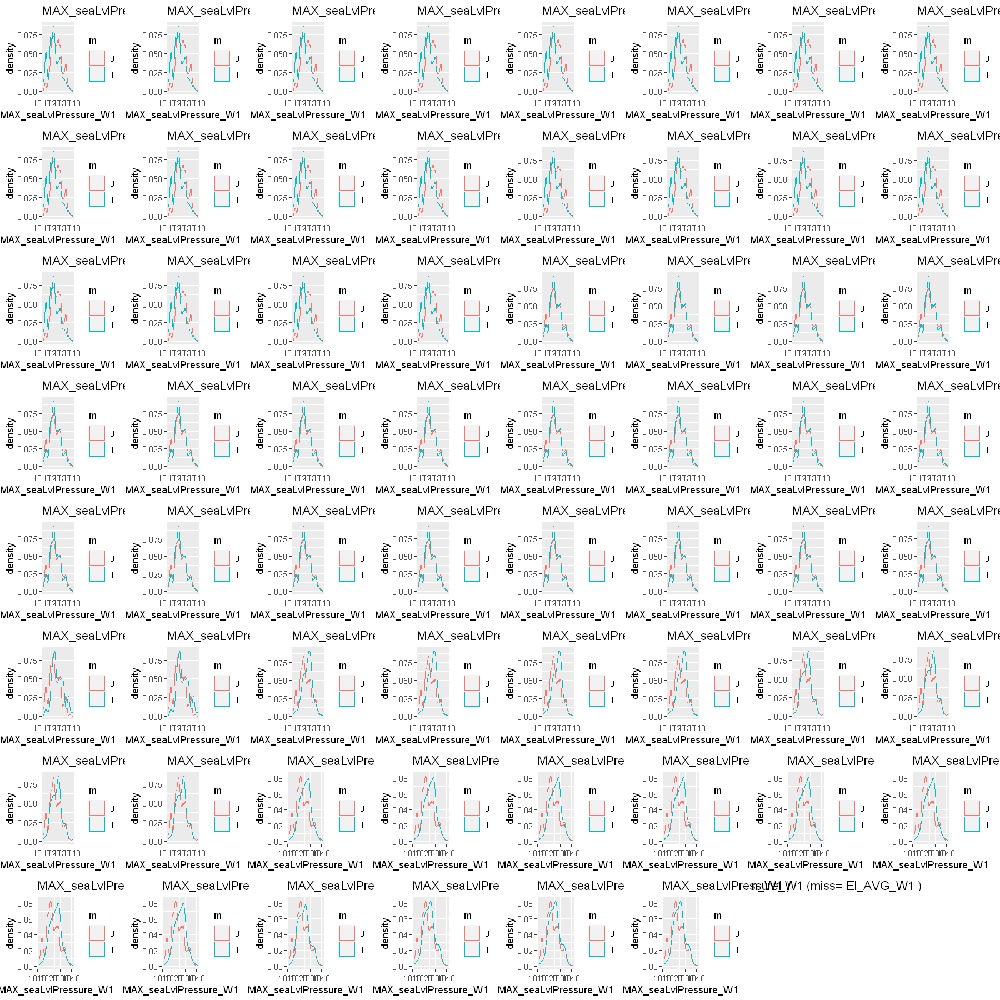

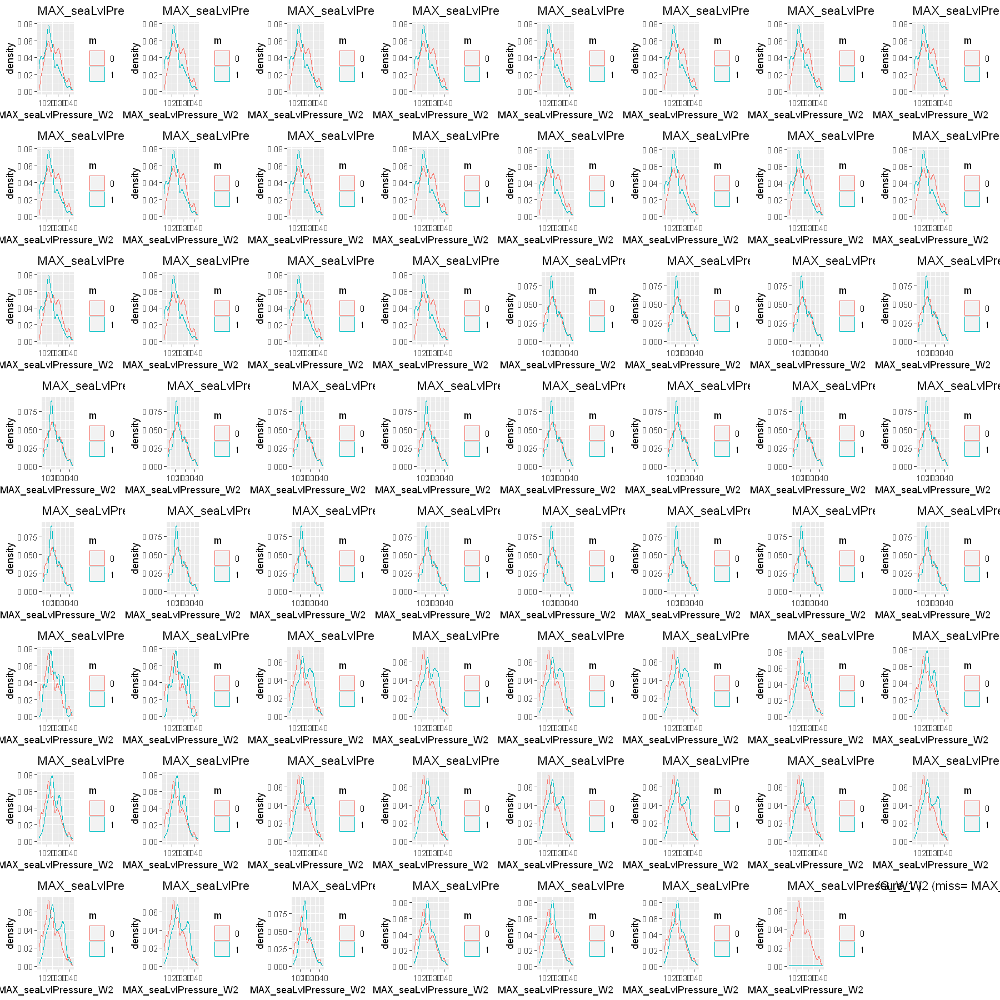

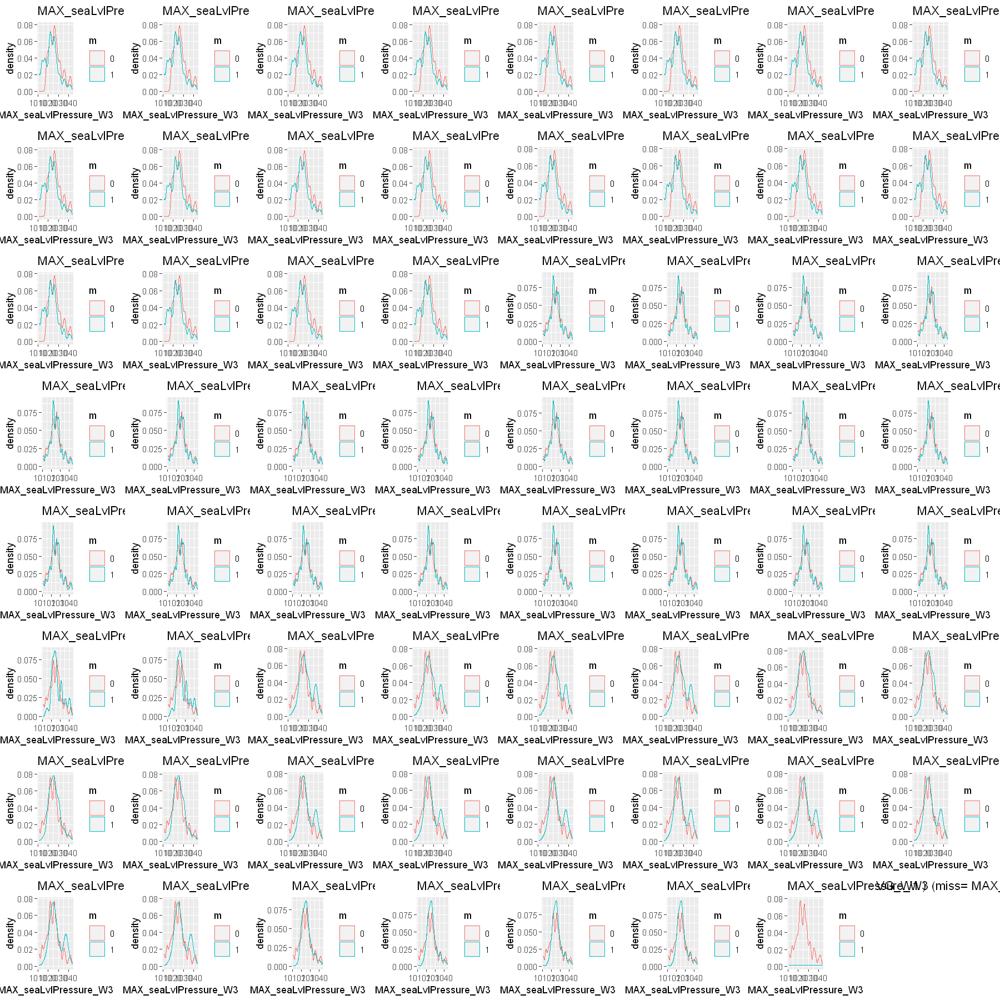

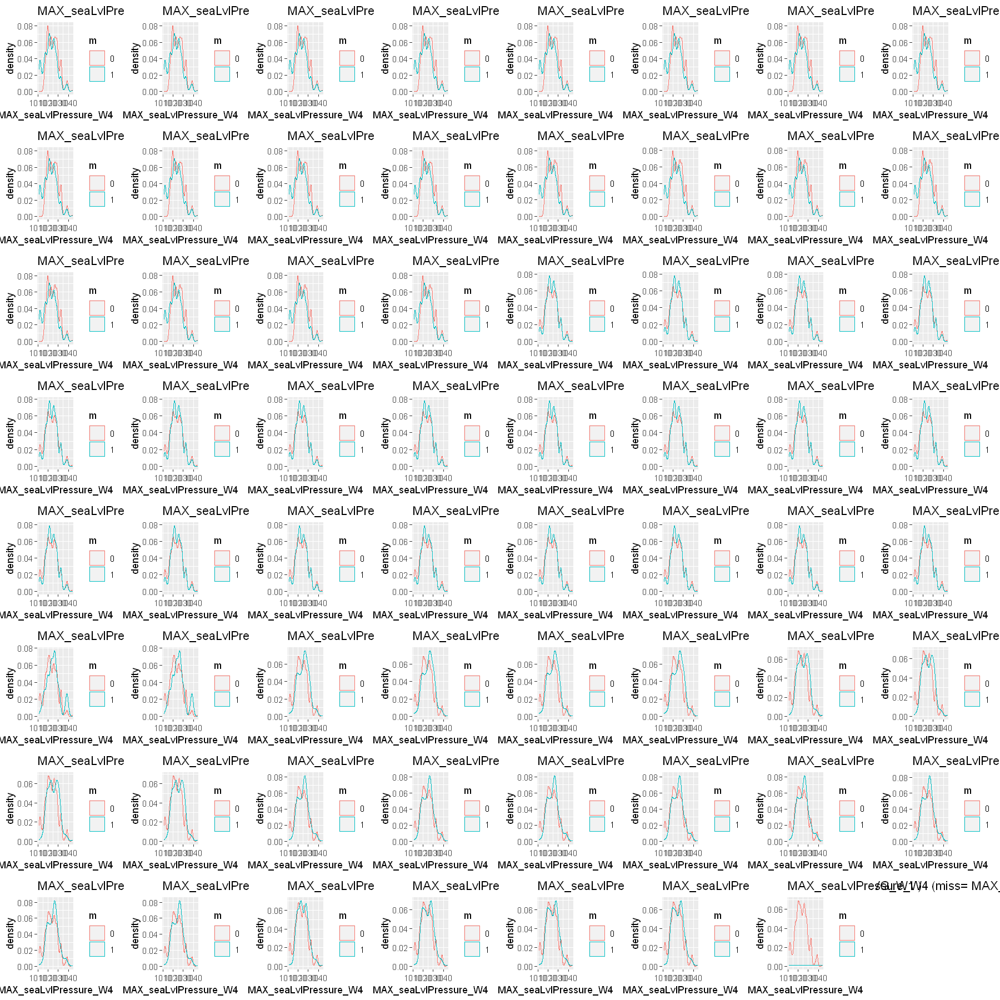

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 15 )

for (v in numrNames_Xghw[1:79])
    {
        p <- list()
        i <- 1
        for (m in mm$missingness$var[1:63])
            {
                if (v != m)
                    {
                        ff <- data.frame(v=BGP_Xghw_mssRwDr[[v]], m=factor(BGP_Xghw_mssRwDr_NA[[m]])) # without gas and hotwater
                        p[[i]] <- suppressMessages(ggplot(data=ff,aes(x=v, group=m, color=m))) +
                          geom_density()+labs(title=paste(v, "(miss=" , m,")"),x=v)
                        i <- i+1
                    }
            }
        do.call(grid.arrange,p)
    }


## ###################################
## ניתוח ערכים חסרים בדרך אנליטית

### יצירת מטריצת החסרים
## original DF 

In [90]:
BGP_T_na <- missingMatrix(DF_BGP)
BGP_T_na <- missingMatrix(BGP_mssRwDr)
BGP_T_na

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### בדיקת כמות המשתנים המכילים ערכים החסרים מתוך מערך המידע המקורי המכיל 90 משתנים

In [91]:
length(mm$missingness$var)

[1] 107

In [92]:
BGP_MV <- NULL
for (m in mm$missingness$var)
    {
        p <- list()
        for (n in numrNames)
            {
                if (n !=m )
                    {
                        miss <- BGP_mssRwDr[[n]]
                        non <- BGP_mssRwDr[[n]][which(BGP_mssRwDr_NA[[n]]==0)]
                        missnum <- length(miss) - length(non)
                        pval <- suppressWarnings(ks.test(miss, non)$p.value)
                        BGP_MV <- rbind(BGP_MV, cbind(
                                                        var=n, 
                                                        missing=m,
                                                        'p.value'=pval,
                                                        missing_cnt=missnum,
                                                        distribution_change=ifelse(pval<0.05,"+","-")
                                                        )
                                        )
                    }
            }
    }
BGP_MV

var,missing,p.value,missing_cnt,distribution_change
sqm,gas_Max_W2,1,0,-
lat,gas_Max_W2,1,1595,-
lng,gas_Max_W2,1,1595,-
El_Max_W1,gas_Max_W2,1,349,-
El_Max_W2,gas_Max_W2,1,412,-
El_Max_W3,gas_Max_W2,1,407,-
El_Max_W4,gas_Max_W2,1,380,-
El_Max_W5,gas_Max_W2,1,383,-
El_Min_W1,gas_Max_W2,1,349,-
El_Min_W2,gas_Max_W2,1,412,-


In [74]:
write.csv(BGP_MV, file="BGP_MV_30052022.csv")

In [59]:
BGP_MV<-read.csv("BGP_MV_30052022.csv")

In [76]:
BGP_MV[BGP_MV[,3]<=0.05]

character(0)

## נראה שניתן לעשות אימפוטציה / החדרה של נתונים על הכל - עובר לעבוד עם רגרסיה לוגיסטית

In [93]:
length(BGP_MV[,3]==1)
length(BGP_MV[,3])

[1] 21721

[1] 21721

In [81]:
if(BGP_MV[,3]<0.05)
    {
        print(BGP_MV[,2])
    }
#BGP_MV_Pva <- BGP_MV[,3]<0.05
#BGP_MV_Pva

Warning message in if (BGP_MV[, 3] < 0.05) {:
"the condition has length > 1 and only the first element will be used"


## הפעלת רגרסיה לוגיסטית על כל המשתנים

In [94]:
BGP_MV_LR <-NULL
for (m in mm$missingness$var)
    {
        ff1<-BGP_mssRwDr_NA
        ff1[[m]]<- BGP_T_na[[m]]
        #print(ff1[[m]])
        #print(m)
        #print(ShBo_T_na[[m]])
        mod <- glm(ff1[[m]] ~.,data=ff1, family="binomial")
        sm <- summary(mod)
        if(is.null(sm)==F)
            {
                sm2 <- data.frame(var=row.names(sm$coefficients), pvalue=sm$coefficients[,4])
                BGP_MV_LR<-rbind(BGP_MV_LR,cbind(m,sm2))
            }
        else
            {
                print(sm)
            }
    }
row.names(BGP_MV_LR) <-NULL
BGP_MV_LR

Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning message:
"glm.fit: algorithm did not converge"
Warning me

m,var,pvalue
<chr>,<chr>,<dbl>
gas_Max_W2,(Intercept),0.9991629
gas_Max_W2,lat,1.0000000
gas_Max_W2,El_Max_W1,1.0000000
gas_Max_W2,El_Max_W2,1.0000000
gas_Max_W2,El_Max_W3,1.0000000
gas_Max_W2,El_Max_W4,1.0000000
gas_Max_W2,El_Max_W5,1.0000000
gas_Max_W2,El_STD_W1,1.0000000
gas_Max_W2,El_STD_W2,1.0000000


In [86]:
write.csv(BGP_MV_LR, file="BGP_MV_LR_30052022.csv")

## גם כאן אין השפעה מובהקת של ערכים חסרים על התפלגות של כל משתנה אחר 

In [87]:
BGP_MV_LR %>% filter(pvalue<0.05)

m,var,pvalue
<chr>,<chr>,<dbl>


In [91]:
BGP_MV_LR %>% filter(pvalue<0.999)

m,var,pvalue
<chr>,<chr>,<dbl>
lat,lat,0.9961075
lng,lat,0.9961075
MAX_seaLvlPressure_W1,MAX_seaLvlPressure_W1,0.9989135


## מסקנה  - ניתן לעשות החדרה (אימפוטציה) של ערכים חסרים לכל המשתנים בהם יש ערכים חסרים
### mar כלומר כולם לפחות 

# ##################################
## עד כאן ניתוח ערכים חסרים
### #
## החדרה - איפוטציה של נתונים במקום ערכים חסרים על פי הכללים


In [93]:
#BGP_mssRwDr

## נבדוק שוב לאילו נתונים צריך לבצע החדרה (אימפוטציה) 

In [94]:
mm<- getMissingness(BGP_mssRwDr, getRows = TRUE) 
mm$missingness

[[1]]
          var na.count rate
1  gas_Max_W2     8897   96
2  gas_Min_W2     8897   96
3  gas_AVG_W2     8897   96
4  gas_STD_W1     8897   96
5  gas_STD_W2     8897   96
6  gas_Max_W1     8896   96
7  gas_Max_W3     8896   96
8  gas_Max_W4     8896   96
9  gas_Max_W5     8896   96
10 gas_Min_W1     8896   96

[[2]]
[1] "This dataset has 0 (0%) complete rows. Original data has 9270 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>
gas_Max_W2,8897,96.0
gas_Min_W2,8897,96.0
gas_AVG_W2,8897,96.0
gas_STD_W1,8897,96.0
gas_STD_W2,8897,96.0
gas_Max_W1,8896,96.0
gas_Max_W3,8896,96.0
gas_Max_W4,8896,96.0
gas_Max_W5,8896,96.0


In [112]:
mm_morethen_80<-mm$missingness %>% filter(rate>80)
mm_morethen_80

var,na.count,rate
<chr>,<dbl>,<dbl>
gas_Max_W2,8897,96.0
gas_Min_W2,8897,96.0
gas_AVG_W2,8897,96.0
gas_STD_W1,8897,96.0
gas_STD_W2,8897,96.0
gas_Max_W1,8896,96.0
gas_Max_W3,8896,96.0
gas_Max_W4,8896,96.0
gas_Max_W5,8896,96.0


In [115]:
length(mm_morethen_80$var)

[1] 40

In [109]:
mm_40_to_80<-mm$missingness %>% filter((rate>40) & (rate<=80))
mm_40_to_80

var,na.count,rate
<chr>,<dbl>,<dbl>
Stm_STD_W3,5616,60.6
Stm_Max_W3,5615,60.6
Stm_Min_W3,5615,60.6
Stm_AVG_W3,5615,60.6
Stm_Max_W4,5614,60.6
Stm_Min_W4,5614,60.6
Stm_AVG_W4,5614,60.6
Stm_STD_W4,5614,60.6
Stm_STD_W5,5614,60.6


In [111]:
length(mm_40_to_80$var)

[1] 20

In [169]:
mm_grt_40<-mm$missingness %>% filter(rate>40) 
mm_grt_40

var,na.count,rate
<chr>,<dbl>,<dbl>
gas_Max_W2,8897,96.0
gas_Min_W2,8897,96.0
gas_AVG_W2,8897,96.0
gas_STD_W1,8897,96.0
gas_STD_W2,8897,96.0
gas_Max_W1,8896,96.0
gas_Max_W3,8896,96.0
gas_Max_W4,8896,96.0
gas_Max_W5,8896,96.0


In [170]:
length(mm_grt_40$var)

[1] 60

In [103]:
mm_lesthen_40<-mm$missingness %>% filter(rate<=40)
mm_lesthen_40

var,na.count,rate
<chr>,<dbl>,<dbl>
ChWt_STD_W3,3400,36.7
ChWt_Max_W3,3399,36.7
ChWt_Min_W3,3399,36.7
ChWt_AVG_W3,3399,36.7
ChWt_STD_W4,3393,36.6
ChWt_Max_W4,3391,36.6
ChWt_Min_W4,3391,36.6
ChWt_AVG_W4,3391,36.6
ChWt_Max_W5,3380,36.5


In [105]:
length(mm_lesthen_40$var)

[1] 47

## מה מספרי המשתנים כדי לטפל בהם לא לפי שמות

In [95]:
for(m in mm$missingness$var)
    {
    print(paste(which(colnames(BGP_mssRwDr)==m), m, sep=' : '))
    }



[1] "50 : gas_Max_W2"
[1] "55 : gas_Min_W2"
[1] "60 : gas_AVG_W2"
[1] "64 : gas_STD_W1"
[1] "65 : gas_STD_W2"
[1] "49 : gas_Max_W1"
[1] "51 : gas_Max_W3"
[1] "52 : gas_Max_W4"
[1] "53 : gas_Max_W5"
[1] "54 : gas_Min_W1"
[1] "56 : gas_Min_W3"
[1] "57 : gas_Min_W4"
[1] "58 : gas_Min_W5"
[1] "59 : gas_AVG_W1"
[1] "61 : gas_AVG_W3"
[1] "62 : gas_AVG_W4"
[1] "63 : gas_AVG_W5"
[1] "66 : gas_STD_W3"
[1] "67 : gas_STD_W4"
[1] "68 : gas_STD_W5"
[1] "84 : hotwater_STD_W1"
[1] "69 : hotwater_Max_W1"
[1] "74 : hotwater_Min_W1"
[1] "79 : hotwater_AVG_W1"
[1] "88 : hotwater_STD_W5"
[1] "70 : hotwater_Max_W2"
[1] "71 : hotwater_Max_W3"
[1] "73 : hotwater_Max_W5"
[1] "75 : hotwater_Min_W2"
[1] "76 : hotwater_Min_W3"
[1] "78 : hotwater_Min_W5"
[1] "80 : hotwater_AVG_W2"
[1] "81 : hotwater_AVG_W3"
[1] "83 : hotwater_AVG_W5"
[1] "85 : hotwater_STD_W2"
[1] "86 : hotwater_STD_W3"
[1] "72 : hotwater_Max_W4"
[1] "77 : hotwater_Min_W4"
[1] "82 : hotwater_AVG_W4"
[1] "87 : hotwater_STD_W4"
[1] "106 : Stm_STD_W

In [97]:
length(mm$missingness$var)

[1] 107

# -------------------------------------------------
### את הערכים שבהם הערכים החסרים מעל 40% הופכים לקטגוריאליים ומוסיפים קטגוריה של ערך חסר 1 ערך קיים 0
#### כלומר למשתנים 46,47,48,49,50,51
## #
### על הערכים הקטנים או שווים ל 40% אני אבצע החדרה (אימפוטציה)
#### :כלומר למשתנים
##### 13,87,86,85,84,83,82,81,80,79,78,77,76,75,74,73,72,71,41,40,12,14

#### היות והמייס לא עבד לי 
#### חיפשתי ומצאתי את האתר
https://rdrr.io/cran/VIM/man/kNN.html
### KNN המתבסס על 

In [120]:
#install.packages('VIM')

In [121]:
#library(VIM)

In [116]:
?kNN

#### העתקת מערך המידע למערך מידע חדש כדי לאפשר צעידה לאחור במקרה של בעיות

In [117]:
for(m in mm_lesthen_40$var) # the variabls to imp with KNN - less then 40% missing
    {
    print(paste(which(colnames(BGP_mssRwDr)==m), m, sep=' : '))
    }


[1] "46 : ChWt_STD_W3"
[1] "31 : ChWt_Max_W3"
[1] "36 : ChWt_Min_W3"
[1] "41 : ChWt_AVG_W3"
[1] "47 : ChWt_STD_W4"
[1] "32 : ChWt_Max_W4"
[1] "37 : ChWt_Min_W4"
[1] "42 : ChWt_AVG_W4"
[1] "33 : ChWt_Max_W5"
[1] "38 : ChWt_Min_W5"
[1] "43 : ChWt_AVG_W5"
[1] "48 : ChWt_STD_W5"
[1] "45 : ChWt_STD_W2"
[1] "44 : ChWt_STD_W1"
[1] "29 : ChWt_Max_W1"
[1] "30 : ChWt_Max_W2"
[1] "34 : ChWt_Min_W1"
[1] "35 : ChWt_Min_W2"
[1] "39 : ChWt_AVG_W1"
[1] "40 : ChWt_AVG_W2"
[1] "6 : lat"
[1] "7 : lng"
[1] "25 : El_STD_W2"
[1] "26 : El_STD_W3"
[1] "10 : El_Max_W2"
[1] "15 : El_Min_W2"
[1] "20 : El_AVG_W2"
[1] "11 : El_Max_W3"
[1] "16 : El_Min_W3"
[1] "21 : El_AVG_W3"
[1] "24 : El_STD_W1"
[1] "27 : El_STD_W4"
[1] "28 : El_STD_W5"
[1] "13 : El_Max_W5"
[1] "18 : El_Min_W5"
[1] "23 : El_AVG_W5"
[1] "12 : El_Max_W4"
[1] "17 : El_Min_W4"
[1] "22 : El_AVG_W4"
[1] "209 : El_Nxt_Mnth_Avg_OC"
[1] "9 : El_Max_W1"
[1] "14 : El_Min_W1"
[1] "19 : El_AVG_W1"
[1] "119 : MAX_seaLvlPressure_W1"
[1] "144 : Min_seaLvlPressur

In [127]:
BGP_kNN<-DF_BGP # the sorce df in to working df so we preserve the original data

#### Using kNN vim for imputation process

In [129]:
BGP_kNN_out<-kNN(BGP_kNN,variable =
                 c(6,7,10,11,12,13,15,16,17,18,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,
                   42,43,44,45,46,47,48),   #  vars to imputation 
                 dist_var=c('El_Nxt_Mnth_Avg_OC','El_Max_W1','El_Min_W1','El_AVG_W1','MAX_seaLvlPressure_W1',
                             'Min_seaLvlPressure_W1','Avg_seaLvlPressure_W1','Std_seaLvlPressure_W1'),# vars les then 4% missing
                              # to be used for creating the 
                 k = 5
                 )

###  Just checking some of the in and out  columns  - It works!!!

In [134]:
BGP_kNN_in[c(6,7,10,11,12,13)]

lat,lng,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NA,NA,129.1300,171.0000,109.1300,96.8699
NA,NA,202.0000,330.7500,219.5000,220.5001
NA,NA,34.6300,37.3800,36.5000,24.8800
NA,NA,180.0000,222.0000,324.0000,382.4999
NA,NA,103.2500,160.0000,103.0000,104.7500
NA,NA,139.1200,150.7500,184.1300,125.1302
NA,NA,217.0000,388.7500,208.0000,190.0001
NA,NA,234.2500,355.5000,236.7500,217.2502
NA,NA,34.5400,31.9096,32.8700,27.9699


In [135]:
BGP_kNN_out[c(6,7,10,11,12,13)]

lat,lng,El_Max_W2,El_Max_W3,El_Max_W4,El_Max_W5
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
45.4215,-75.6972,129.1300,171.0000,109.1300,96.8699
45.4215,-75.6972,202.0000,330.7500,219.5000,220.5001
45.3876,-75.6960,34.6300,37.3800,36.5000,24.8800
45.4215,-75.6972,180.0000,222.0000,324.0000,382.4999
45.3876,-75.6960,103.2500,160.0000,103.0000,104.7500
45.4215,-75.6972,139.1200,150.7500,184.1300,125.1302
40.3500,-74.7000,3.9608,9.6019,30.0058,12.8025
45.4215,-75.6972,217.0000,388.7500,208.0000,190.0001
45.4215,-75.6972,234.2500,355.5000,236.7500,217.2502


In [136]:
write.csv(BGP_kNN_out, file="BGP_kNN_out1_31052022.csv")

In [137]:
write.csv(BGP_kNN_in, file="BGP_kNN_in_31052022.csv")

#### Now some of the new imputiesed columns will be use for imputation of the less then 4% columns that were used for the firs imputaion. we will be useing the featuers with 4-5% missing in the original DF

In [145]:
BGP_kNN_1<-BGP_kNN_out[,c(1:209)] # moving the out df to save it, using the same out in the syntex

In [148]:
BGP_kNN_1

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,NA,3.9608,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,NA
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [146]:
write.csv(BGP_kNN_1, file="BGP_kNN_1_31052022.csv")

In [149]:
BGP_kNN_out2<-kNN(BGP_kNN_1,variable =  # using the kNN out df, adding the new imp
                 c(209,9,14,19,119,144,169,194),   #  vars to imputation used 1st round as dist vars 
                 dist_var=c('El_STD_W2',
                            'El_STD_W3',
                            'El_Max_W2',
                            'El_Min_W2',
                            'El_AVG_W2',
                            'El_Max_W3',
                            'El_Min_W3',
                            'El_AVG_W3',
                            'El_STD_W1',
                            'El_STD_W4',
                            'El_STD_W5',
                            'El_Max_W5',
                            'El_Min_W5',
                            'El_AVG_W5',
                            'El_Max_W4',
                            'El_Min_W4',
                            'El_AVG_W4'                     
                             ),  # vars 4-5% missing in the original data, imp' in the 1st time,
                                 #  to be used for creating the new data
                 k = 5
                 )

In [150]:
write.csv(BGP_kNN_out2, file="BGP_kNN_out2_31052022.csv")

###  Just checking some of the in and out  columns  - It works!!!

In [151]:
BGP_kNN_in[c(9,14,19,119,144,169,194,209)]

El_Max_W1,El_Min_W1,El_AVG_W1,MAX_seaLvlPressure_W1,Min_seaLvlPressure_W1,Avg_seaLvlPressure_W1,Std_seaLvlPressure_W1,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
147.2500,53.2500,78.292440,1032.3,1013.9,1021.859,4.457764,56.826975
225.0000,88.2500,147.345240,1032.3,1013.9,1021.859,4.457764,108.609934
30.6200,18.5000,22.322143,1032.3,1013.9,1021.859,4.457764,20.524533
178.5000,42.5000,96.851191,1032.3,1013.9,1021.859,4.457764,191.529662
95.5000,37.0000,64.900298,1032.3,1013.9,1021.859,4.457764,56.170051
145.6200,71.5000,96.720239,1032.3,1013.9,1021.859,4.457764,70.386137
203.0000,61.7500,123.306548,1032.3,1013.9,1021.859,4.457764,132.154969
227.2500,65.7500,152.941359,1032.3,1013.9,1021.859,4.457764,119.879087
39.2499,3.6500,14.113048,1032.3,1013.9,1021.859,4.457764,7.300201


In [152]:
BGP_kNN_out2[c(9,14,19,119,144,169,194,209)]

El_Max_W1,El_Min_W1,El_AVG_W1,MAX_seaLvlPressure_W1,Min_seaLvlPressure_W1,Avg_seaLvlPressure_W1,Std_seaLvlPressure_W1,El_Nxt_Mnth_Avg_OC
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
147.2500,53.2500,78.292440,1032.3,1013.9,1021.859,4.457764,56.826975
225.0000,88.2500,147.345240,1032.3,1013.9,1021.859,4.457764,108.609934
30.6200,18.5000,22.322143,1032.3,1013.9,1021.859,4.457764,20.524533
178.5000,42.5000,96.851191,1032.3,1013.9,1021.859,4.457764,191.529662
95.5000,37.0000,64.900298,1032.3,1013.9,1021.859,4.457764,56.170051
145.6200,71.5000,96.720239,1032.3,1013.9,1021.859,4.457764,70.386137
65.3548,65.3548,65.354800,1032.3,1013.9,1021.859,4.457764,29.314655
203.0000,61.7500,123.306548,1032.3,1013.9,1021.859,4.457764,132.154969
227.2500,65.7500,152.941359,1032.3,1013.9,1021.859,4.457764,119.879087


In [153]:
BGP_kNN_2<-BGP_kNN_out2[,c(1:209)]

In [154]:
BGP_kNN_2

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,65.3548,3.9608,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [155]:
write.csv(BGP_kNN_2, file="BGP_kNN_2_31052022.csv")

In [16]:
#BGP_kNN_2<-read.csv("BGP_kNN_2_31052022.csv")

## -------------------
### Imputation of miss in to char features insted of na

In [17]:
BGP_IMP1<-BGP_kNN_2

In [19]:
for(m in 4:5)
    {
    for (n in 1:10272)
        {
        #print(BGP_kNN_2[n,m]))
        if(is.na(BGP_IMP1[n,m]))
            {
                BGP_IMP1[n,m]<-'miss'
            }
        }
    }
BGP_IMP1

X,BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
2,Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3,Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
4,Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
5,Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
6,Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
7,Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,65.3548,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
8,Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
9,Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [21]:
write.csv(BGP_IMP1, file="BGP_IMP1_31052022.csv")

In [10]:
#BGP_IMP1<-read.csv("BGP_IMP1_31052022.csv")

# ---------------------------
## איפוטציה של נתונים שחסרים יותר מ 40%
### הפיכה לקטגוריות והחדרה של קטגוריית חסר

In [171]:
for(m in mm_grt_40$var)
    {
    print(paste(which(colnames(BGP_IMP1)==m), m, sep=' : '))
    }

[1] "50 : gas_Max_W2"
[1] "55 : gas_Min_W2"
[1] "60 : gas_AVG_W2"
[1] "64 : gas_STD_W1"
[1] "65 : gas_STD_W2"
[1] "49 : gas_Max_W1"
[1] "51 : gas_Max_W3"
[1] "52 : gas_Max_W4"
[1] "53 : gas_Max_W5"
[1] "54 : gas_Min_W1"
[1] "56 : gas_Min_W3"
[1] "57 : gas_Min_W4"
[1] "58 : gas_Min_W5"
[1] "59 : gas_AVG_W1"
[1] "61 : gas_AVG_W3"
[1] "62 : gas_AVG_W4"
[1] "63 : gas_AVG_W5"
[1] "66 : gas_STD_W3"
[1] "67 : gas_STD_W4"
[1] "68 : gas_STD_W5"
[1] "84 : hotwater_STD_W1"
[1] "69 : hotwater_Max_W1"
[1] "74 : hotwater_Min_W1"
[1] "79 : hotwater_AVG_W1"
[1] "88 : hotwater_STD_W5"
[1] "70 : hotwater_Max_W2"
[1] "71 : hotwater_Max_W3"
[1] "73 : hotwater_Max_W5"
[1] "75 : hotwater_Min_W2"
[1] "76 : hotwater_Min_W3"
[1] "78 : hotwater_Min_W5"
[1] "80 : hotwater_AVG_W2"
[1] "81 : hotwater_AVG_W3"
[1] "83 : hotwater_AVG_W5"
[1] "85 : hotwater_STD_W2"
[1] "86 : hotwater_STD_W3"
[1] "72 : hotwater_Max_W4"
[1] "77 : hotwater_Min_W4"
[1] "82 : hotwater_AVG_W4"
[1] "87 : hotwater_STD_W4"
[1] "106 : Stm_STD_W

In [32]:
BGP_IMP2<-BGP_IMP1

In [33]:
for(m in 50:109) # adding 1 (49 -> 50, 108 -> 109)  as BGP_IMP1 added an index ....
   {
   
    for (n in 1:10272)
        {
        if(is.na(BGP_IMP1[n,m]))
            {
                BGP_IMP2[n,m]<-'miss'
            }
        else 
            {
                if(BGP_IMP1[n,m] <= 1+quantile(BGP_IMP1[[m]], 1/4,na.rm=TRUE))
                    {
                        BGP_IMP2[n,m]<-'low'
                    }
                if((BGP_IMP1[n,m]<= quantile(BGP_IMP1[[m]], 3/4,na.rm=TRUE)) & 
                   (BGP_IMP1[n,m]> 1+quantile(BGP_IMP1[[m]], 1/4,na.rm=TRUE)))
                {
                   BGP_IMP2[n,m]<-'mid'
                }
                
                if(BGP_IMP1[n,m]> quantile(BGP_IMP1[[m]], 3/4,na.rm=TRUE))
                {
                   BGP_IMP2[n,m]<-'high'
                }
            }
      } 
    }
BGP_IMP2

X,BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
2,Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
3,Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
4,Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
5,Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
6,Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
7,Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,65.3548,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
8,Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
9,Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [40]:
write.csv(BGP_IMP2, file="BGP_IMP2_31052022.csv")

In [10]:
#BGP_IMP2<-read.csv("BGP_IMP2_31052022.csv")

## הרצה נוספת של בדיקת ערכים חריגים

In [43]:
mm<- getMissingness(BGP_IMP2, getRows = TRUE) 
mm$missingness

Loading required package: dplyr


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union




[[1]]
[1] var      na.count rate    
<0 rows> (or 0-length row.names)

[[2]]
[1] "This dataset has 10272 (100%) complete rows. Original data has 10272 rows."



var,na.count,rate
<chr>,<dbl>,<dbl>


### Dropping the index column form BGP_IMP2 dataframe

In [46]:
BGP_IMP2<-BGP_IMP2[2:210]
BGP_IMP2

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,65.3548,3.9608,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


Warning message:
"`gather_()` was deprecated in tidyr 1.2.0.
Please use `gather()` instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated."


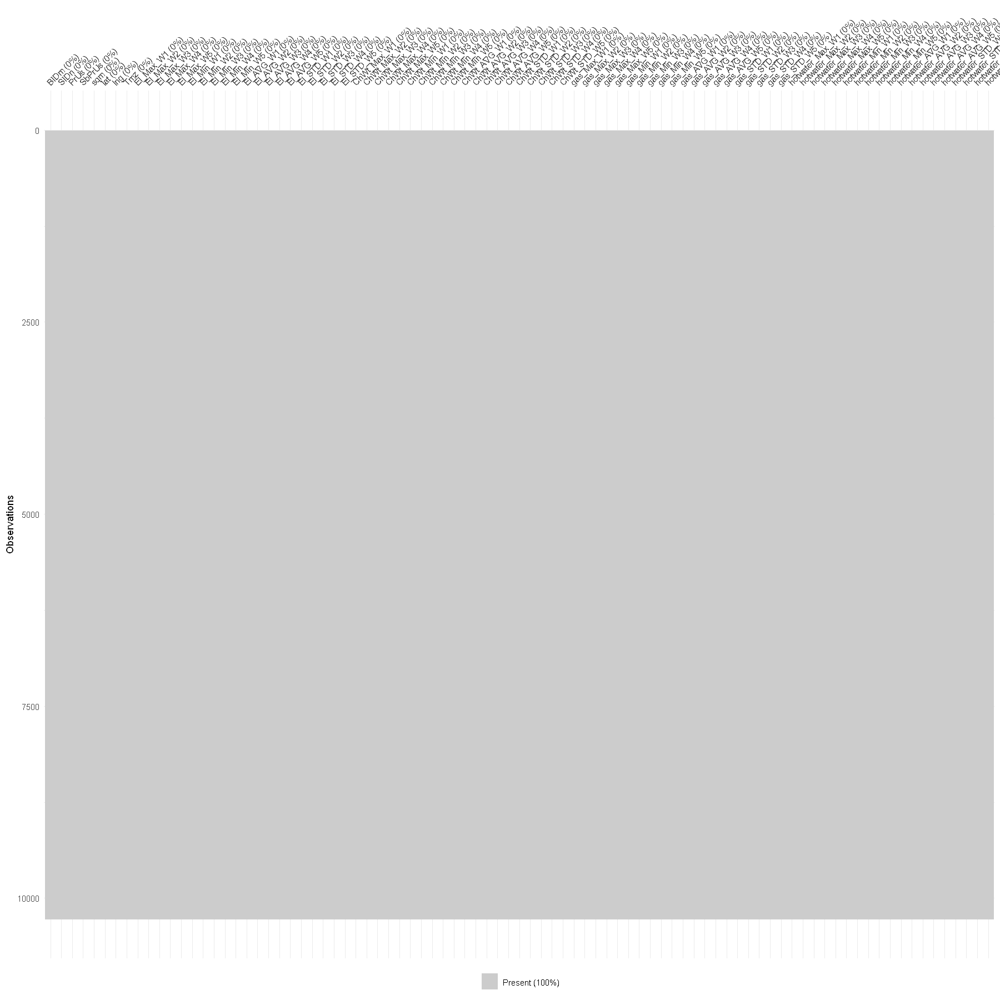

In [52]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_IMP2[1:87])

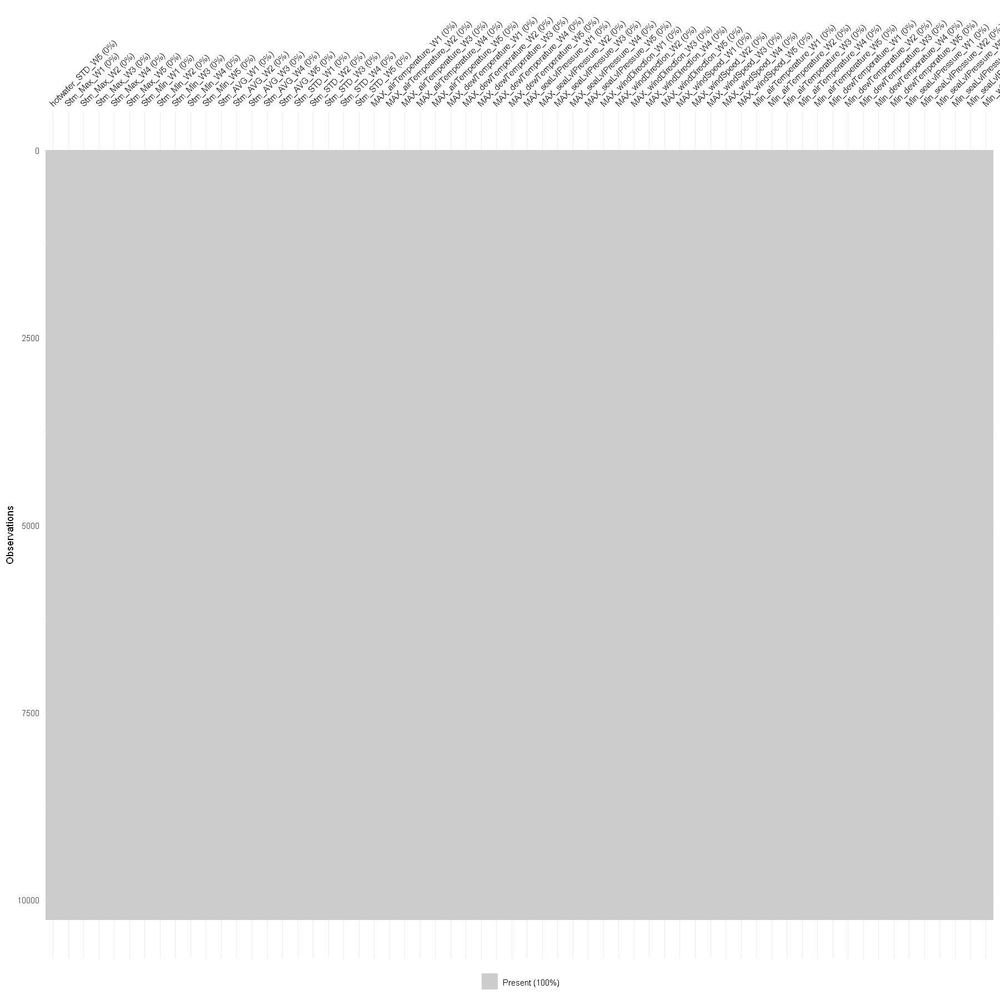

In [53]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_IMP2[88:149])

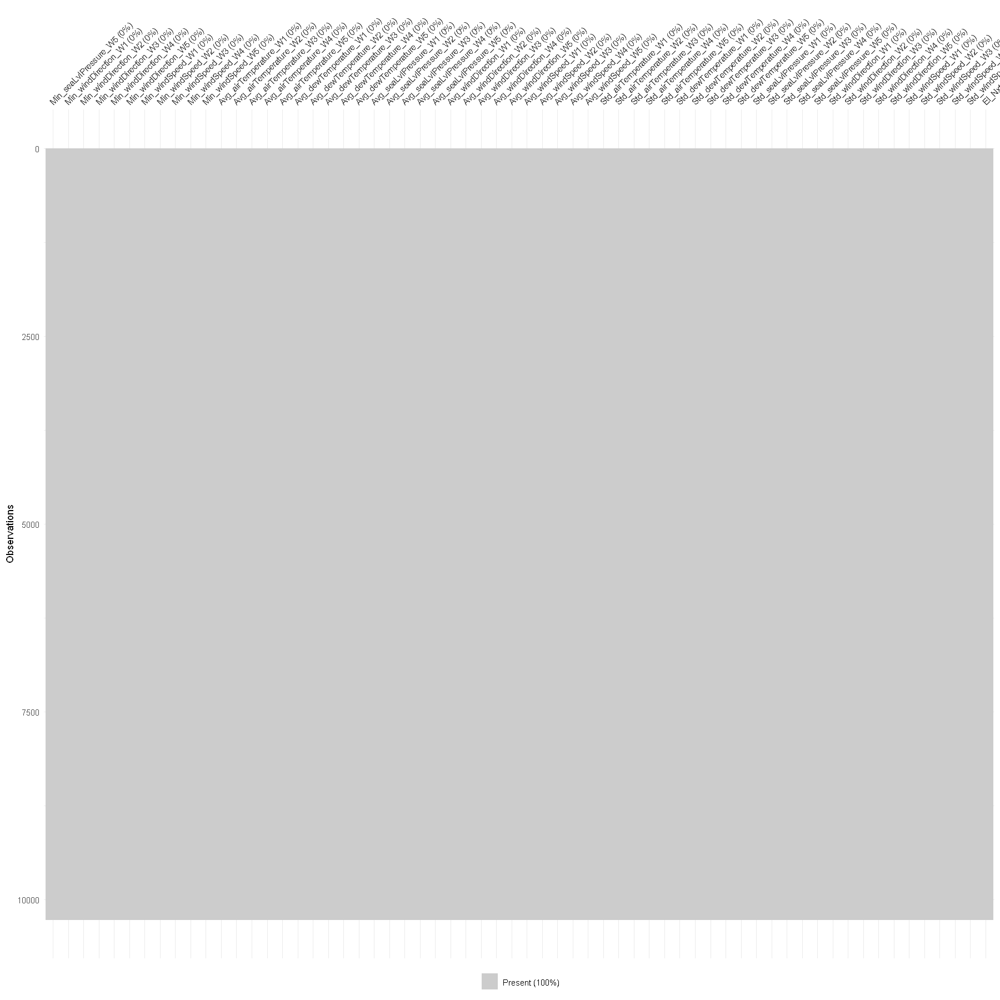

In [54]:
options(repr.plot.width = 15, repr.plot.height = 15)
vis_miss(BGP_IMP2[148:209])

In [56]:
DF_BGP_CFF<-BGP_IMP2 # creating  Building Genome Project Clean Flat File Data Frame

In [113]:
DF_BGP_CFF

BIDm,SIDn,PrUs,SbPrUs,sqm,lat,lng,Tmz,El_Max_W1,El_Max_W2,...,Std_windDirection_W2,Std_windDirection_W3,Std_windDirection_W4,Std_windDirection_W5,Std_windSpeed_W1,Std_windSpeed_W2,Std_windSpeed_W3,Std_windSpeed_W4,Std_windSpeed_W5,El_Nxt_Mnth_Avg_OC
<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Apr_Bobcat_assembly_Adam,Bobcat,Entertainment/public assembly,Sports Facility,2053.2,45.4215,-75.6972,US/Mountain,147.2500,129.1300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.826975
Apr_Bobcat_assembly_Billy,Bobcat,Entertainment/public assembly,Sports Facility,19859.1,45.4215,-75.6972,US/Mountain,225.0000,202.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,108.609934
Apr_Bobcat_assembly_Camilla,Bobcat,Entertainment/public assembly,Sports Facility,3696.4,45.3876,-75.6960,US/Mountain,30.6200,34.6300,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,20.524533
Apr_Bobcat_assembly_Franklin,Bobcat,Entertainment/public assembly,Sports Facility,15047.4,45.4215,-75.6972,US/Mountain,178.5000,180.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,191.529662
Apr_Bobcat_education_Alissa,Bobcat,Education,Academic,11254.8,45.3876,-75.6960,US/Mountain,95.5000,103.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,56.170051
Apr_Bobcat_education_Angela,Bobcat,Education,Academic,8802.7,45.4215,-75.6972,US/Mountain,145.6200,139.1200,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,70.386137
Apr_Bobcat_education_Barbra,Bobcat,Education,Academic,2538.0,40.3500,-74.7000,US/Mountain,65.3548,3.9608,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,29.314655
Apr_Bobcat_education_Coleman,Bobcat,Education,Academic,10551.9,45.4215,-75.6972,US/Mountain,203.0000,217.0000,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,132.154969
Apr_Bobcat_education_Dylan,Bobcat,Education,Student Center,17358.0,45.4215,-75.6972,US/Mountain,227.2500,234.2500,...,94.71668,119.4723,100.0055,125.112,1.625675,1.793841,2.202108,2.633764,2.440854,119.879087


In [114]:
dbWriteTable(conn,"DF_BGP_CFF",DF_BGP_CFF)

ERROR: Error: Table DF_BGP_CFF exists in database, and both overwrite and append are FALSE


In [58]:
write.csv(DF_BGP_CFF, file="DF_BGP_CFF.csv")

In [31]:
#DF_BGP_CFF<-read.csv("DF_BGP_CFF.csv")